In [1]:
import pandas as pd
import seaborn as sb
import matplotlib.pyplot as plt
import datetime

## Ballygunge Exploratory Data Analysis

In [2]:
ballygunge = pd.read_csv('C:/Users/shova/iCloudDrive/Kolkata_data/Work/Semi_processed/Ballygunge.csv')    # reads the Ballygunge file
ballygunge.head()

,Date,PM2.5,PM10,NO2,NH3,SO2,CO,Ozone,AT,AQI,AQI_Standard
0,2019-08-30,15.36,26.35,23.30,12.31,1.84,0.37,24.52,30.56,29.12,Good
1,2019-08-31,14.78,29.30,19.09,15.00,2.61,0.33,25.19,29.72,29.30,Good
2,2019-09-01,22.12,42.97,25.03,10.62,2.23,0.48,22.21,28.83,42.97,Good
3,2019-09-02,10.06,21.85,24.25,31.03,1.91,0.42,19.23,29.02,30.31,Good
4,2019-09-03,8.43,15.31,22.70,35.45,2.89,0.39,22.00,28.63,28.38,Good


In [3]:
print("Total number of days recorded at the Ballygunge recording station is -",str(len(ballygunge)),
      "\nThe Ballygunge record starts from ",str(ballygunge.iloc[0]['Date']),' ends on ',str(ballygunge.iloc[-1]['Date']),'.',
      "\nThe pollutants that we are dealing with, in  the dataset are:-")
for i in ballygunge.drop('Date', axis=1).drop('AT', axis=1).drop('AQI', axis=1).drop('AQI_Standard', axis=1).columns.values:
    print(i,end=" ")

Total number of days recorded at the Ballygunge recording station is - 1220 
The Ballygunge record starts from  2019-08-30  ends on  2022-12-31 . 
The pollutants that we are dealing with, in  the dataset are:-
PM2.5 PM10 NO2 NH3 SO2 CO Ozone 

In [4]:
# Here we separate the data month wise
ballygunge_jan = pd.DataFrame(columns=ballygunge.columns)
ballygunge_feb = pd.DataFrame(columns=ballygunge.columns)
ballygunge_mar = pd.DataFrame(columns=ballygunge.columns)
ballygunge_apr = pd.DataFrame(columns=ballygunge.columns)
ballygunge_may = pd.DataFrame(columns=ballygunge.columns)
ballygunge_jun = pd.DataFrame(columns=ballygunge.columns)
ballygunge_jul = pd.DataFrame(columns=ballygunge.columns)
ballygunge_aug = pd.DataFrame(columns=ballygunge.columns)
ballygunge_sep = pd.DataFrame(columns=ballygunge.columns)
ballygunge_oct = pd.DataFrame(columns=ballygunge.columns)
ballygunge_nov = pd.DataFrame(columns=ballygunge.columns)
ballygunge_dec = pd.DataFrame(columns=ballygunge.columns)
for d in ballygunge["Date"]:
    rows=ballygunge.loc[ballygunge["Date"] == d]
    if d[5:7] == "01":
        ballygunge_jan = pd.concat([ballygunge_jan,rows],ignore_index=True)
    elif d[5:7] == "02":
        ballygunge_feb = pd.concat([ballygunge_feb,rows],ignore_index=True)
    elif d[5:7] == "03":
        ballygunge_mar = pd.concat([ballygunge_mar,rows],ignore_index=True)
    elif d[5:7] == "04":
        ballygunge_apr = pd.concat([ballygunge_apr,rows],ignore_index=True)
    elif d[5:7] == "05":
        ballygunge_may = pd.concat([ballygunge_may,rows],ignore_index=True)
    elif d[5:7] == "06":
        ballygunge_jun = pd.concat([ballygunge_jun,rows],ignore_index=True)
    elif d[5:7] == "07":
        ballygunge_jul = pd.concat([ballygunge_jul,rows],ignore_index=True)
    elif d[5:7] == "08":
        ballygunge_aug = pd.concat([ballygunge_aug,rows],ignore_index=True)
    elif d[5:7] == "09":
        ballygunge_sep = pd.concat([ballygunge_sep,rows],ignore_index=True)
    elif d[5:7] == "10":
        ballygunge_oct = pd.concat([ballygunge_oct,rows],ignore_index=True)
    elif d[5:7] == "11":
        ballygunge_nov = pd.concat([ballygunge_nov,rows],ignore_index=True)
    elif d[5:7] == "12":
        ballygunge_dec = pd.concat([ballygunge_dec,rows],ignore_index=True)

In [5]:
ballygunge['Date'] = pd.to_datetime(ballygunge['Date'], format="%Y-%m-%d") # converts the date values to proper date format from string for plotting purposes
# Here we separate the data by year
ballygunge_2019 = pd.DataFrame(columns=ballygunge.columns)
ballygunge_2020 = pd.DataFrame(columns=ballygunge.columns)
ballygunge_2021 = pd.DataFrame(columns=ballygunge.columns)
ballygunge_2022 = pd.DataFrame(columns=ballygunge.columns)
for d in ballygunge["Date"]:
    rows=ballygunge.loc[ballygunge["Date"] == d]
    if d <= datetime.datetime.strptime("31/12/2019", "%d/%m/%Y"):
        ballygunge_2019 = pd.concat([ballygunge_2019,rows],ignore_index=True)
    elif d >= datetime.datetime.strptime("01/01/2020", "%d/%m/%Y") and d <= datetime.datetime.strptime("31/12/2020", "%d/%m/%Y"):
        ballygunge_2020 = pd.concat([ballygunge_2020,rows],ignore_index=True)
    elif d >= datetime.datetime.strptime("01/01/2021", "%d/%m/%Y") and d <= datetime.datetime.strptime("31/12/2021", "%d/%m/%Y"):
        ballygunge_2021 = pd.concat([ballygunge_2021,rows],ignore_index=True)
    elif d >= datetime.datetime.strptime("01/01/2022", "%d/%m/%Y") and d <= datetime.datetime.strptime("31/12/2022", "%d/%m/%Y"):
        ballygunge_2022 = pd.concat([ballygunge_2022,rows],ignore_index=True)

In [6]:
##1. PM2.5 Sub-Index calculation
def PM25(x):
    x = float(x)
    
    if x <= 30:
        return round(x * 50 / 30,2)
    elif x <= 60:
        return round(50 + (x - 30) * 50 / 30,2)
    elif x <= 90:
        return round(100 + (x - 60) * 100 / 30,2)
    elif x <= 120:
        return round(200 + (x - 90) * 100 / 30,2)
    elif x <= 250:
        return round(300 + (x - 120) * 100 / 130,2)
    elif x > 250:
        return round(400 + (x - 250) * 100 / 130,2)

##2. PM10 Sub-Index calculation
def PM10(x):
    x = float(x)
    
    if x <= 50:
        return round(x,2)
    elif x <= 100:
        return round(x,2)
    elif x <= 250:
        return round(100 + (x - 100) * 100 / 150,2)
    elif x <= 350:
        return round(200 + (x - 250),2)
    elif x <= 430:
        return round(300 + (x - 350) * 100 / 80,2)
    elif x > 430:
        return round(400 + (x - 430) * 100 / 80,2)

##3. NO2 Sub-Index calculation
def NO2(x):
    x = float(x)
    
    if x <= 40:
        return round(x * 50 / 40,2)
    elif x <= 80:
        return round(50 + (x - 40) * 50 / 40,2)
    elif x <= 180:
        return round(100 + (x - 80) * 100 / 100,2)
    elif x <= 280:
        return round(200 + (x - 180) * 100 / 100,2)
    elif x <= 400:
        return round(300 + (x - 280) * 100 / 120,2)
    elif x > 400:
        return round(400 + (x - 400) * 100 / 120,2)


##4. NH3 Sub-Index calculation
def NH3(x):
    x = float(x)
    
    if x <= 200:
        return round(x * 50 / 200,2)
    elif x <= 400:
        return round(50 + (x - 200) * 50 / 200,2)
    elif x <= 800:
        return round(100 + (x - 400) * 100 / 400,2)
    elif x <= 1200:
        return round(200 + (x - 800) * 100 / 400,2)
    elif x <= 1800:
        return round(300 + (x - 1200) * 100 / 600,2)
    elif x > 1800:
        return round(400 + (x - 1800) * 100 / 600,2)

##5. SO2 Sub-Index calculation
def SO2(x):
    x = float(x)
    
    if x <= 40:
        return round(x * 50 / 40,2)
    elif x <= 80:
        return round(50 + (x - 40) * 50 / 40,2)
    elif x <= 380:
        return round(100 + (x - 80) * 100 / 300,2)
    elif x <= 800:
        return round(200 + (x - 380) * 100 / 420,2)
    elif x <= 1600:
        return round(300 + (x - 800) * 100 / 800,2)
    elif x > 1600:
        return round(400 + (x - 1600) * 100 / 800,2)

##6. CO Sub-Index calculation
def CO(x):
    x = float(x)
    
    if x <= 1:
        return round(x * 50 / 1,2)
    elif x <= 2:
        return round(50 + (x - 1) * 50 / 1,2)
    elif x <= 10:
        return round(100 + (x - 2) * 100 / 8,2)
    elif x <= 17:
        return round(200 + (x - 10) * 100 / 7,2)
    elif x <= 34:
        return round(300 + (x - 17) * 100 / 17,2)
    elif x > 34:
        return round(400 + (x - 34) * 100 / 17,2)

##7. O3 Sub-Index calculation
def Ozone(x):
    x = float(x)
    
    if x <= 50:
        return round(x * 50 / 50,2)
    elif x <= 100:
        return round(50 + (x - 50) * 50 / 50,2)
    elif x <= 168:
        return round(100 + (x - 100) * 100 / 68,2)
    elif x <= 208:
        return round(200 + (x - 168) * 100 / 40,2)
    elif x <= 748:
        return round(300 + (x - 208) * 100 / 539,2)
    elif x > 748:
        return round(400 + (x - 400) * 100 / 539,2)

In [7]:
def aqi(final):
    if final >=0 and final<=50:
        return("Good")
    elif final>50 and final<=100:
        return("Satisfactory")
    elif final>100 and final<= 200:
        return("Moderately Polluted")
    elif final>200 and final<=300:
        return("Poor")
    elif final>300 and final<=400:
        return("Very poor")
    elif final>400:
        return("Severe")

In [8]:
def datetype(data):
    print("The total number of days are: "+str(len(data)))
    #Here we are checking for all the types of dates.
    parameters = ["PM2.5","PM10","NO2","NH3","SO2","CO","Ozone"]
    counts = []
    #PM2.5
    count = 0
    for i in range(len(data)):
        if (PM25(data["PM2.5"][i]) == data["AQI"][i]):
            count = count+1
    counts.append(count)
    print("The number of days PM2.5 was responsible for the AQI value was:- "+str(count))
    #PM10
    count = 0
    for i in range(len(data)):
        if (PM10(data["PM10"][i]) == data["AQI"][i]):
            count = count+1
    counts.append(count)
    print("The number of days PM10 was responsible for the AQI value was:- "+str(count))
    #NO2
    count = 0
    for i in range(len(data)):
        if (NO2(data["NO2"][i]) == data["AQI"][i]):
            count = count+1
    counts.append(count)
    print("The number of days NO2 was responsible for the AQI value was:- "+str(count))
    #NH3
    count = 0
    for i in range(len(data)):
        if (NH3(data["NH3"][i]) == data["AQI"][i]):
            count = count+1
    counts.append(count)
    print("The number of days NH3 was responsible for the AQI value was:- "+str(count))
    #SO2
    count = 0
    for i in range(len(data)):
        if (SO2(data["SO2"][i]) == data["AQI"][i]):
            count = count+1
    counts.append(count)
    print("The number of days SO2 was responsible for the AQI value was:- "+str(count))
    #CO
    count = 0
    for i in range(len(data)):
        if (CO(data["CO"][i]) == data["AQI"][i]):
            count = count+1
    counts.append(count)
    print("The number of days CO was responsible for the AQI value was:- "+str(count))
    #Ozone
    count = 0
    for i in range(len(data)):
        if (Ozone(data["Ozone"][i]) == data["AQI"][i]):
            count = count+1
    counts.append(count)
    print("The number of days Ozone was responsible for the AQI value was:- "+str(count))

    # Creating plot
    fig = plt.figure(figsize =(10, 7))
    plt.pie(counts, labels = parameters,autopct='%1.0f%%')
    plt.show()

### Complete AQI insight

In [9]:
ballygunge['Date'] = pd.to_datetime(ballygunge['Date'], format="%Y-%m-%d") # converts the date values to proper date format from string for plotting purposes
print ("When we look at the entire "+str(len(ballygunge))+" days time period :-"+
       "\nThe highest value of AQI was ",ballygunge["AQI"].max(),
       " recorded on", str(ballygunge["Date"].loc[ballygunge['AQI'].idxmax()])[:10],
       ' and the lowest value was ',ballygunge["AQI"].min(), 
       " recorded on",str(ballygunge["Date"].loc[ballygunge['AQI'].idxmin()])[:10],'.'+
       "\nThe Average AQI value between "+str(ballygunge.iloc[0]['Date'])[:10]+" and "+
      str(ballygunge.iloc[-1]['Date'])[:10]+" time period is "+str(round(ballygunge["AQI"].mean(),2))+
      " which lies in the "+aqi(ballygunge["AQI"].mean())+" range."+
      "\nThe Median AQI value is "+str(round(ballygunge["AQI"].median(),2))+
      "\nThe AQI value has a standard deviation of "+str(round(ballygunge["AQI"].std(),2)))

When we look at the entire 1220 days time period :-
The highest value of AQI was  381.47  recorded on 2020-01-15  and the lowest value was  17.52  recorded on 2019-09-04 .
The Average AQI value between 2019-08-30 and 2022-12-31 time period is 123.44 which lies in the Moderately Polluted range.
The Median AQI value is 78.12
The AQI value has a standard deviation of 98.84


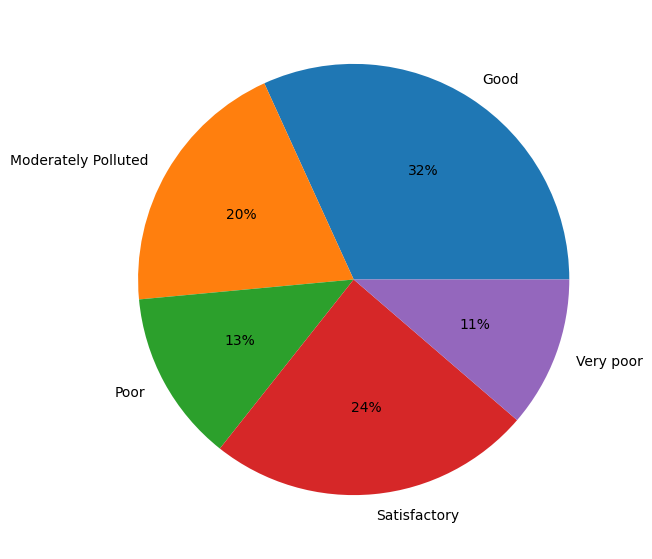

In [10]:
m = ballygunge['AQI_Standard'].value_counts()
stand =ballygunge['AQI_Standard'].unique()
count = []
for i in stand:
    count.append(m[i])

# Creating plot
fig = plt.figure(figsize =(10, 7))
plt.pie(count, labels = stand,autopct='%1.0f%%')
plt.show()

[]

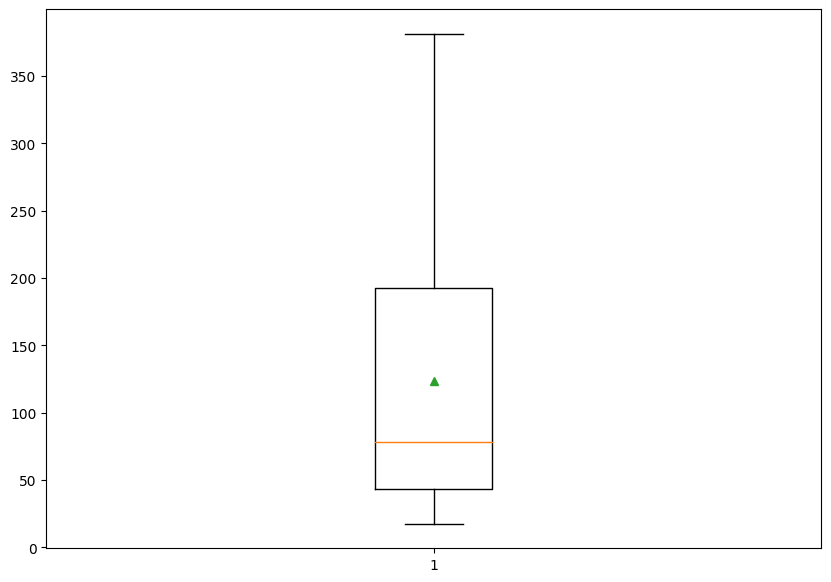

In [11]:
plt.figure(figsize =(10, 7))
plt.boxplot(ballygunge["AQI"],showmeans=True)
plt.plot()

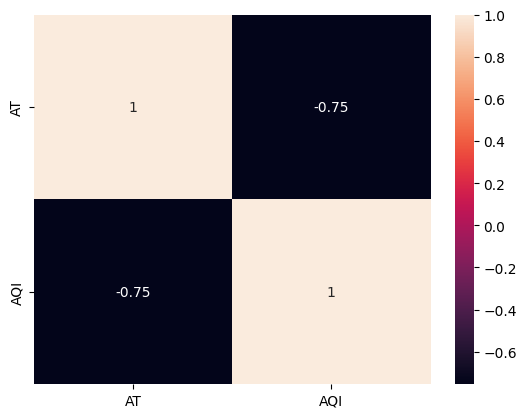

In [12]:
dataplot = sb.heatmap(ballygunge[['AT','AQI']].corr(), annot=True)
plt.show()

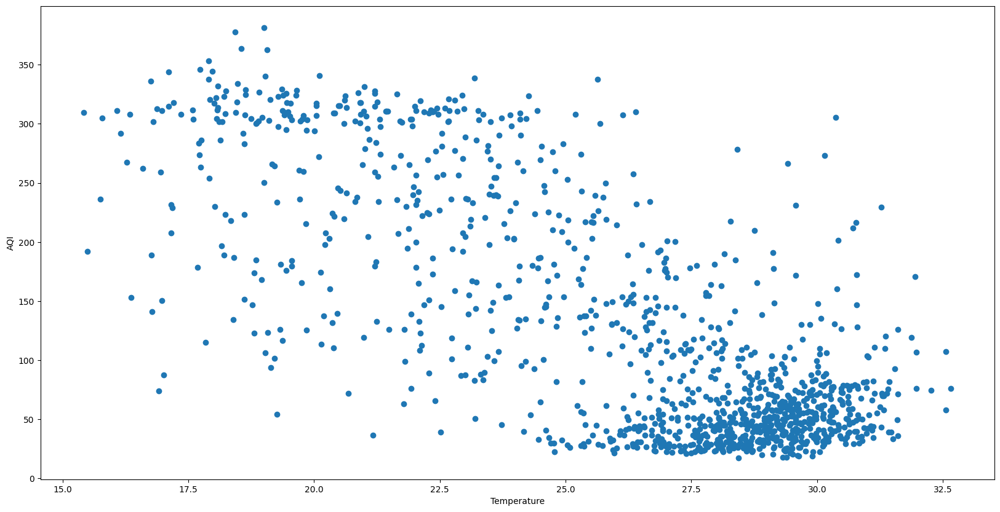

In [13]:
plt.figure(figsize=(20,10))
plt.scatter(x=ballygunge["AT"],y=ballygunge['AQI'])
plt.xlabel("Temperature")
plt.ylabel("AQI")
plt.show()

The total number of days are: 1220
The number of days PM2.5 was responsible for the AQI value was:- 462
The number of days PM10 was responsible for the AQI value was:- 547
The number of days NO2 was responsible for the AQI value was:- 19
The number of days NH3 was responsible for the AQI value was:- 0
The number of days SO2 was responsible for the AQI value was:- 7
The number of days CO was responsible for the AQI value was:- 23
The number of days Ozone was responsible for the AQI value was:- 162


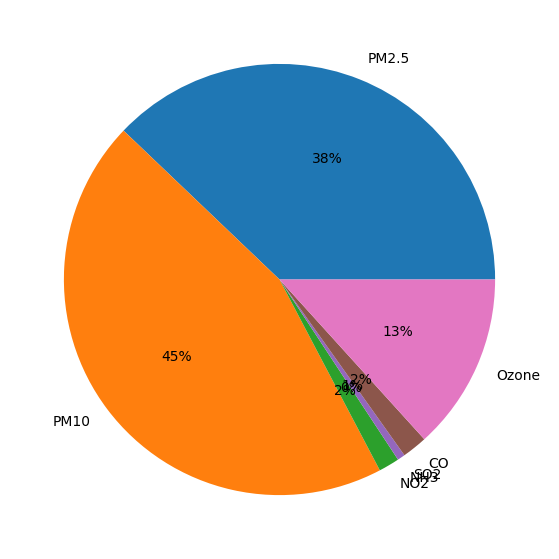

In [14]:
# Here we are finding which pollutant is responsible for how many day's AQI value
datetype(ballygunge)

##### From the frequency plot and unique AQI value counts below we can clearly see that only 685 days were having good or satisfactory air quality in a time period of 1220 days which is roughly about 56% of the entire time period.

Good                   388
Satisfactory           297
Moderately Polluted    240
Poor                   157
Very poor              138
Name: AQI_Standard, dtype: int64


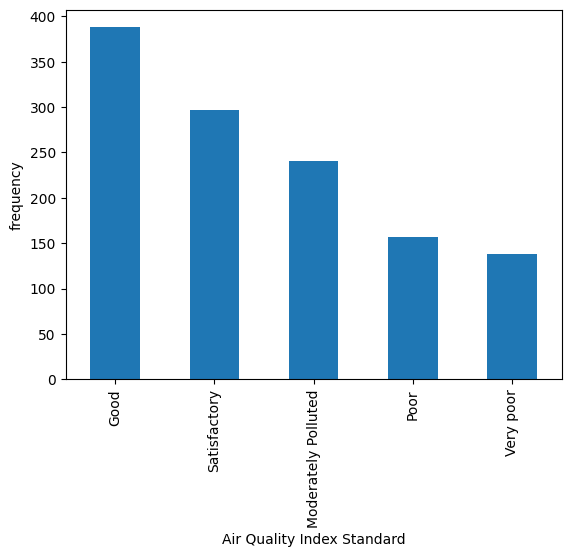

In [15]:
print(ballygunge['AQI_Standard'].value_counts())
ballygunge['AQI_Standard'].value_counts().plot(kind='bar', xlabel='Air Quality Index Standard', ylabel='frequency')
plt.show()

##### From the AQI value plot below of each day during the 1220 days we get a more clear understunding that only during the monsoon seasons the air quality was good and the worst quality is being seen in the winters. So now we will have to see which pullutats are resposible for this problem and then try to point out the activities causing them and if possile also try to state some solutions.

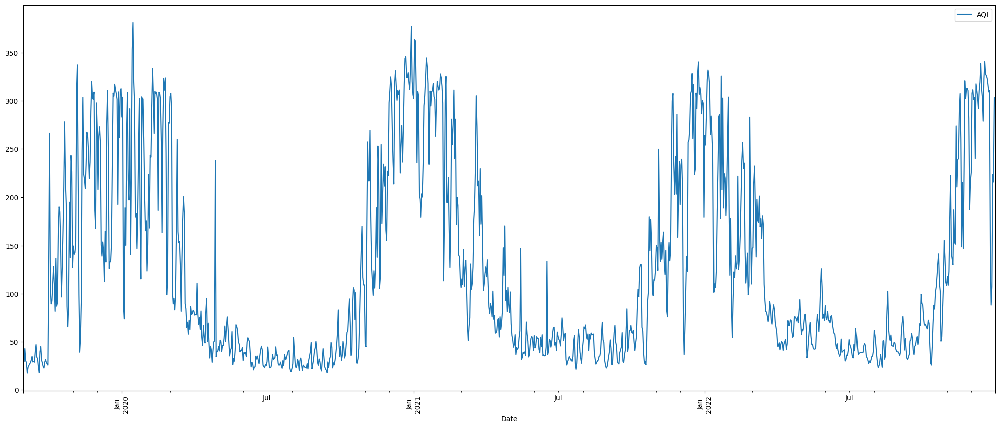

In [16]:
a = ballygunge.plot(x='Date',y='AQI',figsize=(25, 10))
plt.xticks(rotation='vertical')
plt.show()

The total number of days are: 388
The number of days PM2.5 was responsible for the AQI value was:- 7
The number of days PM10 was responsible for the AQI value was:- 220
The number of days NO2 was responsible for the AQI value was:- 19
The number of days NH3 was responsible for the AQI value was:- 0
The number of days SO2 was responsible for the AQI value was:- 7
The number of days CO was responsible for the AQI value was:- 16
The number of days Ozone was responsible for the AQI value was:- 119


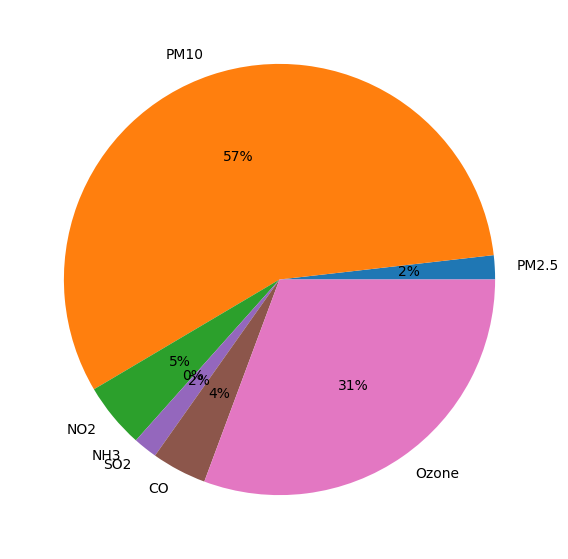

In [17]:
# Here we are finding which pollutant is responsible for how many Good days
rows = pd.DataFrame(columns=ballygunge.columns)
rows = pd.concat([ballygunge.loc[ballygunge["AQI_Standard"] == "Good"],rows],ignore_index=True)
datetype(rows)

The total number of days are: 297
The number of days PM2.5 was responsible for the AQI value was:- 20
The number of days PM10 was responsible for the AQI value was:- 227
The number of days NO2 was responsible for the AQI value was:- 0
The number of days NH3 was responsible for the AQI value was:- 0
The number of days SO2 was responsible for the AQI value was:- 0
The number of days CO was responsible for the AQI value was:- 7
The number of days Ozone was responsible for the AQI value was:- 43


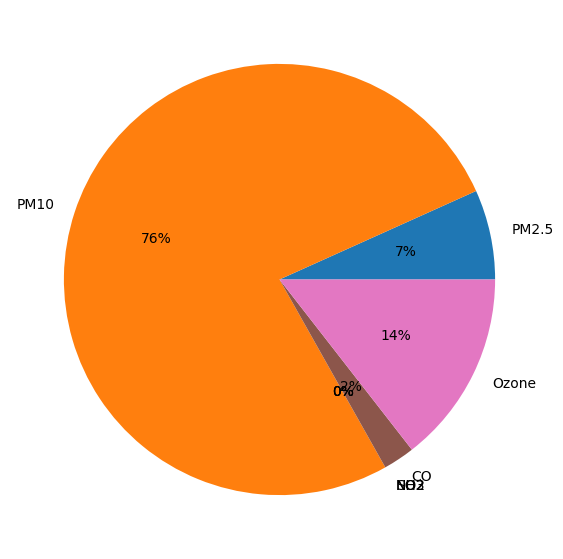

In [18]:
# Here we are finding which pollutant is responsible for how many Satisfactory days
rows = pd.DataFrame(columns=ballygunge.columns)
rows = pd.concat([ballygunge.loc[ballygunge["AQI_Standard"] == "Satisfactory"],rows],ignore_index=True)
datetype(rows)

The total number of days are: 240
The number of days PM2.5 was responsible for the AQI value was:- 143
The number of days PM10 was responsible for the AQI value was:- 97
The number of days NO2 was responsible for the AQI value was:- 0
The number of days NH3 was responsible for the AQI value was:- 0
The number of days SO2 was responsible for the AQI value was:- 0
The number of days CO was responsible for the AQI value was:- 0
The number of days Ozone was responsible for the AQI value was:- 0


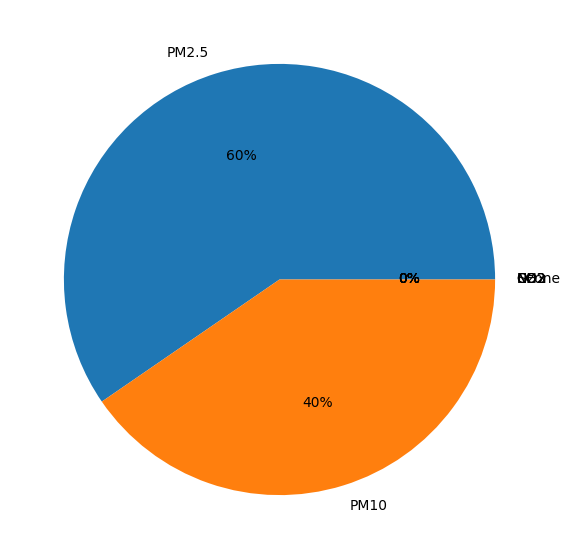

In [19]:
# Here we are finding which pollutant is responsible for how many Moderately Polluted days
rows = pd.DataFrame(columns=ballygunge.columns)
rows = pd.concat([ballygunge.loc[ballygunge["AQI_Standard"] == "Moderately Polluted"],rows],ignore_index=True)
datetype(rows)

The total number of days are: 157
The number of days PM2.5 was responsible for the AQI value was:- 154
The number of days PM10 was responsible for the AQI value was:- 3
The number of days NO2 was responsible for the AQI value was:- 0
The number of days NH3 was responsible for the AQI value was:- 0
The number of days SO2 was responsible for the AQI value was:- 0
The number of days CO was responsible for the AQI value was:- 0
The number of days Ozone was responsible for the AQI value was:- 0


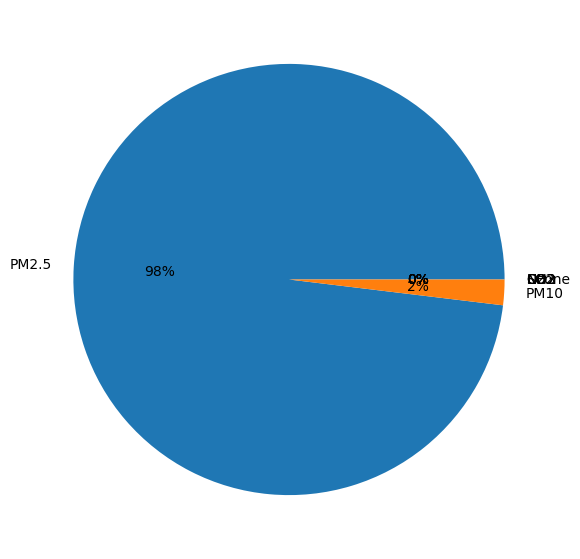

In [20]:
# Here we are finding which pollutant is responsible for how many Poor days
rows = pd.DataFrame(columns=ballygunge.columns)
rows = pd.concat([ballygunge.loc[ballygunge["AQI_Standard"] == "Poor"],rows],ignore_index=True)
datetype(rows)

The total number of days are: 138
The number of days PM2.5 was responsible for the AQI value was:- 138
The number of days PM10 was responsible for the AQI value was:- 0
The number of days NO2 was responsible for the AQI value was:- 0
The number of days NH3 was responsible for the AQI value was:- 0
The number of days SO2 was responsible for the AQI value was:- 0
The number of days CO was responsible for the AQI value was:- 0
The number of days Ozone was responsible for the AQI value was:- 0


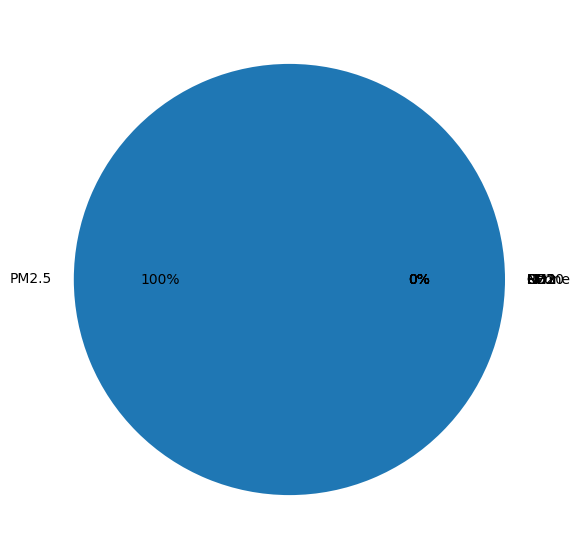

In [21]:
# Here we are finding which pollutant is responsible for how many Very poor days
rows = pd.DataFrame(columns=ballygunge.columns)
rows = pd.concat([ballygunge.loc[ballygunge["AQI_Standard"] == "Very poor"],rows],ignore_index=True)
datetype(rows)

### Year-wise AQI data insight

##### AQI 2019

In [22]:
print("######################## ballygunge_2019 ########################")
print ("When we look at the entire "+str(len(ballygunge_2019))+" days time period :-"+
       "\nThe highest value of AQI was ",ballygunge_2019["AQI"].max(),
       " recorded on", str(ballygunge_2019["Date"].loc[ballygunge_2019["AQI"] == ballygunge_2019["AQI"].max()])[4:15],
       ' and the lowest value was ',ballygunge_2019["AQI"].min(), 
       " recorded on",str(ballygunge_2019["Date"].loc[ballygunge_2019["AQI"] == ballygunge_2019["AQI"].min()])[4:15],
       "The Average AQI value between "+str(ballygunge_2019.iloc[0]['Date'])[:10]+" and "+
      str(ballygunge_2019.iloc[-1]['Date'])[:10]+" time period is "+str(round(ballygunge_2019["AQI"].mean(),2))+
      " which lies in the "+aqi(ballygunge_2019["AQI"].mean())+" range"+
      "\nThe AQI value has a standard deviation of "+str(round(ballygunge_2019["AQI"].std(),2)))

######################## ballygunge_2019 ########################
When we look at the entire 124 days time period :-
The highest value of AQI was  337.46  recorded on  2019-11-06  and the lowest value was  17.52  recorded on 2019-09-04
 The Average AQI value between 2019-08-30 and 2019-12-31 time period is 155.27 which lies in the Moderately Polluted range
The AQI value has a standard deviation of 101.35


Moderately Polluted    34
Good                   33
Poor                   28
Very poor              17
Satisfactory           12
Name: AQI_Standard, dtype: int64


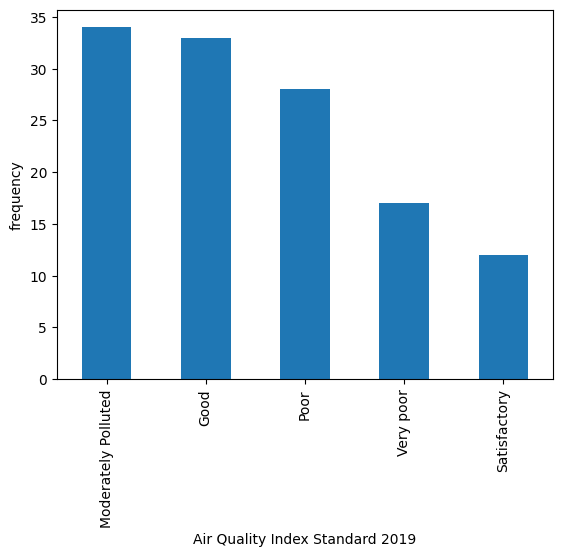

In [23]:
print(ballygunge_2019['AQI_Standard'].value_counts())
ballygunge_2019['AQI_Standard'].value_counts().plot(kind='bar', xlabel='Air Quality Index Standard 2019', ylabel='frequency')
plt.show()

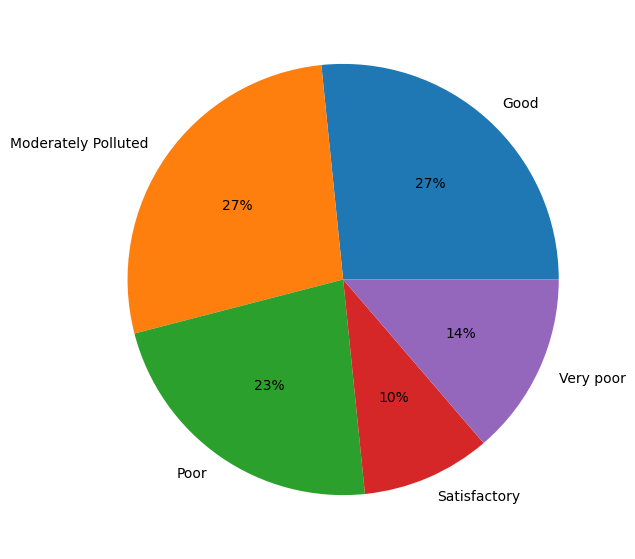

In [24]:
m = ballygunge_2019['AQI_Standard'].value_counts()
stand =ballygunge_2019['AQI_Standard'].unique()
count = []
for i in stand:
    count.append(m[i])

# Creating plot
fig = plt.figure(figsize =(10, 7))
plt.pie(count, labels = stand,autopct='%1.0f%%')
plt.show()

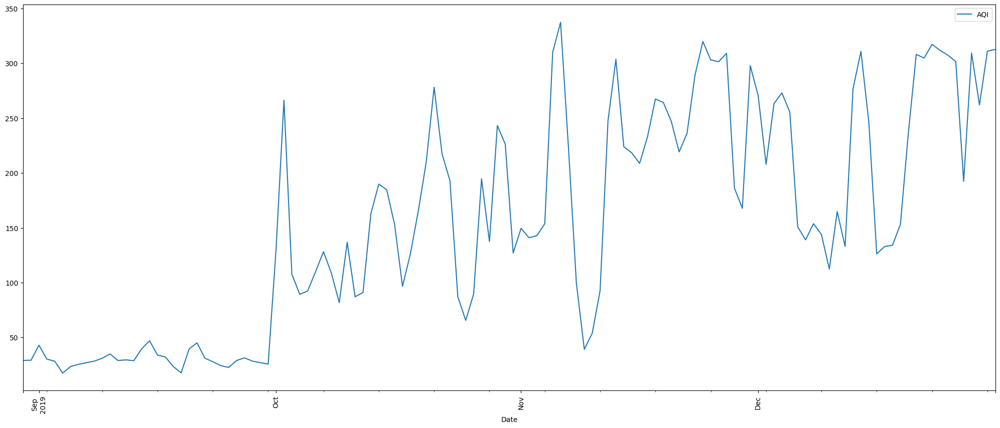

In [25]:
a = ballygunge_2019.plot(x='Date',y='AQI',figsize=(25, 10))
plt.xticks(rotation='vertical')
plt.show()

[]

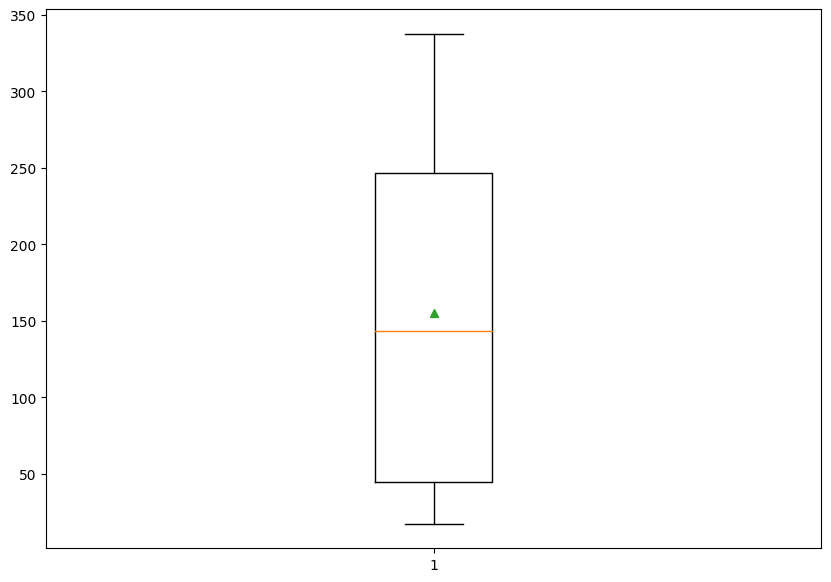

In [26]:
plt.figure(figsize =(10, 7))
plt.boxplot(ballygunge_2019["AQI"],showmeans=True)
plt.plot()

The total number of days are: 124
The number of days PM2.5 was responsible for the AQI value was:- 74
The number of days PM10 was responsible for the AQI value was:- 29
The number of days NO2 was responsible for the AQI value was:- 14
The number of days NH3 was responsible for the AQI value was:- 0
The number of days SO2 was responsible for the AQI value was:- 0
The number of days CO was responsible for the AQI value was:- 0
The number of days Ozone was responsible for the AQI value was:- 7


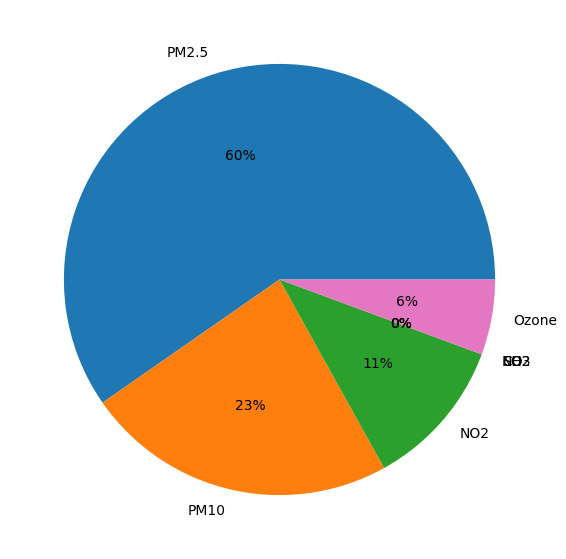

In [27]:
datetype(ballygunge_2019)

The total number of days are: 33
The number of days PM2.5 was responsible for the AQI value was:- 1
The number of days PM10 was responsible for the AQI value was:- 11
The number of days NO2 was responsible for the AQI value was:- 14
The number of days NH3 was responsible for the AQI value was:- 0
The number of days SO2 was responsible for the AQI value was:- 0
The number of days CO was responsible for the AQI value was:- 0
The number of days Ozone was responsible for the AQI value was:- 7


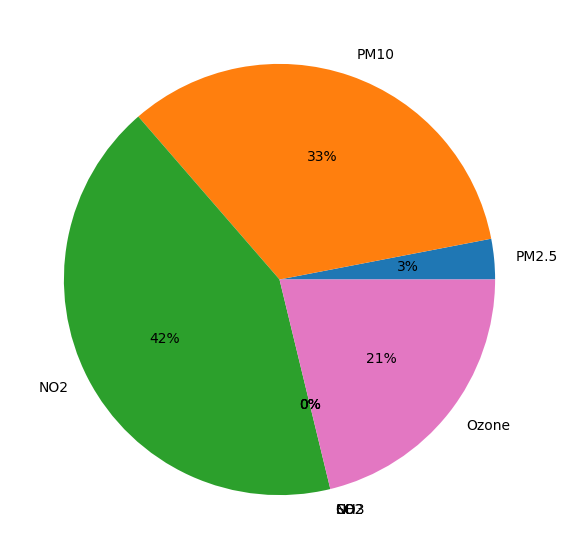

In [28]:
# Here we are finding which pollutant is responsible for how many Good days
rows = pd.DataFrame(columns=ballygunge_2019.columns)
rows = pd.concat([ballygunge_2019.loc[ballygunge_2019["AQI_Standard"] == "Good"],rows],ignore_index=True)
datetype(rows)

The total number of days are: 12
The number of days PM2.5 was responsible for the AQI value was:- 4
The number of days PM10 was responsible for the AQI value was:- 8
The number of days NO2 was responsible for the AQI value was:- 0
The number of days NH3 was responsible for the AQI value was:- 0
The number of days SO2 was responsible for the AQI value was:- 0
The number of days CO was responsible for the AQI value was:- 0
The number of days Ozone was responsible for the AQI value was:- 0


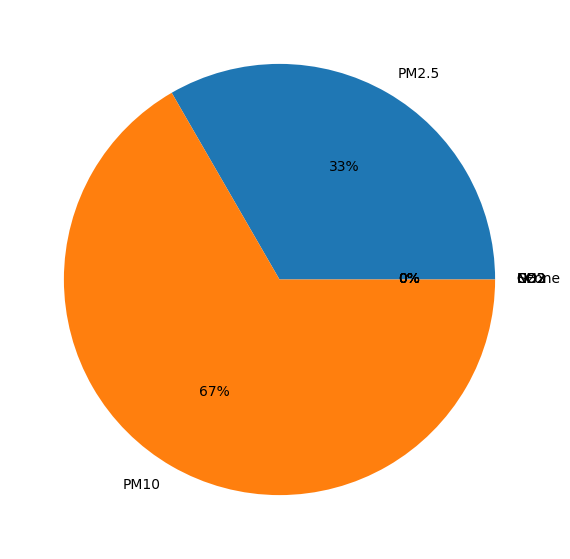

In [29]:
# Here we are finding which pollutant is responsible for how many Satisfactory days
rows = pd.DataFrame(columns=ballygunge_2019.columns)
rows = pd.concat([ballygunge_2019.loc[ballygunge_2019["AQI_Standard"] == "Satisfactory"],rows],ignore_index=True)
datetype(rows)

The total number of days are: 34
The number of days PM2.5 was responsible for the AQI value was:- 25
The number of days PM10 was responsible for the AQI value was:- 9
The number of days NO2 was responsible for the AQI value was:- 0
The number of days NH3 was responsible for the AQI value was:- 0
The number of days SO2 was responsible for the AQI value was:- 0
The number of days CO was responsible for the AQI value was:- 0
The number of days Ozone was responsible for the AQI value was:- 0


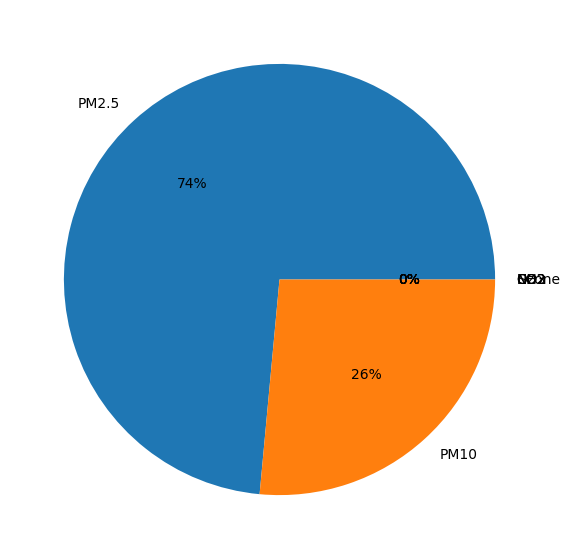

In [30]:
# Here we are finding which pollutant is responsible for how many Moderately Polluted days
rows = pd.DataFrame(columns=ballygunge_2019.columns)
rows = pd.concat([ballygunge_2019.loc[ballygunge_2019["AQI_Standard"] == "Moderately Polluted"],rows],ignore_index=True)
datetype(rows)

The total number of days are: 28
The number of days PM2.5 was responsible for the AQI value was:- 27
The number of days PM10 was responsible for the AQI value was:- 1
The number of days NO2 was responsible for the AQI value was:- 0
The number of days NH3 was responsible for the AQI value was:- 0
The number of days SO2 was responsible for the AQI value was:- 0
The number of days CO was responsible for the AQI value was:- 0
The number of days Ozone was responsible for the AQI value was:- 0


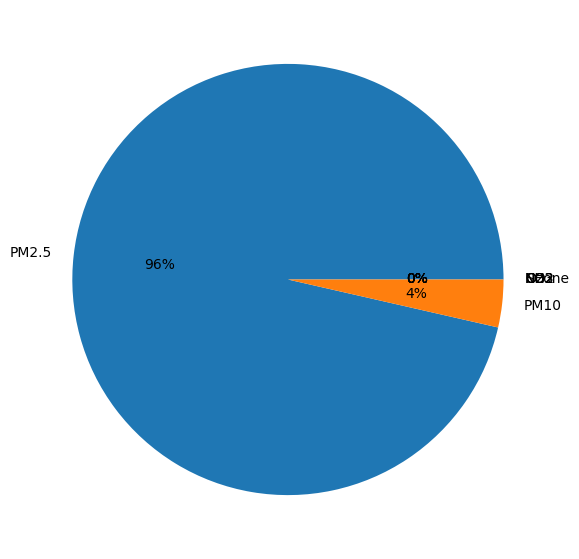

In [31]:
# Here we are finding which pollutant is responsible for how many Poor days
rows = pd.DataFrame(columns=ballygunge_2019.columns)
rows = pd.concat([ballygunge_2019.loc[ballygunge_2019["AQI_Standard"] == "Poor"],rows],ignore_index=True)
datetype(rows)

The total number of days are: 17
The number of days PM2.5 was responsible for the AQI value was:- 17
The number of days PM10 was responsible for the AQI value was:- 0
The number of days NO2 was responsible for the AQI value was:- 0
The number of days NH3 was responsible for the AQI value was:- 0
The number of days SO2 was responsible for the AQI value was:- 0
The number of days CO was responsible for the AQI value was:- 0
The number of days Ozone was responsible for the AQI value was:- 0


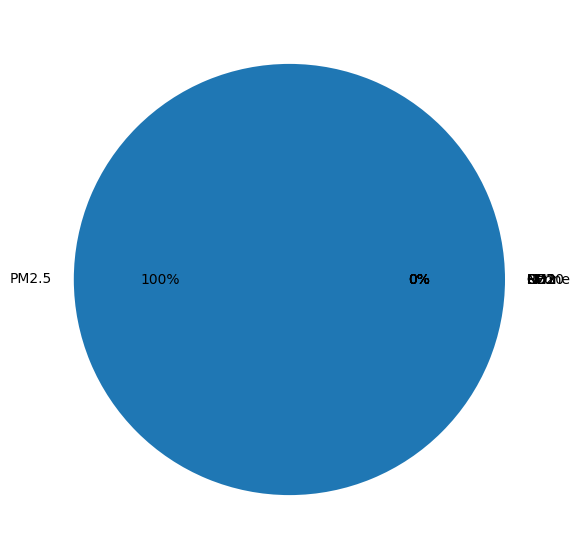

In [32]:
# Here we are finding which pollutant is responsible for how many Very Poor days
rows = pd.DataFrame(columns=ballygunge_2019.columns)
rows = pd.concat([ballygunge_2019.loc[ballygunge_2019["AQI_Standard"] == "Very poor"],rows],ignore_index=True)
datetype(rows)

#### AQI 2020

In [33]:
print("######################## ballygunge_2020 ########################")
print ("When we look at the entire "+str(len(ballygunge_2020))+" days time period :-"+
       "\nThe highest value of AQI was ",ballygunge_2020["AQI"].max(),
       " recorded on", str(ballygunge_2020["Date"].loc[ballygunge_2020["AQI"] == ballygunge_2020["AQI"].max()])[4:15],
       ' and the lowest value was ',ballygunge_2020["AQI"].min(), 
       " recorded on",str(ballygunge_2020["Date"].loc[ballygunge_2020["AQI"] == ballygunge_2020["AQI"].min()])[4:15],'.'+
       "\nThe Average AQI value between "+str(ballygunge_2020.iloc[0]['Date'])[:10]+" and "+
      str(ballygunge_2020.iloc[-1]['Date'])[:10]+" time period is "+str(round(ballygunge_2020["AQI"].mean(),2))+
      " which lies in the "+aqi(ballygunge_2020["AQI"].mean())+" range."+
      "\nThe AQI value has a standard deviation of "+str(round(ballygunge_2020["AQI"].std(),2)))

######################## ballygunge_2020 ########################
When we look at the entire 366 days time period :-
The highest value of AQI was  381.47  recorded on  2020-01-15  and the lowest value was  18.0  recorded on   2020-09-1 .
The Average AQI value between 2020-01-01 and 2020-12-31 time period is 116.64 which lies in the Moderately Polluted range.
The AQI value has a standard deviation of 104.59


Good                   159
Satisfactory            66
Moderately Polluted     52
Poor                    45
Very poor               44
Name: AQI_Standard, dtype: int64


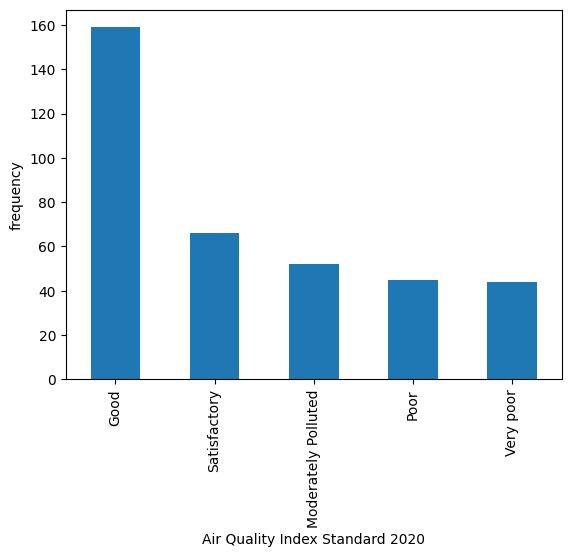

In [34]:
print(ballygunge_2020['AQI_Standard'].value_counts())
ballygunge_2020['AQI_Standard'].value_counts().plot(kind='bar', xlabel='Air Quality Index Standard 2020', ylabel='frequency')
plt.show()

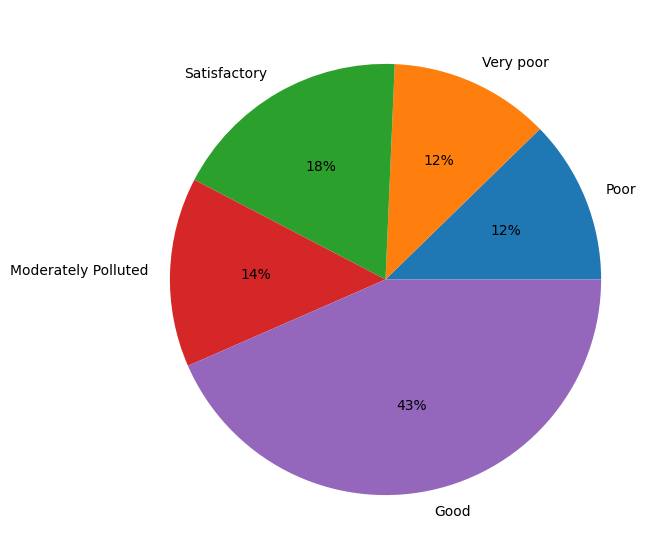

In [35]:
m = ballygunge_2020['AQI_Standard'].value_counts()
stand =ballygunge_2020['AQI_Standard'].unique()
count = []
for i in stand:
    count.append(m[i])

# Creating plot
fig = plt.figure(figsize =(10, 7))
plt.pie(count, labels = stand,autopct='%1.0f%%')
plt.show()

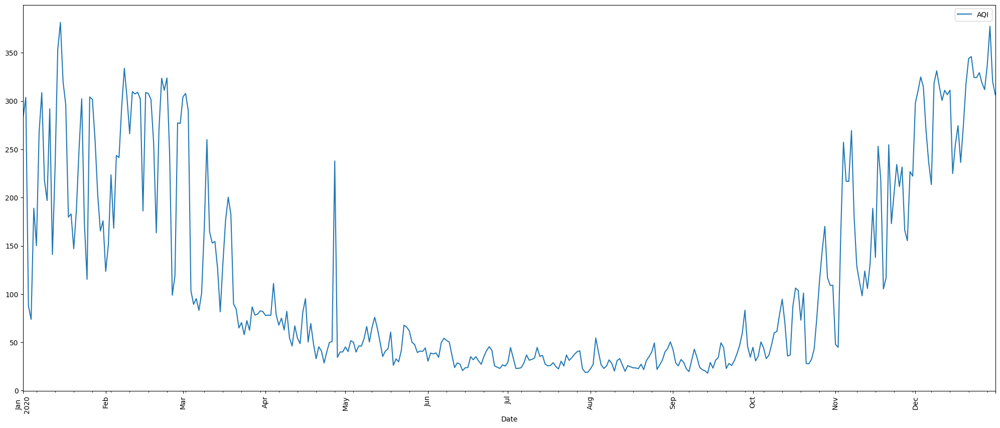

In [36]:
a = ballygunge_2020.plot(x='Date',y='AQI',figsize=(25, 10))
plt.xticks(rotation='vertical')
plt.show()

[]

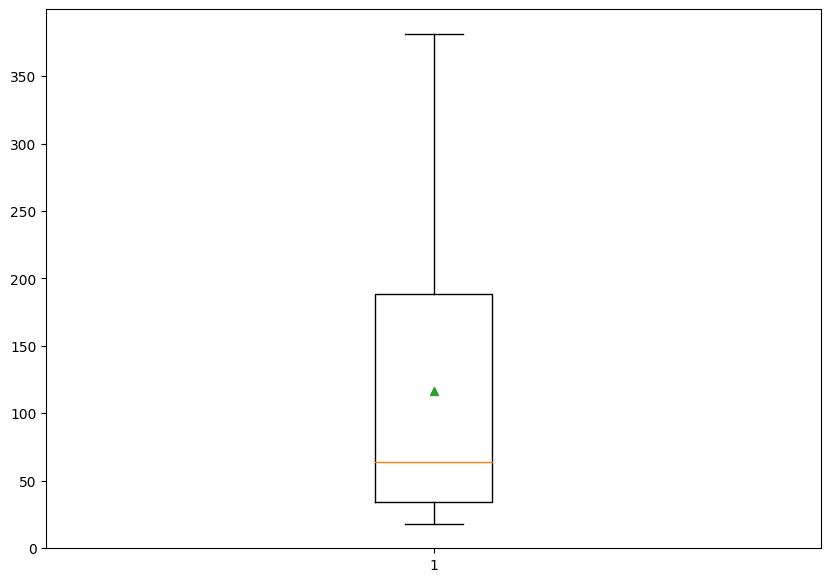

In [37]:
plt.figure(figsize =(10, 7))
plt.boxplot(ballygunge_2020["AQI"],showmeans=True)
plt.plot()

The total number of days are: 366
The number of days PM2.5 was responsible for the AQI value was:- 123
The number of days PM10 was responsible for the AQI value was:- 159
The number of days NO2 was responsible for the AQI value was:- 0
The number of days NH3 was responsible for the AQI value was:- 0
The number of days SO2 was responsible for the AQI value was:- 7
The number of days CO was responsible for the AQI value was:- 10
The number of days Ozone was responsible for the AQI value was:- 67


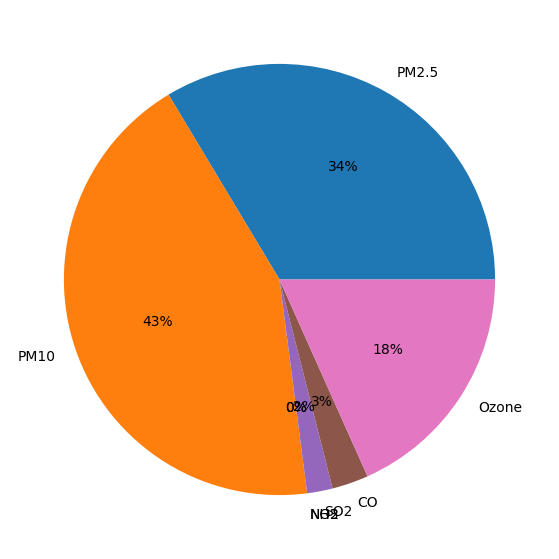

In [38]:
datetype(ballygunge_2020)

The total number of days are: 159
The number of days PM2.5 was responsible for the AQI value was:- 1
The number of days PM10 was responsible for the AQI value was:- 87
The number of days NO2 was responsible for the AQI value was:- 0
The number of days NH3 was responsible for the AQI value was:- 0
The number of days SO2 was responsible for the AQI value was:- 7
The number of days CO was responsible for the AQI value was:- 10
The number of days Ozone was responsible for the AQI value was:- 54


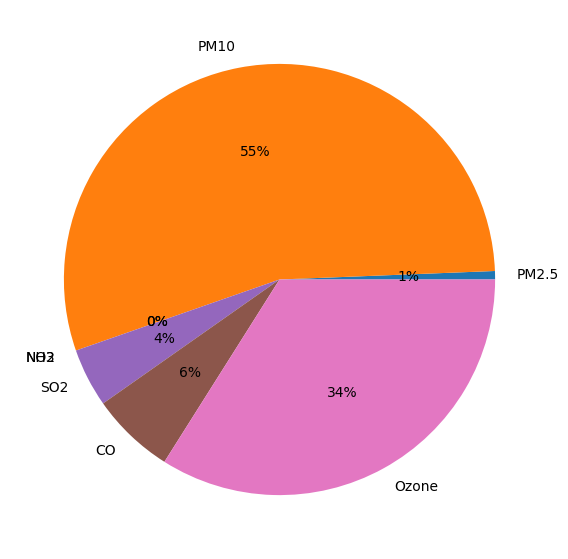

In [39]:
# Here we are finding which pollutant is responsible for how many Good days
rows = pd.DataFrame(columns=ballygunge_2020.columns)
rows = pd.concat([ballygunge_2020.loc[ballygunge_2020["AQI_Standard"] == "Good"],rows],ignore_index=True)
datetype(rows)

The total number of days are: 66
The number of days PM2.5 was responsible for the AQI value was:- 4
The number of days PM10 was responsible for the AQI value was:- 49
The number of days NO2 was responsible for the AQI value was:- 0
The number of days NH3 was responsible for the AQI value was:- 0
The number of days SO2 was responsible for the AQI value was:- 0
The number of days CO was responsible for the AQI value was:- 0
The number of days Ozone was responsible for the AQI value was:- 13


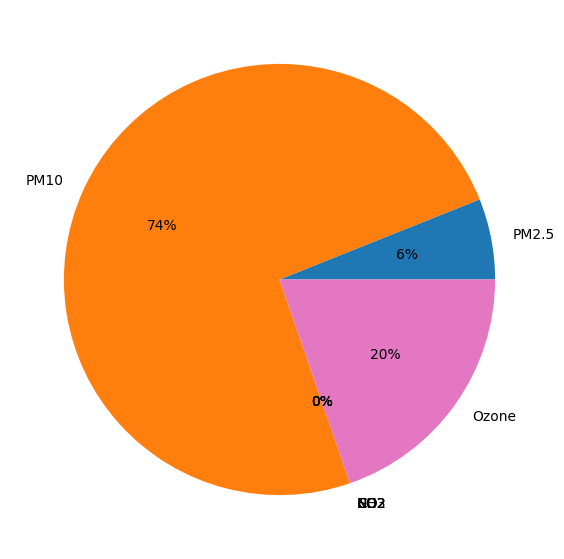

In [40]:
# Here we are finding which pollutant is responsible for how many Satisfactory days
rows = pd.DataFrame(columns=ballygunge_2020.columns)
rows = pd.concat([ballygunge_2020.loc[ballygunge_2020["AQI_Standard"] == "Satisfactory"],rows],ignore_index=True)
datetype(rows)

The total number of days are: 52
The number of days PM2.5 was responsible for the AQI value was:- 31
The number of days PM10 was responsible for the AQI value was:- 21
The number of days NO2 was responsible for the AQI value was:- 0
The number of days NH3 was responsible for the AQI value was:- 0
The number of days SO2 was responsible for the AQI value was:- 0
The number of days CO was responsible for the AQI value was:- 0
The number of days Ozone was responsible for the AQI value was:- 0


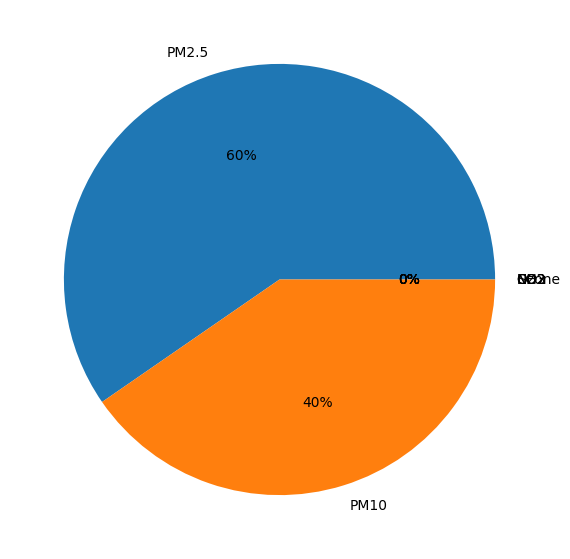

In [41]:
# Here we are finding which pollutant is responsible for how many Moderately Polluted days
rows = pd.DataFrame(columns=ballygunge_2020.columns)
rows = pd.concat([ballygunge_2020.loc[ballygunge_2020["AQI_Standard"] == "Moderately Polluted"],rows],ignore_index=True)
datetype(rows)

The total number of days are: 45
The number of days PM2.5 was responsible for the AQI value was:- 43
The number of days PM10 was responsible for the AQI value was:- 2
The number of days NO2 was responsible for the AQI value was:- 0
The number of days NH3 was responsible for the AQI value was:- 0
The number of days SO2 was responsible for the AQI value was:- 0
The number of days CO was responsible for the AQI value was:- 0
The number of days Ozone was responsible for the AQI value was:- 0


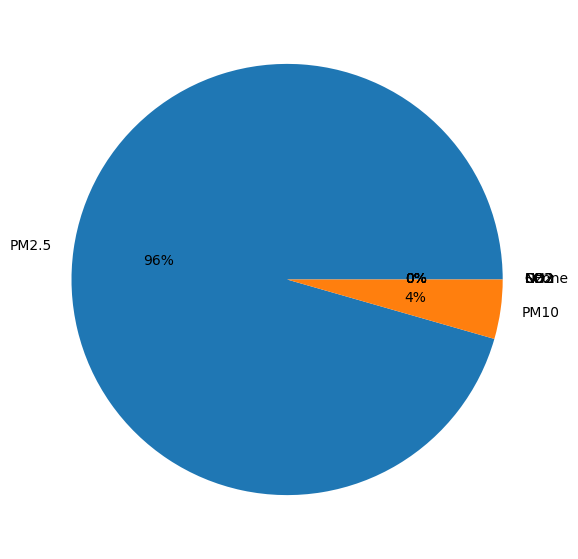

In [42]:
# Here we are finding which pollutant is responsible for how many Poor days
rows = pd.DataFrame(columns=ballygunge_2020.columns)
rows = pd.concat([ballygunge_2020.loc[ballygunge_2020["AQI_Standard"] == "Poor"],rows],ignore_index=True)
datetype(rows)

The total number of days are: 44
The number of days PM2.5 was responsible for the AQI value was:- 44
The number of days PM10 was responsible for the AQI value was:- 0
The number of days NO2 was responsible for the AQI value was:- 0
The number of days NH3 was responsible for the AQI value was:- 0
The number of days SO2 was responsible for the AQI value was:- 0
The number of days CO was responsible for the AQI value was:- 0
The number of days Ozone was responsible for the AQI value was:- 0


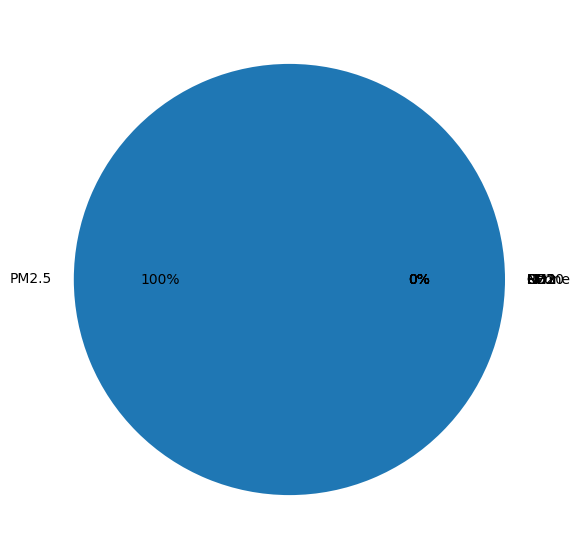

In [43]:
# Here we are finding which pollutant is responsible for how many Very poor days
rows = pd.DataFrame(columns=ballygunge_2020.columns)
rows = pd.concat([ballygunge_2020.loc[ballygunge_2020["AQI_Standard"] == "Very poor"],rows],ignore_index=True)
datetype(rows)

#### AQI 2021

In [44]:
print("######################## ballygunge_2021 ########################")
print ("When we look at the entire "+str(len(ballygunge_2021))+" days time period :-"+
       "\nThe highest value of AQI was ",ballygunge_2021["AQI"].max(),
       " recorded on", str(ballygunge_2021["Date"].loc[ballygunge_2021["AQI"] == ballygunge_2021["AQI"].max()])[4:15],
       'and the lowest value was ',ballygunge_2021["AQI"].min(), 
       " recorded on",str(ballygunge_2021["Date"].loc[ballygunge_2021["AQI"] == ballygunge_2021["AQI"].min()])[4:15],'.'+
       "\nThe Average AQI value between "+str(ballygunge_2021.iloc[0]['Date'])[:10]+" and "+
      str(ballygunge_2021.iloc[-1]['Date'])[:10]+" time period is "+str(round(ballygunge_2021["AQI"].mean(),2))+
      " which lies in the "+aqi(ballygunge_2021["AQI"].mean())+" range."+
      "\nThe AQI value has a standard deviation of "+str(round(ballygunge_2021["AQI"].std(),2)))

######################## ballygunge_2021 ########################
When we look at the entire 365 days time period :-
The highest value of AQI was  363.78  recorded on 2021-01-02
 and the lowest value was  21.41  recorded on   2021-07-2 .
The Average AQI value between 2021-01-01 and 2021-12-31 time period is 124.61 which lies in the Moderately Polluted range.
The AQI value has a standard deviation of 97.01


Satisfactory           102
Good                    95
Moderately Polluted     83
Poor                    43
Very poor               42
Name: AQI_Standard, dtype: int64


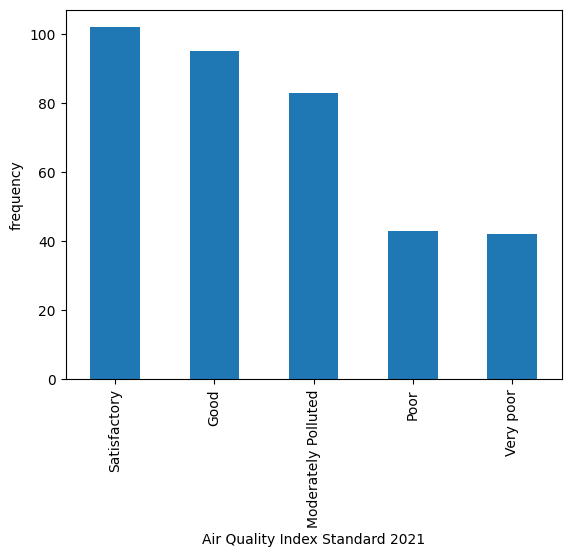

In [45]:
print(ballygunge_2021['AQI_Standard'].value_counts())
ballygunge_2021['AQI_Standard'].value_counts().plot(kind='bar', xlabel='Air Quality Index Standard 2021', ylabel='frequency')
plt.show()

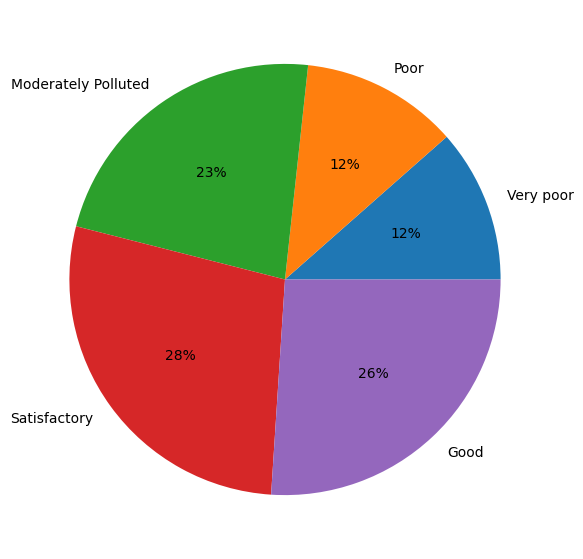

In [46]:
m = ballygunge_2021['AQI_Standard'].value_counts()
stand =ballygunge_2021['AQI_Standard'].unique()
count = []
for i in stand:
    count.append(m[i])

# Creating plot
fig = plt.figure(figsize =(10, 7))
plt.pie(count, labels = stand,autopct='%1.0f%%')
plt.show()

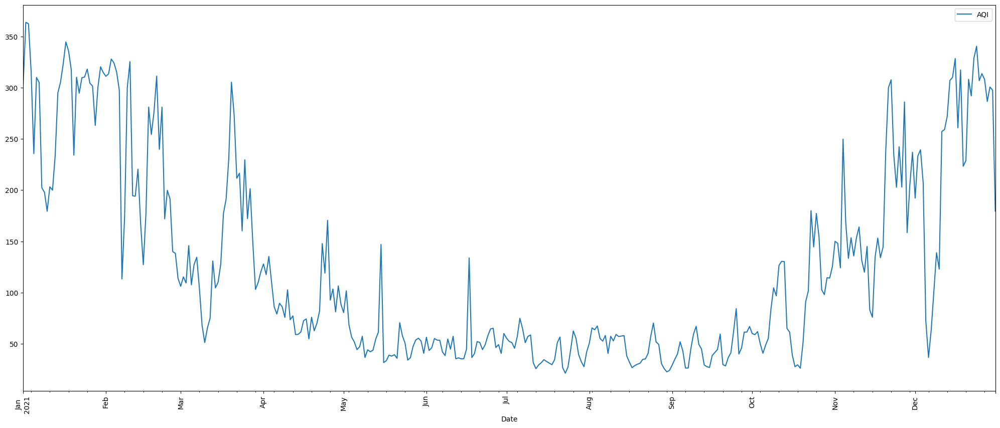

In [47]:
a = ballygunge_2021.plot(x='Date',y='AQI',figsize=(25, 10))
plt.xticks(rotation='vertical')
plt.show()

[]

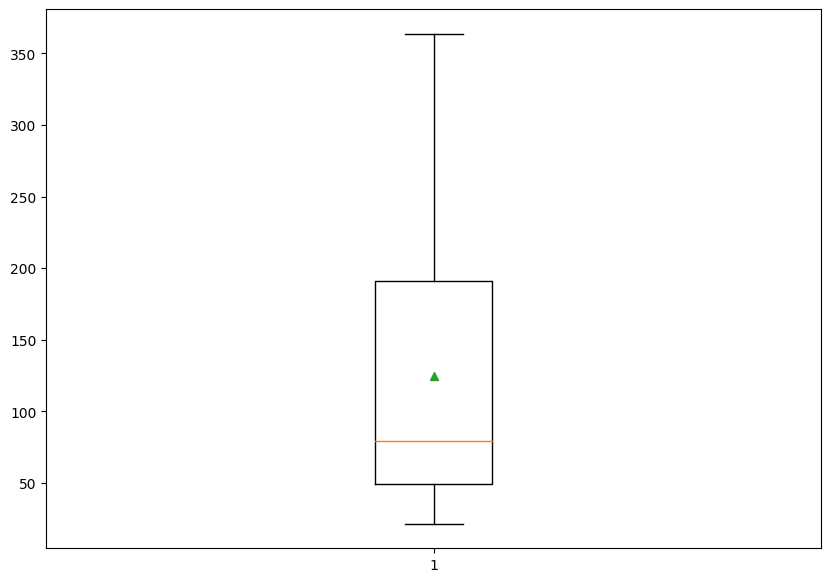

In [48]:
plt.figure(figsize =(10, 7))
plt.boxplot(ballygunge_2021["AQI"],showmeans=True)
plt.plot()

The total number of days are: 365
The number of days PM2.5 was responsible for the AQI value was:- 138
The number of days PM10 was responsible for the AQI value was:- 194
The number of days NO2 was responsible for the AQI value was:- 1
The number of days NH3 was responsible for the AQI value was:- 0
The number of days SO2 was responsible for the AQI value was:- 0
The number of days CO was responsible for the AQI value was:- 13
The number of days Ozone was responsible for the AQI value was:- 19


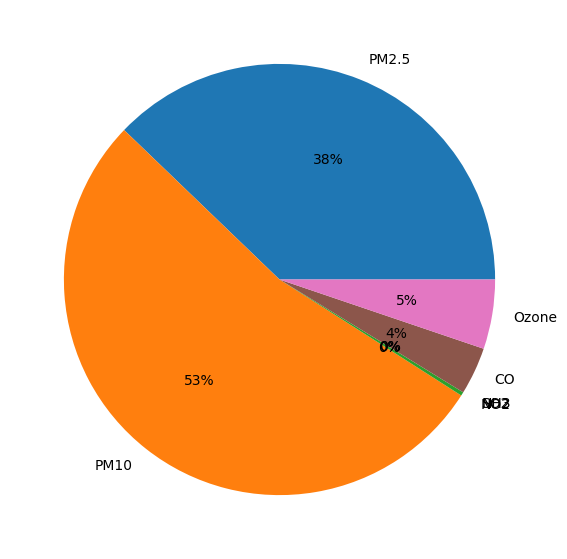

In [49]:
datetype(ballygunge_2021)

The total number of days are: 95
The number of days PM2.5 was responsible for the AQI value was:- 2
The number of days PM10 was responsible for the AQI value was:- 73
The number of days NO2 was responsible for the AQI value was:- 1
The number of days NH3 was responsible for the AQI value was:- 0
The number of days SO2 was responsible for the AQI value was:- 0
The number of days CO was responsible for the AQI value was:- 6
The number of days Ozone was responsible for the AQI value was:- 13


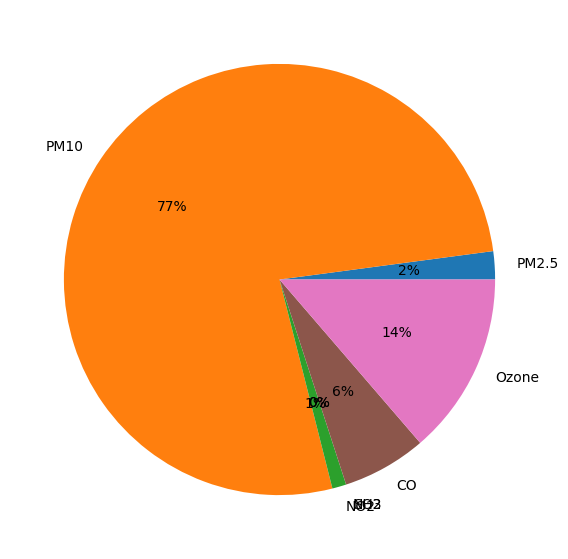

In [50]:
# Here we are finding which pollutant is responsible for how many Good days
rows = pd.DataFrame(columns=ballygunge_2021.columns)
rows = pd.concat([ballygunge_2021.loc[ballygunge_2021["AQI_Standard"] == "Good"],rows],ignore_index=True)
datetype(rows)

The total number of days are: 102
The number of days PM2.5 was responsible for the AQI value was:- 7
The number of days PM10 was responsible for the AQI value was:- 82
The number of days NO2 was responsible for the AQI value was:- 0
The number of days NH3 was responsible for the AQI value was:- 0
The number of days SO2 was responsible for the AQI value was:- 0
The number of days CO was responsible for the AQI value was:- 7
The number of days Ozone was responsible for the AQI value was:- 6


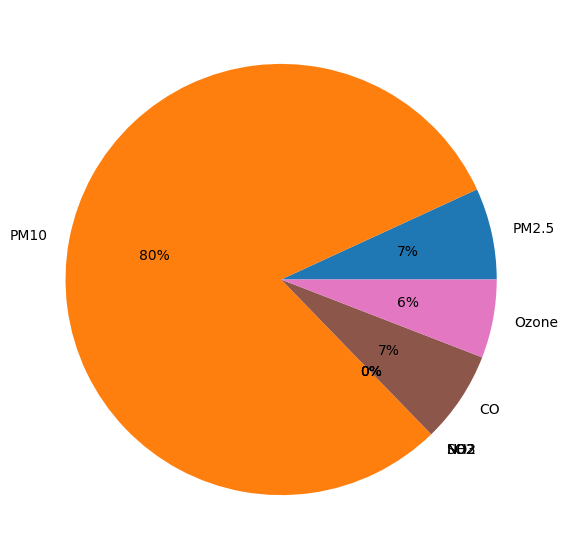

In [51]:
# Here we are finding which pollutant is responsible for how many Satisfactory days
rows = pd.DataFrame(columns=ballygunge_2021.columns)
rows = pd.concat([ballygunge_2021.loc[ballygunge_2021["AQI_Standard"] == "Satisfactory"],rows],ignore_index=True)
datetype(rows)

The total number of days are: 83
The number of days PM2.5 was responsible for the AQI value was:- 44
The number of days PM10 was responsible for the AQI value was:- 39
The number of days NO2 was responsible for the AQI value was:- 0
The number of days NH3 was responsible for the AQI value was:- 0
The number of days SO2 was responsible for the AQI value was:- 0
The number of days CO was responsible for the AQI value was:- 0
The number of days Ozone was responsible for the AQI value was:- 0


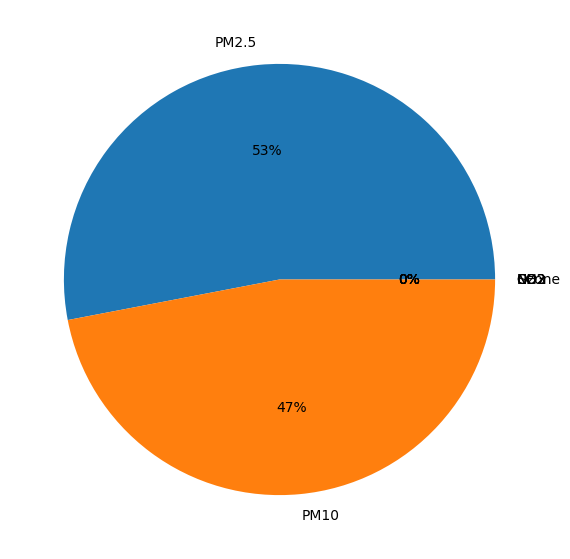

In [52]:
# Here we are finding which pollutant is responsible for how many Moderately Polluted days
rows = pd.DataFrame(columns=ballygunge_2021.columns)
rows = pd.concat([ballygunge_2021.loc[ballygunge_2021["AQI_Standard"] == "Moderately Polluted"],rows],ignore_index=True)
datetype(rows)

The total number of days are: 43
The number of days PM2.5 was responsible for the AQI value was:- 43
The number of days PM10 was responsible for the AQI value was:- 0
The number of days NO2 was responsible for the AQI value was:- 0
The number of days NH3 was responsible for the AQI value was:- 0
The number of days SO2 was responsible for the AQI value was:- 0
The number of days CO was responsible for the AQI value was:- 0
The number of days Ozone was responsible for the AQI value was:- 0


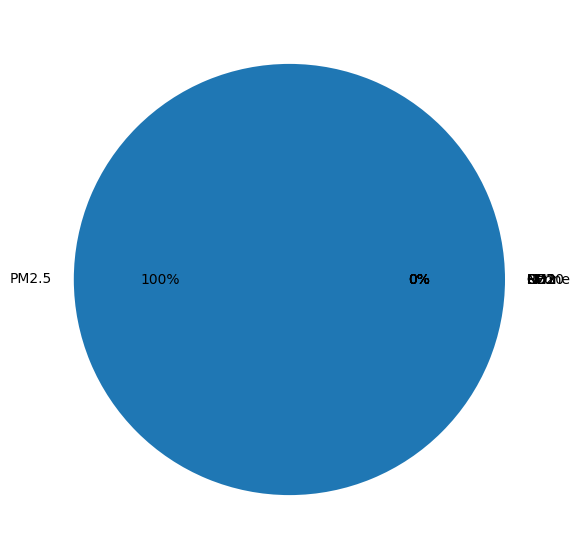

In [53]:
# Here we are finding which pollutant is responsible for how many Poor days
rows = pd.DataFrame(columns=ballygunge_2021.columns)
rows = pd.concat([ballygunge_2021.loc[ballygunge_2021["AQI_Standard"] == "Poor"],rows],ignore_index=True)
datetype(rows)

The total number of days are: 42
The number of days PM2.5 was responsible for the AQI value was:- 42
The number of days PM10 was responsible for the AQI value was:- 0
The number of days NO2 was responsible for the AQI value was:- 0
The number of days NH3 was responsible for the AQI value was:- 0
The number of days SO2 was responsible for the AQI value was:- 0
The number of days CO was responsible for the AQI value was:- 0
The number of days Ozone was responsible for the AQI value was:- 0


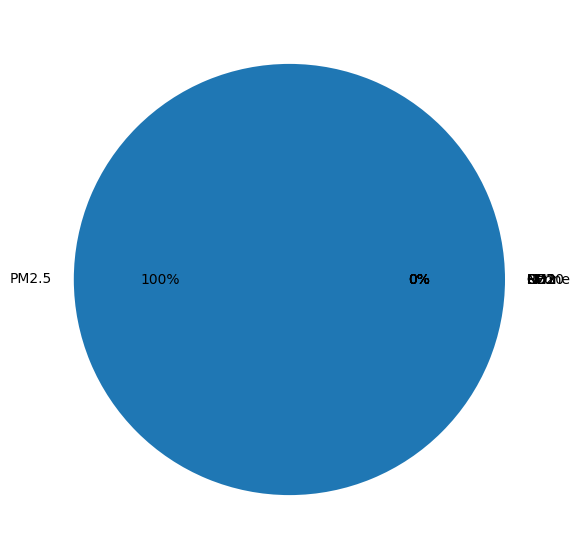

In [54]:
# Here we are finding which pollutant is responsible for how many Very poor days
rows = pd.DataFrame(columns=ballygunge_2021.columns)
rows = pd.concat([ballygunge_2021.loc[ballygunge_2021["AQI_Standard"] == "Very poor"],rows],ignore_index=True)
datetype(rows)

#### AQI 2022

In [55]:
print("######################## ballygunge_2022 ########################")
print ("When we look at the entire "+str(len(ballygunge_2022))+" days time period :-"+
       "\nThe highest value of AQI was ",ballygunge_2022["AQI"].max(),
       " recorded on", str(ballygunge_2022["Date"].loc[ballygunge_2022["AQI"] == ballygunge_2022["AQI"].max()])[4:15],
       ' and the lowest value was ',ballygunge_2022["AQI"].min(), 
       " recorded on",str(ballygunge_2022["Date"].loc[ballygunge_2022["AQI"] == ballygunge_2022["AQI"].min()])[4:15],'.'+
       "\nThe Average AQI value between "+str(ballygunge_2022.iloc[0]['Date'])[:10]+" and "+
      str(ballygunge_2022.iloc[-1]['Date'])[:10]+" time period is "+str(round(ballygunge_2022["AQI"].mean(),2))+
      " which lies in the "+aqi(ballygunge_2022["AQI"].mean())+" range."+
      "\nThe AQI value has a standard deviation of "+str(round(ballygunge_2022["AQI"].std(),2)))

######################## ballygunge_2022 ########################
When we look at the entire 365 days time period :-
The highest value of AQI was  340.83  recorded on   2022-12-1  and the lowest value was  23.32  recorded on   2022-08-0 .
The Average AQI value between 2022-01-01 and 2022-12-31 time period is 118.29 which lies in the Moderately Polluted range.
The AQI value has a standard deviation of 91.91


Satisfactory           117
Good                   101
Moderately Polluted     71
Poor                    41
Very poor               35
Name: AQI_Standard, dtype: int64


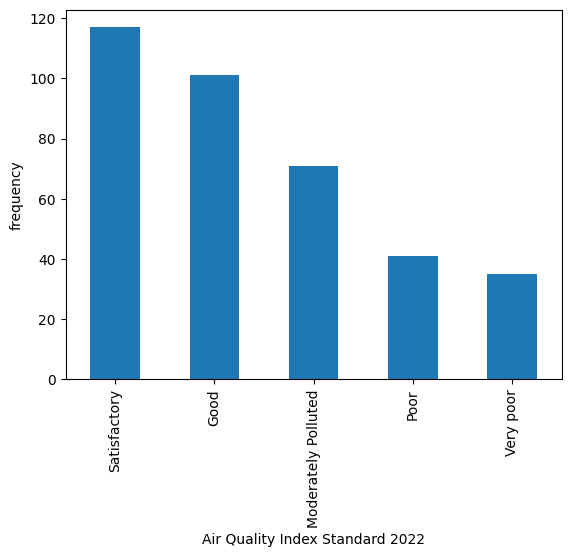

In [56]:
print(ballygunge_2022['AQI_Standard'].value_counts())
ballygunge_2022['AQI_Standard'].value_counts().plot(kind='bar', xlabel='Air Quality Index Standard 2022', ylabel='frequency')
plt.show()

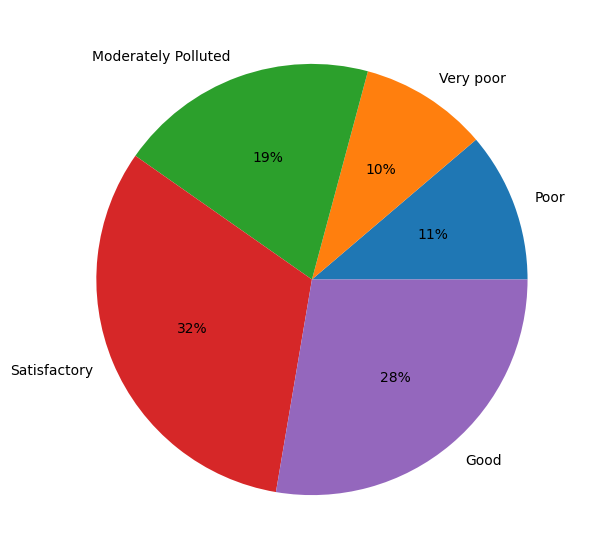

In [57]:
m = ballygunge_2022['AQI_Standard'].value_counts()
stand =ballygunge_2022['AQI_Standard'].unique()
count = []
for i in stand:
    count.append(m[i])

# Creating plot
fig = plt.figure(figsize =(10, 7))
plt.pie(count, labels = stand,autopct='%1.0f%%')
plt.show()

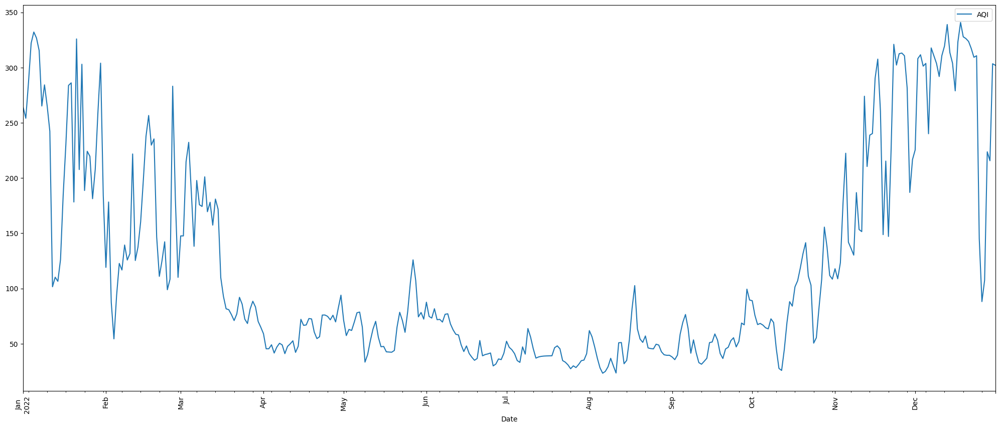

In [58]:
a = ballygunge_2022.plot(x='Date',y='AQI',figsize=(25, 10))
plt.xticks(rotation='vertical')
plt.show()

[]

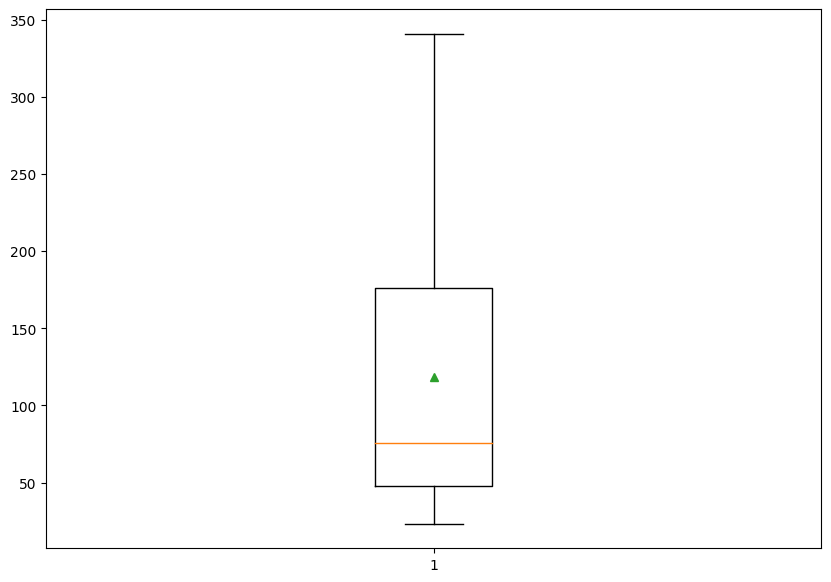

In [59]:
plt.figure(figsize =(10, 7))
plt.boxplot(ballygunge_2022["AQI"],showmeans=True)
plt.plot()

The total number of days are: 365
The number of days PM2.5 was responsible for the AQI value was:- 127
The number of days PM10 was responsible for the AQI value was:- 165
The number of days NO2 was responsible for the AQI value was:- 4
The number of days NH3 was responsible for the AQI value was:- 0
The number of days SO2 was responsible for the AQI value was:- 0
The number of days CO was responsible for the AQI value was:- 0
The number of days Ozone was responsible for the AQI value was:- 69


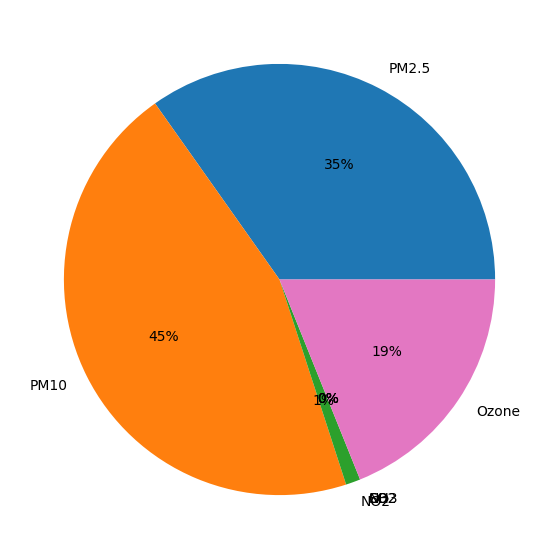

In [60]:
datetype(ballygunge_2022)

The total number of days are: 101
The number of days PM2.5 was responsible for the AQI value was:- 3
The number of days PM10 was responsible for the AQI value was:- 49
The number of days NO2 was responsible for the AQI value was:- 4
The number of days NH3 was responsible for the AQI value was:- 0
The number of days SO2 was responsible for the AQI value was:- 0
The number of days CO was responsible for the AQI value was:- 0
The number of days Ozone was responsible for the AQI value was:- 45


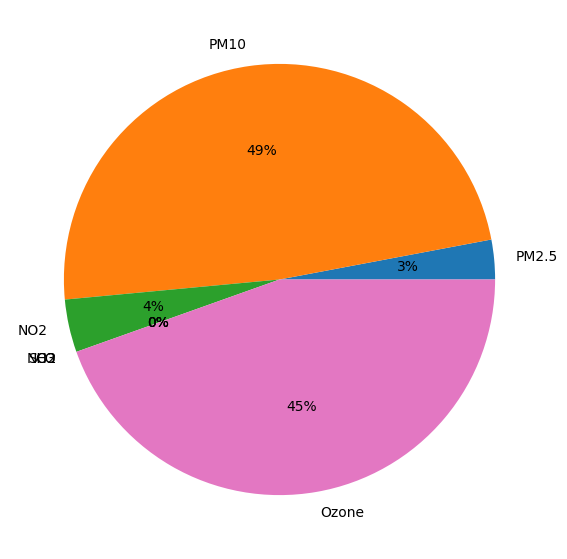

In [61]:
# Here we are finding which pollutant is responsible for how many Good days
rows = pd.DataFrame(columns=ballygunge_2022.columns)
rows = pd.concat([ballygunge_2022.loc[ballygunge_2022["AQI_Standard"] == "Good"],rows],ignore_index=True)
datetype(rows)

The total number of days are: 117
The number of days PM2.5 was responsible for the AQI value was:- 5
The number of days PM10 was responsible for the AQI value was:- 88
The number of days NO2 was responsible for the AQI value was:- 0
The number of days NH3 was responsible for the AQI value was:- 0
The number of days SO2 was responsible for the AQI value was:- 0
The number of days CO was responsible for the AQI value was:- 0
The number of days Ozone was responsible for the AQI value was:- 24


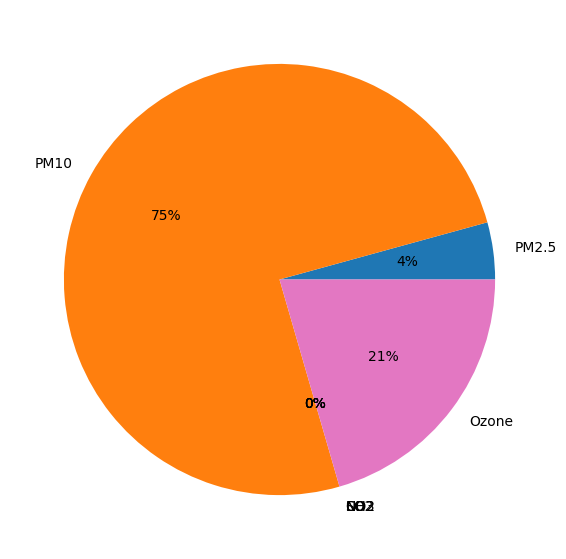

In [62]:
# Here we are finding which pollutant is responsible for how many Satisfactory days
rows = pd.DataFrame(columns=ballygunge_2022.columns)
rows = pd.concat([ballygunge_2022.loc[ballygunge_2022["AQI_Standard"] == "Satisfactory"],rows],ignore_index=True)
datetype(rows)

The total number of days are: 71
The number of days PM2.5 was responsible for the AQI value was:- 43
The number of days PM10 was responsible for the AQI value was:- 28
The number of days NO2 was responsible for the AQI value was:- 0
The number of days NH3 was responsible for the AQI value was:- 0
The number of days SO2 was responsible for the AQI value was:- 0
The number of days CO was responsible for the AQI value was:- 0
The number of days Ozone was responsible for the AQI value was:- 0


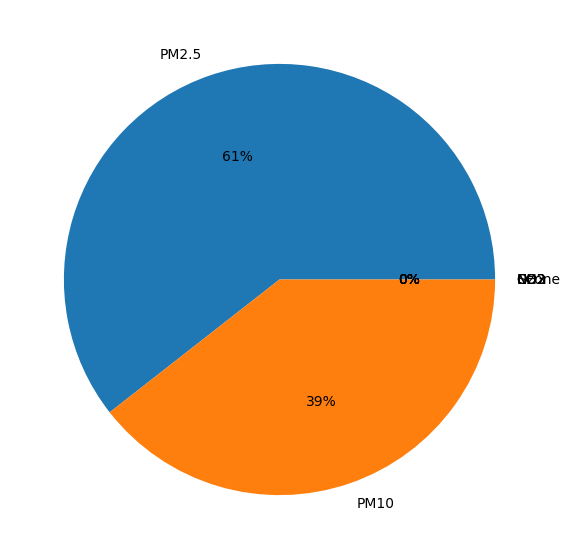

In [63]:
# Here we are finding which pollutant is responsible for how many Moderately Polluted days
rows = pd.DataFrame(columns=ballygunge_2022.columns)
rows = pd.concat([ballygunge_2022.loc[ballygunge_2022["AQI_Standard"] == "Moderately Polluted"],rows],ignore_index=True)
datetype(rows)

The total number of days are: 41
The number of days PM2.5 was responsible for the AQI value was:- 41
The number of days PM10 was responsible for the AQI value was:- 0
The number of days NO2 was responsible for the AQI value was:- 0
The number of days NH3 was responsible for the AQI value was:- 0
The number of days SO2 was responsible for the AQI value was:- 0
The number of days CO was responsible for the AQI value was:- 0
The number of days Ozone was responsible for the AQI value was:- 0


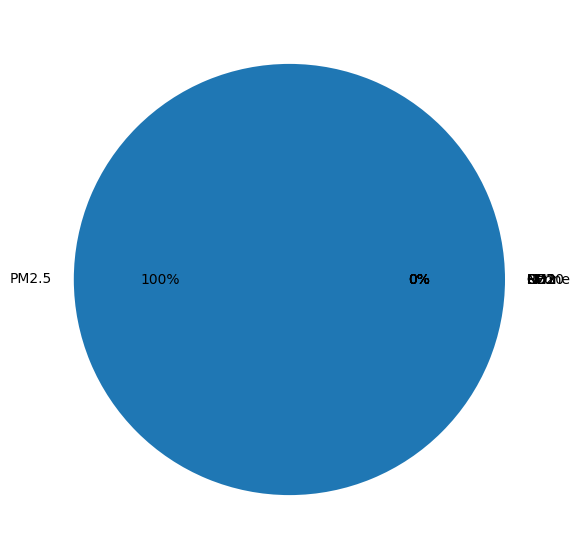

In [64]:
# Here we are finding which pollutant is responsible for how many Poor days
rows = pd.DataFrame(columns=ballygunge_2022.columns)
rows = pd.concat([ballygunge_2022.loc[ballygunge_2022["AQI_Standard"] == "Poor"],rows],ignore_index=True)
datetype(rows)

The total number of days are: 35
The number of days PM2.5 was responsible for the AQI value was:- 35
The number of days PM10 was responsible for the AQI value was:- 0
The number of days NO2 was responsible for the AQI value was:- 0
The number of days NH3 was responsible for the AQI value was:- 0
The number of days SO2 was responsible for the AQI value was:- 0
The number of days CO was responsible for the AQI value was:- 0
The number of days Ozone was responsible for the AQI value was:- 0


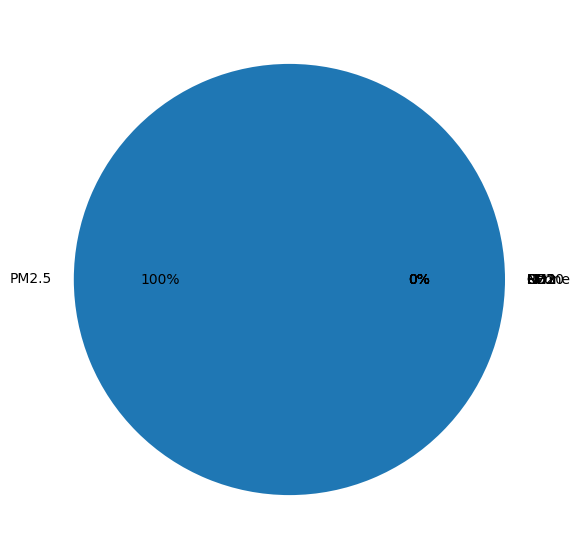

In [65]:
# Here we are finding which pollutant is responsible for how many Very poor days
rows = pd.DataFrame(columns=ballygunge_2022.columns)
rows = pd.concat([ballygunge_2022.loc[ballygunge_2022["AQI_Standard"] == "Very poor"],rows],ignore_index=True)
datetype(rows)

### Month by Month AQI Standard Analysis.

##### January

In the January Months:-
Total number of days : 93
Poor : 33 days
Very poor : 35 days
Satisfactory : 2 days
Moderately Polluted : 23 days


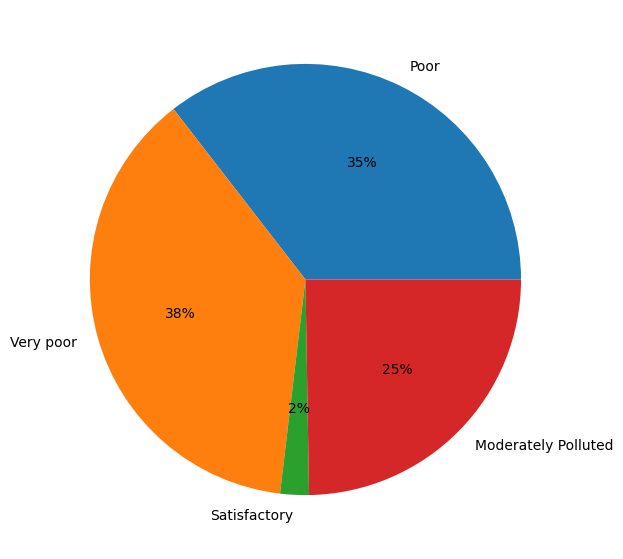

In [66]:
m = ballygunge_jan['AQI_Standard'].value_counts()
stand =ballygunge_jan['AQI_Standard'].unique()
count = []
print("In the January Months:-\nTotal number of days : "+str(len(ballygunge_jan)))
for i in stand:
    count.append(m[i])
    print(str(i) +" : "+str(m[i])+" days")

# Creating plot
fig = plt.figure(figsize =(10, 7))
plt.pie(count, labels = stand,autopct='%1.0f%%')
plt.show()

The total number of days are: 93
The number of days PM2.5 was responsible for the AQI value was:- 86
The number of days PM10 was responsible for the AQI value was:- 7
The number of days NO2 was responsible for the AQI value was:- 0
The number of days NH3 was responsible for the AQI value was:- 0
The number of days SO2 was responsible for the AQI value was:- 0
The number of days CO was responsible for the AQI value was:- 0
The number of days Ozone was responsible for the AQI value was:- 0


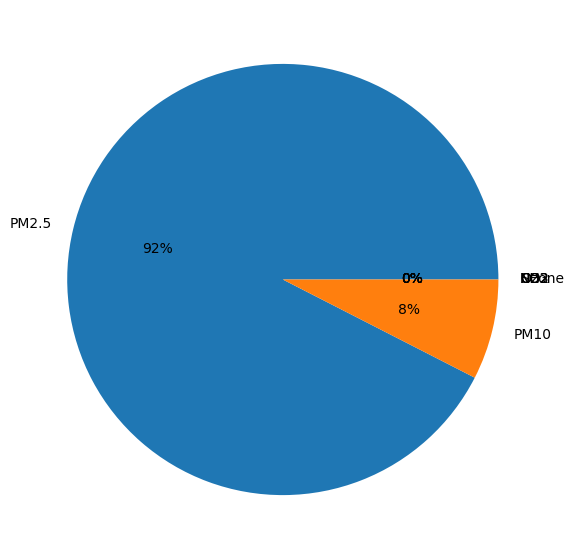

In [67]:
datetype(ballygunge_jan)

The total number of days are: 2
The number of days PM2.5 was responsible for the AQI value was:- 1
The number of days PM10 was responsible for the AQI value was:- 1
The number of days NO2 was responsible for the AQI value was:- 0
The number of days NH3 was responsible for the AQI value was:- 0
The number of days SO2 was responsible for the AQI value was:- 0
The number of days CO was responsible for the AQI value was:- 0
The number of days Ozone was responsible for the AQI value was:- 0


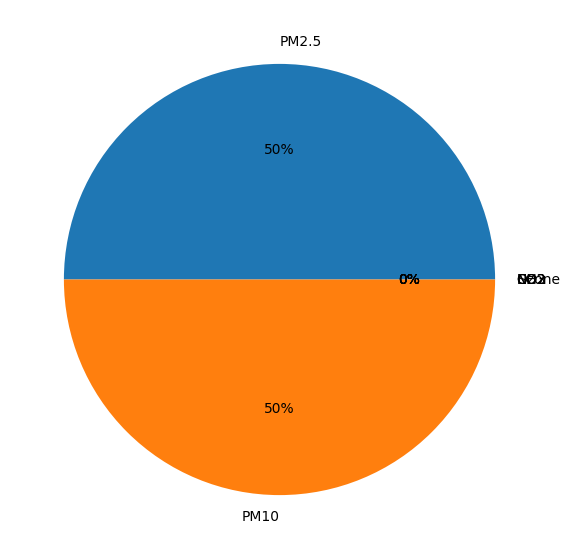

In [68]:
# Here we are finding which pollutant is responsible for how many Satisfactory days
rows = pd.DataFrame(columns=ballygunge_jan.columns)
rows = pd.concat([ballygunge_jan.loc[ballygunge_jan["AQI_Standard"] == "Satisfactory"],rows],ignore_index=True)
datetype(rows)

The total number of days are: 23
The number of days PM2.5 was responsible for the AQI value was:- 18
The number of days PM10 was responsible for the AQI value was:- 5
The number of days NO2 was responsible for the AQI value was:- 0
The number of days NH3 was responsible for the AQI value was:- 0
The number of days SO2 was responsible for the AQI value was:- 0
The number of days CO was responsible for the AQI value was:- 0
The number of days Ozone was responsible for the AQI value was:- 0


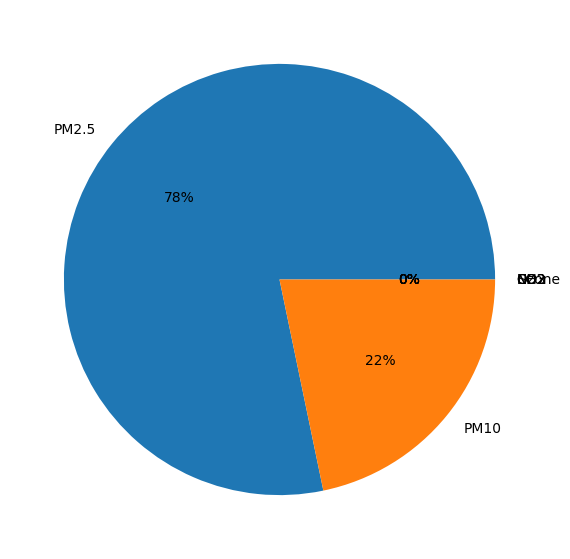

In [69]:
# Here we are finding which pollutant is responsible for how many Moderately Polluted days
rows = pd.DataFrame(columns=ballygunge_jan.columns)
rows = pd.concat([ballygunge_jan.loc[ballygunge_jan["AQI_Standard"] == "Moderately Polluted"],rows],ignore_index=True)
datetype(rows)

The total number of days are: 33
The number of days PM2.5 was responsible for the AQI value was:- 32
The number of days PM10 was responsible for the AQI value was:- 1
The number of days NO2 was responsible for the AQI value was:- 0
The number of days NH3 was responsible for the AQI value was:- 0
The number of days SO2 was responsible for the AQI value was:- 0
The number of days CO was responsible for the AQI value was:- 0
The number of days Ozone was responsible for the AQI value was:- 0


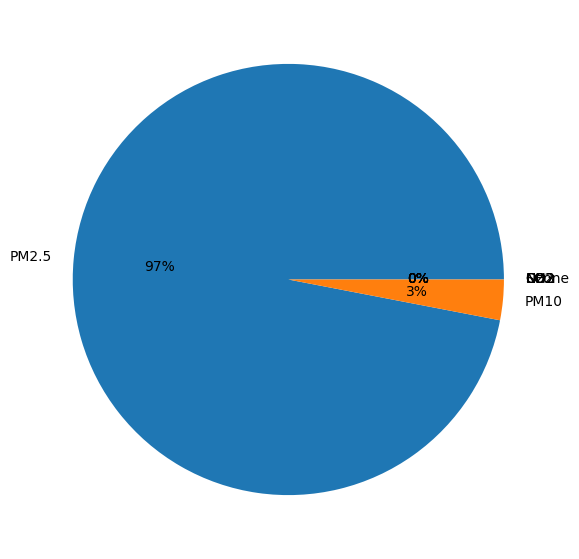

In [70]:
# Here we are finding which pollutant is responsible for how many Poor days
rows = pd.DataFrame(columns=ballygunge_jan.columns)
rows = pd.concat([ballygunge_jan.loc[ballygunge_jan["AQI_Standard"] == "Poor"],rows],ignore_index=True)
datetype(rows)

The total number of days are: 35
The number of days PM2.5 was responsible for the AQI value was:- 35
The number of days PM10 was responsible for the AQI value was:- 0
The number of days NO2 was responsible for the AQI value was:- 0
The number of days NH3 was responsible for the AQI value was:- 0
The number of days SO2 was responsible for the AQI value was:- 0
The number of days CO was responsible for the AQI value was:- 0
The number of days Ozone was responsible for the AQI value was:- 0


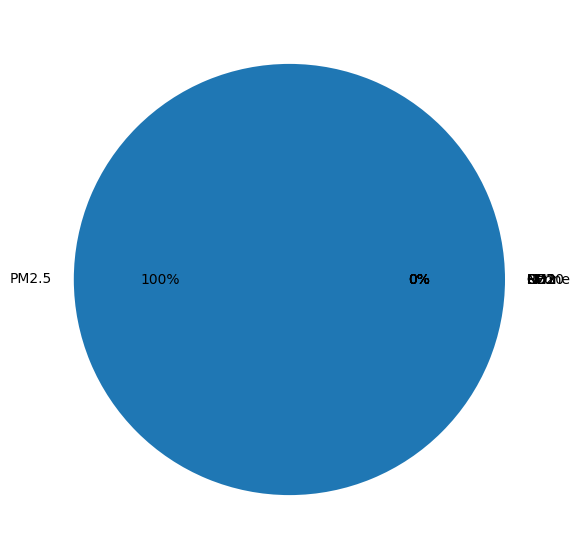

In [71]:
# Here we are finding which pollutant is responsible for how many Very poor days
rows = pd.DataFrame(columns=ballygunge_jan.columns)
rows = pd.concat([ballygunge_jan.loc[ballygunge_jan["AQI_Standard"] == "Very poor"],rows],ignore_index=True)
datetype(rows)

##### February

In the February Months:-
Total number of days : 85
Moderately Polluted : 37 days
Poor : 23 days
Very poor : 20 days
Satisfactory : 5 days


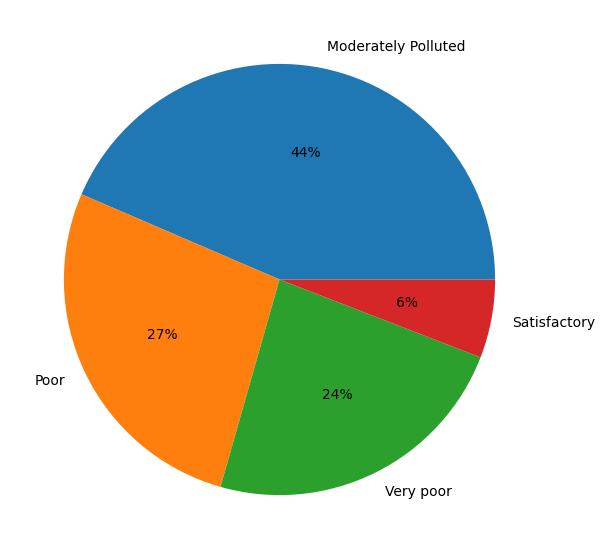

In [72]:

m = ballygunge_feb['AQI_Standard'].value_counts()
stand =ballygunge_feb['AQI_Standard'].unique()
count = []
print("In the February Months:-\nTotal number of days : "+str(len(ballygunge_feb)))
for i in stand:
    count.append(m[i])
    print(str(i) +" : "+str(m[i])+" days")

# Creating plot
fig = plt.figure(figsize =(10, 7))
plt.pie(count, labels = stand,autopct='%1.0f%%')
plt.show()

The total number of days are: 85
The number of days PM2.5 was responsible for the AQI value was:- 69
The number of days PM10 was responsible for the AQI value was:- 16
The number of days NO2 was responsible for the AQI value was:- 0
The number of days NH3 was responsible for the AQI value was:- 0
The number of days SO2 was responsible for the AQI value was:- 0
The number of days CO was responsible for the AQI value was:- 0
The number of days Ozone was responsible for the AQI value was:- 0


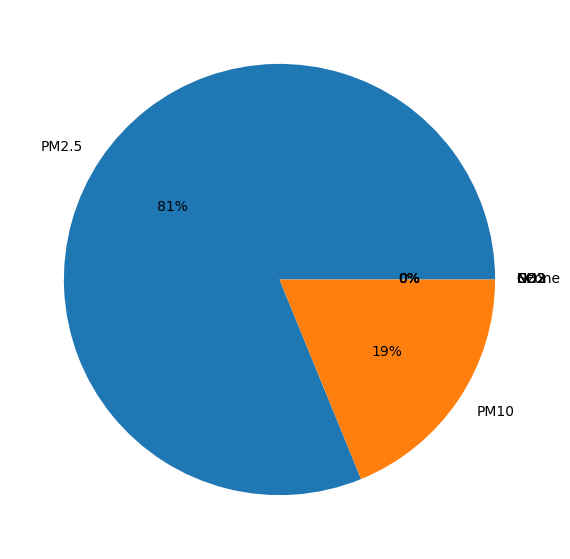

In [73]:
datetype(ballygunge_feb)

The total number of days are: 5
The number of days PM2.5 was responsible for the AQI value was:- 0
The number of days PM10 was responsible for the AQI value was:- 5
The number of days NO2 was responsible for the AQI value was:- 0
The number of days NH3 was responsible for the AQI value was:- 0
The number of days SO2 was responsible for the AQI value was:- 0
The number of days CO was responsible for the AQI value was:- 0
The number of days Ozone was responsible for the AQI value was:- 0


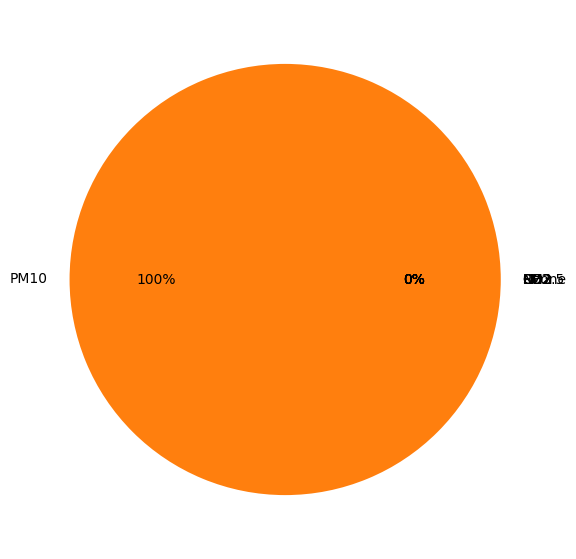

In [74]:
# Here we are finding which pollutant is responsible for how many Satisfactory days
rows = pd.DataFrame(columns=ballygunge_feb.columns)
rows = pd.concat([ballygunge_feb.loc[ballygunge_feb["AQI_Standard"] == "Satisfactory"],rows],ignore_index=True)
datetype(rows)

The total number of days are: 37
The number of days PM2.5 was responsible for the AQI value was:- 26
The number of days PM10 was responsible for the AQI value was:- 11
The number of days NO2 was responsible for the AQI value was:- 0
The number of days NH3 was responsible for the AQI value was:- 0
The number of days SO2 was responsible for the AQI value was:- 0
The number of days CO was responsible for the AQI value was:- 0
The number of days Ozone was responsible for the AQI value was:- 0


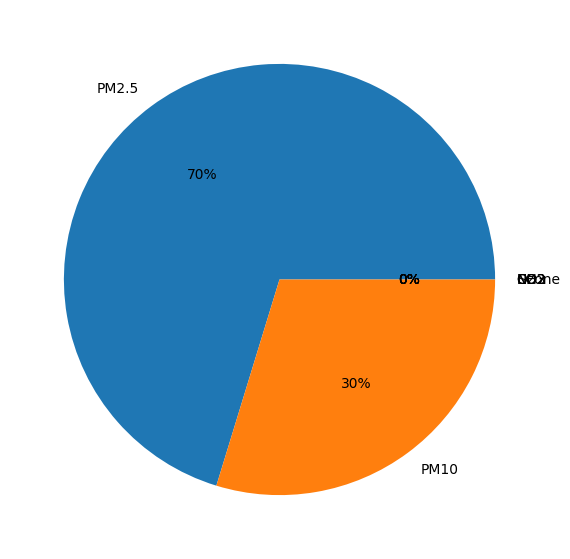

In [75]:
# Here we are finding which pollutant is responsible for how many Moderately Polluted days
rows = pd.DataFrame(columns=ballygunge_feb.columns)
rows = pd.concat([ballygunge_feb.loc[ballygunge_feb["AQI_Standard"] == "Moderately Polluted"],rows],ignore_index=True)
datetype(rows)

The total number of days are: 23
The number of days PM2.5 was responsible for the AQI value was:- 23
The number of days PM10 was responsible for the AQI value was:- 0
The number of days NO2 was responsible for the AQI value was:- 0
The number of days NH3 was responsible for the AQI value was:- 0
The number of days SO2 was responsible for the AQI value was:- 0
The number of days CO was responsible for the AQI value was:- 0
The number of days Ozone was responsible for the AQI value was:- 0


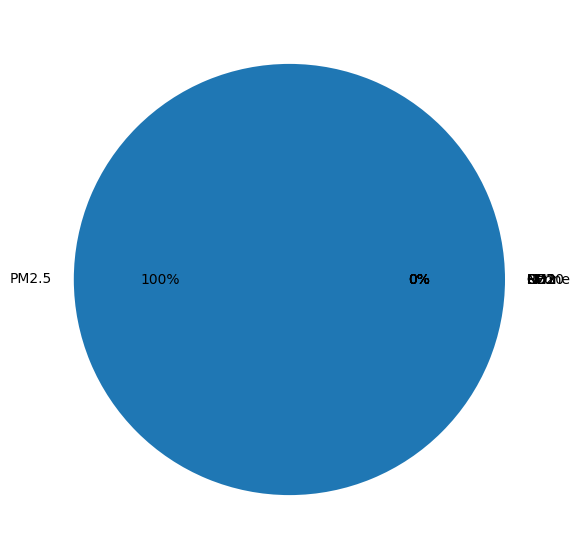

In [76]:
# Here we are finding which pollutant is responsible for how many Poor days
rows = pd.DataFrame(columns=ballygunge_feb.columns)
rows = pd.concat([ballygunge_feb.loc[ballygunge_feb["AQI_Standard"] == "Poor"],rows],ignore_index=True)
datetype(rows)

The total number of days are: 20
The number of days PM2.5 was responsible for the AQI value was:- 20
The number of days PM10 was responsible for the AQI value was:- 0
The number of days NO2 was responsible for the AQI value was:- 0
The number of days NH3 was responsible for the AQI value was:- 0
The number of days SO2 was responsible for the AQI value was:- 0
The number of days CO was responsible for the AQI value was:- 0
The number of days Ozone was responsible for the AQI value was:- 0


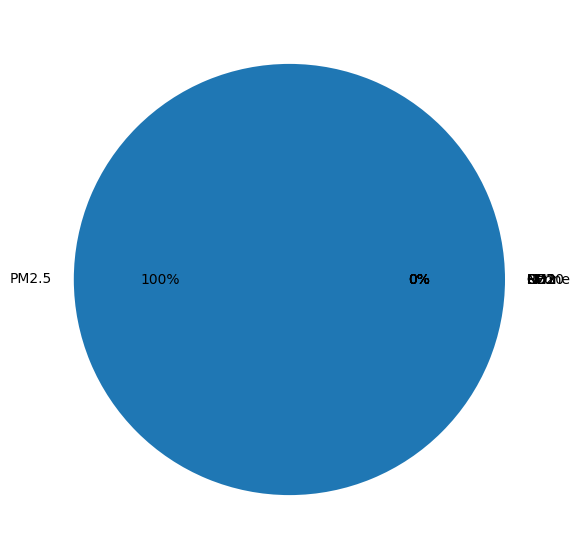

In [77]:
# Here we are finding which pollutant is responsible for how many Very poor days
rows = pd.DataFrame(columns=ballygunge_feb.columns)
rows = pd.concat([ballygunge_feb.loc[ballygunge_feb["AQI_Standard"] == "Very poor"],rows],ignore_index=True)
datetype(rows)

##### March

In the March Months:-
Total number of days : 93
Very poor : 3 days
Poor : 12 days
Moderately Polluted : 43 days
Satisfactory : 35 days


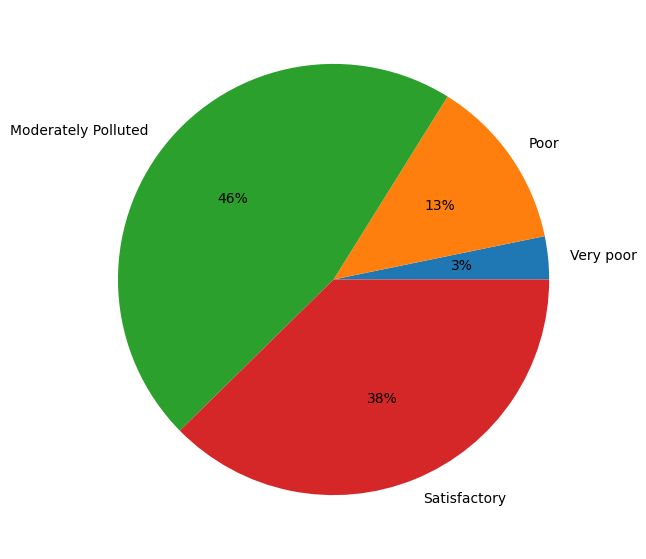

In [78]:
m = ballygunge_mar['AQI_Standard'].value_counts()
stand =ballygunge_mar['AQI_Standard'].unique()
count = []
print("In the March Months:-\nTotal number of days : "+str(len(ballygunge_mar)))
for i in stand:
    count.append(m[i])
    print(str(i) +" : "+str(m[i])+" days")

# Creating plot
fig = plt.figure(figsize =(10, 7))
plt.pie(count, labels = stand,autopct='%1.0f%%')
plt.show()

The total number of days are: 93
The number of days PM2.5 was responsible for the AQI value was:- 42
The number of days PM10 was responsible for the AQI value was:- 46
The number of days NO2 was responsible for the AQI value was:- 0
The number of days NH3 was responsible for the AQI value was:- 0
The number of days SO2 was responsible for the AQI value was:- 0
The number of days CO was responsible for the AQI value was:- 0
The number of days Ozone was responsible for the AQI value was:- 5


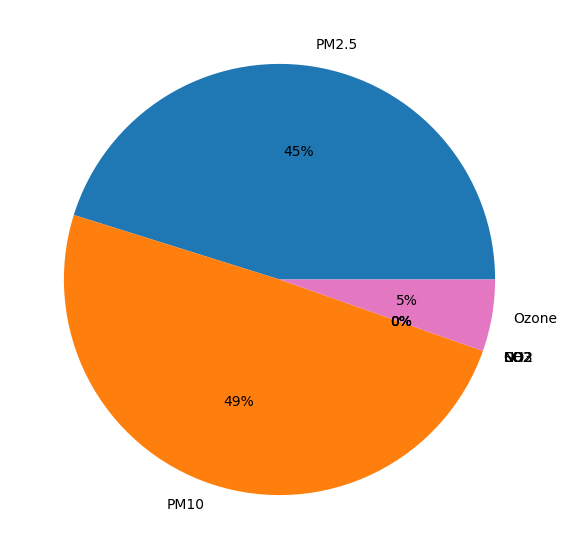

In [79]:
datetype(ballygunge_mar)

The total number of days are: 35
The number of days PM2.5 was responsible for the AQI value was:- 2
The number of days PM10 was responsible for the AQI value was:- 28
The number of days NO2 was responsible for the AQI value was:- 0
The number of days NH3 was responsible for the AQI value was:- 0
The number of days SO2 was responsible for the AQI value was:- 0
The number of days CO was responsible for the AQI value was:- 0
The number of days Ozone was responsible for the AQI value was:- 5


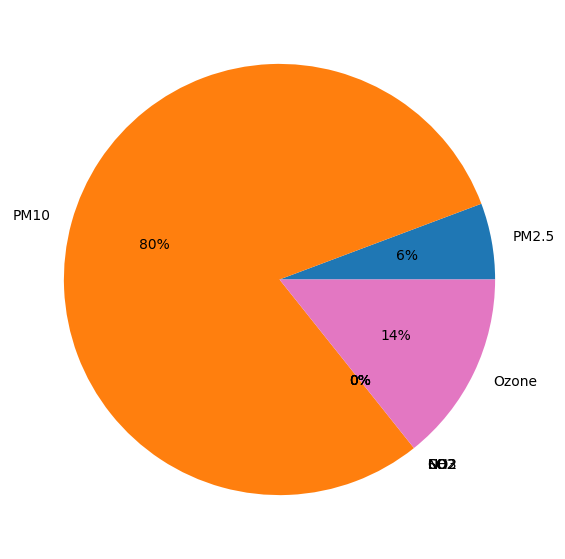

In [80]:
# Here we are finding which pollutant is responsible for how many Satisfactory days
rows = pd.DataFrame(columns=ballygunge_mar.columns)
rows = pd.concat([ballygunge_mar.loc[ballygunge_mar["AQI_Standard"] == "Satisfactory"],rows],ignore_index=True)
datetype(rows)

The total number of days are: 43
The number of days PM2.5 was responsible for the AQI value was:- 25
The number of days PM10 was responsible for the AQI value was:- 18
The number of days NO2 was responsible for the AQI value was:- 0
The number of days NH3 was responsible for the AQI value was:- 0
The number of days SO2 was responsible for the AQI value was:- 0
The number of days CO was responsible for the AQI value was:- 0
The number of days Ozone was responsible for the AQI value was:- 0


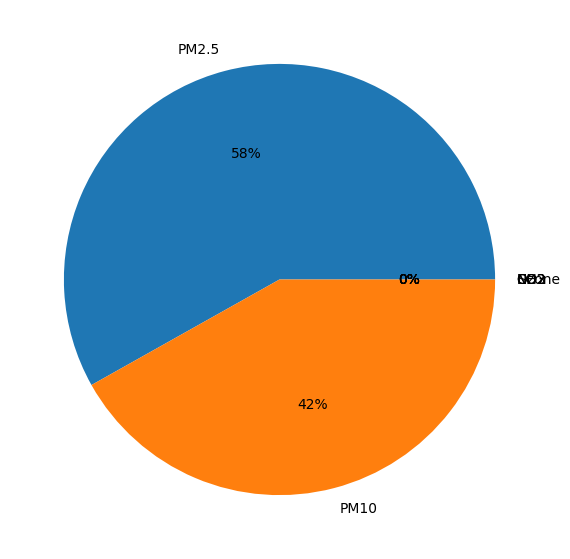

In [81]:
# Here we are finding which pollutant is responsible for how many Moderately polluted days
rows = pd.DataFrame(columns=ballygunge_mar.columns)
rows = pd.concat([ballygunge_mar.loc[ballygunge_mar["AQI_Standard"] == "Moderately Polluted"],rows],ignore_index=True)
datetype(rows)

The total number of days are: 12
The number of days PM2.5 was responsible for the AQI value was:- 12
The number of days PM10 was responsible for the AQI value was:- 0
The number of days NO2 was responsible for the AQI value was:- 0
The number of days NH3 was responsible for the AQI value was:- 0
The number of days SO2 was responsible for the AQI value was:- 0
The number of days CO was responsible for the AQI value was:- 0
The number of days Ozone was responsible for the AQI value was:- 0


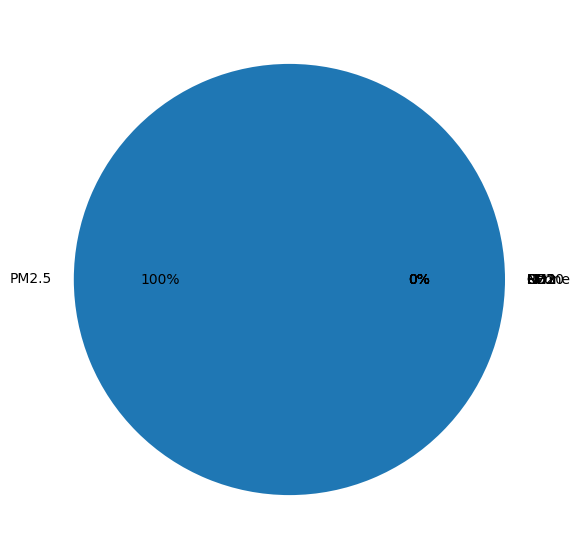

In [82]:
# Here we are finding which pollutant is responsible for how many Poor days
rows = pd.DataFrame(columns=ballygunge_mar.columns)
rows = pd.concat([ballygunge_mar.loc[ballygunge_mar["AQI_Standard"] == "Poor"],rows],ignore_index=True)
datetype(rows)

The total number of days are: 3
The number of days PM2.5 was responsible for the AQI value was:- 3
The number of days PM10 was responsible for the AQI value was:- 0
The number of days NO2 was responsible for the AQI value was:- 0
The number of days NH3 was responsible for the AQI value was:- 0
The number of days SO2 was responsible for the AQI value was:- 0
The number of days CO was responsible for the AQI value was:- 0
The number of days Ozone was responsible for the AQI value was:- 0


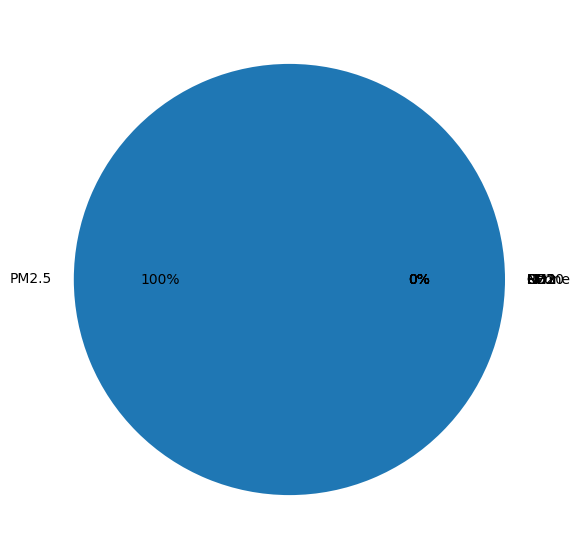

In [83]:
# Here we are finding which pollutant is responsible for how many Very Poor days
rows = pd.DataFrame(columns=ballygunge_mar.columns)
rows = pd.concat([ballygunge_mar.loc[ballygunge_mar["AQI_Standard"] == "Very poor"],rows],ignore_index=True)
datetype(rows)

##### April

In the April Months:-
Total number of days : 90
Satisfactory : 55 days
Moderately Polluted : 11 days
Good : 23 days
Poor : 1 days


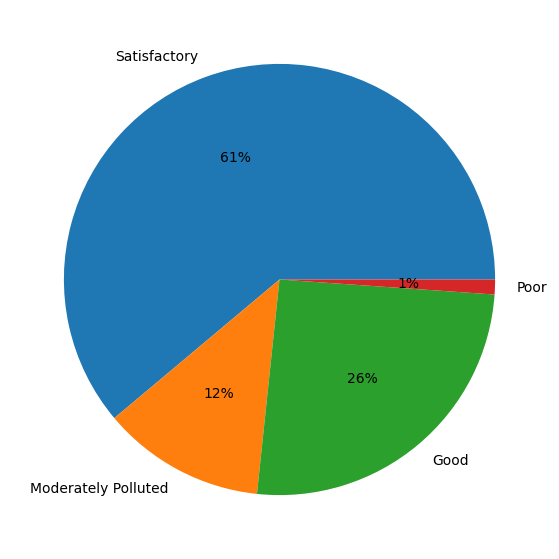

In [84]:
m = ballygunge_apr['AQI_Standard'].value_counts()
stand =ballygunge_apr['AQI_Standard'].unique()
count = []
print("In the April Months:-\nTotal number of days : "+str(len(ballygunge_apr)))
for i in stand:
    count.append(m[i])
    print(str(i) +" : "+str(m[i])+" days")

# Creating plot
fig = plt.figure(figsize =(10, 7))
plt.pie(count, labels = stand,autopct='%1.0f%%')
plt.show()

The total number of days are: 90
The number of days PM2.5 was responsible for the AQI value was:- 6
The number of days PM10 was responsible for the AQI value was:- 59
The number of days NO2 was responsible for the AQI value was:- 0
The number of days NH3 was responsible for the AQI value was:- 0
The number of days SO2 was responsible for the AQI value was:- 0
The number of days CO was responsible for the AQI value was:- 0
The number of days Ozone was responsible for the AQI value was:- 25


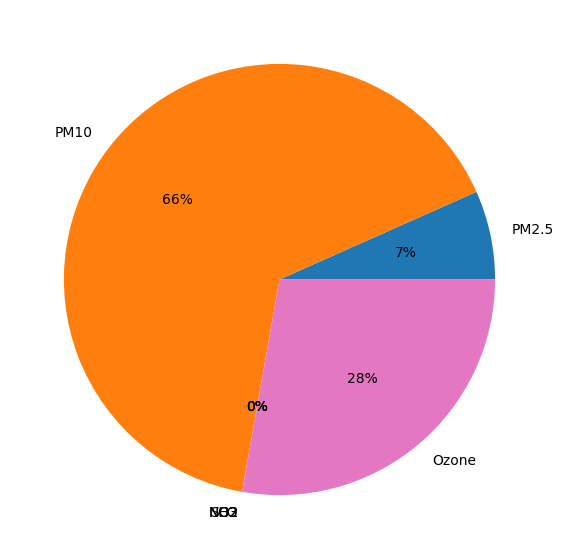

In [85]:
datetype(ballygunge_apr)

The total number of days are: 23
The number of days PM2.5 was responsible for the AQI value was:- 1
The number of days PM10 was responsible for the AQI value was:- 8
The number of days NO2 was responsible for the AQI value was:- 0
The number of days NH3 was responsible for the AQI value was:- 0
The number of days SO2 was responsible for the AQI value was:- 0
The number of days CO was responsible for the AQI value was:- 0
The number of days Ozone was responsible for the AQI value was:- 14


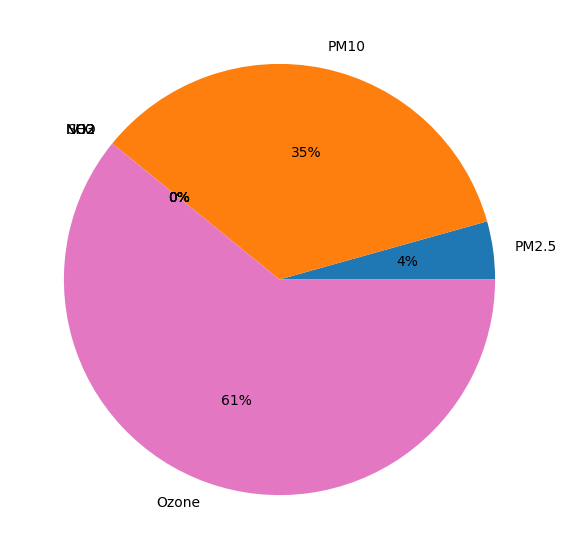

In [86]:
# Here we are finding which pollutant is responsible for how many Good days
rows = pd.DataFrame(columns=ballygunge_apr.columns)
rows = pd.concat([ballygunge_apr.loc[ballygunge_apr["AQI_Standard"] == "Good"],rows],ignore_index=True)
datetype(rows)

The total number of days are: 55
The number of days PM2.5 was responsible for the AQI value was:- 1
The number of days PM10 was responsible for the AQI value was:- 43
The number of days NO2 was responsible for the AQI value was:- 0
The number of days NH3 was responsible for the AQI value was:- 0
The number of days SO2 was responsible for the AQI value was:- 0
The number of days CO was responsible for the AQI value was:- 0
The number of days Ozone was responsible for the AQI value was:- 11


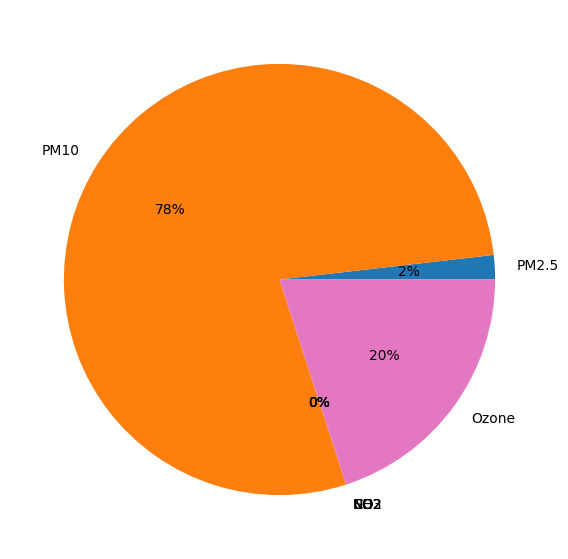

In [87]:
# Here we are finding which pollutant is responsible for how many Satisfactory days
rows = pd.DataFrame(columns=ballygunge_apr.columns)
rows = pd.concat([ballygunge_apr.loc[ballygunge_apr["AQI_Standard"] == "Satisfactory"],rows],ignore_index=True)
datetype(rows)

The total number of days are: 11
The number of days PM2.5 was responsible for the AQI value was:- 4
The number of days PM10 was responsible for the AQI value was:- 7
The number of days NO2 was responsible for the AQI value was:- 0
The number of days NH3 was responsible for the AQI value was:- 0
The number of days SO2 was responsible for the AQI value was:- 0
The number of days CO was responsible for the AQI value was:- 0
The number of days Ozone was responsible for the AQI value was:- 0


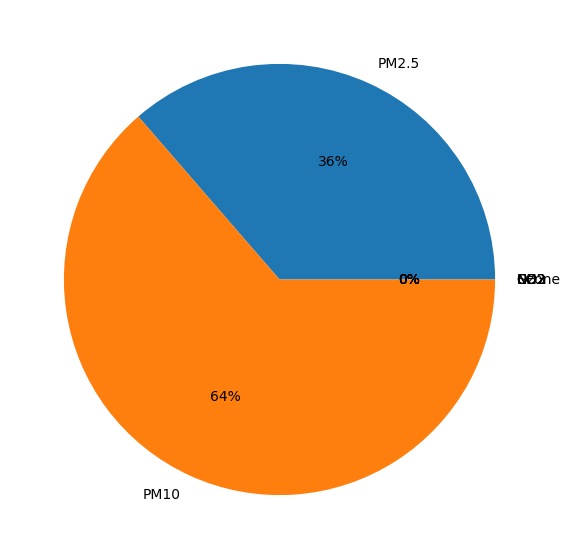

In [88]:
# Here we are finding which pollutant is responsible for how many Moderately polluted days
rows = pd.DataFrame(columns=ballygunge_apr.columns)
rows = pd.concat([ballygunge_apr.loc[ballygunge_apr["AQI_Standard"] == "Moderately Polluted"],rows],ignore_index=True)
datetype(rows)

The total number of days are: 1
The number of days PM2.5 was responsible for the AQI value was:- 0
The number of days PM10 was responsible for the AQI value was:- 1
The number of days NO2 was responsible for the AQI value was:- 0
The number of days NH3 was responsible for the AQI value was:- 0
The number of days SO2 was responsible for the AQI value was:- 0
The number of days CO was responsible for the AQI value was:- 0
The number of days Ozone was responsible for the AQI value was:- 0


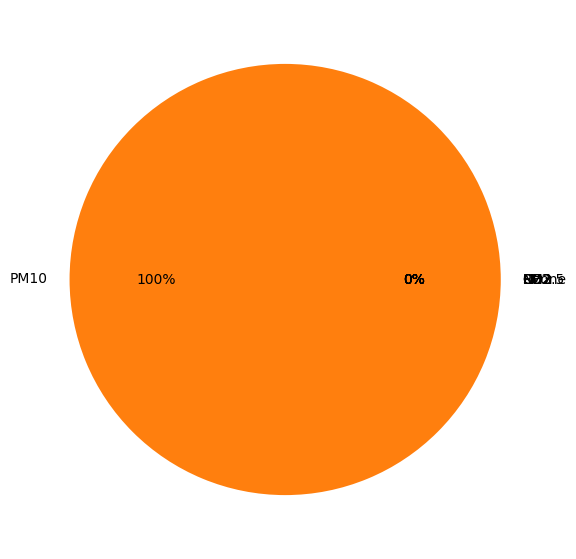

In [89]:
# Here we are finding which pollutant is responsible for how many Poor days
rows = pd.DataFrame(columns=ballygunge_apr.columns)
rows = pd.concat([ballygunge_apr.loc[ballygunge_apr["AQI_Standard"] == "Poor"],rows],ignore_index=True)
datetype(rows)

##### May

In the May Months:-
Total number of days : 93
Good : 41 days
Satisfactory : 47 days
Moderately Polluted : 5 days


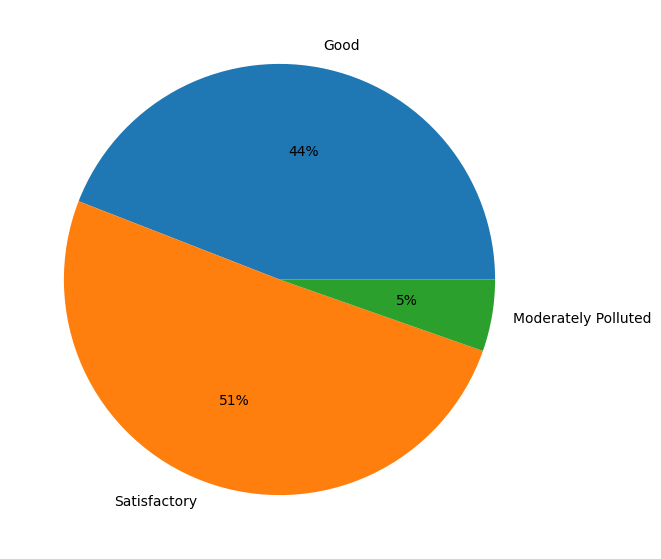

In [90]:
m = ballygunge_may['AQI_Standard'].value_counts()
stand =ballygunge_may['AQI_Standard'].unique()
count = []
print("In the May Months:-\nTotal number of days : "+str(len(ballygunge_may)))
for i in stand:
    count.append(m[i])
    print(str(i) +" : "+str(m[i])+" days")

# Creating plot
fig = plt.figure(figsize =(10, 7))
plt.pie(count, labels = stand,autopct='%1.0f%%')
plt.show()

The total number of days are: 93
The number of days PM2.5 was responsible for the AQI value was:- 3
The number of days PM10 was responsible for the AQI value was:- 63
The number of days NO2 was responsible for the AQI value was:- 0
The number of days NH3 was responsible for the AQI value was:- 0
The number of days SO2 was responsible for the AQI value was:- 0
The number of days CO was responsible for the AQI value was:- 0
The number of days Ozone was responsible for the AQI value was:- 27


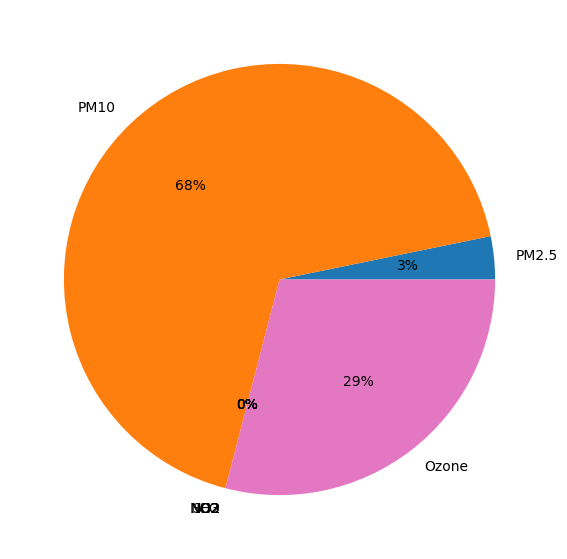

In [91]:
datetype(ballygunge_may)

The total number of days are: 41
The number of days PM2.5 was responsible for the AQI value was:- 1
The number of days PM10 was responsible for the AQI value was:- 25
The number of days NO2 was responsible for the AQI value was:- 0
The number of days NH3 was responsible for the AQI value was:- 0
The number of days SO2 was responsible for the AQI value was:- 0
The number of days CO was responsible for the AQI value was:- 0
The number of days Ozone was responsible for the AQI value was:- 15


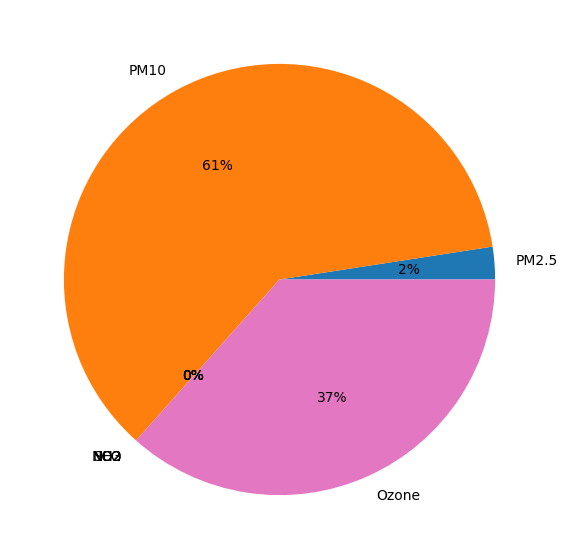

In [92]:
# Here we are finding which pollutant is responsible for how many Good days
rows = pd.DataFrame(columns=ballygunge_may.columns)
rows = pd.concat([ballygunge_may.loc[ballygunge_may["AQI_Standard"] == "Good"],rows],ignore_index=True)
datetype(rows)

The total number of days are: 47
The number of days PM2.5 was responsible for the AQI value was:- 1
The number of days PM10 was responsible for the AQI value was:- 34
The number of days NO2 was responsible for the AQI value was:- 0
The number of days NH3 was responsible for the AQI value was:- 0
The number of days SO2 was responsible for the AQI value was:- 0
The number of days CO was responsible for the AQI value was:- 0
The number of days Ozone was responsible for the AQI value was:- 12


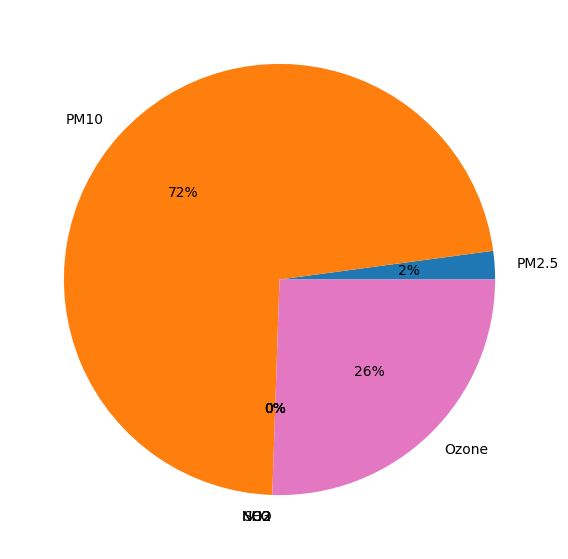

In [93]:
# Here we are finding which pollutant is responsible for how many Satisfactory days
rows = pd.DataFrame(columns=ballygunge_may.columns)
rows = pd.concat([ballygunge_may.loc[ballygunge_may["AQI_Standard"] == "Satisfactory"],rows],ignore_index=True)
datetype(rows)

The total number of days are: 5
The number of days PM2.5 was responsible for the AQI value was:- 1
The number of days PM10 was responsible for the AQI value was:- 4
The number of days NO2 was responsible for the AQI value was:- 0
The number of days NH3 was responsible for the AQI value was:- 0
The number of days SO2 was responsible for the AQI value was:- 0
The number of days CO was responsible for the AQI value was:- 0
The number of days Ozone was responsible for the AQI value was:- 0


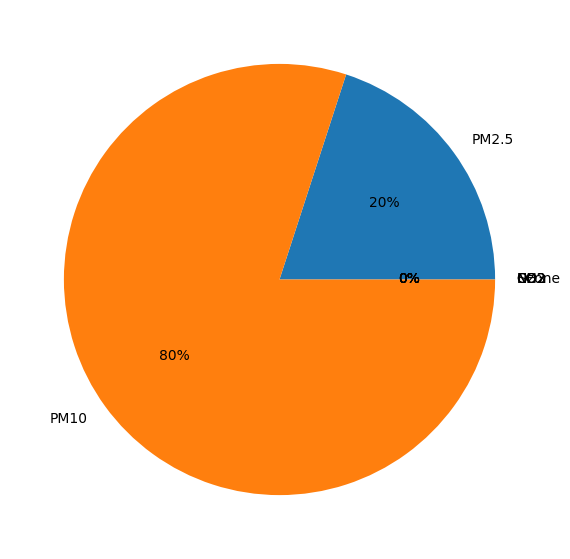

In [94]:
# Here we are finding which pollutant is responsible for how many Moderately Polluted days
rows = pd.DataFrame(columns=ballygunge_may.columns)
rows = pd.concat([ballygunge_may.loc[ballygunge_may["AQI_Standard"] == "Moderately Polluted"],rows],ignore_index=True)
datetype(rows)

##### June

In the June Months:-
Total number of days : 90
Good : 60 days
Satisfactory : 29 days
Moderately Polluted : 1 days


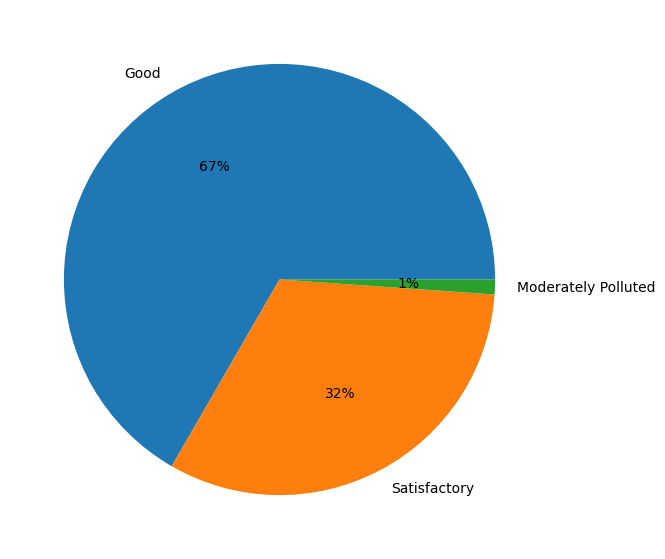

In [95]:
m = ballygunge_jun['AQI_Standard'].value_counts()
stand =ballygunge_jun['AQI_Standard'].unique()
count = []
print("In the June Months:-\nTotal number of days : "+str(len(ballygunge_jun)))
for i in stand:
    count.append(m[i])
    print(str(i) +" : "+str(m[i])+" days")

# Creating plot
fig = plt.figure(figsize =(10, 7))
plt.pie(count, labels = stand,autopct='%1.0f%%')
plt.show()

The total number of days are: 90
The number of days PM2.5 was responsible for the AQI value was:- 0
The number of days PM10 was responsible for the AQI value was:- 78
The number of days NO2 was responsible for the AQI value was:- 0
The number of days NH3 was responsible for the AQI value was:- 0
The number of days SO2 was responsible for the AQI value was:- 0
The number of days CO was responsible for the AQI value was:- 1
The number of days Ozone was responsible for the AQI value was:- 11


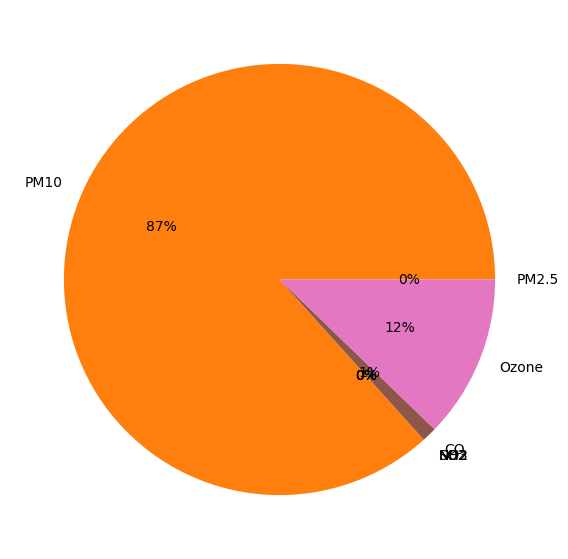

In [96]:
datetype(ballygunge_jun)

The total number of days are: 60
The number of days PM2.5 was responsible for the AQI value was:- 0
The number of days PM10 was responsible for the AQI value was:- 50
The number of days NO2 was responsible for the AQI value was:- 0
The number of days NH3 was responsible for the AQI value was:- 0
The number of days SO2 was responsible for the AQI value was:- 0
The number of days CO was responsible for the AQI value was:- 1
The number of days Ozone was responsible for the AQI value was:- 9


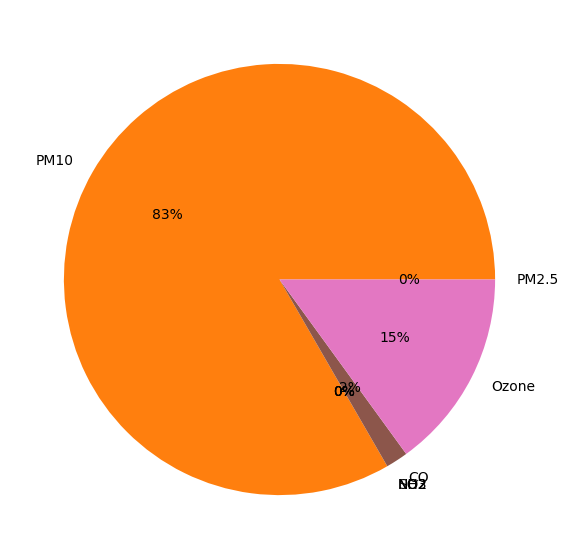

In [97]:
# Here we are finding which pollutant is responsible for how many Good days
rows = pd.DataFrame(columns=ballygunge_jun.columns)
rows = pd.concat([ballygunge_jun.loc[ballygunge_jun["AQI_Standard"] == "Good"],rows],ignore_index=True)
datetype(rows)

The total number of days are: 29
The number of days PM2.5 was responsible for the AQI value was:- 0
The number of days PM10 was responsible for the AQI value was:- 27
The number of days NO2 was responsible for the AQI value was:- 0
The number of days NH3 was responsible for the AQI value was:- 0
The number of days SO2 was responsible for the AQI value was:- 0
The number of days CO was responsible for the AQI value was:- 0
The number of days Ozone was responsible for the AQI value was:- 2


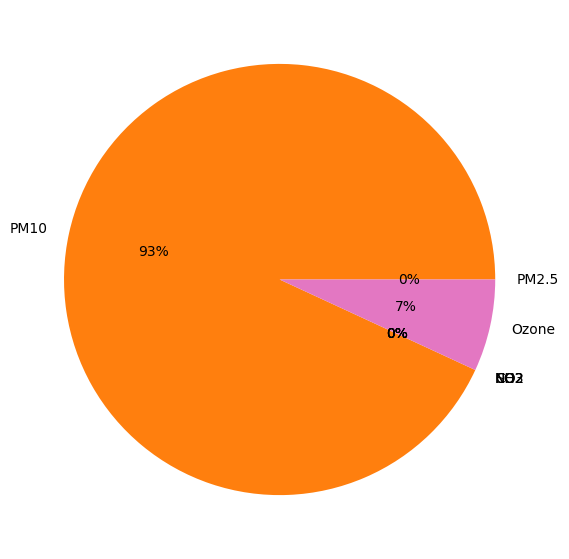

In [98]:
# Here we are finding which pollutant is responsible for how many Satisfactory days
rows = pd.DataFrame(columns=ballygunge_jun.columns)
rows = pd.concat([ballygunge_jun.loc[ballygunge_jun["AQI_Standard"] == "Satisfactory"],rows],ignore_index=True)
datetype(rows)

The total number of days are: 1
The number of days PM2.5 was responsible for the AQI value was:- 0
The number of days PM10 was responsible for the AQI value was:- 1
The number of days NO2 was responsible for the AQI value was:- 0
The number of days NH3 was responsible for the AQI value was:- 0
The number of days SO2 was responsible for the AQI value was:- 0
The number of days CO was responsible for the AQI value was:- 0
The number of days Ozone was responsible for the AQI value was:- 0


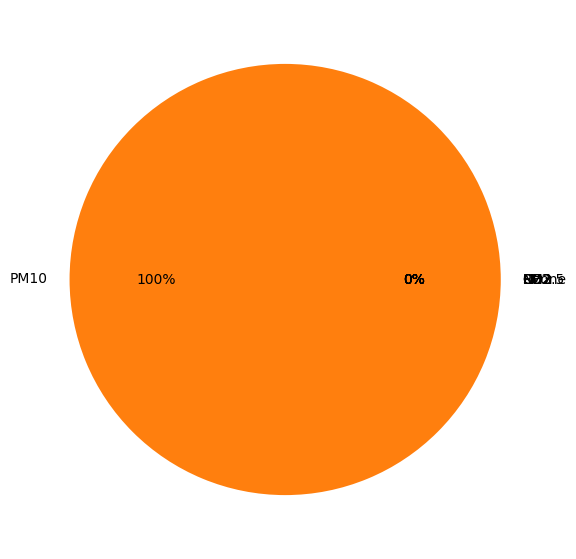

In [99]:
# Here we are finding which pollutant is responsible for how many Moderately Polluted days
rows = pd.DataFrame(columns=ballygunge_jun.columns)
rows = pd.concat([ballygunge_jun.loc[ballygunge_jun["AQI_Standard"] == "Moderately Polluted"],rows],ignore_index=True)
datetype(rows)

##### July

In the July Months:-
Total number of days : 93
Good : 77 days
Satisfactory : 16 days


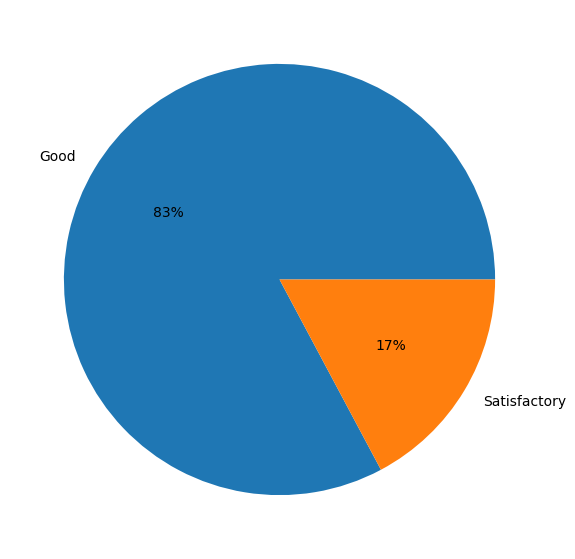

In [100]:
m = ballygunge_jul['AQI_Standard'].value_counts()
stand =ballygunge_jul['AQI_Standard'].unique()
count = []
print("In the July Months:-\nTotal number of days : "+str(len(ballygunge_jul)))
for i in stand:
    count.append(m[i])
    print(str(i) +" : "+str(m[i])+" days")

# Creating plot
fig = plt.figure(figsize =(10, 7))
plt.pie(count, labels = stand,autopct='%1.0f%%')
plt.show()

The total number of days are: 93
The number of days PM2.5 was responsible for the AQI value was:- 3
The number of days PM10 was responsible for the AQI value was:- 38
The number of days NO2 was responsible for the AQI value was:- 0
The number of days NH3 was responsible for the AQI value was:- 0
The number of days SO2 was responsible for the AQI value was:- 7
The number of days CO was responsible for the AQI value was:- 4
The number of days Ozone was responsible for the AQI value was:- 41


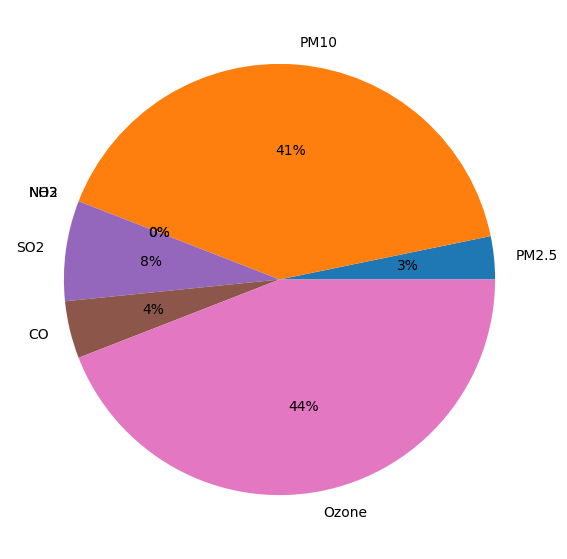

In [101]:
datetype(ballygunge_jul)

The total number of days are: 77
The number of days PM2.5 was responsible for the AQI value was:- 1
The number of days PM10 was responsible for the AQI value was:- 28
The number of days NO2 was responsible for the AQI value was:- 0
The number of days NH3 was responsible for the AQI value was:- 0
The number of days SO2 was responsible for the AQI value was:- 7
The number of days CO was responsible for the AQI value was:- 4
The number of days Ozone was responsible for the AQI value was:- 37


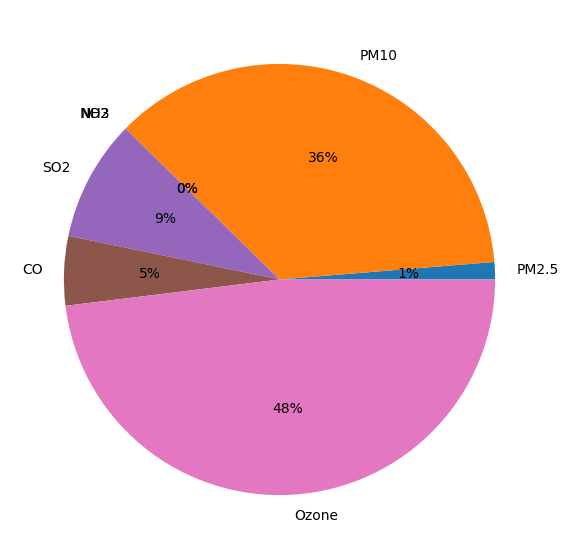

In [102]:
# Here we are finding which pollutant is responsible for how many Good days
rows = pd.DataFrame(columns=ballygunge_jul.columns)
rows = pd.concat([ballygunge_jul.loc[ballygunge_jul["AQI_Standard"] == "Good"],rows],ignore_index=True)
datetype(rows)

The total number of days are: 16
The number of days PM2.5 was responsible for the AQI value was:- 2
The number of days PM10 was responsible for the AQI value was:- 10
The number of days NO2 was responsible for the AQI value was:- 0
The number of days NH3 was responsible for the AQI value was:- 0
The number of days SO2 was responsible for the AQI value was:- 0
The number of days CO was responsible for the AQI value was:- 0
The number of days Ozone was responsible for the AQI value was:- 4


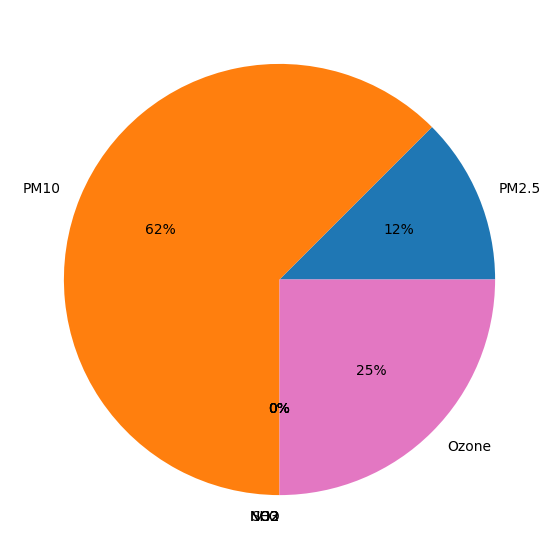

In [103]:
# Here we are finding which pollutant is responsible for how many Satisfactory days
rows = pd.DataFrame(columns=ballygunge_jul.columns)
rows = pd.concat([ballygunge_jul.loc[ballygunge_jul["AQI_Standard"] == "Satisfactory"],rows],ignore_index=True)
datetype(rows)

##### August

In the August Months:-
Total number of days : 95
Good : 66 days
Satisfactory : 28 days
Moderately Polluted : 1 days


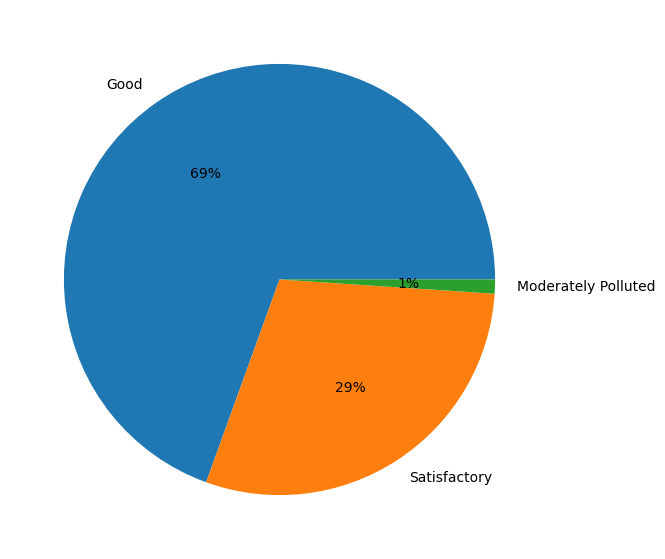

In [104]:
m = ballygunge_aug['AQI_Standard'].value_counts()
stand =ballygunge_aug['AQI_Standard'].unique()
count = []
print("In the August Months:-\nTotal number of days : "+str(len(ballygunge_aug)))
for i in stand:
    count.append(m[i])
    print(str(i) +" : "+str(m[i])+" days")

# Creating plot
fig = plt.figure(figsize =(10, 7))
plt.pie(count, labels = stand,autopct='%1.0f%%')
plt.show()

The total number of days are: 95
The number of days PM2.5 was responsible for the AQI value was:- 8
The number of days PM10 was responsible for the AQI value was:- 56
The number of days NO2 was responsible for the AQI value was:- 4
The number of days NH3 was responsible for the AQI value was:- 0
The number of days SO2 was responsible for the AQI value was:- 0
The number of days CO was responsible for the AQI value was:- 4
The number of days Ozone was responsible for the AQI value was:- 23


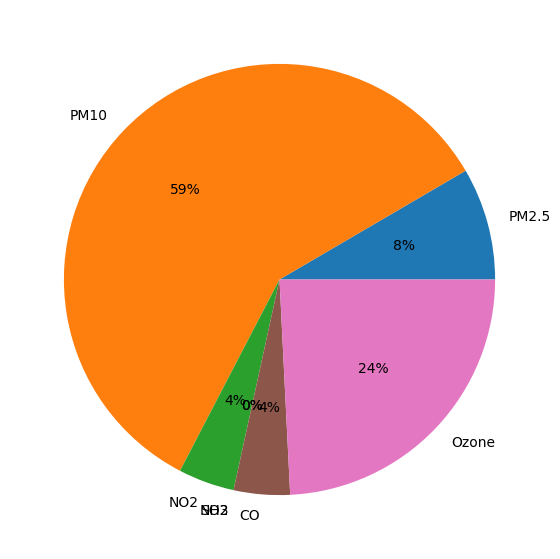

In [105]:
datetype(ballygunge_aug)

The total number of days are: 66
The number of days PM2.5 was responsible for the AQI value was:- 3
The number of days PM10 was responsible for the AQI value was:- 32
The number of days NO2 was responsible for the AQI value was:- 4
The number of days NH3 was responsible for the AQI value was:- 0
The number of days SO2 was responsible for the AQI value was:- 0
The number of days CO was responsible for the AQI value was:- 4
The number of days Ozone was responsible for the AQI value was:- 23


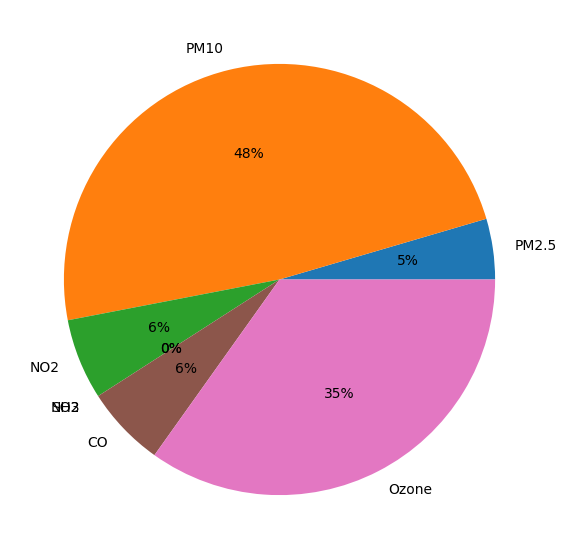

In [106]:
# Here we are finding which pollutant is responsible for how many Good days
rows = pd.DataFrame(columns=ballygunge_aug.columns)
rows = pd.concat([ballygunge_aug.loc[ballygunge_aug["AQI_Standard"] == "Good"],rows],ignore_index=True)
datetype(rows)

The total number of days are: 28
The number of days PM2.5 was responsible for the AQI value was:- 5
The number of days PM10 was responsible for the AQI value was:- 23
The number of days NO2 was responsible for the AQI value was:- 0
The number of days NH3 was responsible for the AQI value was:- 0
The number of days SO2 was responsible for the AQI value was:- 0
The number of days CO was responsible for the AQI value was:- 0
The number of days Ozone was responsible for the AQI value was:- 0


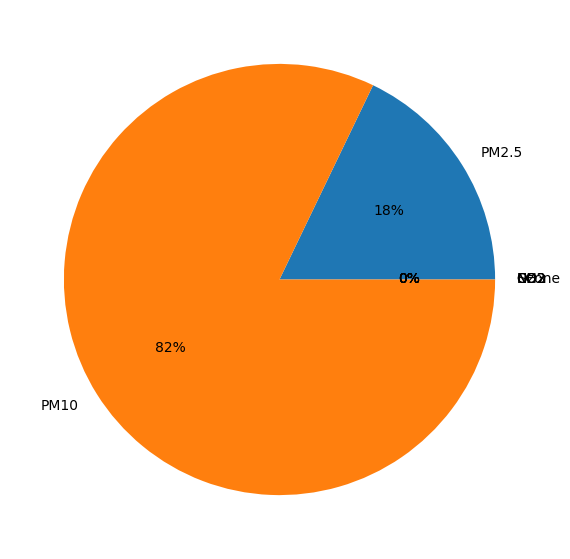

In [107]:
# Here we are finding which pollutant is responsible for how many Satisfactory days
rows = pd.DataFrame(columns=ballygunge_aug.columns)
rows = pd.concat([ballygunge_aug.loc[ballygunge_aug["AQI_Standard"] == "Satisfactory"],rows],ignore_index=True)
datetype(rows)

The total number of days are: 1
The number of days PM2.5 was responsible for the AQI value was:- 0
The number of days PM10 was responsible for the AQI value was:- 1
The number of days NO2 was responsible for the AQI value was:- 0
The number of days NH3 was responsible for the AQI value was:- 0
The number of days SO2 was responsible for the AQI value was:- 0
The number of days CO was responsible for the AQI value was:- 0
The number of days Ozone was responsible for the AQI value was:- 0


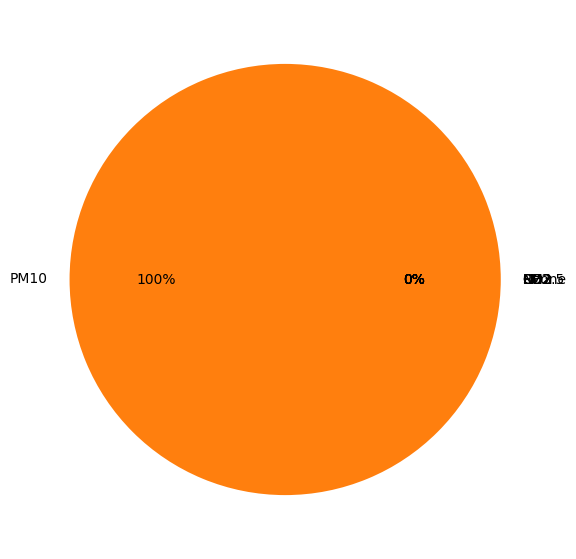

In [108]:
# Here we are finding which pollutant is responsible for how many Moderately Polluted days
rows = pd.DataFrame(columns=ballygunge_aug.columns)
rows = pd.concat([ballygunge_aug.loc[ballygunge_aug["AQI_Standard"] == "Moderately Polluted"],rows],ignore_index=True)
datetype(rows)

##### September

In the September Months:-
Total number of days : 120
Good : 93 days
Satisfactory : 27 days


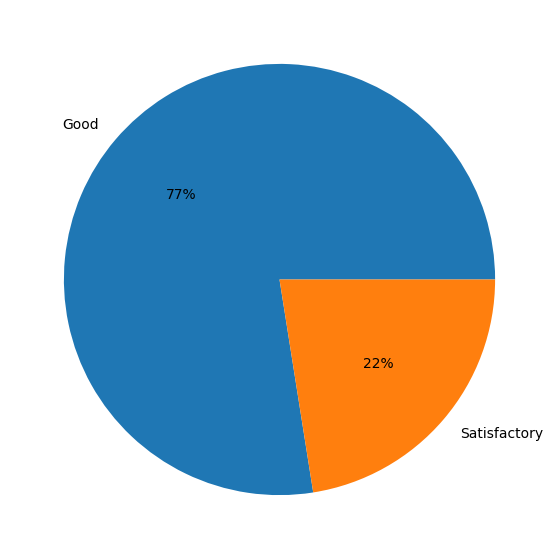

In [109]:
m = ballygunge_sep['AQI_Standard'].value_counts()
stand =ballygunge_sep['AQI_Standard'].unique()
count = []
print("In the September Months:-\nTotal number of days : "+str(len(ballygunge_sep)))
for i in stand:
    count.append(m[i])
    print(str(i) +" : "+str(m[i])+" days")

# Creating plot
fig = plt.figure(figsize =(10, 7))
plt.pie(count, labels = stand,autopct='%1.0f%%')
plt.show()

The total number of days are: 120
The number of days PM2.5 was responsible for the AQI value was:- 3
The number of days PM10 was responsible for the AQI value was:- 74
The number of days NO2 was responsible for the AQI value was:- 14
The number of days NH3 was responsible for the AQI value was:- 0
The number of days SO2 was responsible for the AQI value was:- 0
The number of days CO was responsible for the AQI value was:- 10
The number of days Ozone was responsible for the AQI value was:- 19


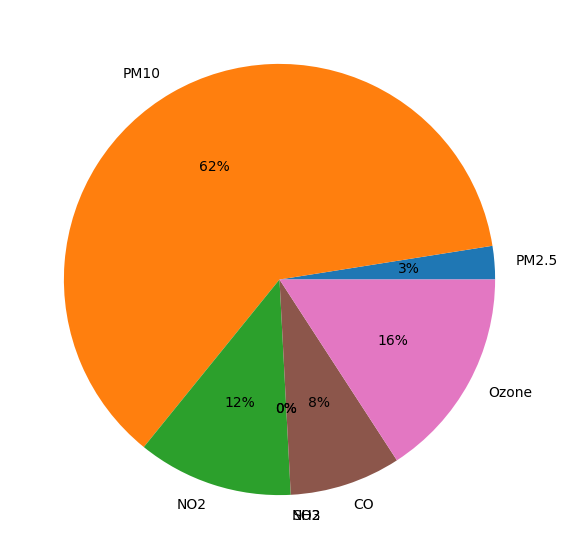

In [110]:
datetype(ballygunge_sep)

The total number of days are: 93
The number of days PM2.5 was responsible for the AQI value was:- 1
The number of days PM10 was responsible for the AQI value was:- 54
The number of days NO2 was responsible for the AQI value was:- 14
The number of days NH3 was responsible for the AQI value was:- 0
The number of days SO2 was responsible for the AQI value was:- 0
The number of days CO was responsible for the AQI value was:- 6
The number of days Ozone was responsible for the AQI value was:- 18


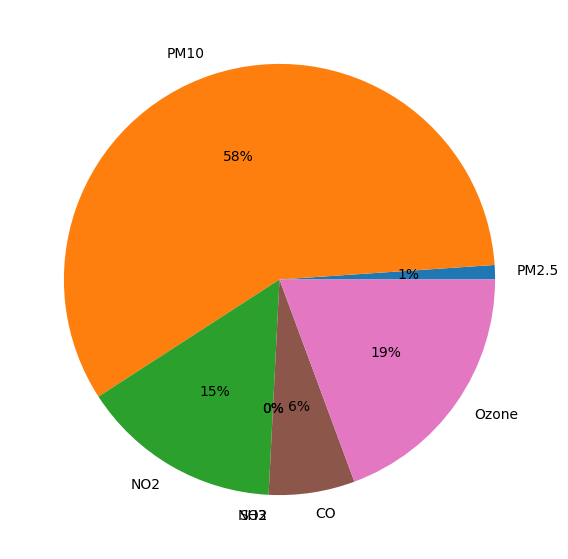

In [111]:
# Here we are finding which pollutant is responsible for how many Good days
rows = pd.DataFrame(columns=ballygunge_sep.columns)
rows = pd.concat([ballygunge_sep.loc[ballygunge_sep["AQI_Standard"] == "Good"],rows],ignore_index=True)
datetype(rows)

The total number of days are: 27
The number of days PM2.5 was responsible for the AQI value was:- 2
The number of days PM10 was responsible for the AQI value was:- 20
The number of days NO2 was responsible for the AQI value was:- 0
The number of days NH3 was responsible for the AQI value was:- 0
The number of days SO2 was responsible for the AQI value was:- 0
The number of days CO was responsible for the AQI value was:- 4
The number of days Ozone was responsible for the AQI value was:- 1


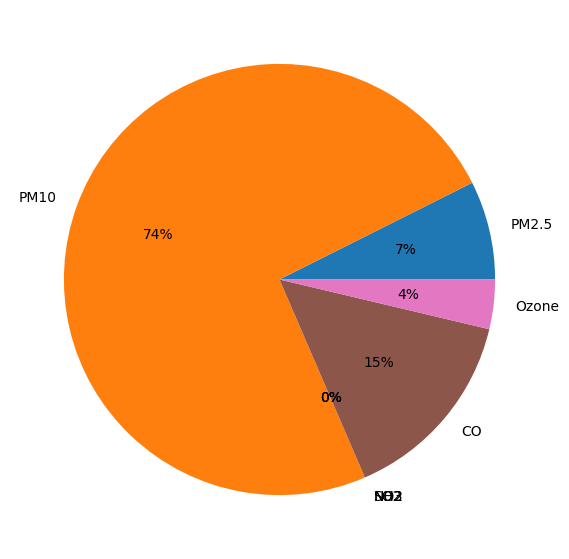

In [112]:
# Here we are finding which pollutant is responsible for how many Satisfactory days
rows = pd.DataFrame(columns=ballygunge_sep.columns)
rows = pd.concat([ballygunge_sep.loc[ballygunge_sep["AQI_Standard"] == "Satisfactory"],rows],ignore_index=True)
datetype(rows)

##### October

In the October Months:-
Total number of days : 124
Moderately Polluted : 50 days
Poor : 6 days
Satisfactory : 44 days
Good : 24 days


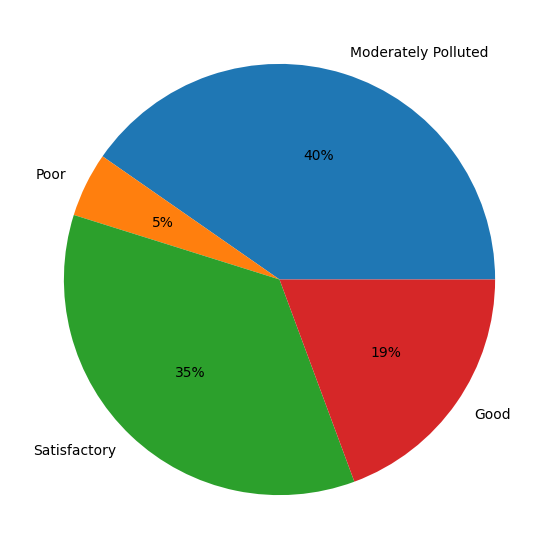

In [113]:
m = ballygunge_oct['AQI_Standard'].value_counts()
stand =ballygunge_oct['AQI_Standard'].unique()
count = []
print("In the October Months:-\nTotal number of days : "+str(len(ballygunge_oct)))
for i in stand:
    count.append(m[i])
    print(str(i) +" : "+str(m[i])+" days")

# Creating plot
fig = plt.figure(figsize =(10, 7))
plt.pie(count, labels = stand,autopct='%1.0f%%')
plt.show()

The total number of days are: 124
The number of days PM2.5 was responsible for the AQI value was:- 33
The number of days PM10 was responsible for the AQI value was:- 76
The number of days NO2 was responsible for the AQI value was:- 0
The number of days NH3 was responsible for the AQI value was:- 0
The number of days SO2 was responsible for the AQI value was:- 0
The number of days CO was responsible for the AQI value was:- 4
The number of days Ozone was responsible for the AQI value was:- 11


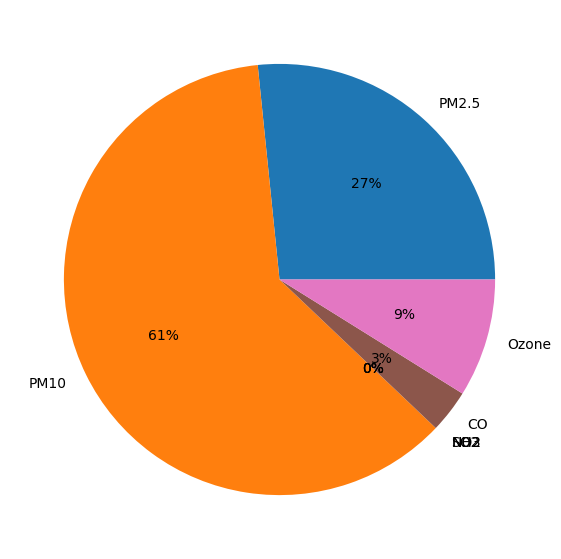

In [114]:
datetype(ballygunge_oct)

The total number of days are: 24
The number of days PM2.5 was responsible for the AQI value was:- 0
The number of days PM10 was responsible for the AQI value was:- 20
The number of days NO2 was responsible for the AQI value was:- 0
The number of days NH3 was responsible for the AQI value was:- 0
The number of days SO2 was responsible for the AQI value was:- 0
The number of days CO was responsible for the AQI value was:- 1
The number of days Ozone was responsible for the AQI value was:- 3


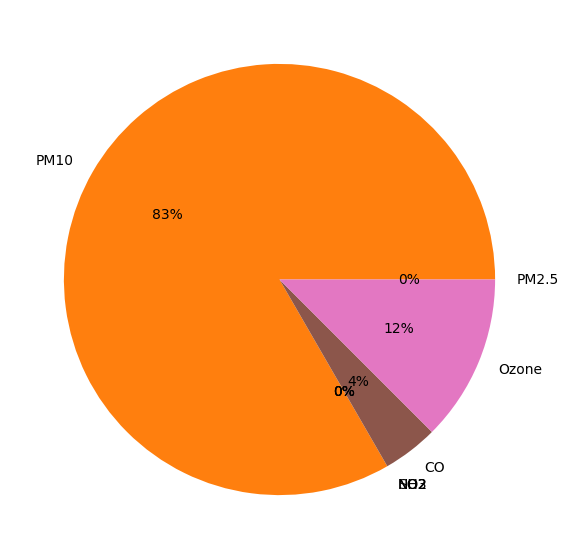

In [115]:
# Here we are finding which pollutant is responsible for how many Good days
rows = pd.DataFrame(columns=ballygunge_oct.columns)
rows = pd.concat([ballygunge_oct.loc[ballygunge_oct["AQI_Standard"] == "Good"],rows],ignore_index=True)
datetype(rows)

The total number of days are: 44
The number of days PM2.5 was responsible for the AQI value was:- 5
The number of days PM10 was responsible for the AQI value was:- 28
The number of days NO2 was responsible for the AQI value was:- 0
The number of days NH3 was responsible for the AQI value was:- 0
The number of days SO2 was responsible for the AQI value was:- 0
The number of days CO was responsible for the AQI value was:- 3
The number of days Ozone was responsible for the AQI value was:- 8


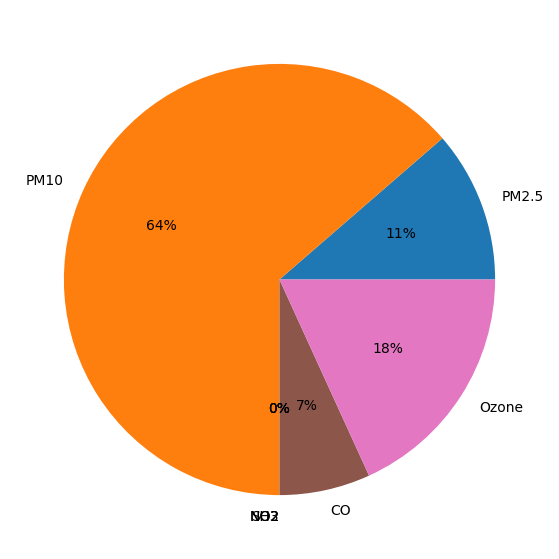

In [116]:
# Here we are finding which pollutant is responsible for how many Satisfactory days
rows = pd.DataFrame(columns=ballygunge_oct.columns)
rows = pd.concat([ballygunge_oct.loc[ballygunge_oct["AQI_Standard"] == "Satisfactory"],rows],ignore_index=True)
datetype(rows)

The total number of days are: 50
The number of days PM2.5 was responsible for the AQI value was:- 23
The number of days PM10 was responsible for the AQI value was:- 27
The number of days NO2 was responsible for the AQI value was:- 0
The number of days NH3 was responsible for the AQI value was:- 0
The number of days SO2 was responsible for the AQI value was:- 0
The number of days CO was responsible for the AQI value was:- 0
The number of days Ozone was responsible for the AQI value was:- 0


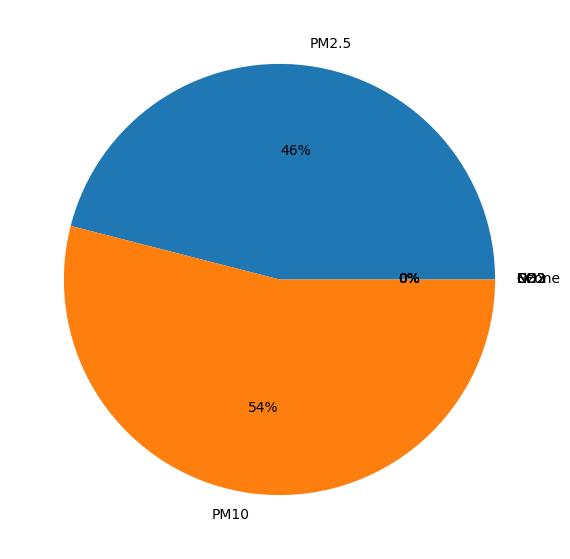

In [117]:
# Here we are finding which pollutant is responsible for how many Moderately Polluted days
rows = pd.DataFrame(columns=ballygunge_oct.columns)
rows = pd.concat([ballygunge_oct.loc[ballygunge_oct["AQI_Standard"] == "Moderately Polluted"],rows],ignore_index=True)
datetype(rows)

The total number of days are: 6
The number of days PM2.5 was responsible for the AQI value was:- 5
The number of days PM10 was responsible for the AQI value was:- 1
The number of days NO2 was responsible for the AQI value was:- 0
The number of days NH3 was responsible for the AQI value was:- 0
The number of days SO2 was responsible for the AQI value was:- 0
The number of days CO was responsible for the AQI value was:- 0
The number of days Ozone was responsible for the AQI value was:- 0


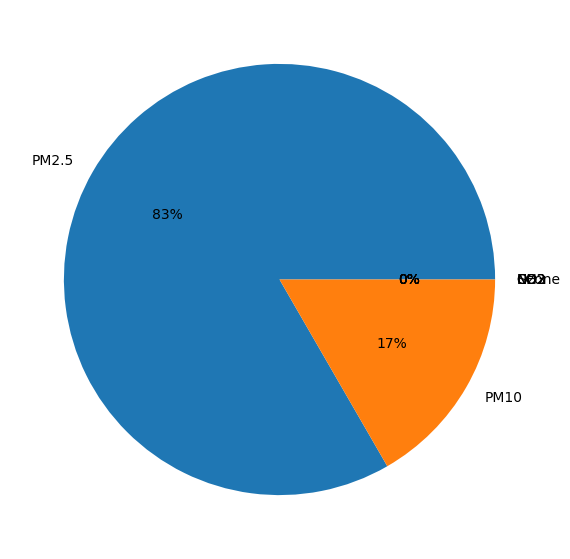

In [118]:
# Here we are finding which pollutant is responsible for how many Poor days
rows = pd.DataFrame(columns=ballygunge_oct.columns)
rows = pd.concat([ballygunge_oct.loc[ballygunge_oct["AQI_Standard"] == "Poor"],rows],ignore_index=True)
datetype(rows)

##### November

In the November Months:-
Total number of days : 120
Moderately Polluted : 50 days
Very poor : 15 days
Poor : 46 days
Satisfactory : 6 days
Good : 3 days


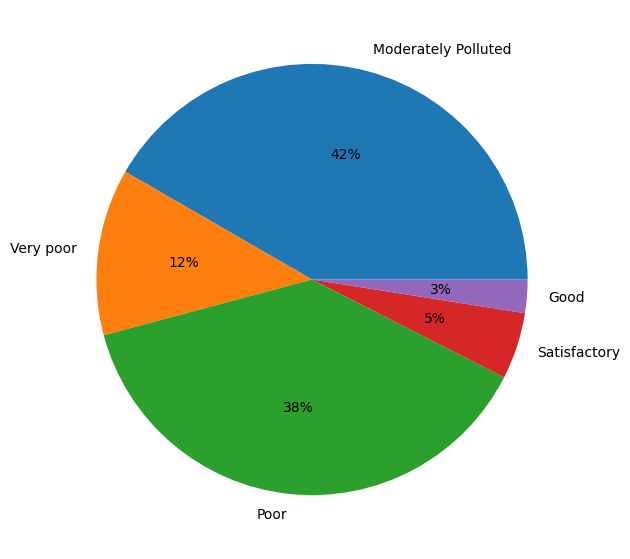

In [119]:
m = ballygunge_nov['AQI_Standard'].value_counts()
stand =ballygunge_nov['AQI_Standard'].unique()
count = []
print("In the November Months:-\nTotal number of days : "+str(len(ballygunge_nov)))
for i in stand:
    count.append(m[i])
    print(str(i) +" : "+str(m[i])+" days")

# Creating plot
fig = plt.figure(figsize =(10, 7))
plt.pie(count, labels = stand,autopct='%1.0f%%')
plt.show()

The total number of days are: 120
The number of days PM2.5 was responsible for the AQI value was:- 91
The number of days PM10 was responsible for the AQI value was:- 29
The number of days NO2 was responsible for the AQI value was:- 0
The number of days NH3 was responsible for the AQI value was:- 0
The number of days SO2 was responsible for the AQI value was:- 0
The number of days CO was responsible for the AQI value was:- 0
The number of days Ozone was responsible for the AQI value was:- 0


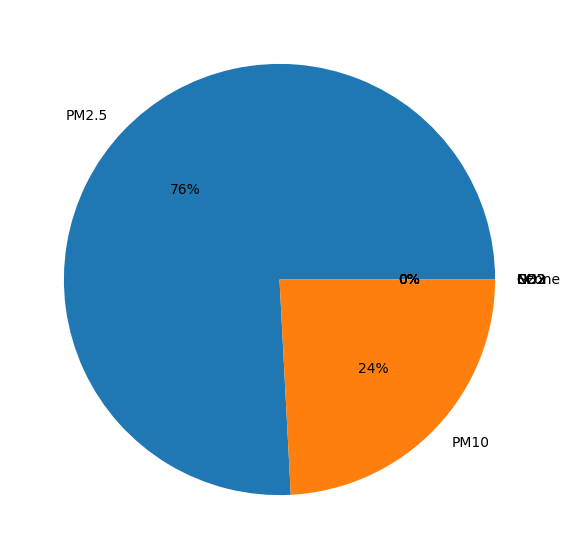

In [120]:
datetype(ballygunge_nov)

The total number of days are: 3
The number of days PM2.5 was responsible for the AQI value was:- 0
The number of days PM10 was responsible for the AQI value was:- 3
The number of days NO2 was responsible for the AQI value was:- 0
The number of days NH3 was responsible for the AQI value was:- 0
The number of days SO2 was responsible for the AQI value was:- 0
The number of days CO was responsible for the AQI value was:- 0
The number of days Ozone was responsible for the AQI value was:- 0


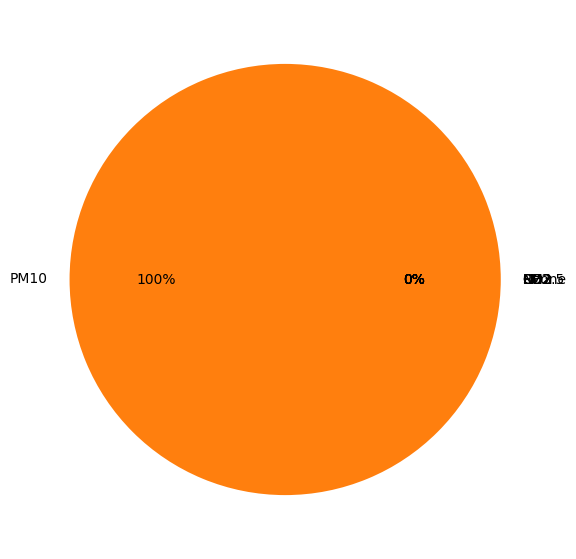

In [121]:
# Here we are finding which pollutant is responsible for how many Good days
rows = pd.DataFrame(columns=ballygunge_nov.columns)
rows = pd.concat([ballygunge_nov.loc[ballygunge_nov["AQI_Standard"] == "Good"],rows],ignore_index=True)
datetype(rows)

The total number of days are: 6
The number of days PM2.5 was responsible for the AQI value was:- 0
The number of days PM10 was responsible for the AQI value was:- 6
The number of days NO2 was responsible for the AQI value was:- 0
The number of days NH3 was responsible for the AQI value was:- 0
The number of days SO2 was responsible for the AQI value was:- 0
The number of days CO was responsible for the AQI value was:- 0
The number of days Ozone was responsible for the AQI value was:- 0


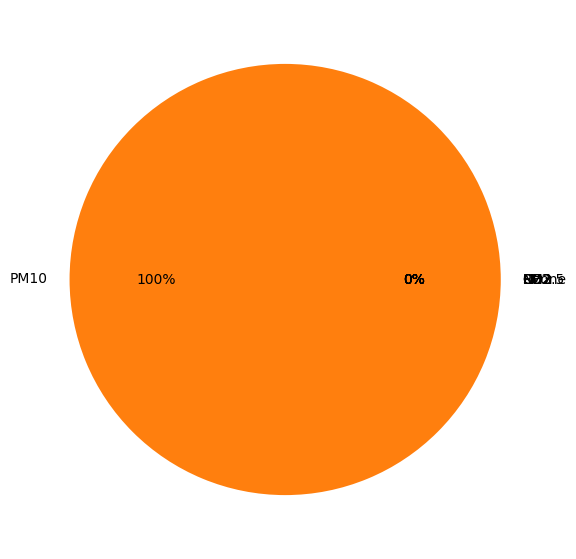

In [122]:
# Here we are finding which pollutant is responsible for how many Satisfactory days
rows = pd.DataFrame(columns=ballygunge_nov.columns)
rows = pd.concat([ballygunge_nov.loc[ballygunge_nov["AQI_Standard"] == "Satisfactory"],rows],ignore_index=True)
datetype(rows)

The total number of days are: 50
The number of days PM2.5 was responsible for the AQI value was:- 30
The number of days PM10 was responsible for the AQI value was:- 20
The number of days NO2 was responsible for the AQI value was:- 0
The number of days NH3 was responsible for the AQI value was:- 0
The number of days SO2 was responsible for the AQI value was:- 0
The number of days CO was responsible for the AQI value was:- 0
The number of days Ozone was responsible for the AQI value was:- 0


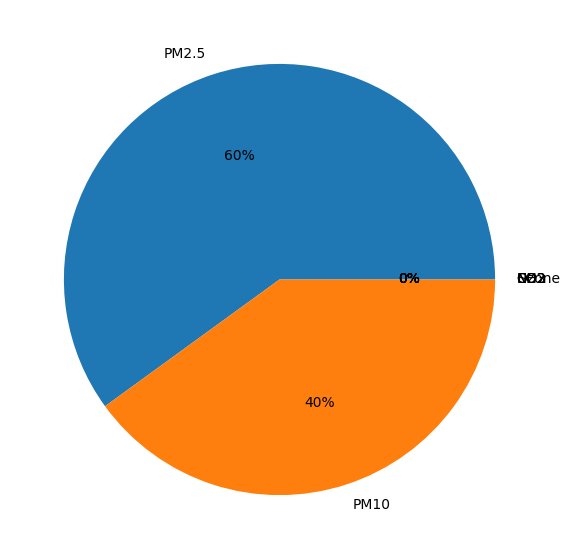

In [123]:
# Here we are finding which pollutant is responsible for how many Moderately Polluted days
rows = pd.DataFrame(columns=ballygunge_nov.columns)
rows = pd.concat([ballygunge_nov.loc[ballygunge_nov["AQI_Standard"] == "Moderately Polluted"],rows],ignore_index=True)
datetype(rows)

The total number of days are: 46
The number of days PM2.5 was responsible for the AQI value was:- 46
The number of days PM10 was responsible for the AQI value was:- 0
The number of days NO2 was responsible for the AQI value was:- 0
The number of days NH3 was responsible for the AQI value was:- 0
The number of days SO2 was responsible for the AQI value was:- 0
The number of days CO was responsible for the AQI value was:- 0
The number of days Ozone was responsible for the AQI value was:- 0


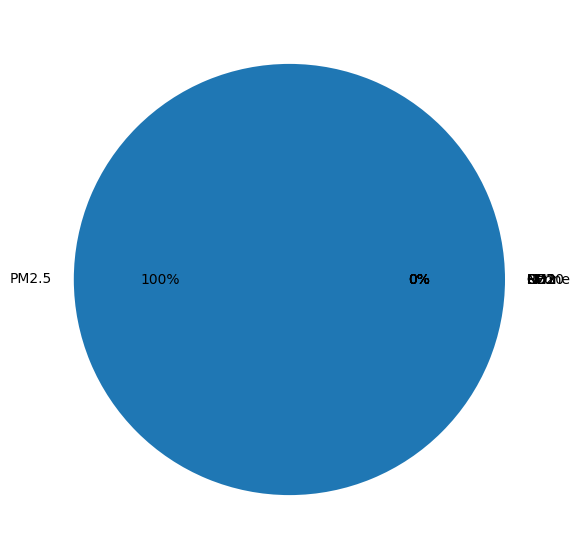

In [124]:
# Here we are finding which pollutant is responsible for how many Poor days
rows = pd.DataFrame(columns=ballygunge_nov.columns)
rows = pd.concat([ballygunge_nov.loc[ballygunge_nov["AQI_Standard"] == "Poor"],rows],ignore_index=True)
datetype(rows)

The total number of days are: 15
The number of days PM2.5 was responsible for the AQI value was:- 15
The number of days PM10 was responsible for the AQI value was:- 0
The number of days NO2 was responsible for the AQI value was:- 0
The number of days NH3 was responsible for the AQI value was:- 0
The number of days SO2 was responsible for the AQI value was:- 0
The number of days CO was responsible for the AQI value was:- 0
The number of days Ozone was responsible for the AQI value was:- 0


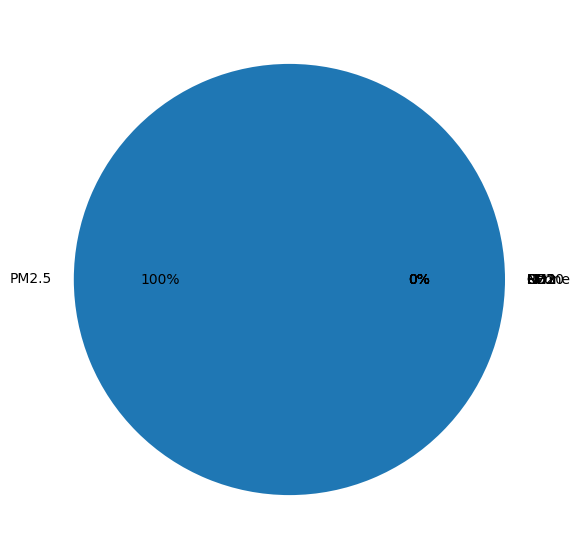

In [125]:
# Here we are finding which pollutant is responsible for how many Very Poor days
rows = pd.DataFrame(columns=ballygunge_nov.columns)
rows = pd.concat([ballygunge_nov.loc[ballygunge_nov["AQI_Standard"] == "Very poor"],rows],ignore_index=True)
datetype(rows)

##### December

In the December Months:-
Total number of days : 124
Poor : 36 days
Moderately Polluted : 19 days
Very poor : 65 days
Satisfactory : 3 days
Good : 1 days


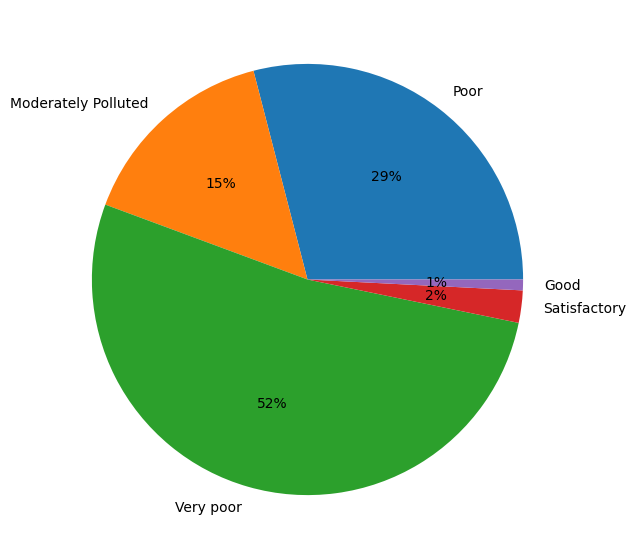

In [126]:
m = ballygunge_dec['AQI_Standard'].value_counts()
stand =ballygunge_dec['AQI_Standard'].unique()
count = []
print("In the December Months:-\nTotal number of days : "+str(len(ballygunge_dec)))
for i in stand:
    count.append(m[i])
    print(str(i) +" : "+str(m[i])+" days")

# Creating plot
fig = plt.figure(figsize =(10, 7))
plt.pie(count, labels = stand,autopct='%1.0f%%')
plt.show()

The total number of days are: 124
The number of days PM2.5 was responsible for the AQI value was:- 118
The number of days PM10 was responsible for the AQI value was:- 5
The number of days NO2 was responsible for the AQI value was:- 1
The number of days NH3 was responsible for the AQI value was:- 0
The number of days SO2 was responsible for the AQI value was:- 0
The number of days CO was responsible for the AQI value was:- 0
The number of days Ozone was responsible for the AQI value was:- 0


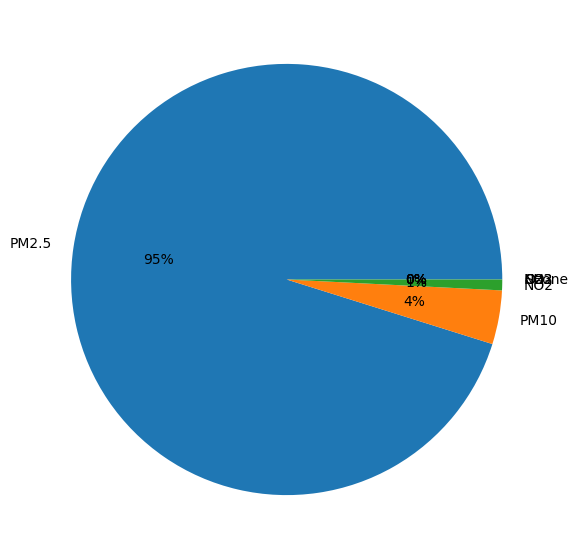

In [127]:
datetype(ballygunge_dec)

The total number of days are: 1
The number of days PM2.5 was responsible for the AQI value was:- 0
The number of days PM10 was responsible for the AQI value was:- 0
The number of days NO2 was responsible for the AQI value was:- 1
The number of days NH3 was responsible for the AQI value was:- 0
The number of days SO2 was responsible for the AQI value was:- 0
The number of days CO was responsible for the AQI value was:- 0
The number of days Ozone was responsible for the AQI value was:- 0


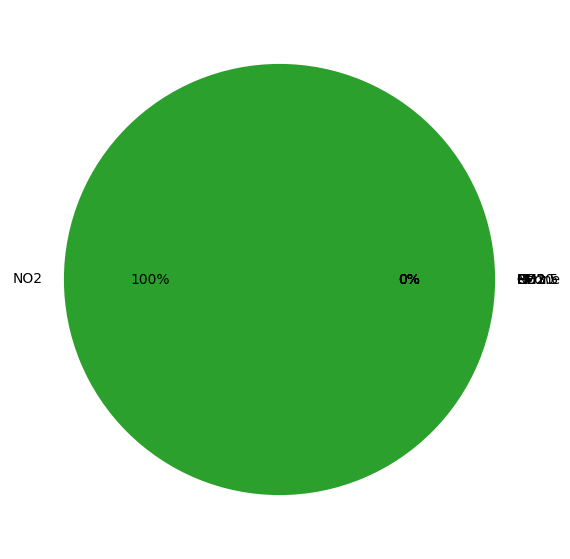

In [128]:
# Here we are finding which pollutant is responsible for how many Good days
rows = pd.DataFrame(columns=ballygunge_dec.columns)
rows = pd.concat([ballygunge_dec.loc[ballygunge_dec["AQI_Standard"] == "Good"],rows],ignore_index=True)
datetype(rows)

The total number of days are: 3
The number of days PM2.5 was responsible for the AQI value was:- 1
The number of days PM10 was responsible for the AQI value was:- 2
The number of days NO2 was responsible for the AQI value was:- 0
The number of days NH3 was responsible for the AQI value was:- 0
The number of days SO2 was responsible for the AQI value was:- 0
The number of days CO was responsible for the AQI value was:- 0
The number of days Ozone was responsible for the AQI value was:- 0


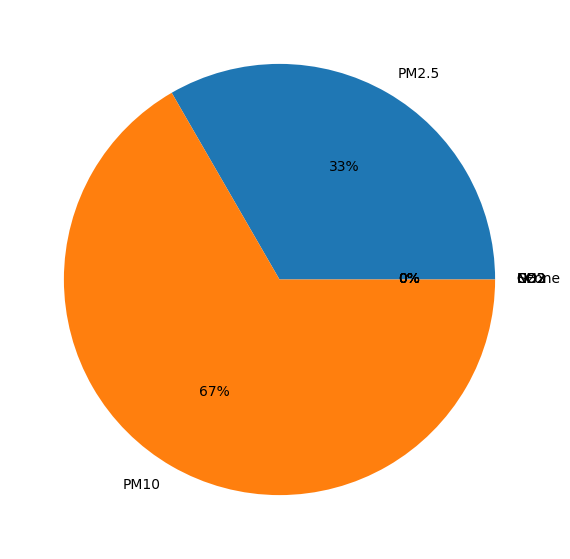

In [129]:
# Here we are finding which pollutant is responsible for how many Satisfactory days
rows = pd.DataFrame(columns=ballygunge_dec.columns)
rows = pd.concat([ballygunge_dec.loc[ballygunge_dec["AQI_Standard"] == "Satisfactory"],rows],ignore_index=True)
datetype(rows)

The total number of days are: 19
The number of days PM2.5 was responsible for the AQI value was:- 16
The number of days PM10 was responsible for the AQI value was:- 3
The number of days NO2 was responsible for the AQI value was:- 0
The number of days NH3 was responsible for the AQI value was:- 0
The number of days SO2 was responsible for the AQI value was:- 0
The number of days CO was responsible for the AQI value was:- 0
The number of days Ozone was responsible for the AQI value was:- 0


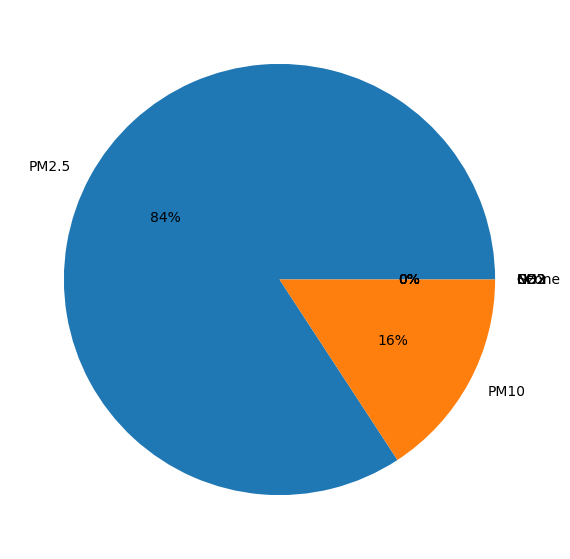

In [130]:
# Here we are finding which pollutant is responsible for how many Moderately Polluted days
rows = pd.DataFrame(columns=ballygunge_dec.columns)
rows = pd.concat([ballygunge_dec.loc[ballygunge_dec["AQI_Standard"] == "Moderately Polluted"],rows],ignore_index=True)
datetype(rows)

The total number of days are: 36
The number of days PM2.5 was responsible for the AQI value was:- 36
The number of days PM10 was responsible for the AQI value was:- 0
The number of days NO2 was responsible for the AQI value was:- 0
The number of days NH3 was responsible for the AQI value was:- 0
The number of days SO2 was responsible for the AQI value was:- 0
The number of days CO was responsible for the AQI value was:- 0
The number of days Ozone was responsible for the AQI value was:- 0


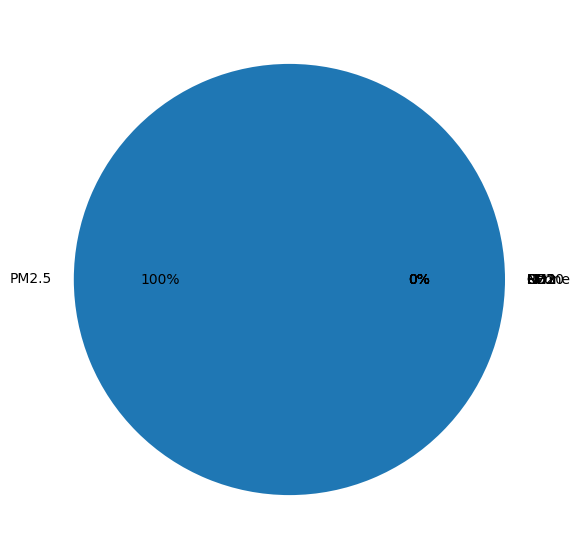

In [131]:
# Here we are finding which pollutant is responsible for how many Poor days
rows = pd.DataFrame(columns=ballygunge_dec.columns)
rows = pd.concat([ballygunge_dec.loc[ballygunge_dec["AQI_Standard"] == "Poor"],rows],ignore_index=True)
datetype(rows)

The total number of days are: 65
The number of days PM2.5 was responsible for the AQI value was:- 65
The number of days PM10 was responsible for the AQI value was:- 0
The number of days NO2 was responsible for the AQI value was:- 0
The number of days NH3 was responsible for the AQI value was:- 0
The number of days SO2 was responsible for the AQI value was:- 0
The number of days CO was responsible for the AQI value was:- 0
The number of days Ozone was responsible for the AQI value was:- 0


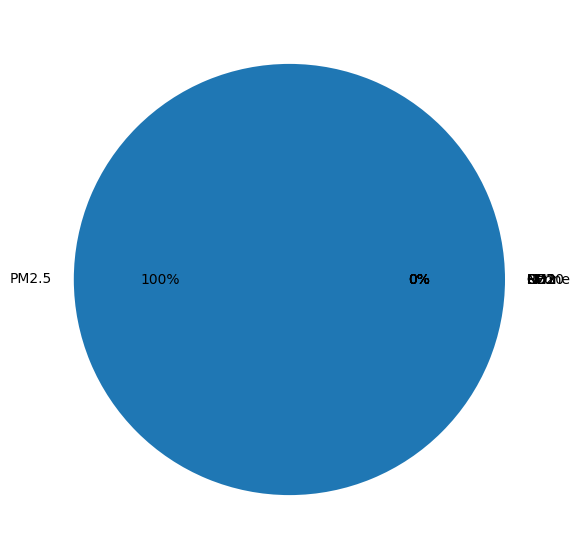

In [132]:
# Here we are finding which pollutant is responsible for how many Very poor days
rows = pd.DataFrame(columns=ballygunge_dec.columns)
rows = pd.concat([ballygunge_dec.loc[ballygunge_dec["AQI_Standard"] == "Very poor"],rows],ignore_index=True)
datetype(rows)

### Particulate Matter 2.5 (PM 2.5)
##### PM2.5 are tiny particles in the air that reduce visibility, several health hazards and cause the air to appear hazy when levels are elevated.
##### According to the data from Continious station Ballygunge, PM 2.5 has a very high positive correlation with the air qualty index on the other hand it seems to be inversely correlated to the atmospheric temperature.

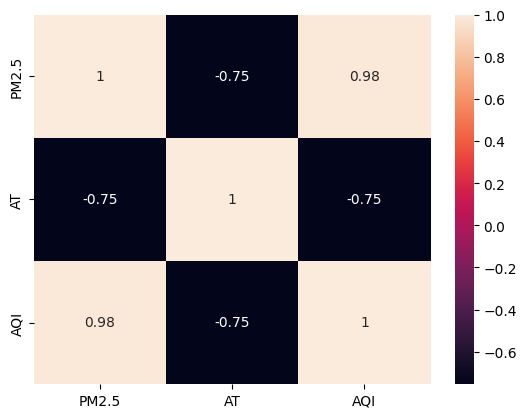

In [133]:
dataplot = sb.heatmap(ballygunge[['PM2.5','AT','AQI']].corr(), annot=True)
plt.show()

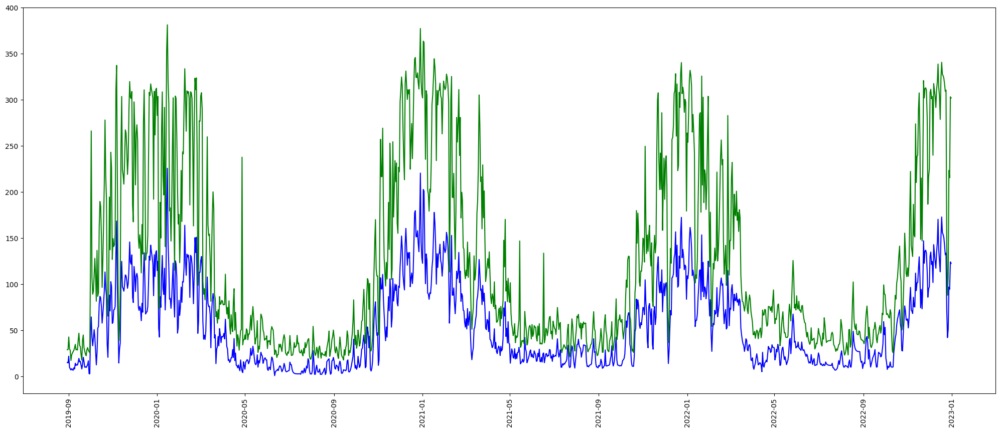

In [134]:
plt.figure(figsize=(25, 10))
plt.plot(ballygunge["Date"],ballygunge["PM2.5"], color = "blue")
plt.plot(ballygunge["Date"],ballygunge["AQI"],color = "green")
plt.xticks(rotation='vertical')
plt.show()

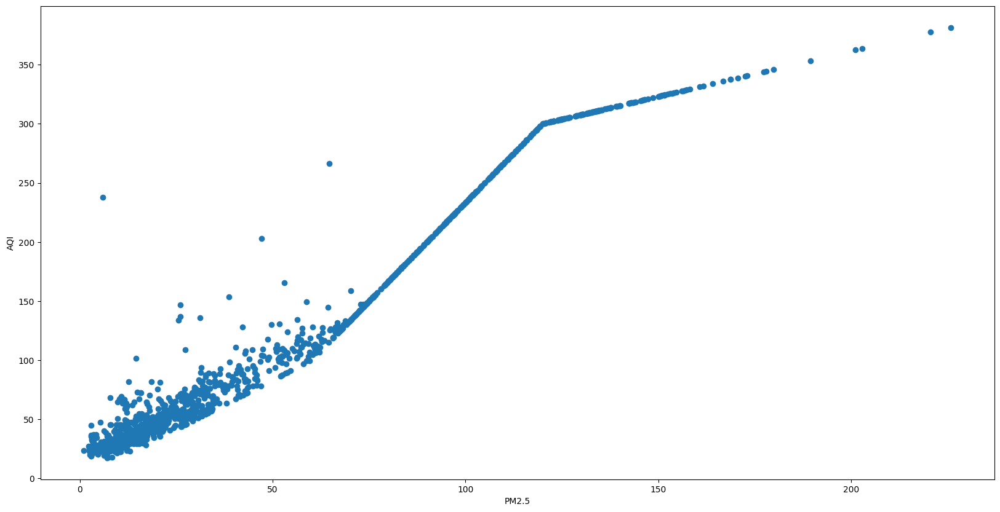

In [135]:
plt.figure(figsize=(20,10))
plt.scatter(x=ballygunge['PM2.5'],y=ballygunge['AQI'])
plt.xlabel("PM2.5")
plt.ylabel("AQI")
plt.show()

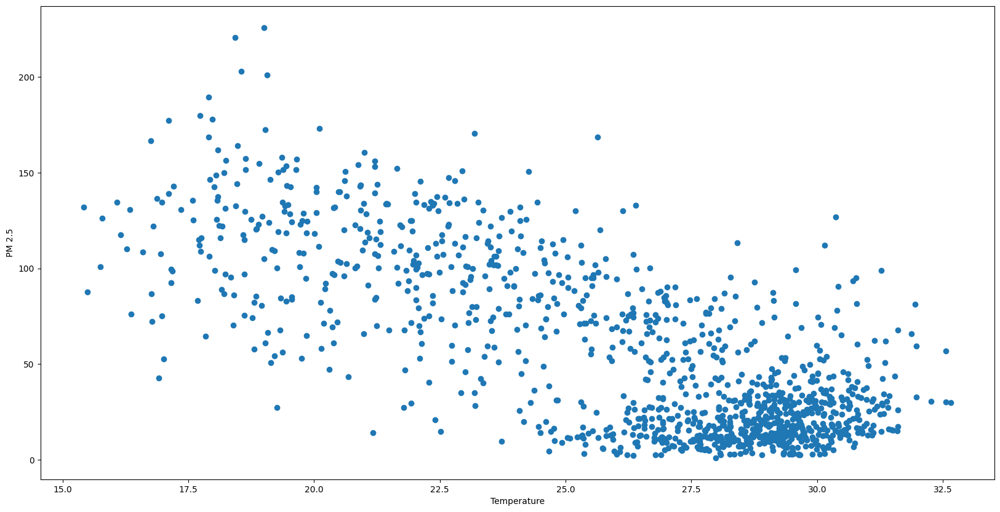

In [136]:
plt.figure(figsize=(20,10))
plt.scatter(x=ballygunge["AT"],y=ballygunge["PM2.5"])
plt.xlabel("Temperature")
plt.ylabel("PM 2.5")
plt.show()

[]

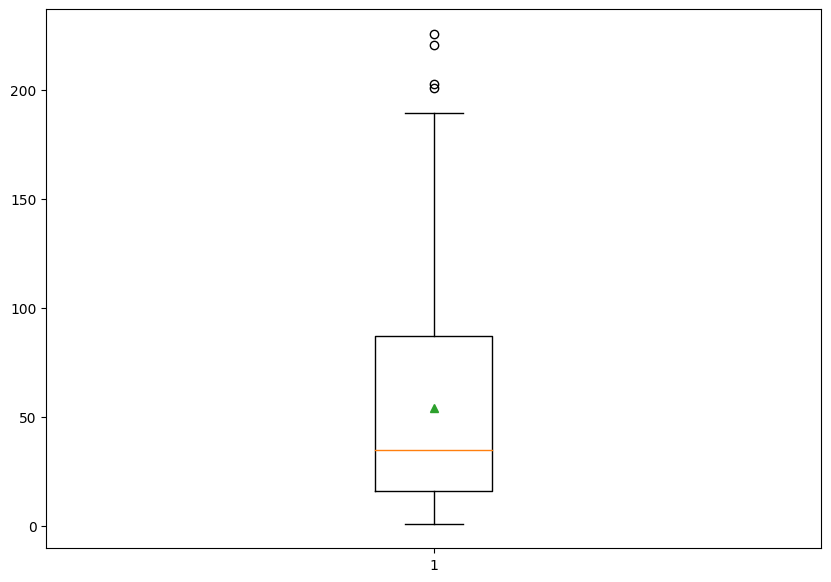

In [137]:
plt.figure(figsize =(10, 7))
plt.boxplot(ballygunge["PM2.5"],showmeans=True)
plt.plot()

##### Just from the 2 plots below we can clearly see the concentration of PM2.5 remains higher than 30 µg/m3(acceptable limit as per set by Central Pollution Control Board of India) throught out the year excet during the monsoon seasons similar to what we saw earlier in the plot of AQI. And earlier as we saw from the corelation heat map that PM2.5 has a very high positive correation with the AQI whose resemblence we can also see if we compare PM2.5 plot with AQI plot. So here we can cleary say that PM2.5 plays a major role in polluting the air in and arroung Ballygunge.

The highest value of PM 2.5 in the 1220 days time period was  225.91  recorded on 2020-01-15 
and the lowest value was  1.04  recorded on 2020-06-11 
The average PM2.5 value was  54.08 
PM2.5 value had a standard deviation of  44.94 .
The number of days PM2.5 was responsible for the AQI value was:- 462 which is around 37.87%


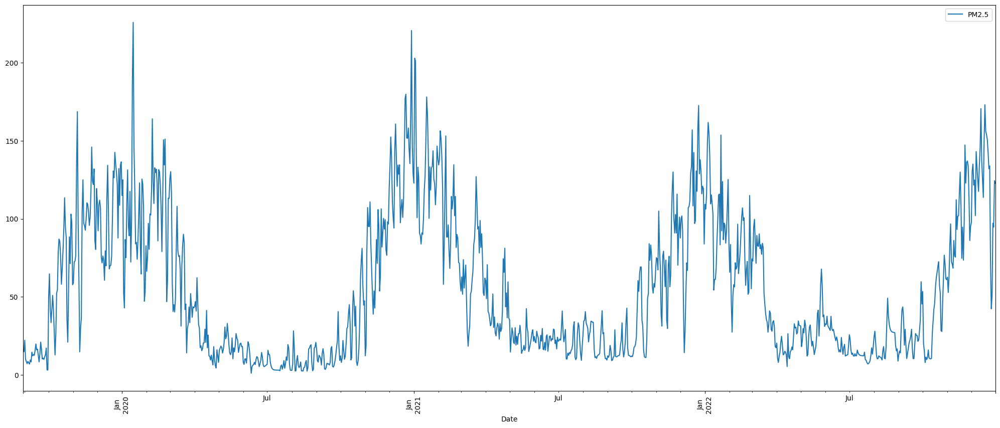

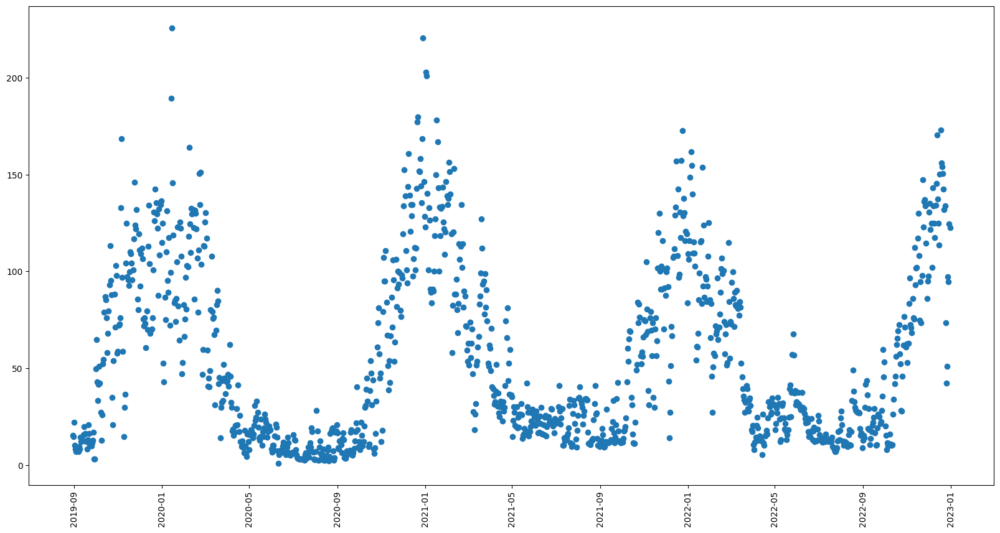

In [138]:
count = 0
for i in range(len(ballygunge)):
    if (PM25(ballygunge["PM2.5"][i]) == ballygunge["AQI"][i]):
        count = count+1
percent = (count/len(ballygunge))*100
print ("The highest value of PM 2.5 in the " +str(len(ballygunge)) +
       " days time period was ",ballygunge["PM2.5"].loc[ballygunge['PM2.5'].idxmax()],
       " recorded on", str(ballygunge["Date"].loc[ballygunge['PM2.5'].idxmax()])[:10],
       '\nand the lowest value was ',ballygunge["PM2.5"].loc[ballygunge['PM2.5'].idxmin()], 
       " recorded on",str(ballygunge["Date"].loc[ballygunge['PM2.5'].idxmin()])[:10],
       "\nThe average PM2.5 value was ",str(round(ballygunge["PM2.5"].mean(),2)),
       "\nPM2.5 value had a standard deviation of ",str(round(ballygunge["PM2.5"].std(),2)),
       '.\nThe number of days PM2.5 was responsible for the AQI value was:- '+str(count)+
      " which is around "+str(round(percent,2))+"%")


a = ballygunge.plot(x='Date',y='PM2.5',figsize=(25, 10))
plt.xticks(rotation='vertical')
plt.show()

f = plt.figure()
f.set_figwidth(20)
f.set_figheight(10)
plt.plot_date(ballygunge['Date'],ballygunge['PM2.5'])
plt.xticks(rotation='vertical')
plt.show()

#### Sources of PM2.5
PM2.5 primarily come from cars, truck, bus and off-road vehicle (e.g., construction equipment, locomotive) exhausts, other operations that involve the burning of fuels such as wood, heating oil or coal and natural sources such as forest, grass fires and even power plants.
#### Problems Caused by high concentration of PM2.5
Particles in the PM2.5 size range are able to travel deeply into the respiratory tract, reaching the lungs. 
Exposure to fine particles can cause short-term health effects such as eye, nose, throat and lung irritation, coughing, sneezing, runny nose, shortness of breath, affect lung function and worsen medical conditions such as asthma and heart disease.
Increases in daily PM2.5 exposure with increased respiratory and cardiovascular hospital admissions, emergency department visits and deaths. Studies also suggest that long term exposure to fine particulate matter may be associated with increased rates of chronic bronchitis, reduced lung function and increased mortality from lung cancer and heart disease. People with breathing and heart problems, children and the elderly may be particularly sensitive to PM2.5.

##### PM2.5 2019

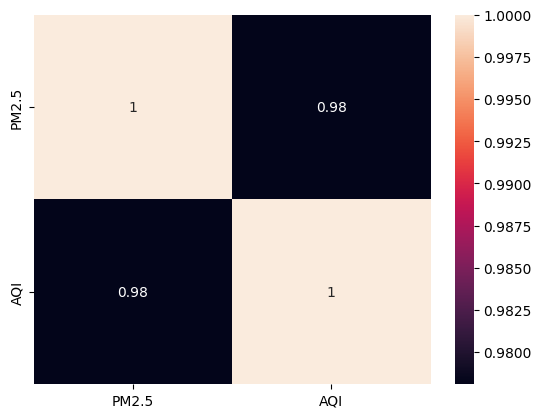

In [139]:
dataplot = sb.heatmap(ballygunge_2019[['PM2.5','AQI']].corr(), annot=True)
plt.show()

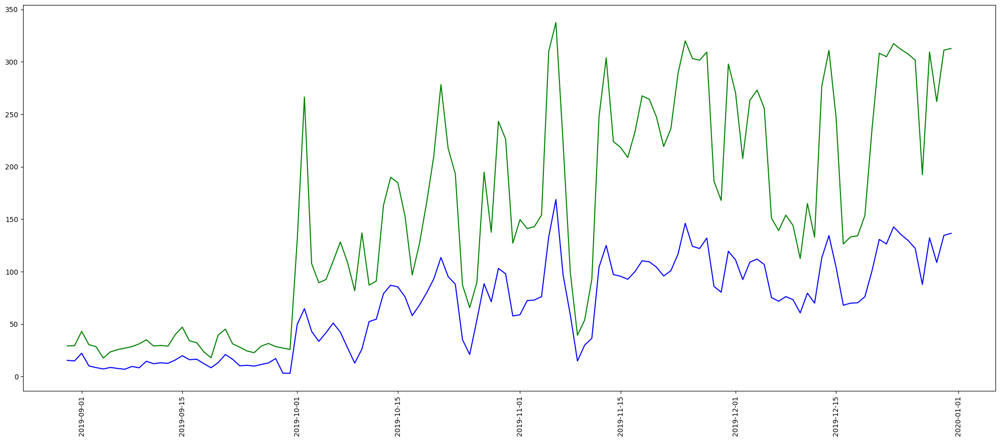

In [140]:
plt.figure(figsize=(25, 10))
plt.plot(ballygunge_2019["Date"],ballygunge_2019["PM2.5"], color = "blue")
plt.plot(ballygunge_2019["Date"],ballygunge_2019["AQI"],color = "green")
plt.xticks(rotation='vertical')
plt.show()

[]

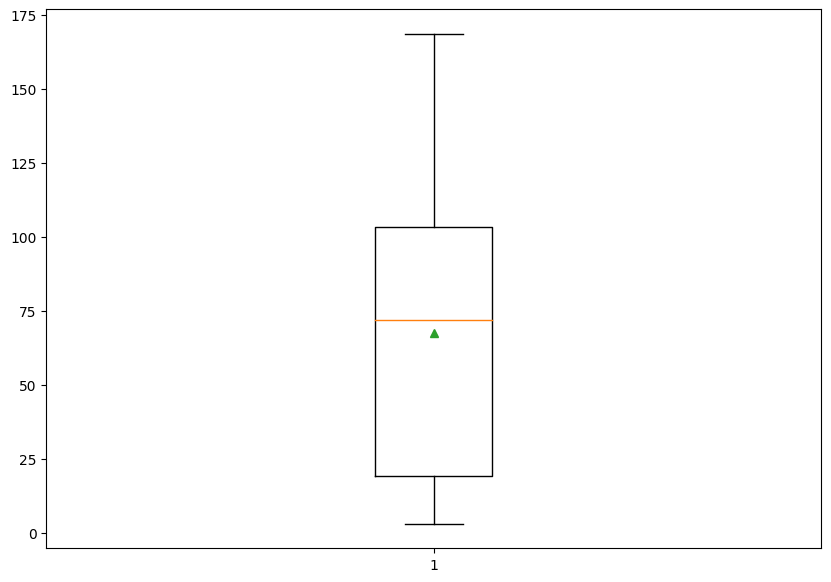

In [141]:
plt.figure(figsize =(10, 7))
plt.boxplot(ballygunge_2019["PM2.5"],showmeans=True)
plt.plot()

The highest value of PM2.5 in the 124 days time period was  168.7  recorded on 2019-11-06 
and the lowest value was  3.01  recorded on 2019-09-30 
The average PM2.5 value was  67.55 
PM2.5 value had a standard deviation of  43.75 .
In 2019 the number of days PM2.5 was responsible for the AQI value was:- 74 which is around 59.68%


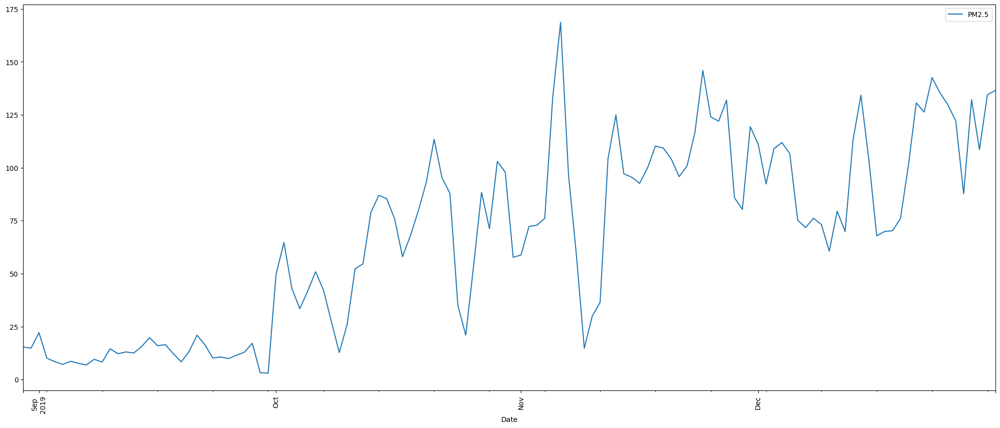

In [142]:
count = 0
for i in range(len(ballygunge_2019)):
    if (PM25(ballygunge_2019["PM2.5"][i]) == ballygunge_2019["AQI"][i]):
        count = count+1
percent = (count/len(ballygunge_2019))*100

print ("The highest value of PM2.5 in the "+str(len(ballygunge_2019))+
       " days time period was ",ballygunge_2019["PM2.5"].loc[ballygunge_2019['PM2.5'].idxmax()],
       " recorded on", str(ballygunge_2019["Date"].loc[ballygunge_2019['PM2.5'].idxmax()])[:10],
       '\nand the lowest value was ',ballygunge_2019["PM2.5"].loc[ballygunge_2019['PM2.5'].idxmin()], 
       " recorded on",str(ballygunge_2019["Date"].loc[ballygunge_2019['PM2.5'].idxmin()])[:10],
       "\nThe average PM2.5 value was ",str(round(ballygunge_2019["PM2.5"].mean(),2)),
       "\nPM2.5 value had a standard deviation of ",str(round(ballygunge_2019["PM2.5"].std(),2)),
       '.\nIn 2019 the number of days PM2.5 was responsible for the AQI value was:- '+str(count)+
      " which is around "+str(round(percent,2))+"%")

a = ballygunge_2019.plot(x='Date',y='PM2.5',figsize=(25, 10))
plt.xticks(rotation='vertical')
plt.show()

##### PM2.5 2020

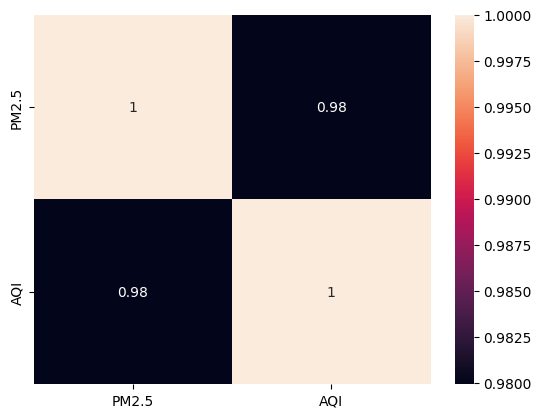

In [143]:
dataplot = sb.heatmap(ballygunge_2020[['PM2.5','AQI']].corr(), annot=True)
plt.show()

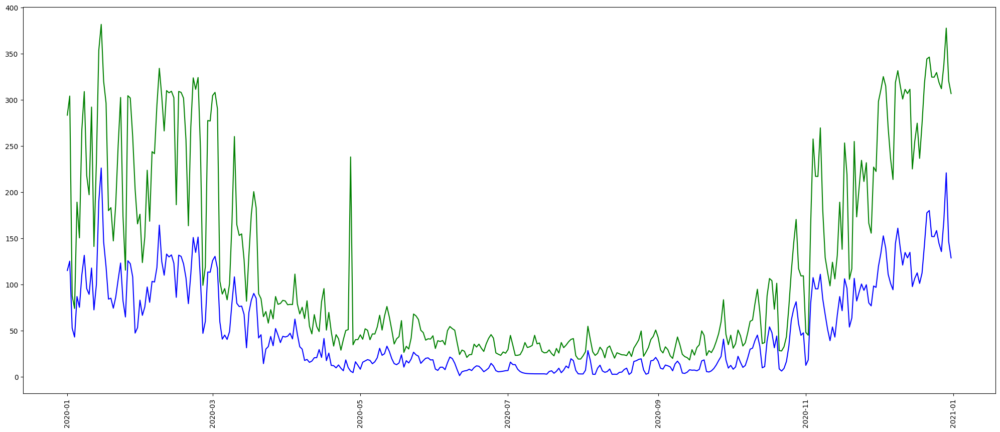

In [144]:
plt.figure(figsize=(25, 10))
plt.plot(ballygunge_2020["Date"],ballygunge_2020["PM2.5"], color = "blue")
plt.plot(ballygunge_2020["Date"],ballygunge_2020["AQI"],color = "green")
plt.xticks(rotation='vertical')
plt.show()

[]

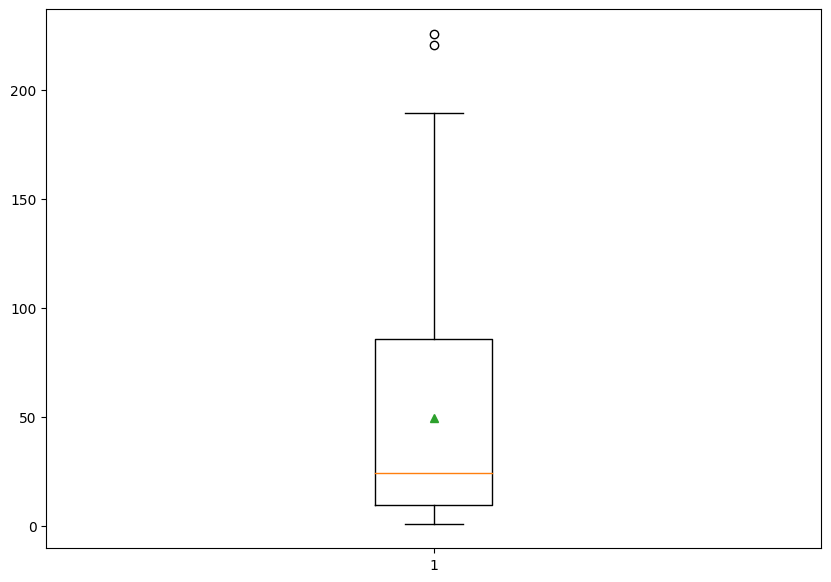

In [145]:
plt.figure(figsize =(10, 7))
plt.boxplot(ballygunge_2020["PM2.5"],showmeans=True)
plt.plot()

The highest value of PM2.5 in the 366 days time period was  225.91  recorded on 2020-01-15 
and the lowest value was  1.04  recorded on 2020-06-11 
The average PM2.5 value was  49.61 
PM2.5 value had a standard deviation of  49.03 
In 2020 the number of days PM2.5 was responsible for the AQI value was:- 123 which is around 33.61%


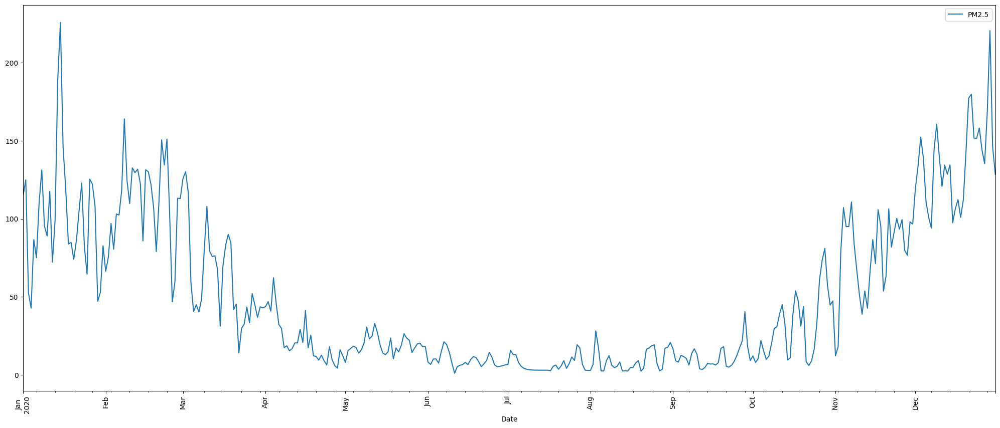

In [146]:
count = 0
for i in range(len(ballygunge_2020)):
    if (PM25(ballygunge_2020["PM2.5"][i]) == ballygunge_2020["AQI"][i]):
        count = count+1
percent = (count/len(ballygunge_2020))*100

print ("The highest value of PM2.5 in the "+str(len(ballygunge_2020))+
       " days time period was ",ballygunge_2020["PM2.5"].loc[ballygunge_2020['PM2.5'].idxmax()],
       " recorded on", str(ballygunge_2020["Date"].loc[ballygunge_2020['PM2.5'].idxmax()])[:10],
       '\nand the lowest value was ',ballygunge_2020["PM2.5"].loc[ballygunge_2020['PM2.5'].idxmin()], 
       " recorded on",str(ballygunge_2020["Date"].loc[ballygunge_2020['PM2.5'].idxmin()])[:10],
       "\nThe average PM2.5 value was ",str(round(ballygunge_2020["PM2.5"].mean(),2)),
       "\nPM2.5 value had a standard deviation of ",str(round(ballygunge_2020["PM2.5"].std(),2)),
       "\nIn 2020 the number of days PM2.5 was responsible for the AQI value was:- "+str(count)+
      " which is around "+str(round(percent,2))+"%")


a = ballygunge_2020.plot(x='Date',y='PM2.5',figsize=(25, 10))
plt.xticks(rotation='vertical')
plt.show()

##### PM2.5 2021

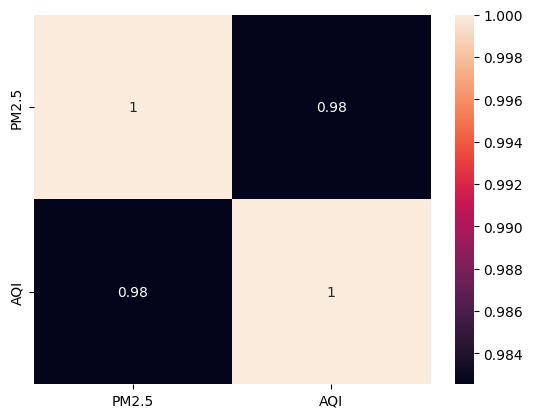

In [147]:
dataplot = sb.heatmap(ballygunge_2021[['PM2.5','AQI']].corr(), annot=True)
plt.show()

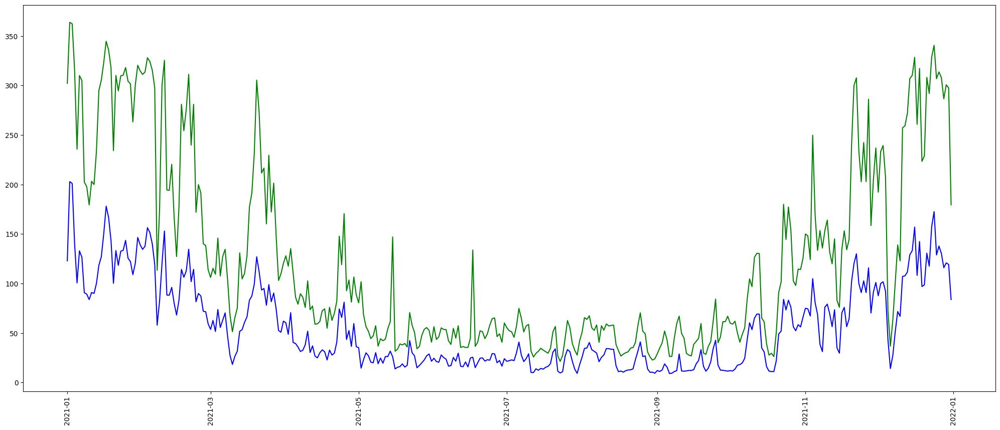

In [148]:
plt.figure(figsize=(25, 10))
plt.plot(ballygunge_2021["Date"],ballygunge_2021["PM2.5"], color = "blue")
plt.plot(ballygunge_2021["Date"],ballygunge_2021["AQI"],color = "green")
plt.xticks(rotation='vertical')
plt.show()

[]

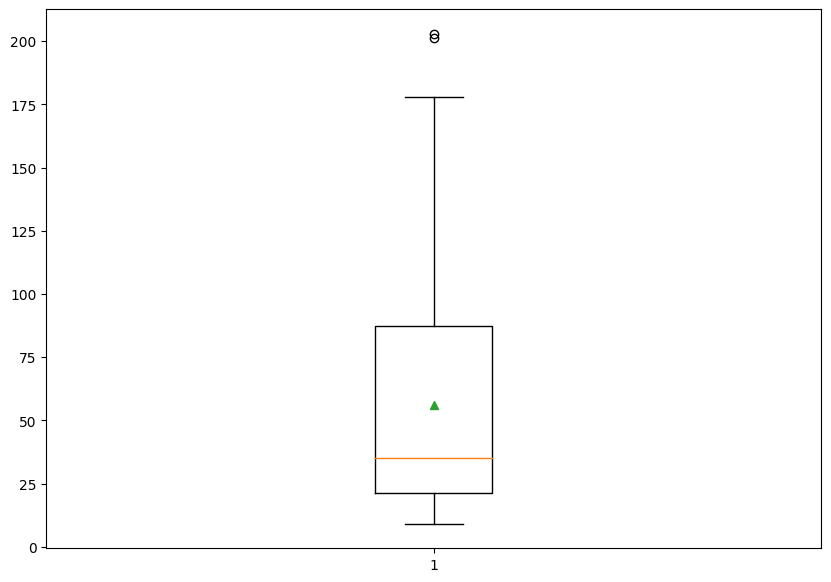

In [149]:
plt.figure(figsize =(10, 7))
plt.boxplot(ballygunge_2021["PM2.5"],showmeans=True)
plt.plot()

The highest value of PM2.5 in the 365 days time period was  202.91  recorded on 2021-01-02 
and the lowest value was  9.09  recorded on 2021-09-06 
The average PM2.5 value was  56.0 
PM2.5 value had a standard deviation of  43.27 
In 2021 the number of days PM2.5 was responsible for the AQI value was:- 138 which is around 37.81%


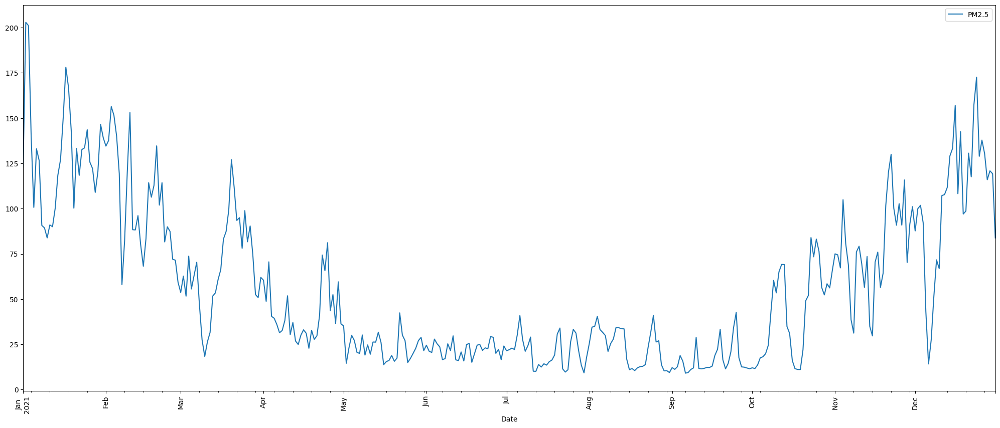

In [150]:
count = 0
for i in range(len(ballygunge_2021)):
    if (PM25(ballygunge_2021["PM2.5"][i]) == ballygunge_2021["AQI"][i]):
        count = count+1
percent = (count/len(ballygunge_2021))*100

print ("The highest value of PM2.5 in the "+str(len(ballygunge_2021))+
       " days time period was ",ballygunge_2021["PM2.5"].loc[ballygunge_2021['PM2.5'].idxmax()],
       " recorded on", str(ballygunge_2021["Date"].loc[ballygunge_2021['PM2.5'].idxmax()])[:10],
       '\nand the lowest value was ',ballygunge_2021["PM2.5"].loc[ballygunge_2021['PM2.5'].idxmin()], 
       " recorded on",str(ballygunge_2021["Date"].loc[ballygunge_2021['PM2.5'].idxmin()])[:10],
       "\nThe average PM2.5 value was ",str(round(ballygunge_2021["PM2.5"].mean(),2)),
       "\nPM2.5 value had a standard deviation of ",str(round(ballygunge_2021["PM2.5"].std(),2)),
       "\nIn 2021 the number of days PM2.5 was responsible for the AQI value was:- "+str(count)+
      " which is around "+str(round(percent,2))+"%")


a = ballygunge_2021.plot(x='Date',y='PM2.5',figsize=(25, 10))
plt.xticks(rotation='vertical')
plt.show()

##### PM2.5 2022

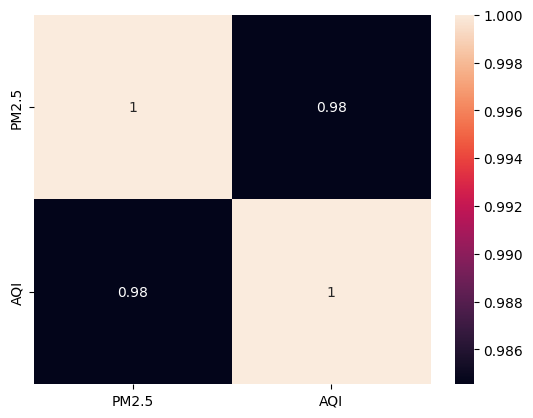

In [151]:
dataplot = sb.heatmap(ballygunge_2022[['PM2.5','AQI']].corr(), annot=True)
plt.show()

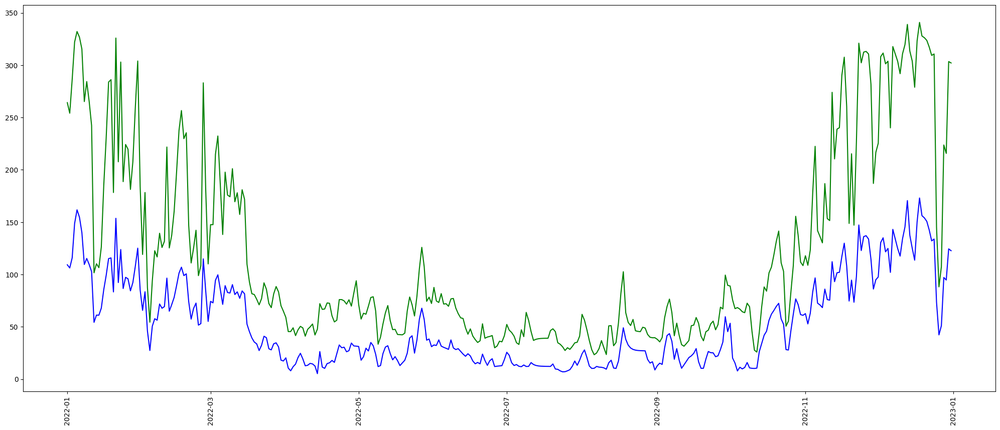

In [152]:
plt.figure(figsize=(25, 10))
plt.plot(ballygunge_2022["Date"],ballygunge_2022["PM2.5"], color = "blue")
plt.plot(ballygunge_2022["Date"],ballygunge_2022["AQI"],color = "green")
plt.xticks(rotation='vertical')
plt.show()

[]

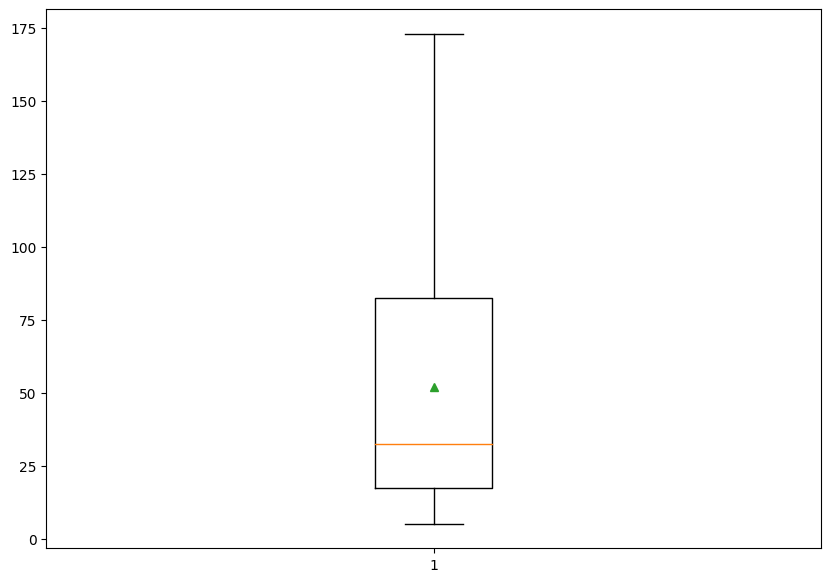

In [153]:
plt.figure(figsize =(10, 7))
plt.boxplot(ballygunge_2022["PM2.5"],showmeans=True)
plt.plot()

The highest value of PM2.5 in the 365 days time period was  173.08  recorded on 2022-12-18 
and the lowest value was  5.27  recorded on 2022-04-14 
The average PM2.5 value was  52.08 
PM2.5 value had a standard deviation of  41.75 
In 2022 the number of days PM2.5 was responsible for the AQI value was:- 127 which is around 34.79%


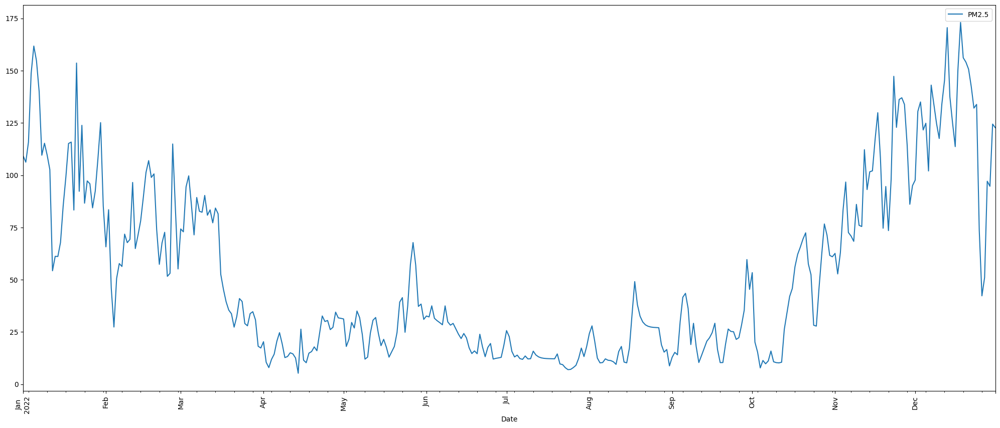

In [154]:
count = 0
for i in range(len(ballygunge_2022)):
    if (PM25(ballygunge_2022["PM2.5"][i]) == ballygunge_2022["AQI"][i]):
        count = count+1
percent = (count/len(ballygunge_2022))*100

print ("The highest value of PM2.5 in the "+str(len(ballygunge_2022))+
       " days time period was ",ballygunge_2022["PM2.5"].loc[ballygunge_2022['PM2.5'].idxmax()],
       " recorded on", str(ballygunge_2022["Date"].loc[ballygunge_2022['PM2.5'].idxmax()])[:10],
       '\nand the lowest value was ',ballygunge_2022["PM2.5"].loc[ballygunge_2022['PM2.5'].idxmin()], 
       " recorded on",str(ballygunge_2022["Date"].loc[ballygunge_2022['PM2.5'].idxmin()])[:10],
       "\nThe average PM2.5 value was ",str(round(ballygunge_2022["PM2.5"].mean(),2)),
       "\nPM2.5 value had a standard deviation of ",str(round(ballygunge_2022["PM2.5"].std(),2)),
       "\nIn 2022 the number of days PM2.5 was responsible for the AQI value was:- "+str(count)+
      " which is around "+str(round(percent,2))+"%")


a = ballygunge_2022.plot(x='Date',y='PM2.5',figsize=(25, 10))
plt.xticks(rotation='vertical')
plt.show()

### Particulate Matter 10 (PM 10)

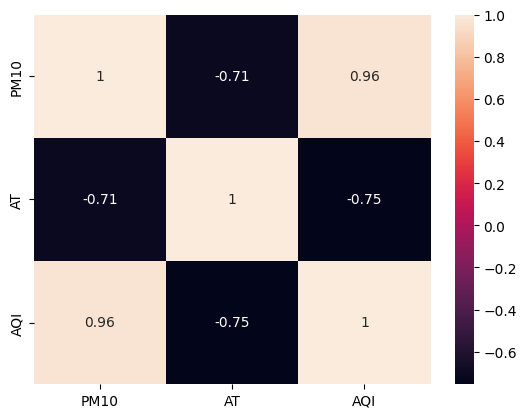

In [155]:
dataplot = sb.heatmap(ballygunge[['PM10','AT','AQI']].corr(), annot=True)
plt.show()

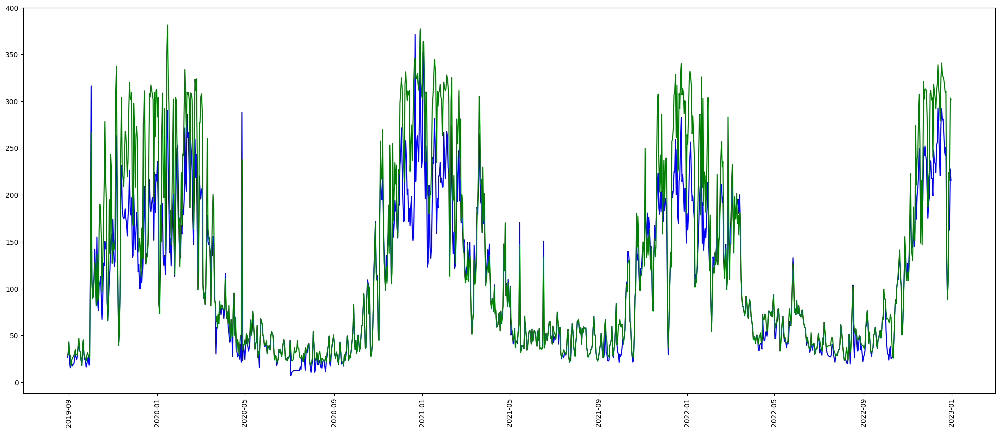

In [156]:
plt.figure(figsize=(25, 10))
plt.plot(ballygunge["Date"],ballygunge["PM10"], color = "blue")
plt.plot(ballygunge["Date"],ballygunge["AQI"],color = "green")
plt.xticks(rotation='vertical')
plt.show()

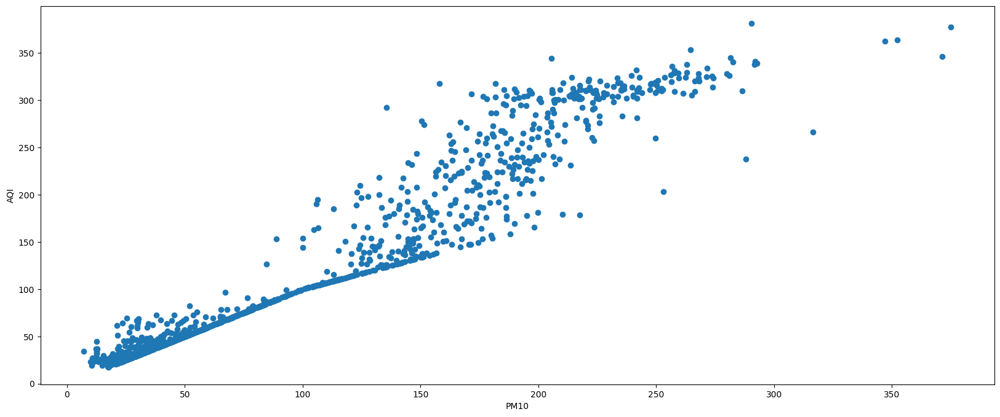

In [157]:
plt.figure(figsize=(20,8))
plt.scatter(x=ballygunge['PM10'],y=ballygunge['AQI'])
plt.xlabel("PM10")
plt.ylabel("AQI")
plt.show()

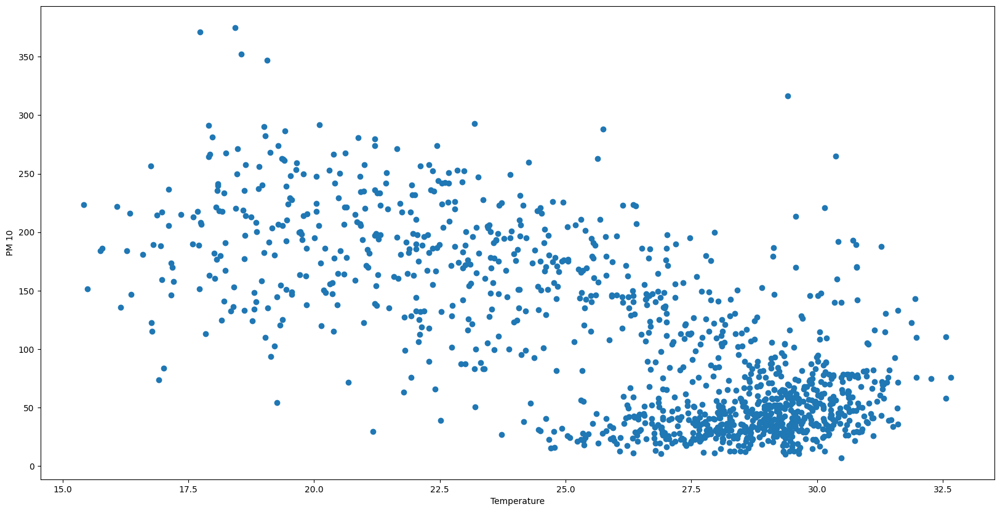

In [158]:
plt.figure(figsize=(20,10))
plt.scatter(x=ballygunge["AT"],y=ballygunge["PM10"])
plt.xlabel("Temperature")
plt.ylabel("PM 10")
plt.show()

[]

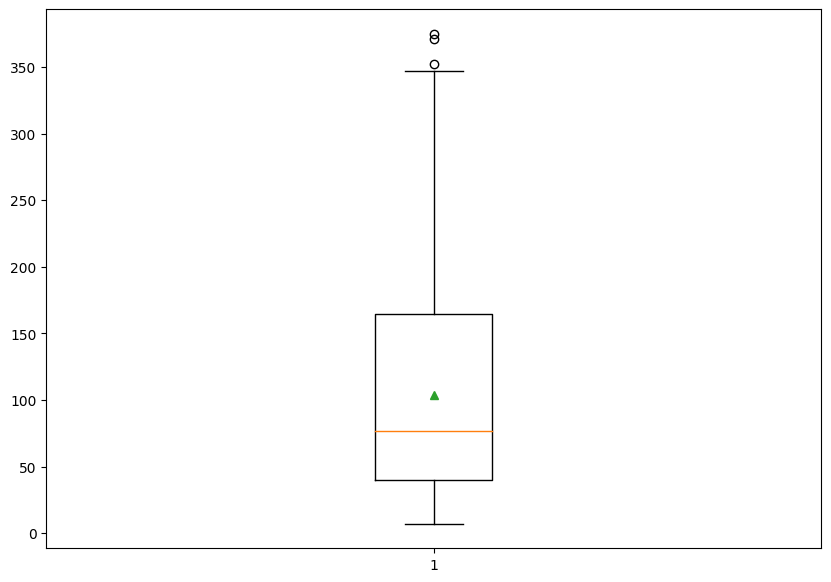

In [159]:
plt.figure(figsize =(10, 7))
plt.boxplot(ballygunge["PM10"],showmeans=True)
plt.plot()

The highest value of PM 10 in the 1220 days time period was  375.01  recorded on 2020-12-29 
and the lowest value was  7.11  recorded on 2020-07-03 
The average PM10 value was  104.14 
PM10 value had a standard deviation of  74.85 .
The number of days PM10 was responsible for the AQI value was:- 547 which is around 44.84%


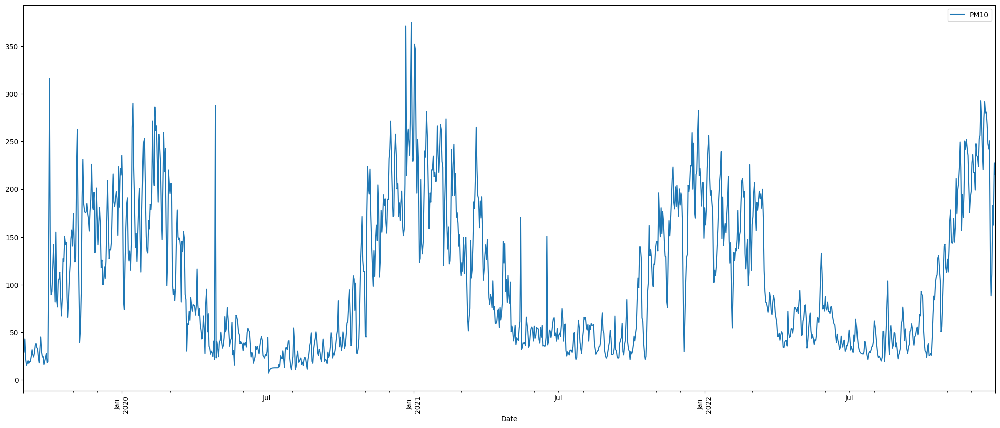

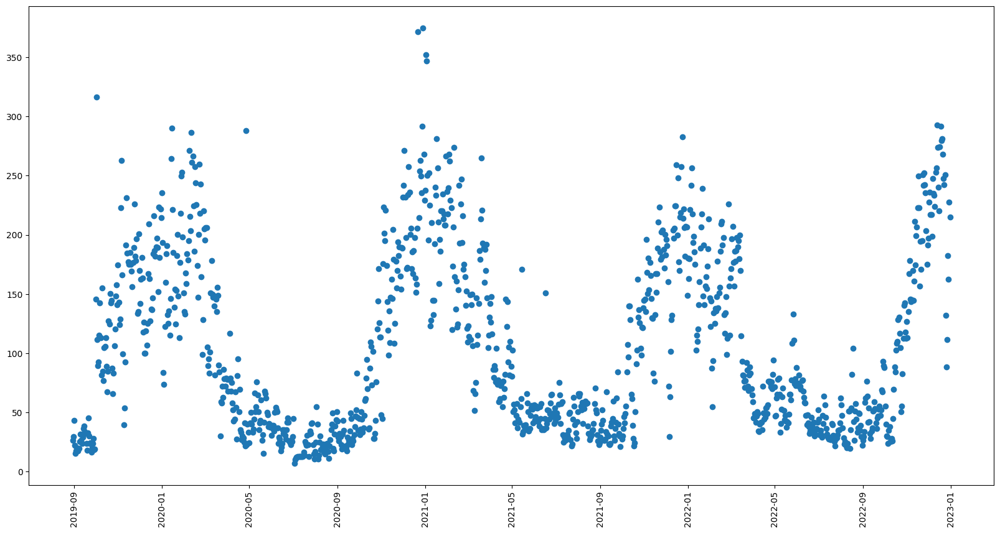

In [160]:
count = 0
for i in range(len(ballygunge)):
    if (PM10(ballygunge["PM10"][i]) == ballygunge["AQI"][i]):
        count = count+1
percent = (count/len(ballygunge))*100
print ("The highest value of PM 10 in the "+str(len(ballygunge))+
       " days time period was ",ballygunge["PM10"].loc[ballygunge['PM10'].idxmax()],
       " recorded on", str(ballygunge["Date"].loc[ballygunge['PM10'].idxmax()])[:10],
       '\nand the lowest value was ',ballygunge["PM10"].loc[ballygunge['PM10'].idxmin()], 
       " recorded on",str(ballygunge["Date"].loc[ballygunge['PM10'].idxmin()])[:10],
       "\nThe average PM10 value was ",str(round(ballygunge["PM10"].mean(),2)),
       "\nPM10 value had a standard deviation of ",str(round(ballygunge["PM10"].std(),2)),
       '.\nThe number of days PM10 was responsible for the AQI value was:- '+str(count)+
      " which is around "+str(round(percent,2))+"%")


a = ballygunge.plot(x='Date',y='PM10',figsize=(25, 10))
plt.xticks(rotation='vertical')
plt.show()

f = plt.figure()
f.set_figwidth(20)
f.set_figheight(10)
plt.plot_date(ballygunge['Date'],ballygunge['PM10'])
plt.xticks(rotation='vertical')
plt.show()

#### Sources of PM10

##### PM10 2019

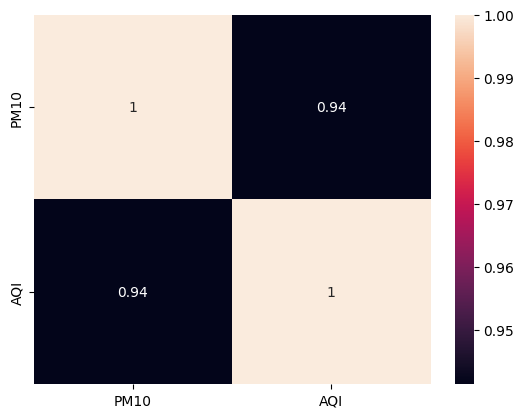

In [161]:
dataplot = sb.heatmap(ballygunge_2019[['PM10','AQI']].corr(), annot=True)
plt.show()

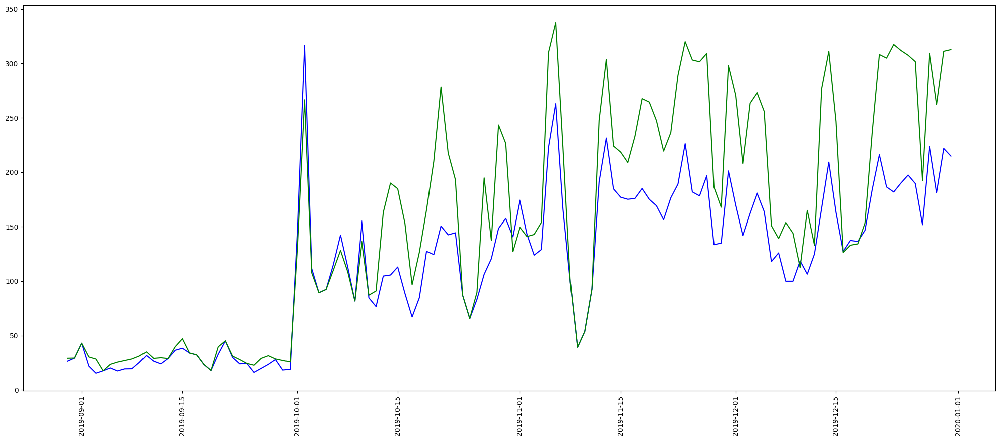

In [162]:
plt.figure(figsize=(25, 10))
plt.plot(ballygunge_2019["Date"],ballygunge_2019["PM10"], color = "blue")
plt.plot(ballygunge_2019["Date"],ballygunge_2019["AQI"],color = "green")
plt.xticks(rotation='vertical')
plt.show()

[]

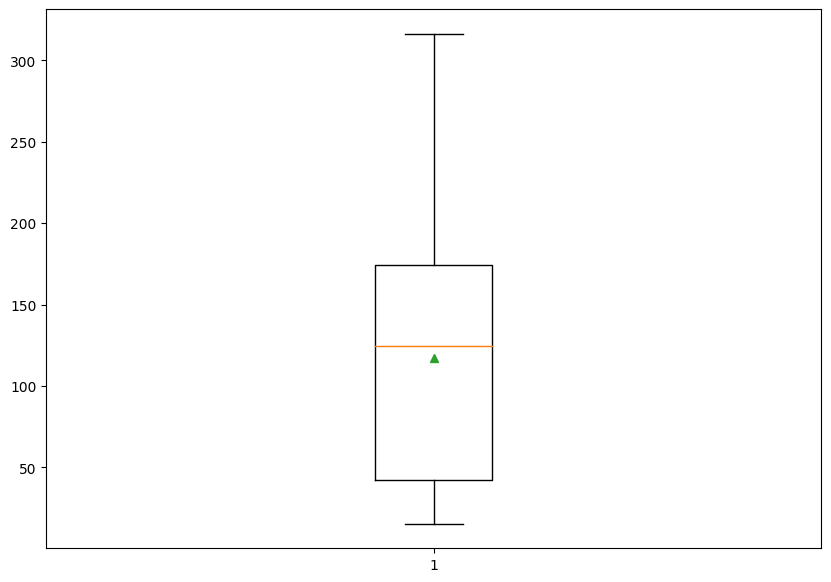

In [163]:
plt.figure(figsize =(10, 7))
plt.boxplot(ballygunge_2019["PM10"],showmeans=True)
plt.plot()

The highest value of PM10 in the 124 days time period was  316.4  recorded on 2019-10-02 
and the lowest value was  15.31  recorded on 2019-09-03 
The average PM10 value was  116.9 
PM10 value had a standard deviation of  68.32 
In 2019 the number of days PM10 was responsible for the AQI value was:- 29 which is around 23.39%


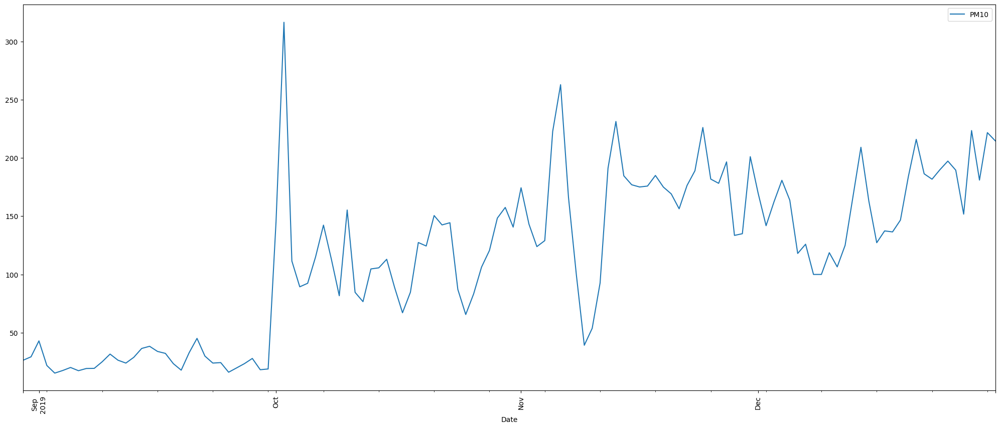

In [164]:
count = 0
for i in range(len(ballygunge_2019)):
    if (PM10(ballygunge_2019["PM10"][i]) == ballygunge_2019["AQI"][i]):
        count = count+1
percent = (count/len(ballygunge_2019))*100

print ("The highest value of PM10 in the "+str(len(ballygunge_2019))+
       " days time period was ",ballygunge_2019["PM10"].loc[ballygunge_2019['PM10'].idxmax()],
       " recorded on", str(ballygunge_2019["Date"].loc[ballygunge_2019['PM10'].idxmax()])[:10],
       '\nand the lowest value was ',ballygunge_2019["PM10"].loc[ballygunge_2019['PM10'].idxmin()], 
       " recorded on",str(ballygunge_2019["Date"].loc[ballygunge_2019['PM10'].idxmin()])[:10],
       "\nThe average PM10 value was ",str(round(ballygunge_2019["PM10"].mean(),2)),
       "\nPM10 value had a standard deviation of ",str(round(ballygunge_2019["PM10"].std(),2)),
       "\nIn 2019 the number of days PM10 was responsible for the AQI value was:- "+str(count)+
      " which is around "+str(round(percent,2))+"%")


a = ballygunge_2019.plot(x='Date',y='PM10',figsize=(25, 10))
plt.xticks(rotation='vertical')
plt.show()

##### PM10 2020

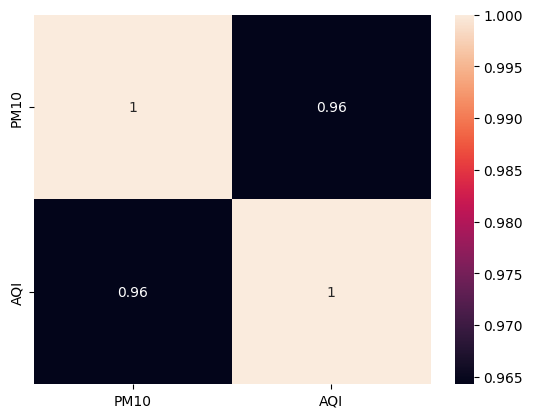

In [165]:
dataplot = sb.heatmap(ballygunge_2020[['PM10','AQI']].corr(), annot=True)
plt.show()

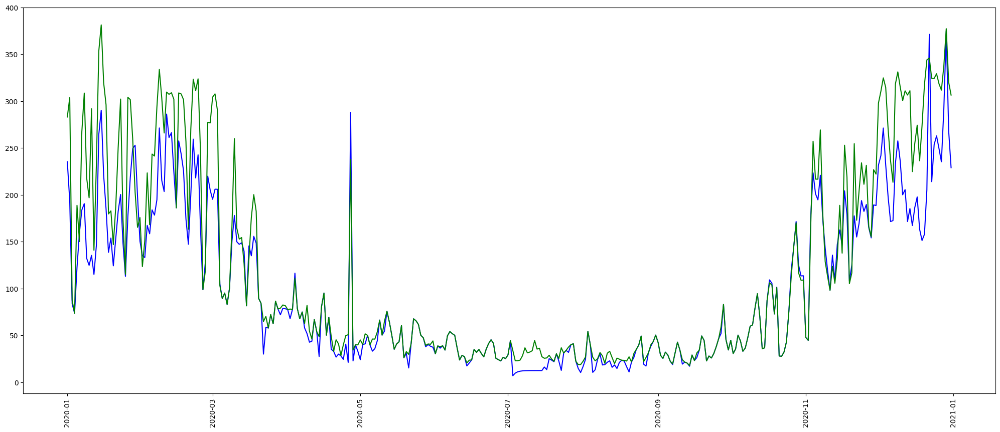

In [166]:
plt.figure(figsize=(25, 10))
plt.plot(ballygunge_2020["Date"],ballygunge_2020["PM10"], color = "blue")
plt.plot(ballygunge_2020["Date"],ballygunge_2020["AQI"],color = "green")
plt.xticks(rotation='vertical')
plt.show()

[]

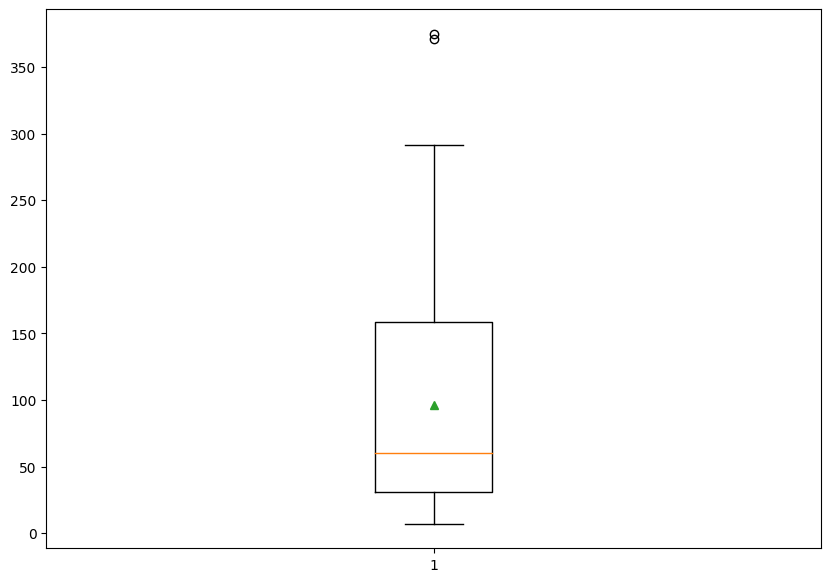

In [167]:
plt.figure(figsize =(10, 7))
plt.boxplot(ballygunge_2020["PM10"],showmeans=True)
plt.plot()

The highest value of PM10 in the 366 days time period was  375.01  recorded on 2020-12-29 
and the lowest value was  7.11  recorded on 2020-07-03 
The average PM10 value was  96.54 
PM10 value had a standard deviation of  80.08 
In 2020 the number of days PM10 was responsible for the AQI value was:- 159 which is around 43.44%


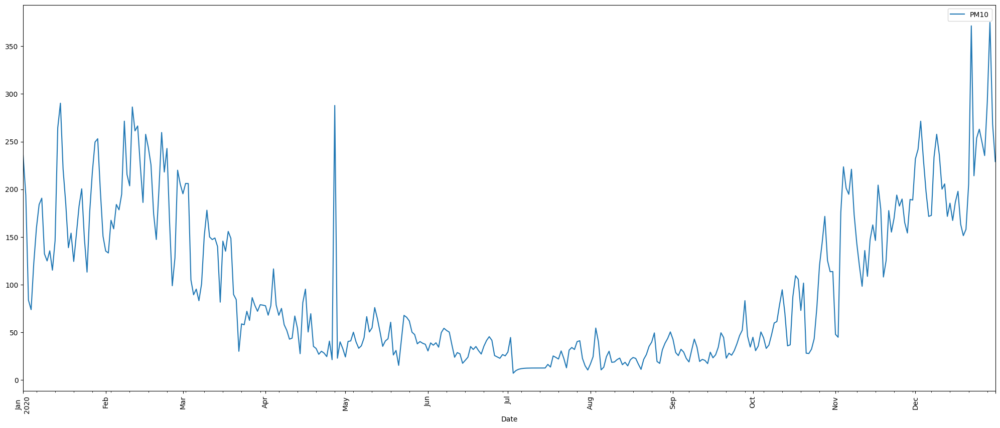

In [168]:
count = 0
for i in range(len(ballygunge_2020)):
    if (PM10(ballygunge_2020["PM10"][i]) == ballygunge_2020["AQI"][i]):
        count = count+1
percent = (count/len(ballygunge_2020))*100

print ("The highest value of PM10 in the "+str(len(ballygunge_2020))+
       " days time period was ",ballygunge_2020["PM10"].loc[ballygunge_2020['PM10'].idxmax()],
       " recorded on", str(ballygunge_2020["Date"].loc[ballygunge_2020['PM10'].idxmax()])[:10],
       '\nand the lowest value was ',ballygunge_2020["PM10"].loc[ballygunge_2020['PM10'].idxmin()], 
       " recorded on",str(ballygunge_2020["Date"].loc[ballygunge_2020['PM10'].idxmin()])[:10],
       "\nThe average PM10 value was ",str(round(ballygunge_2020["PM10"].mean(),2)),
       "\nPM10 value had a standard deviation of ",str(round(ballygunge_2020["PM10"].std(),2)),
       "\nIn 2020 the number of days PM10 was responsible for the AQI value was:- "+str(count)+
      " which is around "+str(round(percent,2))+"%")


a = ballygunge_2020.plot(x='Date',y='PM10',figsize=(25, 10))
plt.xticks(rotation='vertical')
plt.show()

##### PM10 2021

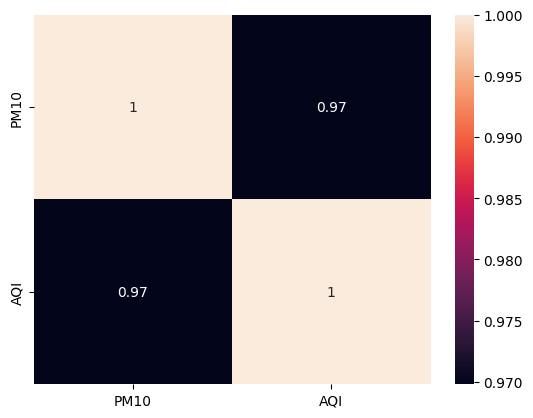

In [169]:
dataplot = sb.heatmap(ballygunge_2021[['PM10','AQI']].corr(), annot=True)
plt.show()

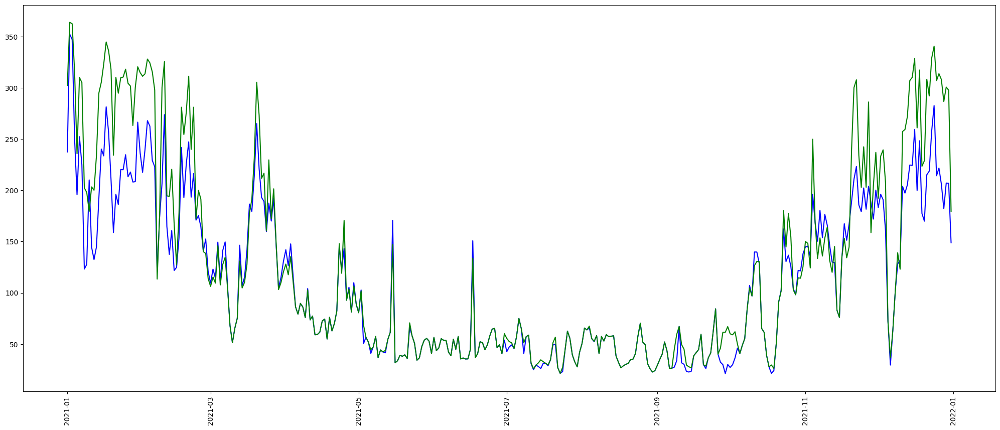

In [170]:
plt.figure(figsize=(25, 10))
plt.plot(ballygunge_2021["Date"],ballygunge_2021["PM10"], color = "blue")
plt.plot(ballygunge_2021["Date"],ballygunge_2021["AQI"],color = "green")
plt.xticks(rotation='vertical')
plt.show()

[]

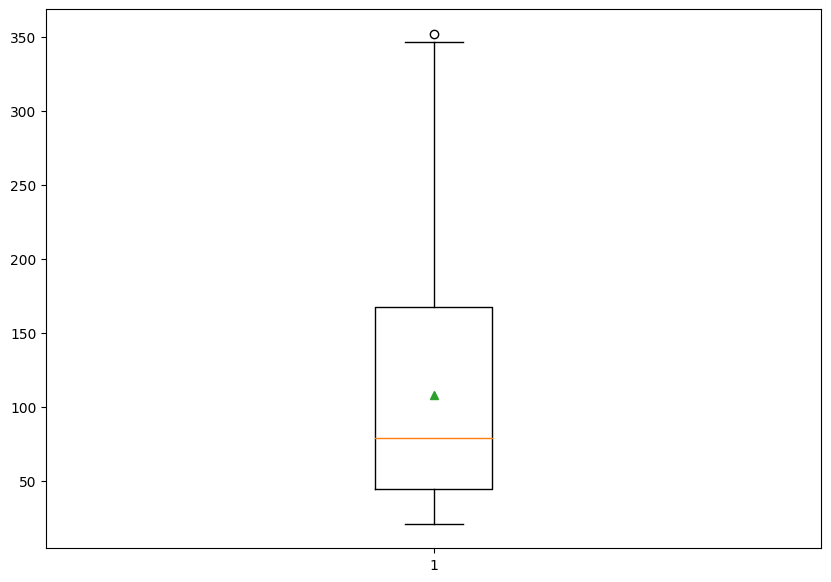

In [171]:
plt.figure(figsize =(10, 7))
plt.boxplot(ballygunge_2021["PM10"],showmeans=True)
plt.plot()

The highest value of PM10 in the 365 days time period was  352.27  recorded on 2021-01-02 
and the lowest value was  21.2  recorded on 2021-09-29 
The average PM10 value was  108.28 
PM10 value had a standard deviation of  73.77 
In 2021 the number of days PM10 was responsible for the AQI value was:- 194 which is around 53.15%


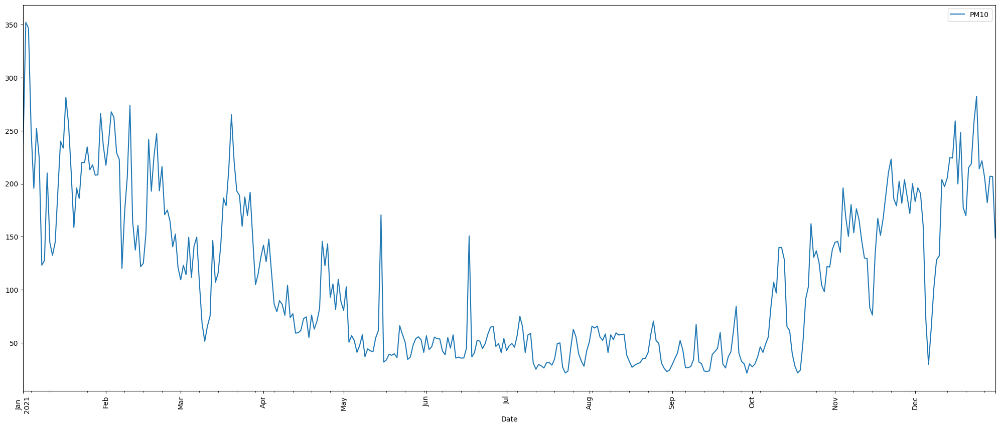

In [172]:
count = 0
for i in range(len(ballygunge_2021)):
    if (PM10(ballygunge_2021["PM10"][i]) == ballygunge_2021["AQI"][i]):
        count = count+1
percent = (count/len(ballygunge_2021))*100

print ("The highest value of PM10 in the "+str(len(ballygunge_2021))+
       " days time period was ",ballygunge_2021["PM10"].loc[ballygunge_2021['PM10'].idxmax()],
       " recorded on", str(ballygunge_2021["Date"].loc[ballygunge_2021['PM10'].idxmax()])[:10],
       '\nand the lowest value was ',ballygunge_2021["PM10"].loc[ballygunge_2021['PM10'].idxmin()], 
       " recorded on",str(ballygunge_2021["Date"].loc[ballygunge_2021['PM10'].idxmin()])[:10],
       "\nThe average PM10 value was ",str(round(ballygunge_2021["PM10"].mean(),2)),
       "\nPM10 value had a standard deviation of ",str(round(ballygunge_2021["PM10"].std(),2)),
       "\nIn 2021 the number of days PM10 was responsible for the AQI value was:- "+str(count)+
      " which is around "+str(round(percent,2))+"%")


a = ballygunge_2021.plot(x='Date',y='PM10',figsize=(25, 10))
plt.xticks(rotation='vertical')
plt.show()

##### PM10 2022

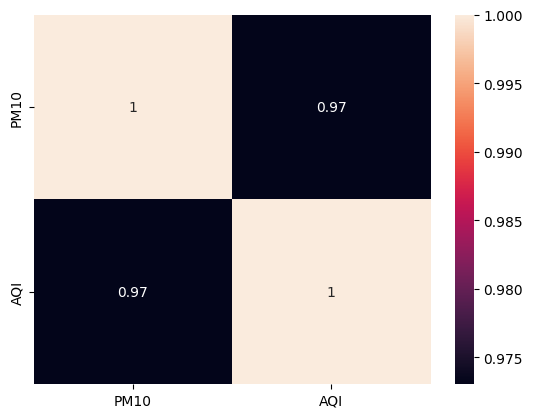

In [173]:
dataplot = sb.heatmap(ballygunge_2022[['PM10','AQI']].corr(), annot=True)
plt.show()

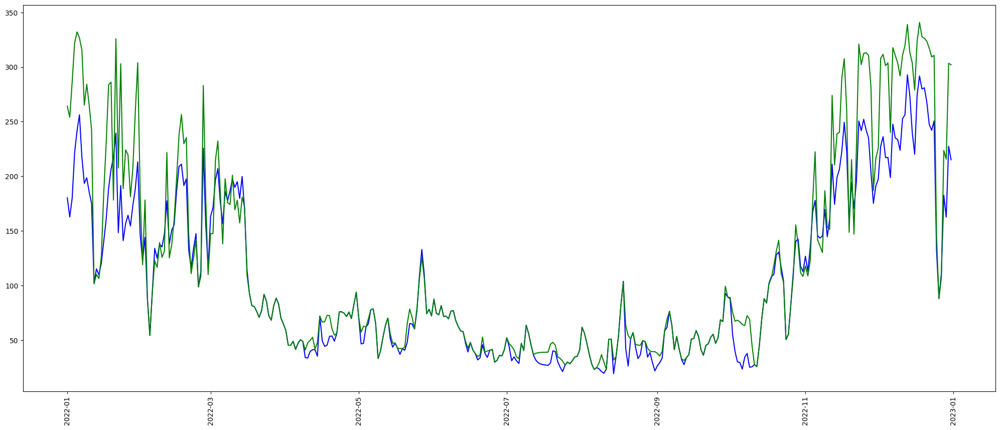

In [174]:
plt.figure(figsize=(25, 10))
plt.plot(ballygunge_2022["Date"],ballygunge_2022["PM10"], color = "blue")
plt.plot(ballygunge_2022["Date"],ballygunge_2022["AQI"],color = "green")
plt.xticks(rotation='vertical')
plt.show()

[]

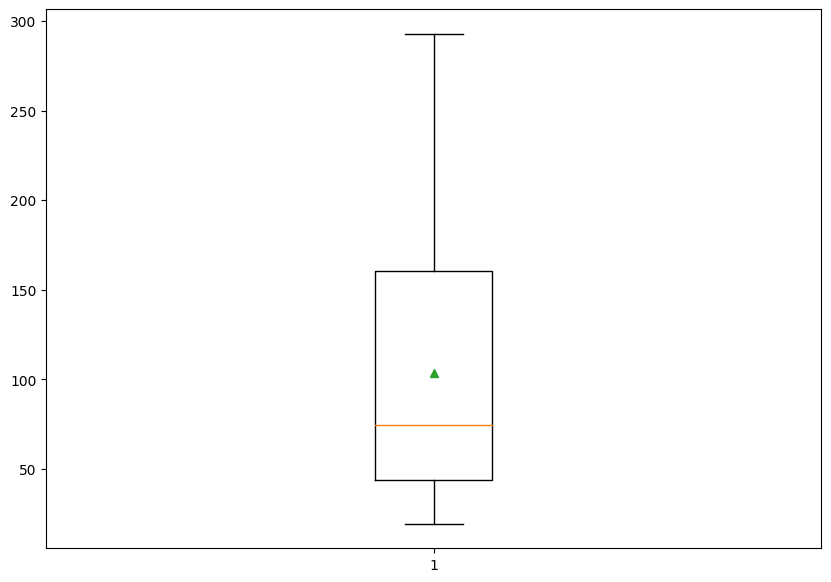

In [175]:
plt.figure(figsize =(10, 7))
plt.boxplot(ballygunge_2022["PM10"],showmeans=True)
plt.plot()

The highest value of PM10 in the 365 days time period was  292.8  recorded on 2022-12-13 
and the lowest value was  19.46  recorded on 2022-08-14 
The average PM10 value was  103.3 
PM10 value had a standard deviation of  71.97 
In 2022 the number of days PM10 was responsible for the AQI value was:- 165 which is around 45.21%


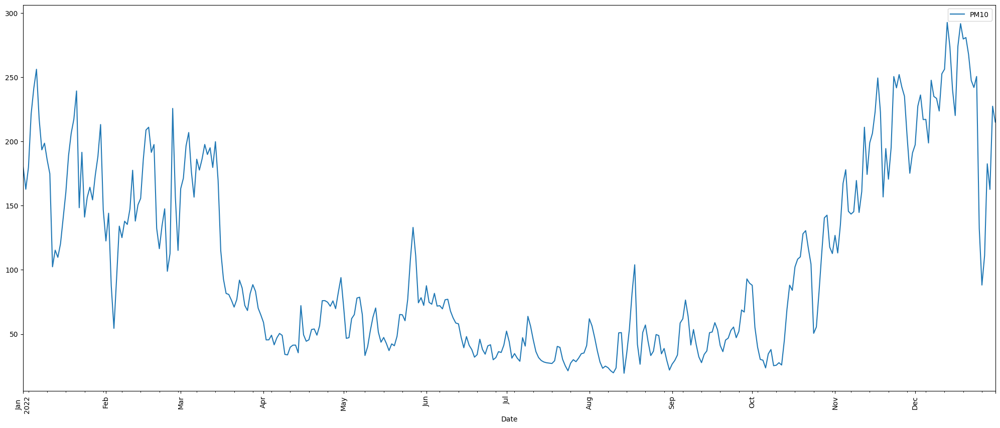

In [176]:
count = 0
for i in range(len(ballygunge_2022)):
    if (PM10(ballygunge_2022["PM10"][i]) == ballygunge_2022["AQI"][i]):
        count = count+1
percent = (count/len(ballygunge_2022))*100

print ("The highest value of PM10 in the "+str(len(ballygunge_2022))+
       " days time period was ",ballygunge_2022["PM10"].loc[ballygunge_2022['PM10'].idxmax()],
       " recorded on", str(ballygunge_2022["Date"].loc[ballygunge_2022['PM10'].idxmax()])[:10],
       '\nand the lowest value was ',ballygunge_2022["PM10"].loc[ballygunge_2022['PM10'].idxmin()], 
       " recorded on",str(ballygunge_2022["Date"].loc[ballygunge_2022['PM10'].idxmin()])[:10],
       "\nThe average PM10 value was ",str(round(ballygunge_2022["PM10"].mean(),2)),
       "\nPM10 value had a standard deviation of ",str(round(ballygunge_2022["PM10"].std(),2)),
       "\nIn 2022 the number of days PM10 was responsible for the AQI value was:- "+str(count)+
      " which is around "+str(round(percent,2))+"%")


a = ballygunge_2022.plot(x='Date',y='PM10',figsize=(25, 10))
plt.xticks(rotation='vertical')
plt.show()

### Nitrogen Dioxide (NO2)

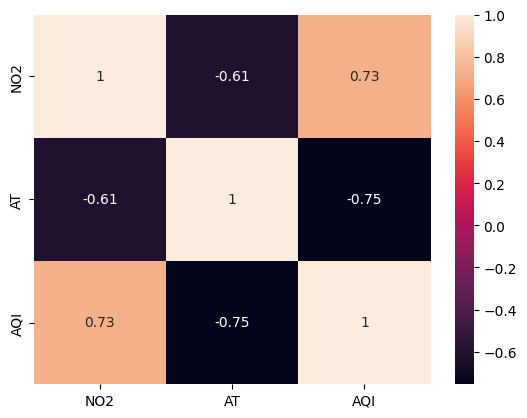

In [177]:
dataplot = sb.heatmap(ballygunge[['NO2','AT','AQI']].corr(), annot=True)
plt.show()

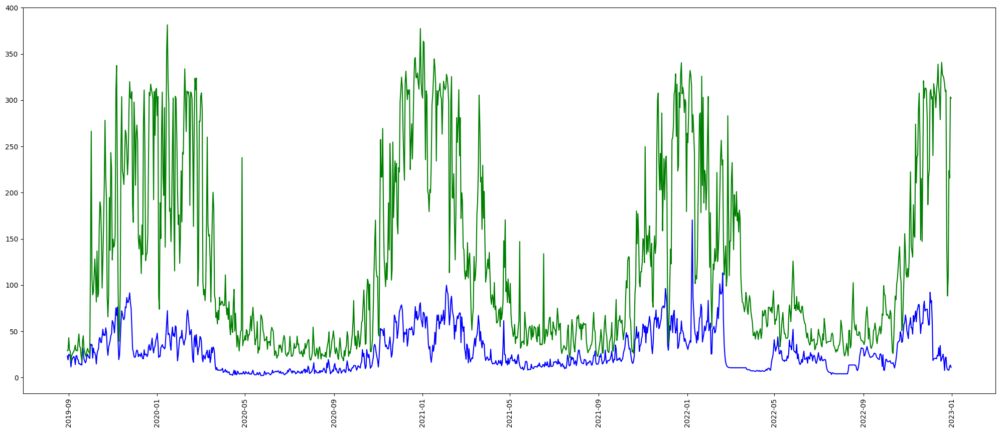

In [178]:
plt.figure(figsize=(25, 10))
plt.plot(ballygunge["Date"],ballygunge["NO2"], color = "blue")
plt.plot(ballygunge["Date"],ballygunge["AQI"],color = "green")
plt.xticks(rotation='vertical')
plt.show()

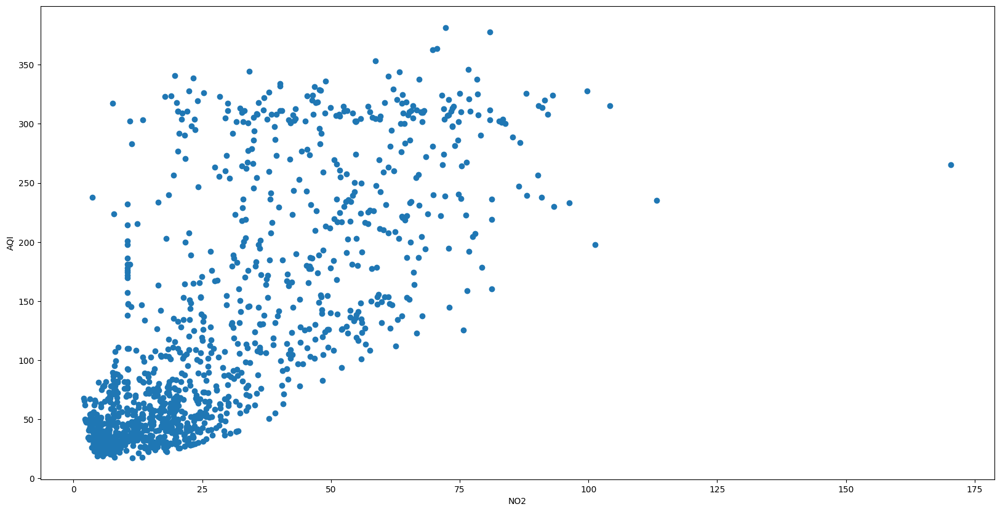

In [179]:
plt.figure(figsize=(20,10))
plt.scatter(x=ballygunge['NO2'],y=ballygunge['AQI'])
plt.xlabel("NO2")
plt.ylabel("AQI")
plt.show()

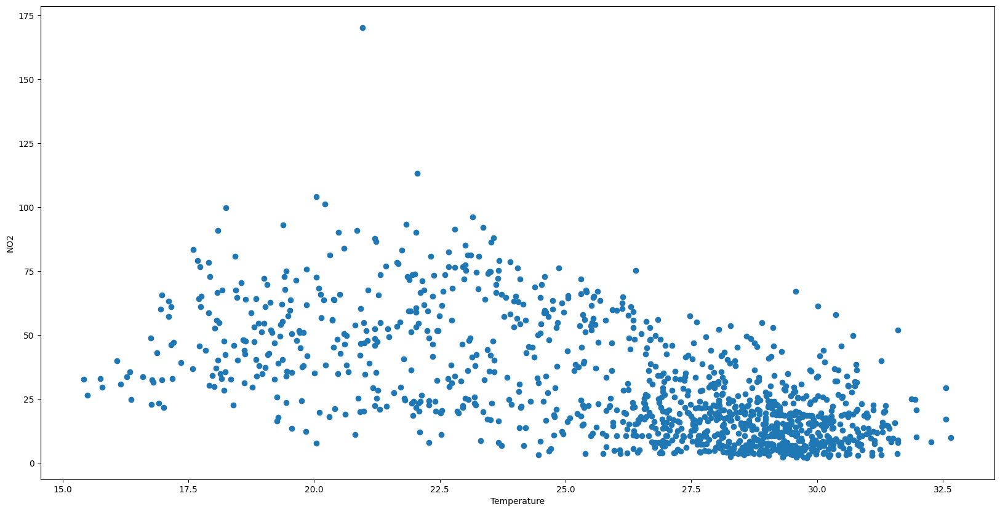

In [180]:
plt.figure(figsize=(20,10))
plt.scatter(x=ballygunge["AT"],y=ballygunge["NO2"])
plt.xlabel("Temperature")
plt.ylabel("NO2")
plt.show()

[]

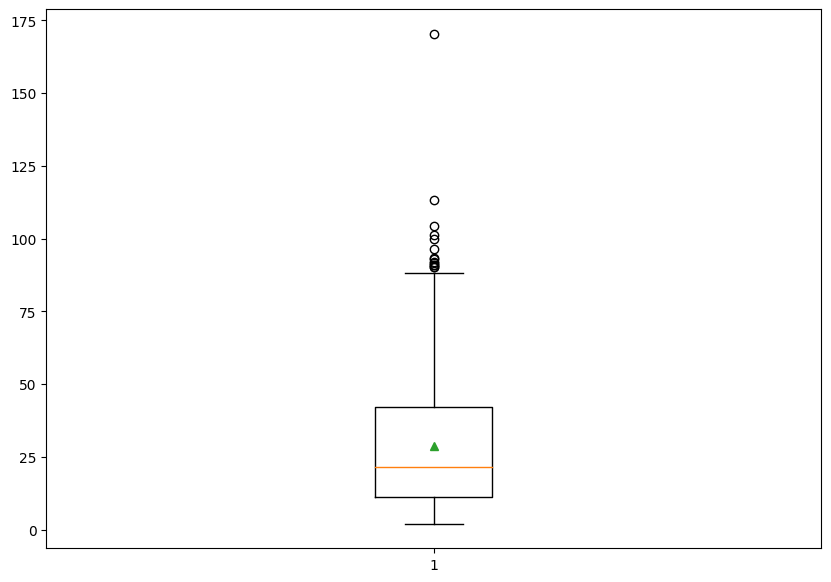

In [181]:
plt.figure(figsize =(10, 7))
plt.boxplot(ballygunge["NO2"],showmeans=True)
plt.plot()

The highest value of NO2 in the 1220 days time period was  170.37  recorded on 2022-01-08 
and the lowest value was  2.01  recorded on 2020-05-23 
The average NO2 value was  28.65 
NO2 value had a standard deviation of  22.1 .
The number of days NO2 was responsible for the AQI value was:- 19 which is around 1.56%


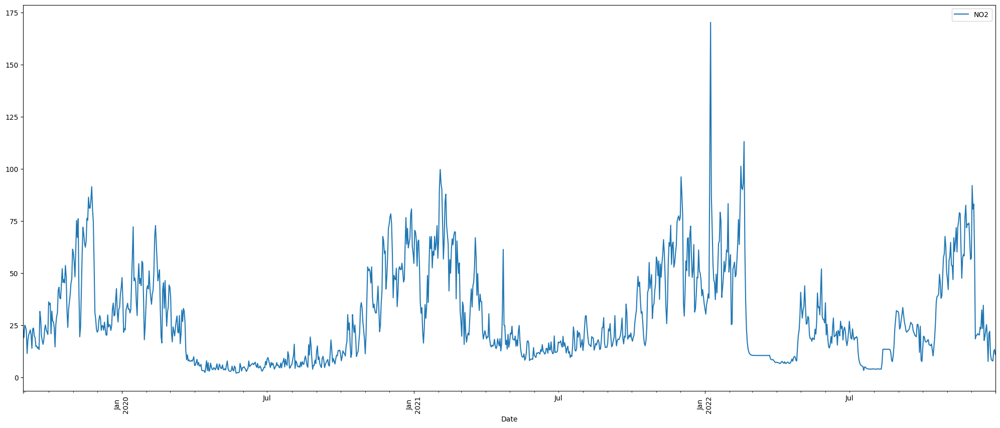

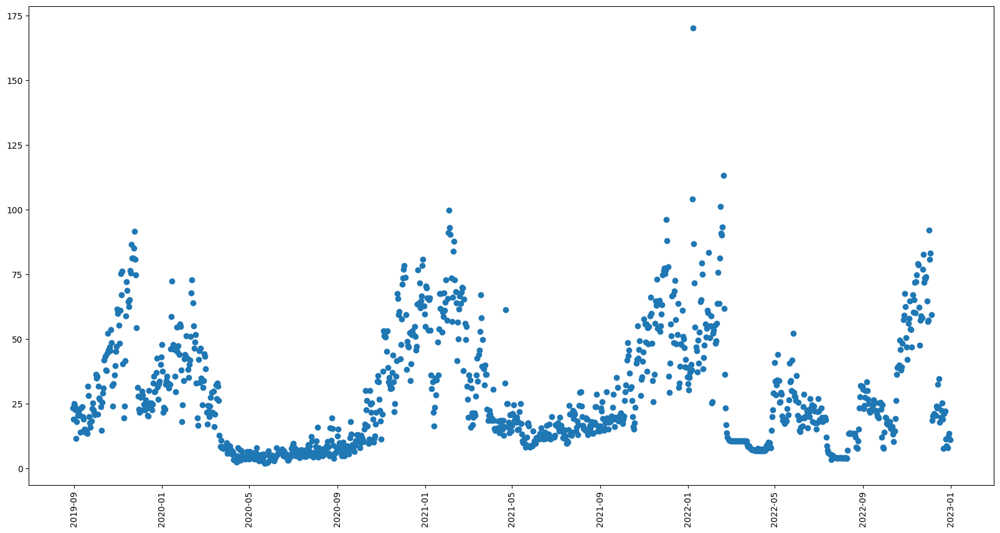

In [182]:
count = 0
for i in range(len(ballygunge)):
    if (NO2(ballygunge["NO2"][i]) == ballygunge["AQI"][i]):
        count = count+1
percent = (count/len(ballygunge))*100
print ("The highest value of NO2 in the "+str(len(ballygunge))+
       " days time period was ",ballygunge["NO2"].loc[ballygunge['NO2'].idxmax()],
       " recorded on", str(ballygunge["Date"].loc[ballygunge['NO2'].idxmax()])[:10],
       '\nand the lowest value was ',ballygunge["NO2"].loc[ballygunge['NO2'].idxmin()], 
       " recorded on",str(ballygunge["Date"].loc[ballygunge['NO2'].idxmin()])[:10],
       "\nThe average NO2 value was ",str(round(ballygunge["NO2"].mean(),2)),
       "\nNO2 value had a standard deviation of ",str(round(ballygunge["NO2"].std(),2)),
       '.\nThe number of days NO2 was responsible for the AQI value was:- '+str(count)+
      " which is around "+str(round(percent,2))+"%")


a = ballygunge.plot(x='Date',y='NO2',figsize=(25, 10))
plt.xticks(rotation='vertical')
plt.show()

f = plt.figure()
f.set_figwidth(20)
f.set_figheight(10)
plt.plot_date(ballygunge['Date'],ballygunge['NO2'])
plt.xticks(rotation='vertical')
plt.show()

#### Sources of NO2

##### NO2 2019

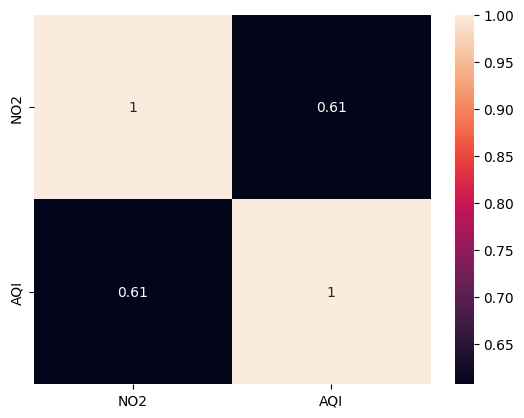

In [183]:
dataplot = sb.heatmap(ballygunge_2019[['NO2','AQI']].corr(), annot=True)
plt.show()

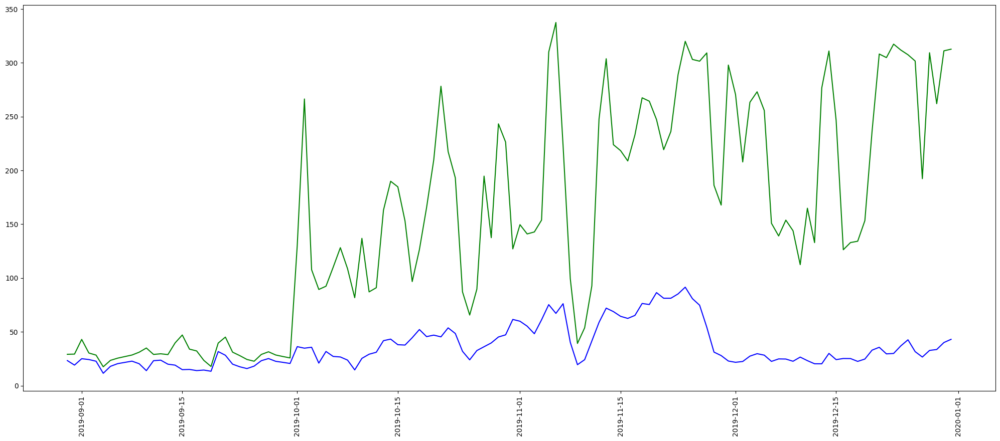

In [184]:
plt.figure(figsize=(25, 10))
plt.plot(ballygunge_2019["Date"],ballygunge_2019["NO2"], color = "blue")
plt.plot(ballygunge_2019["Date"],ballygunge_2019["AQI"],color = "green")
plt.xticks(rotation='vertical')
plt.show()

[]

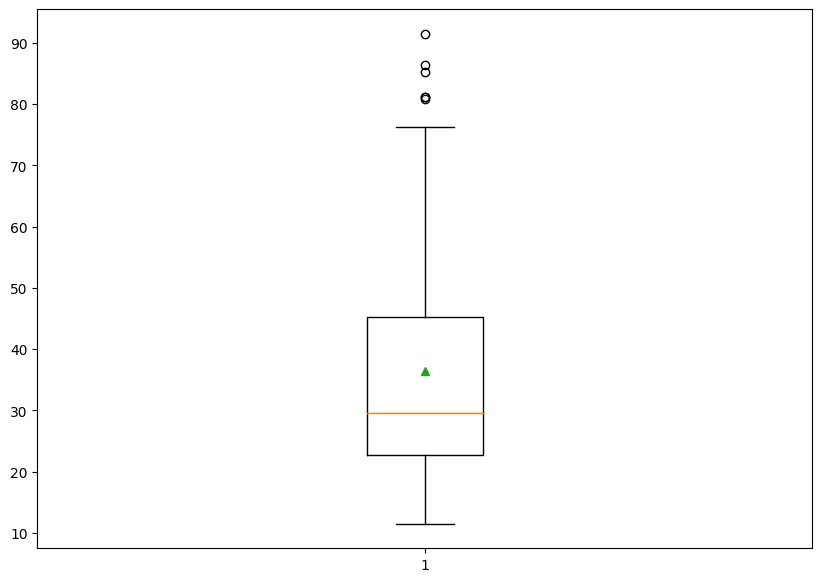

In [185]:
plt.figure(figsize =(10, 7))
plt.boxplot(ballygunge_2019["NO2"],showmeans=True)
plt.plot()

The highest value of NO2 in the 124 days time period was  91.51  recorded on 2019-11-24 
and the lowest value was  11.47  recorded on 2019-09-04 
The average NO2 value was  36.36 
NO2 value had a standard deviation of  19.35 
In 2019 the number of days NO2 was responsible for the AQI value was:- 14 which is around 11.29%


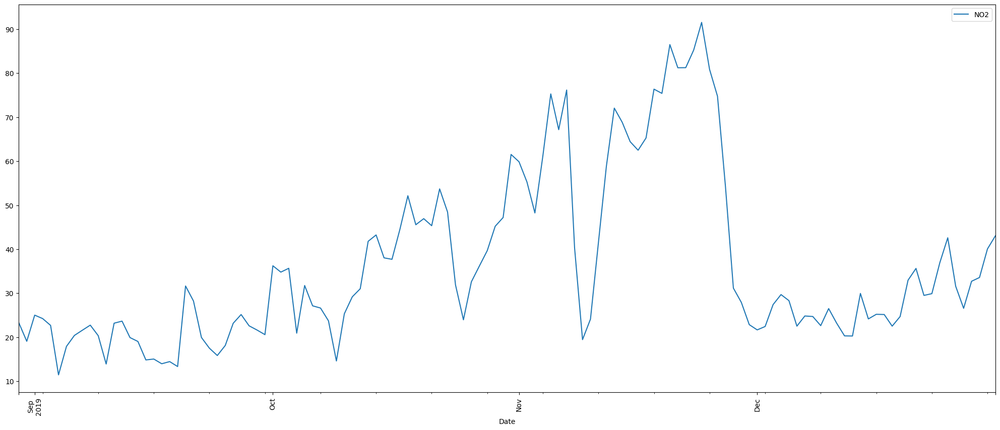

In [186]:
count = 0
for i in range(len(ballygunge_2019)):
    if (NO2(ballygunge_2019["NO2"][i]) == ballygunge_2019["AQI"][i]):
        count = count+1
percent = (count/len(ballygunge_2019))*100

print ("The highest value of NO2 in the "+str(len(ballygunge_2019))+
       " days time period was ",ballygunge_2019["NO2"].loc[ballygunge_2019['NO2'].idxmax()],
       " recorded on", str(ballygunge_2019["Date"].loc[ballygunge_2019['NO2'].idxmax()])[:10],
       '\nand the lowest value was ',ballygunge_2019["NO2"].loc[ballygunge_2019['NO2'].idxmin()], 
       " recorded on",str(ballygunge_2019["Date"].loc[ballygunge_2019['NO2'].idxmin()])[:10],
       "\nThe average NO2 value was ",str(round(ballygunge_2019["NO2"].mean(),2)),
       "\nNO2 value had a standard deviation of ",str(round(ballygunge_2019["NO2"].std(),2)),
       "\nIn 2019 the number of days NO2 was responsible for the AQI value was:- "+str(count)+
      " which is around "+str(round(percent,2))+"%")


a = ballygunge_2019.plot(x='Date',y='NO2',figsize=(25, 10))
plt.xticks(rotation='vertical')
plt.show()

##### NO2 2020

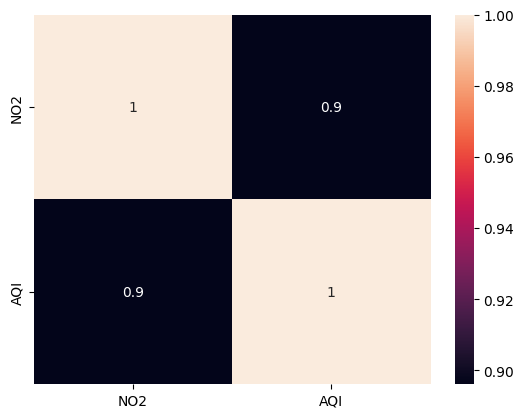

In [187]:
dataplot = sb.heatmap(ballygunge_2020[['NO2','AQI']].corr(), annot=True)
plt.show()

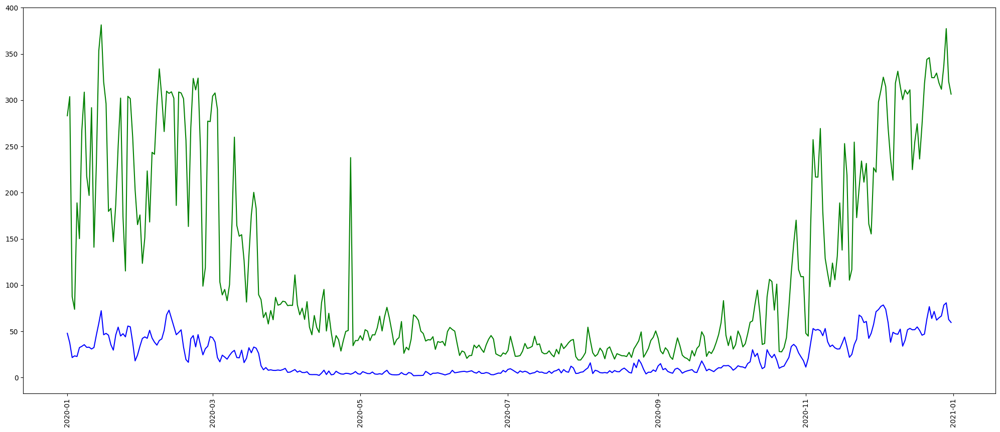

In [188]:
plt.figure(figsize=(25, 10))
plt.plot(ballygunge_2020["Date"],ballygunge_2020["NO2"], color = "blue")
plt.plot(ballygunge_2020["Date"],ballygunge_2020["AQI"],color = "green")
plt.xticks(rotation='vertical')
plt.show()

[]

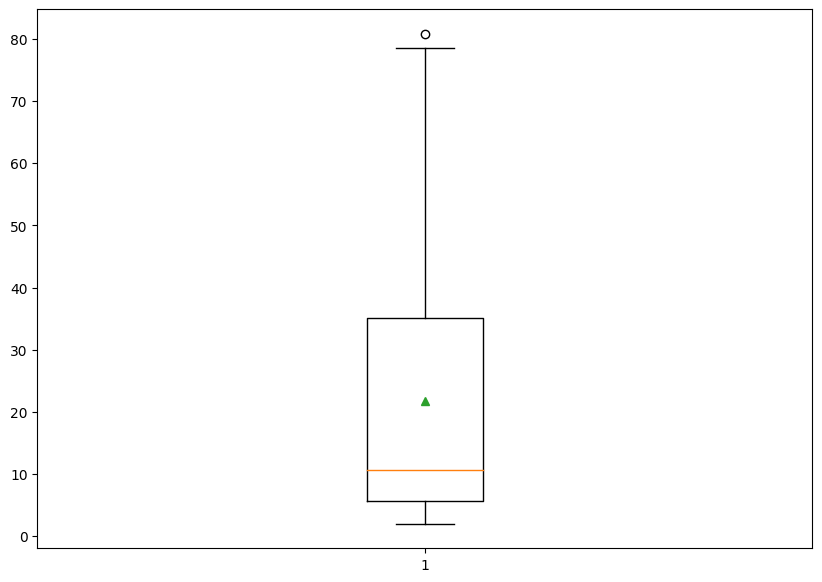

In [189]:
plt.figure(figsize =(10, 7))
plt.boxplot(ballygunge_2020["NO2"],showmeans=True)
plt.plot()

The highest value of NO2 in the 366 days time period was  80.82  recorded on 2020-12-29 
and the lowest value was  2.01  recorded on 2020-05-23 
The average NO2 value was  21.76 
NO2 value had a standard deviation of  20.25 
In 2020 the number of days NO2 was responsible for the AQI value was:- 0 which is around 0.0%


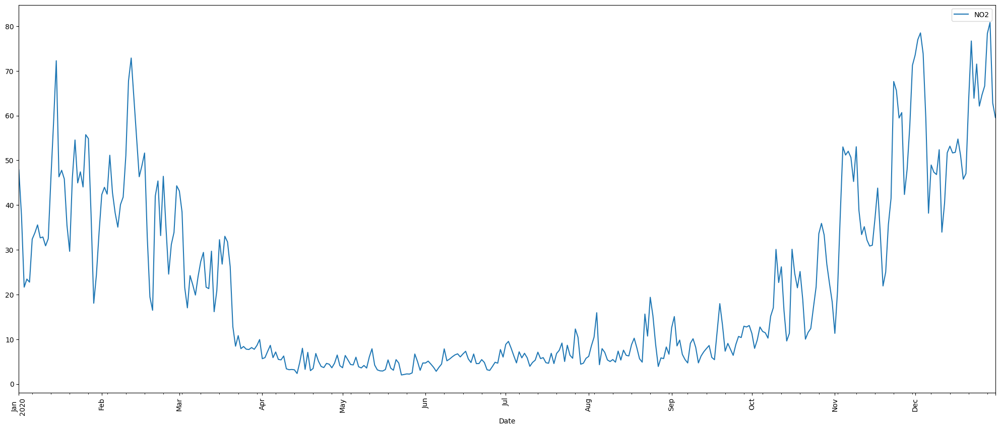

In [190]:
count = 0
for i in range(len(ballygunge_2020)):
    if (NO2(ballygunge_2020["NO2"][i]) == ballygunge_2020["AQI"][i]):
        count = count+1
percent = (count/len(ballygunge_2020))*100

print ("The highest value of NO2 in the "+str(len(ballygunge_2020))+
       " days time period was ",ballygunge_2020["NO2"].loc[ballygunge_2020['NO2'].idxmax()],
       " recorded on", str(ballygunge_2020["Date"].loc[ballygunge_2020['NO2'].idxmax()])[:10],
       '\nand the lowest value was ',ballygunge_2020["NO2"].loc[ballygunge_2020['NO2'].idxmin()], 
       " recorded on",str(ballygunge_2020["Date"].loc[ballygunge_2020['NO2'].idxmin()])[:10],
       "\nThe average NO2 value was ",str(round(ballygunge_2020["NO2"].mean(),2)),
       "\nNO2 value had a standard deviation of ",str(round(ballygunge_2020["NO2"].std(),2)),
       "\nIn 2020 the number of days NO2 was responsible for the AQI value was:- "+str(count)+
      " which is around "+str(round(percent,2))+"%")


a = ballygunge_2020.plot(x='Date',y='NO2',figsize=(25, 10))
plt.xticks(rotation='vertical')
plt.show()

##### NO2 2021

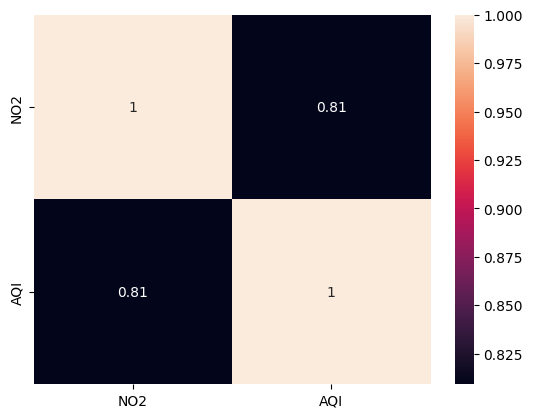

In [191]:
dataplot = sb.heatmap(ballygunge_2021[['NO2','AQI']].corr(), annot=True)
plt.show()

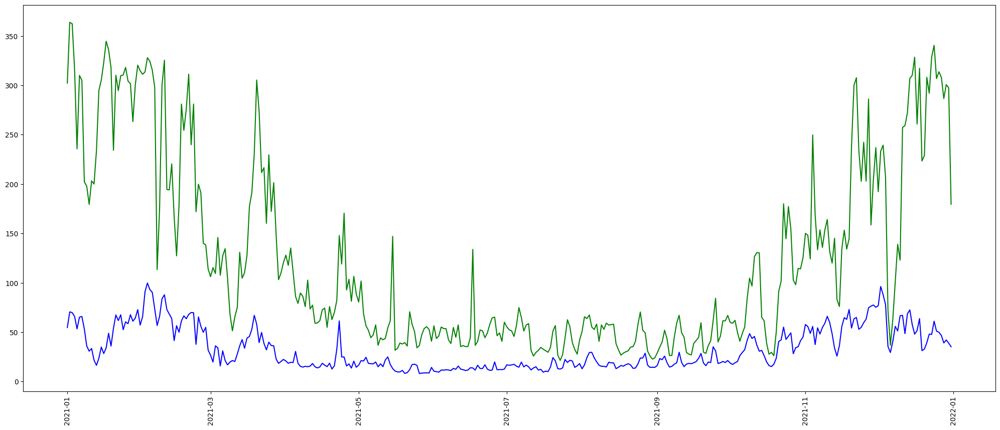

In [192]:
plt.figure(figsize=(25, 10))
plt.plot(ballygunge_2021["Date"],ballygunge_2021["NO2"], color = "blue")
plt.plot(ballygunge_2021["Date"],ballygunge_2021["AQI"],color = "green")
plt.xticks(rotation='vertical')
plt.show()

[]

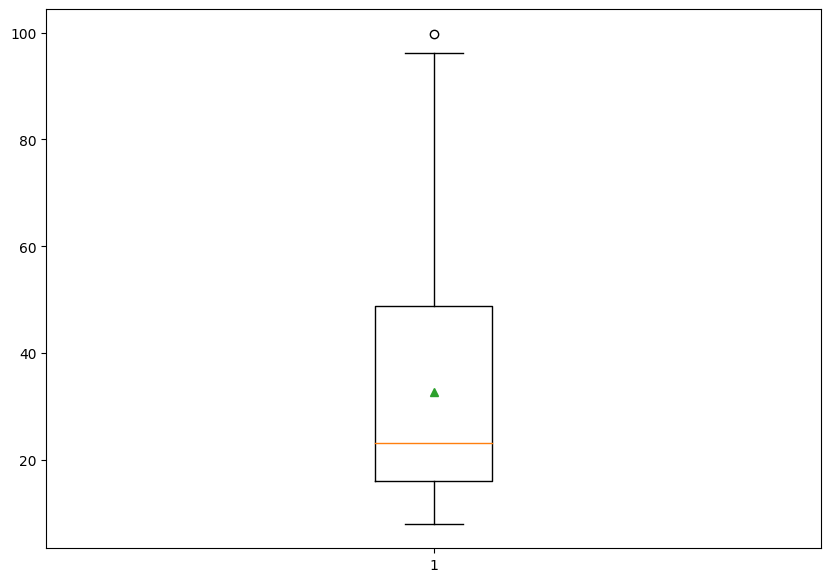

In [193]:
plt.figure(figsize =(10, 7))
plt.boxplot(ballygunge_2021["NO2"],showmeans=True)
plt.plot()

The highest value of NO2 in the 365 days time period was  99.78  recorded on 2021-02-03 
and the lowest value was  8.08  recorded on 2021-05-26 
The average NO2 value was  32.82 
NO2 value had a standard deviation of  21.19 
In 2021 the number of days NO2 was responsible for the AQI value was:- 1 which is around 0.27%


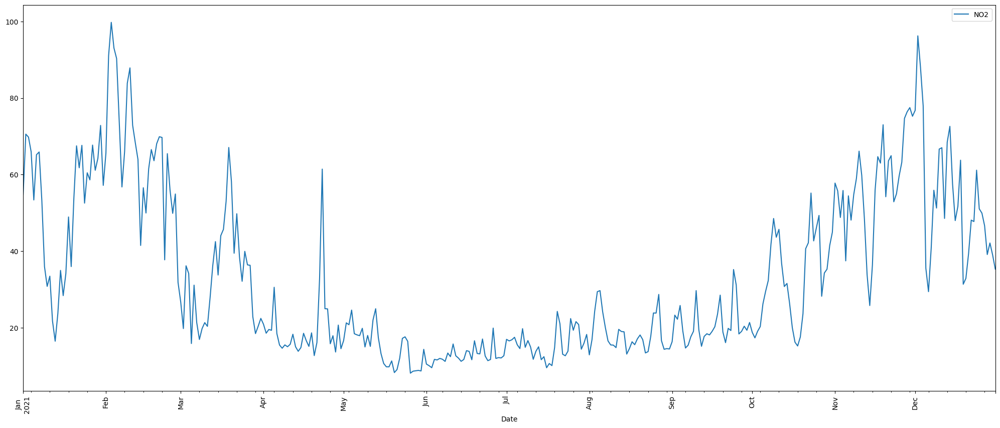

In [194]:
count = 0
for i in range(len(ballygunge_2021)):
    if (NO2(ballygunge_2021["NO2"][i]) == ballygunge_2021["AQI"][i]):
        count = count+1
percent = (count/len(ballygunge_2021))*100

print ("The highest value of NO2 in the "+str(len(ballygunge_2021))+
       " days time period was ",ballygunge_2021["NO2"].loc[ballygunge_2021['NO2'].idxmax()],
       " recorded on", str(ballygunge_2021["Date"].loc[ballygunge_2021['NO2'].idxmax()])[:10],
       '\nand the lowest value was ',ballygunge_2021["NO2"].loc[ballygunge_2021['NO2'].idxmin()], 
       " recorded on",str(ballygunge_2021["Date"].loc[ballygunge_2021['NO2'].idxmin()])[:10],
       "\nThe average NO2 value was ",str(round(ballygunge_2021["NO2"].mean(),2)),
       "\nNO2 value had a standard deviation of ",str(round(ballygunge_2021["NO2"].std(),2)),
       "\nIn 2021 the number of days NO2 was responsible for the AQI value was:- "+str(count)+
      " which is around "+str(round(percent,2))+"%")


a = ballygunge_2021.plot(x='Date',y='NO2',figsize=(25, 10))
plt.xticks(rotation='vertical')
plt.show()

##### NO2 2022

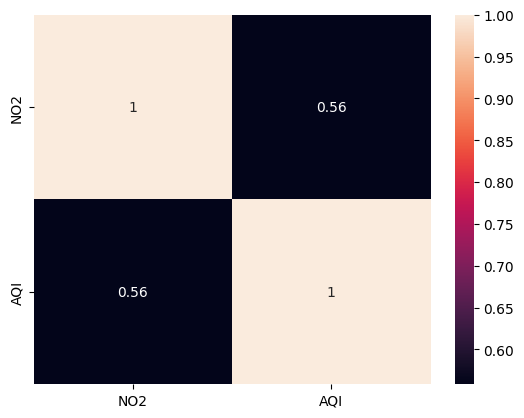

In [195]:
dataplot = sb.heatmap(ballygunge_2022[['NO2','AQI']].corr(), annot=True)
plt.show()

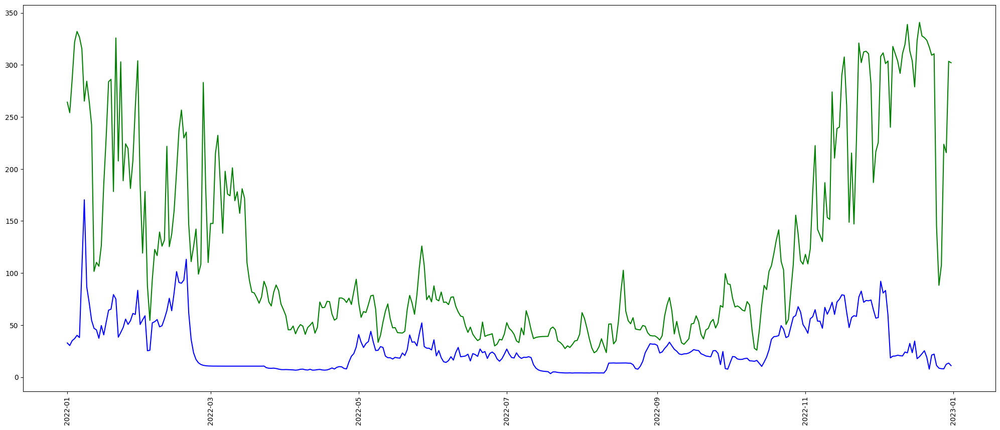

In [196]:
plt.figure(figsize=(25, 10))
plt.plot(ballygunge_2022["Date"],ballygunge_2022["NO2"], color = "blue")
plt.plot(ballygunge_2022["Date"],ballygunge_2022["AQI"],color = "green")
plt.xticks(rotation='vertical')
plt.show()

[]

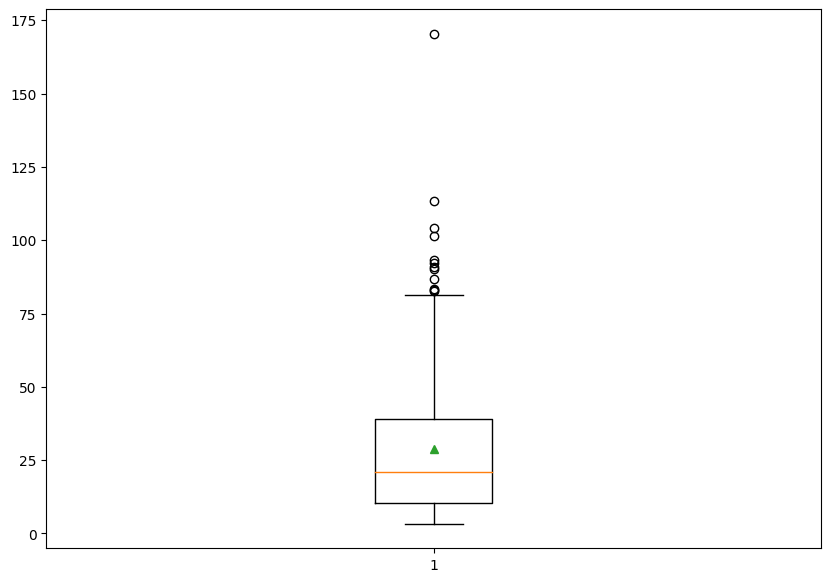

In [197]:
plt.figure(figsize =(10, 7))
plt.boxplot(ballygunge_2022["NO2"],showmeans=True)
plt.plot()

The highest value of NO2 in the 365 days time period was  170.37  recorded on 2022-01-08 
and the lowest value was  3.31  recorded on 2022-07-19 
The average NO2 value was  28.75 
NO2 value had a standard deviation of  23.75 
In 2022 the number of days NO2 was responsible for the AQI value was:- 4 which is around 1.1%


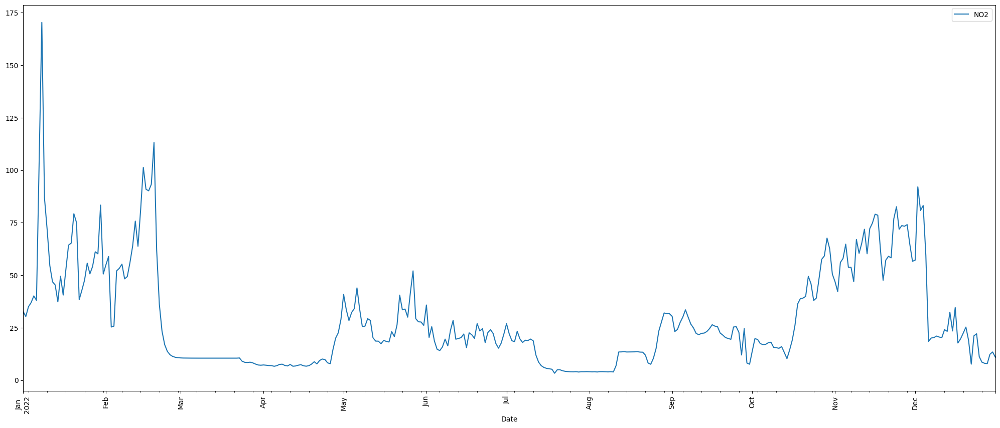

In [198]:
count = 0
for i in range(len(ballygunge_2022)):
    if (NO2(ballygunge_2022["NO2"][i]) == ballygunge_2022["AQI"][i]):
        count = count+1
percent = (count/len(ballygunge_2022))*100

print ("The highest value of NO2 in the "+str(len(ballygunge_2022))+
       " days time period was ",ballygunge_2022["NO2"].loc[ballygunge_2022['NO2'].idxmax()],
       " recorded on", str(ballygunge_2022["Date"].loc[ballygunge_2022['NO2'].idxmax()])[:10],
       '\nand the lowest value was ',ballygunge_2022["NO2"].loc[ballygunge_2022['NO2'].idxmin()], 
       " recorded on",str(ballygunge_2022["Date"].loc[ballygunge_2022['NO2'].idxmin()])[:10],
       "\nThe average NO2 value was ",str(round(ballygunge_2022["NO2"].mean(),2)),
       "\nNO2 value had a standard deviation of ",str(round(ballygunge_2022["NO2"].std(),2)),
       "\nIn 2022 the number of days NO2 was responsible for the AQI value was:- "+str(count)+
      " which is around "+str(round(percent,2))+"%")


a = ballygunge_2022.plot(x='Date',y='NO2',figsize=(25, 10))
plt.xticks(rotation='vertical')
plt.show()

### Ammonia (NH3)

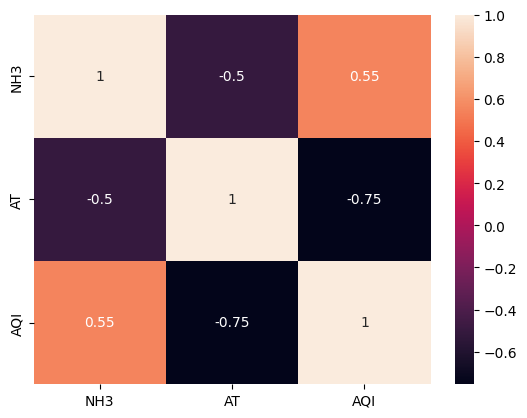

In [199]:
dataplot = sb.heatmap(ballygunge[['NH3','AT','AQI']].corr(), annot=True)
plt.show()

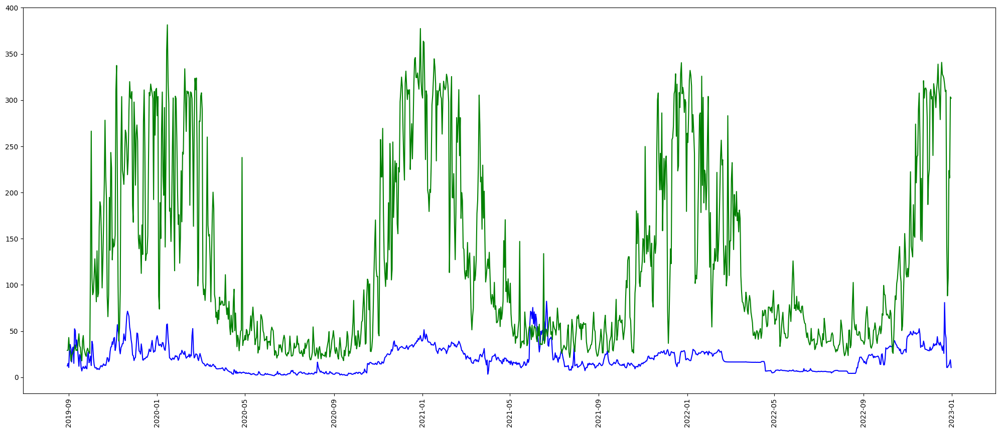

In [200]:
plt.figure(figsize=(25, 10))
plt.plot(ballygunge["Date"],ballygunge["NH3"], color = "blue")
plt.plot(ballygunge["Date"],ballygunge["AQI"],color = "green")
plt.xticks(rotation='vertical')
plt.show()

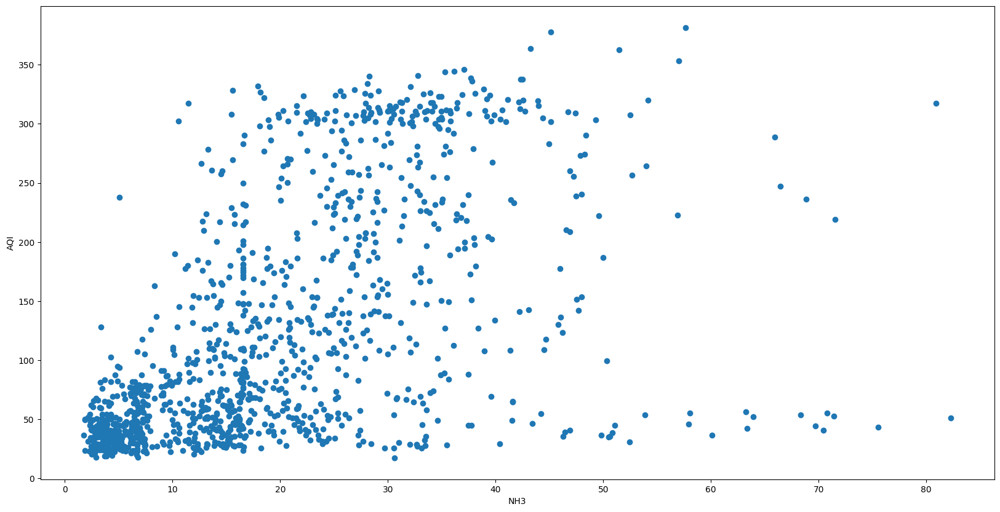

In [201]:
plt.figure(figsize=(20,10))
plt.scatter(x=ballygunge['NH3'],y=ballygunge['AQI'])
plt.xlabel("NH3")
plt.ylabel("AQI")
plt.show()

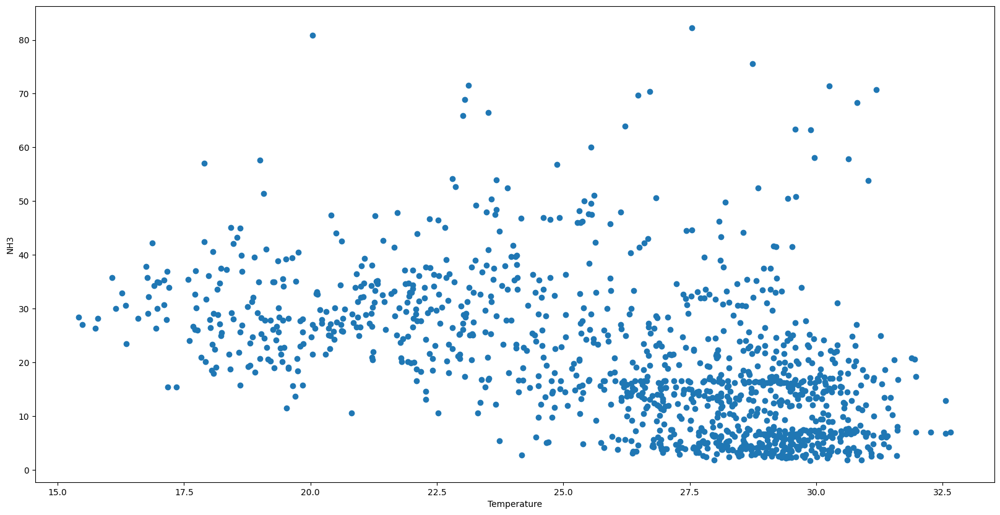

In [202]:
plt.figure(figsize=(20,10))
plt.scatter(x=ballygunge["AT"],y=ballygunge["NH3"])
plt.xlabel("Temperature")
plt.ylabel("NH3")
plt.show()

[]

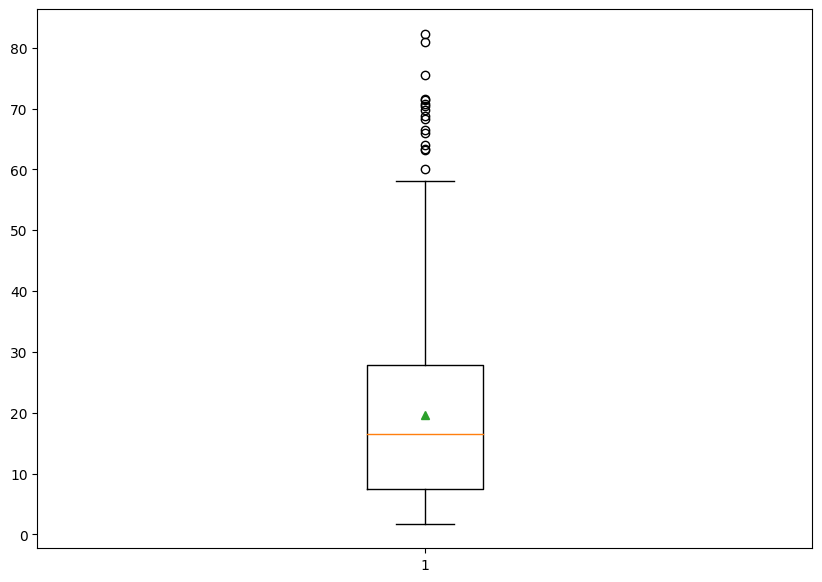

In [203]:
plt.figure(figsize =(10, 7))
plt.boxplot(ballygunge["NH3"],showmeans=True)
plt.plot()

The highest value of NH3 in the 1220 days time period was  82.28  recorded on 2021-06-21 
and the lowest value was  1.76  recorded on 2020-06-10 
The average NH3 value was  19.67 
NH3 value had a standard deviation of  13.53 .
The number of days NH3 was responsible for the AQI value was:- 0 which is around 0.0%


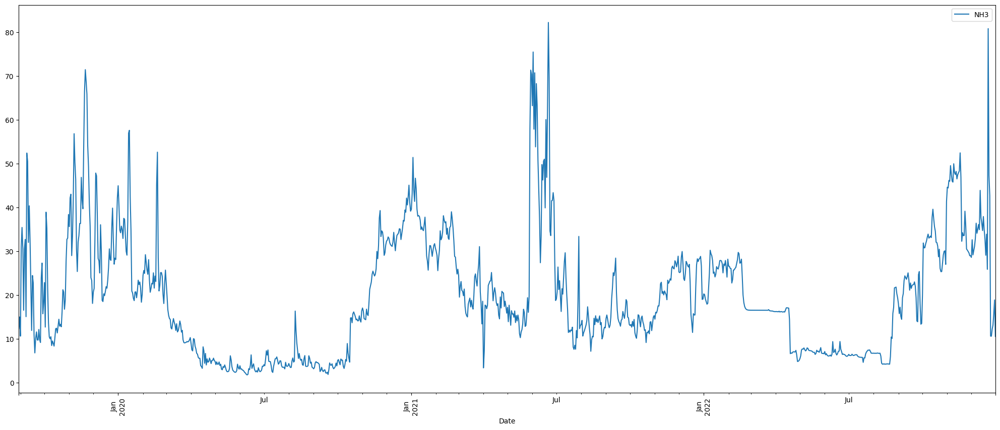

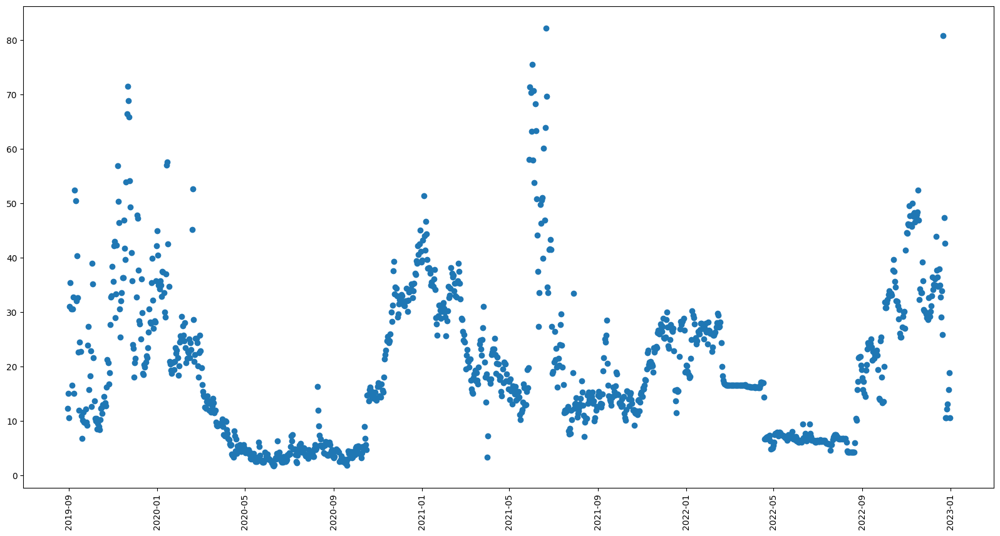

In [204]:
count = 0
for i in range(len(ballygunge)):
    if (NH3(ballygunge["NH3"][i]) == ballygunge["AQI"][i]):
        count = count+1
percent = (count/len(ballygunge))*100
print ("The highest value of NH3 in the "+str(len(ballygunge))+
       " days time period was ",ballygunge["NH3"].loc[ballygunge['NH3'].idxmax()],
       " recorded on", str(ballygunge["Date"].loc[ballygunge['NH3'].idxmax()])[:10],
       '\nand the lowest value was ',ballygunge["NH3"].loc[ballygunge['NH3'].idxmin()], 
       " recorded on",str(ballygunge["Date"].loc[ballygunge['NH3'].idxmin()])[:10],
       "\nThe average NH3 value was ",str(round(ballygunge["NH3"].mean(),2)),
       "\nNH3 value had a standard deviation of ",str(round(ballygunge["NH3"].std(),2)),
       '.\nThe number of days NH3 was responsible for the AQI value was:- '+str(count)+
      " which is around "+str(round(percent,2))+"%")


a = ballygunge.plot(x='Date',y='NH3',figsize=(25, 10))
plt.xticks(rotation='vertical')
plt.show()

f = plt.figure()
f.set_figwidth(20)
f.set_figheight(10)
plt.plot_date(ballygunge['Date'],ballygunge['NH3'])
plt.xticks(rotation='vertical')
plt.show()

#### Sources of NH3

##### NH3 2019

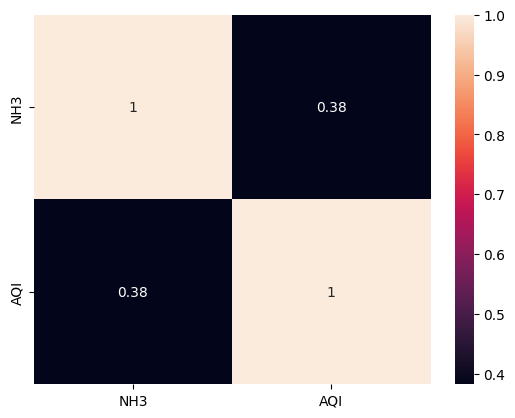

In [205]:
dataplot = sb.heatmap(ballygunge_2019[['NH3','AQI']].corr(), annot=True)
plt.show()

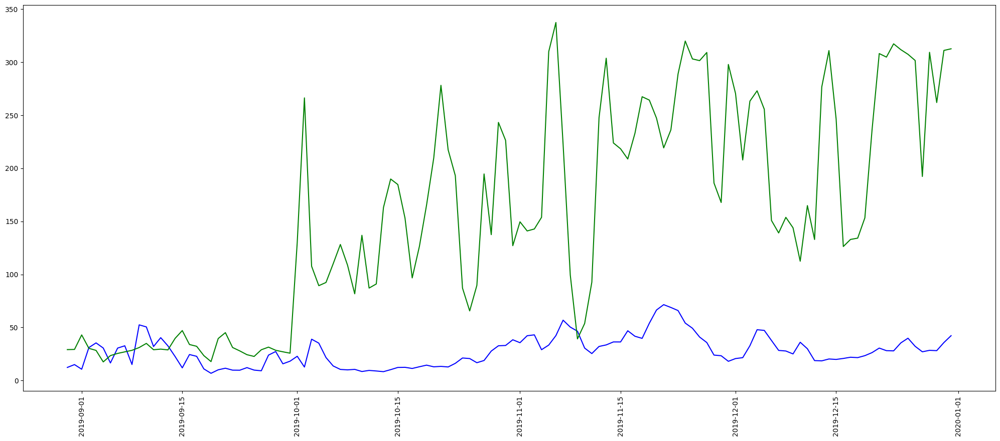

In [206]:
plt.figure(figsize=(25, 10))
plt.plot(ballygunge_2019["Date"],ballygunge_2019["NH3"], color = "blue")
plt.plot(ballygunge_2019["Date"],ballygunge_2019["AQI"],color = "green")
plt.xticks(rotation='vertical')
plt.show()

[]

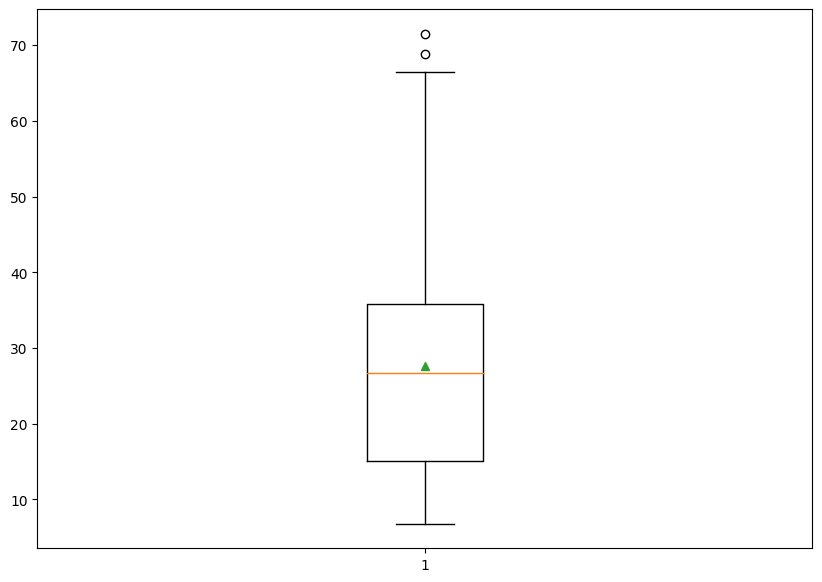

In [207]:
plt.figure(figsize =(10, 7))
plt.boxplot(ballygunge_2019["NH3"],showmeans=True)
plt.plot()

The highest value of NH3 in the 124 days time period was  71.5  recorded on 2019-11-21 
and the lowest value was  6.79  recorded on 2019-09-19 
The average NH3 value was  27.59 
NH3 value had a standard deviation of  14.46 
In 2019 the number of days NH3 was responsible for the AQI value was:- 0 which is around 0.0%


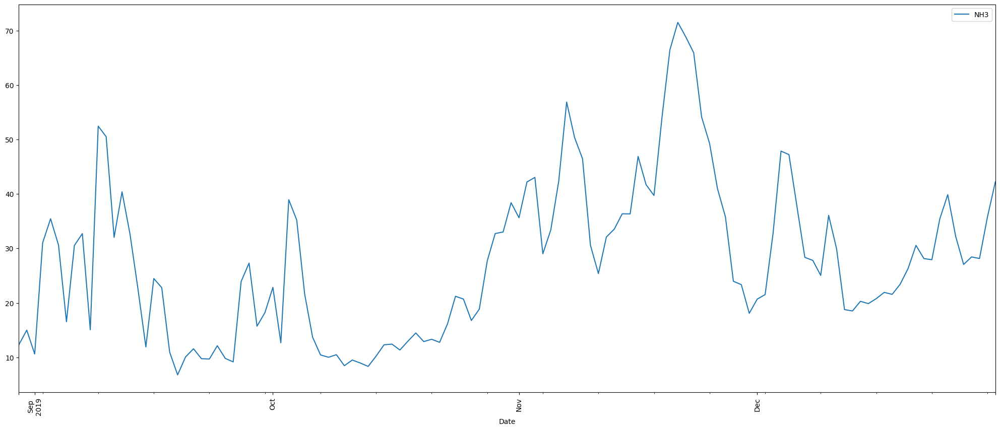

In [208]:
count = 0
for i in range(len(ballygunge_2019)):
    if (NH3(ballygunge_2019["NH3"][i]) == ballygunge_2019["AQI"][i]):
        count = count+1
percent = (count/len(ballygunge_2019))*100

print ("The highest value of NH3 in the "+str(len(ballygunge_2019))+
       " days time period was ",ballygunge_2019["NH3"].loc[ballygunge_2019['NH3'].idxmax()],
       " recorded on", str(ballygunge_2019["Date"].loc[ballygunge_2019['NH3'].idxmax()])[:10],
       '\nand the lowest value was ',ballygunge_2019["NH3"].loc[ballygunge_2019['NH3'].idxmin()], 
       " recorded on",str(ballygunge_2019["Date"].loc[ballygunge_2019['NH3'].idxmin()])[:10],
       "\nThe average NH3 value was ",str(round(ballygunge_2019["NH3"].mean(),2)),
       "\nNH3 value had a standard deviation of ",str(round(ballygunge_2019["NH3"].std(),2)),
       "\nIn 2019 the number of days NH3 was responsible for the AQI value was:- "+str(count)+
      " which is around "+str(round(percent,2))+"%")


a = ballygunge_2019.plot(x='Date',y='NH3',figsize=(25, 10))
plt.xticks(rotation='vertical')
plt.show()

##### NH3 2020

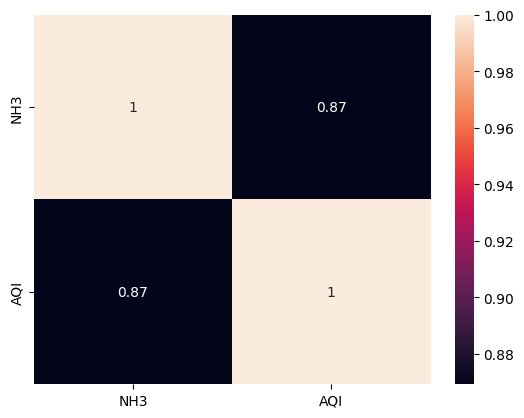

In [209]:
dataplot = sb.heatmap(ballygunge_2020[['NH3','AQI']].corr(), annot=True)
plt.show()

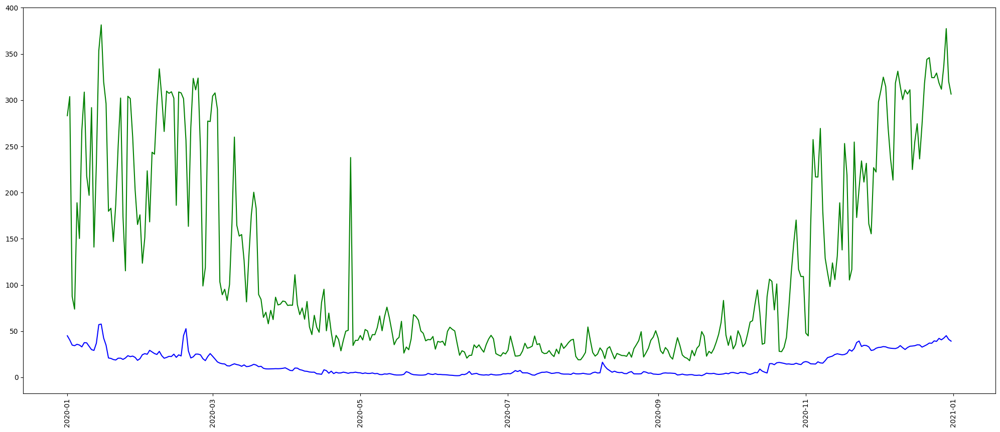

In [210]:
plt.figure(figsize=(25, 10))
plt.plot(ballygunge_2020["Date"],ballygunge_2020["NH3"], color = "blue")
plt.plot(ballygunge_2020["Date"],ballygunge_2020["AQI"],color = "green")
plt.xticks(rotation='vertical')
plt.show()

[]

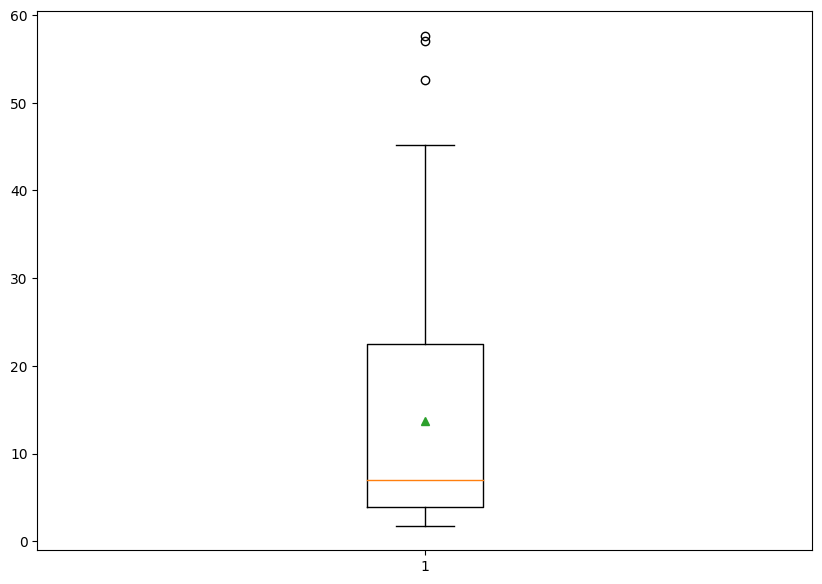

In [211]:
plt.figure(figsize =(10, 7))
plt.boxplot(ballygunge_2020["NH3"],showmeans=True)
plt.plot()

The highest value of NH3 in the 366 days time period was  57.64  recorded on 2020-01-15 
and the lowest value was  1.76  recorded on 2020-06-10 
The average NH3 value was  13.74 
NH3 value had a standard deviation of  12.43 
In 2020 the number of days NH3 was responsible for the AQI value was:- 0 which is around 0.0%


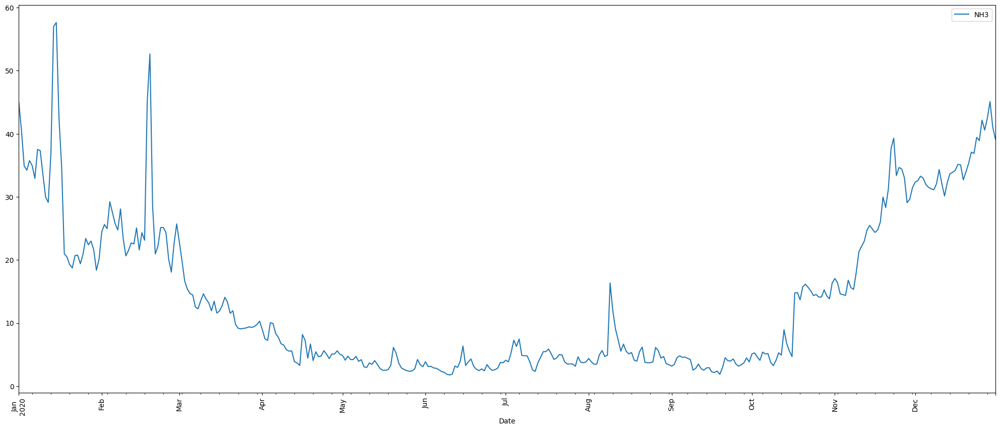

In [212]:
count = 0
for i in range(len(ballygunge_2020)):
    if (NH3(ballygunge_2020["NH3"][i]) == ballygunge_2020["AQI"][i]):
        count = count+1
percent = (count/len(ballygunge_2020))*100

print ("The highest value of NH3 in the "+str(len(ballygunge_2020))+
       " days time period was ",ballygunge_2020["NH3"].loc[ballygunge_2020['NH3'].idxmax()],
       " recorded on", str(ballygunge_2020["Date"].loc[ballygunge_2020['NH3'].idxmax()])[:10],
       '\nand the lowest value was ',ballygunge_2020["NH3"].loc[ballygunge_2020['NH3'].idxmin()], 
       " recorded on",str(ballygunge_2020["Date"].loc[ballygunge_2020['NH3'].idxmin()])[:10],
       "\nThe average NH3 value was ",str(round(ballygunge_2020["NH3"].mean(),2)),
       "\nNH3 value had a standard deviation of ",str(round(ballygunge_2020["NH3"].std(),2)),
       "\nIn 2020 the number of days NH3 was responsible for the AQI value was:- "+str(count)+
      " which is around "+str(round(percent,2))+"%")


a = ballygunge_2020.plot(x='Date',y='NH3',figsize=(25, 10))
plt.xticks(rotation='vertical')
plt.show()

##### NH3 2021

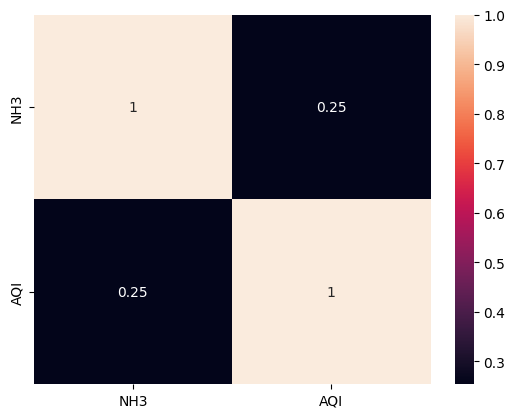

In [213]:
dataplot = sb.heatmap(ballygunge_2021[['NH3','AQI']].corr(), annot=True)
plt.show()

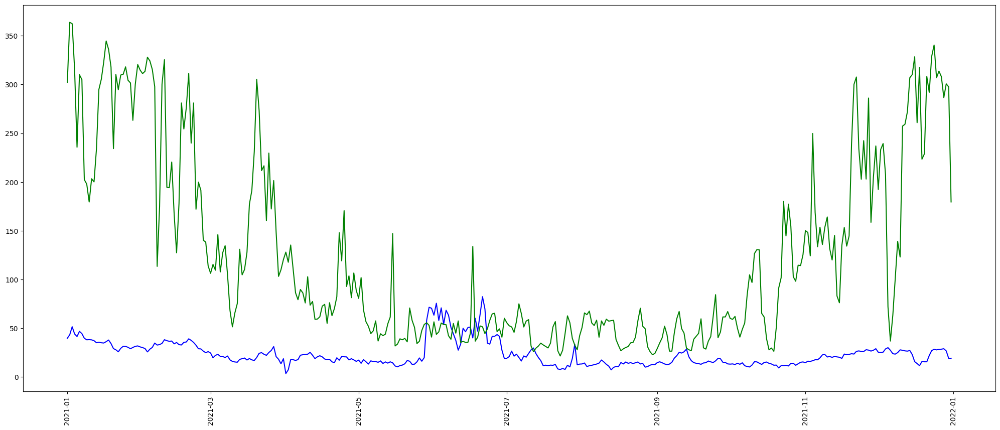

In [214]:
plt.figure(figsize=(25, 10))
plt.plot(ballygunge_2021["Date"],ballygunge_2021["NH3"], color = "blue")
plt.plot(ballygunge_2021["Date"],ballygunge_2021["AQI"],color = "green")
plt.xticks(rotation='vertical')
plt.show()

[]

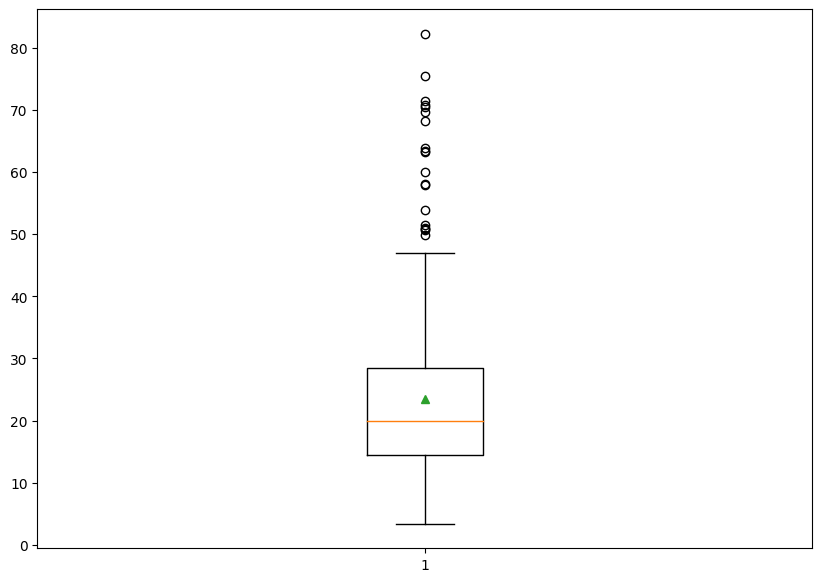

In [215]:
plt.figure(figsize =(10, 7))
plt.boxplot(ballygunge_2021["NH3"],showmeans=True)
plt.plot()

The highest value of NH3 in the 365 days time period was  82.28  recorded on 2021-06-21 
and the lowest value was  3.37  recorded on 2021-04-01 
The average NH3 value was  23.41 
NH3 value had a standard deviation of  12.73 
In 2021 the number of days NH3 was responsible for the AQI value was:- 0 which is around 0.0%


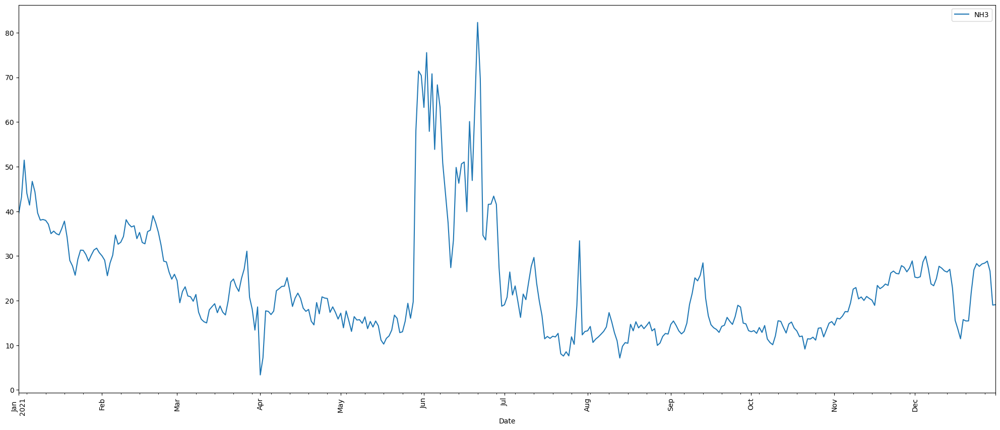

In [216]:
count = 0
for i in range(len(ballygunge_2021)):
    if (NH3(ballygunge_2021["NH3"][i]) == ballygunge_2021["AQI"][i]):
        count = count+1
percent = (count/len(ballygunge_2021))*100

print ("The highest value of NH3 in the "+str(len(ballygunge_2021))+
       " days time period was ",ballygunge_2021["NH3"].loc[ballygunge_2021['NH3'].idxmax()],
       " recorded on", str(ballygunge_2021["Date"].loc[ballygunge_2021['NH3'].idxmax()])[:10],
       '\nand the lowest value was ',ballygunge_2021["NH3"].loc[ballygunge_2021['NH3'].idxmin()], 
       " recorded on",str(ballygunge_2021["Date"].loc[ballygunge_2021['NH3'].idxmin()])[:10],
       "\nThe average NH3 value was ",str(round(ballygunge_2021["NH3"].mean(),2)),
       "\nNH3 value had a standard deviation of ",str(round(ballygunge_2021["NH3"].std(),2)),
       "\nIn 2021 the number of days NH3 was responsible for the AQI value was:- "+str(count)+
      " which is around "+str(round(percent,2))+"%")


a = ballygunge_2021.plot(x='Date',y='NH3',figsize=(25, 10))
plt.xticks(rotation='vertical')
plt.show()

##### NH3 2022

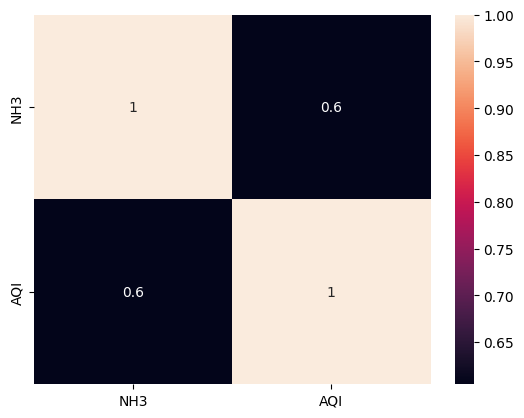

In [217]:
dataplot = sb.heatmap(ballygunge_2022[['NH3','AQI']].corr(), annot=True)
plt.show()

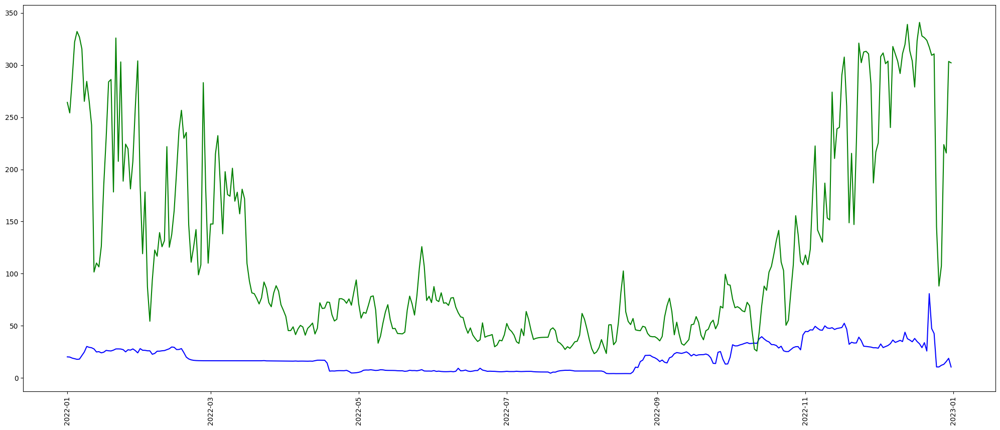

In [218]:
plt.figure(figsize=(25, 10))
plt.plot(ballygunge_2022["Date"],ballygunge_2022["NH3"], color = "blue")
plt.plot(ballygunge_2022["Date"],ballygunge_2022["AQI"],color = "green")
plt.xticks(rotation='vertical')
plt.show()

[]

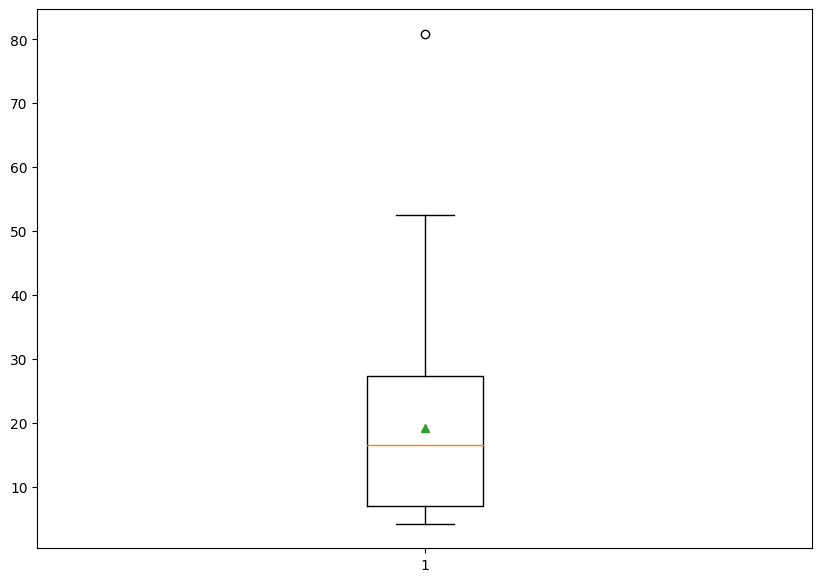

In [219]:
plt.figure(figsize =(10, 7))
plt.boxplot(ballygunge_2022["NH3"],showmeans=True)
plt.plot()

The highest value of NH3 in the 365 days time period was  80.87  recorded on 2022-12-22 
and the lowest value was  4.21  recorded on 2022-08-15 
The average NH3 value was  19.2 
NH3 value had a standard deviation of  12.43 
In 2022 the number of days NH3 was responsible for the AQI value was:- 0 which is around 0.0%


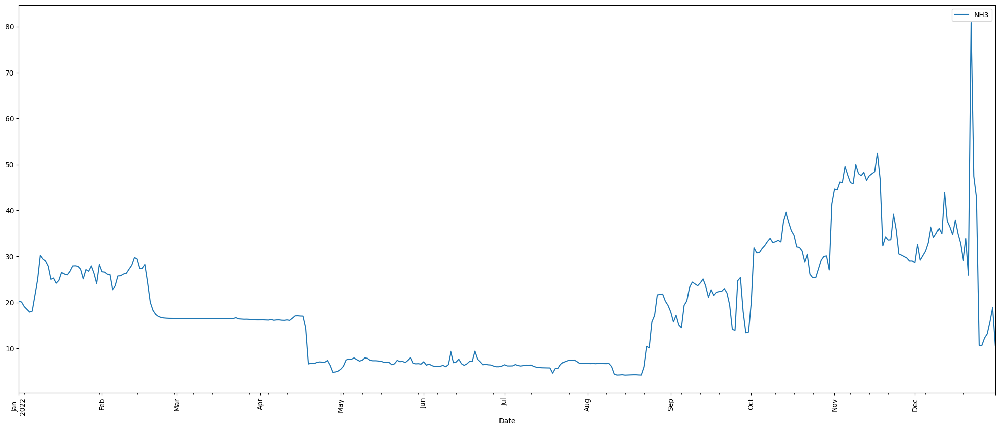

In [220]:
count = 0
for i in range(len(ballygunge_2022)):
    if (NH3(ballygunge_2022["NH3"][i]) == ballygunge_2022["AQI"][i]):
        count = count+1
percent = (count/len(ballygunge_2022))*100

print ("The highest value of NH3 in the "+str(len(ballygunge_2022))+
       " days time period was ",ballygunge_2022["NH3"].loc[ballygunge_2022['NH3'].idxmax()],
       " recorded on", str(ballygunge_2022["Date"].loc[ballygunge_2022['NH3'].idxmax()])[:10],
       '\nand the lowest value was ',ballygunge_2022["NH3"].loc[ballygunge_2022['NH3'].idxmin()], 
       " recorded on",str(ballygunge_2022["Date"].loc[ballygunge_2022['NH3'].idxmin()])[:10],
       "\nThe average NH3 value was ",str(round(ballygunge_2022["NH3"].mean(),2)),
       "\nNH3 value had a standard deviation of ",str(round(ballygunge_2022["NH3"].std(),2)),
       "\nIn 2022 the number of days NH3 was responsible for the AQI value was:- "+str(count)+
      " which is around "+str(round(percent,2))+"%")


a = ballygunge_2022.plot(x='Date',y='NH3',figsize=(25, 10))
plt.xticks(rotation='vertical')
plt.show()

### Sulfur dioxide (SO2)

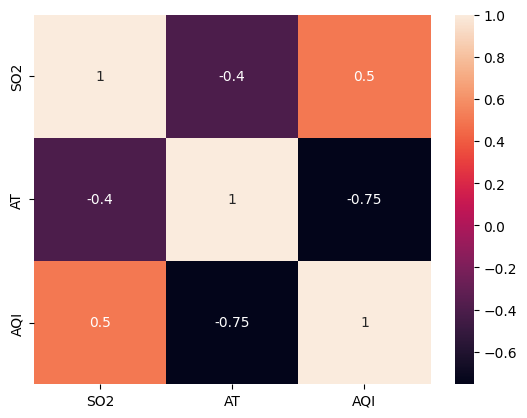

In [221]:
dataplot = sb.heatmap(ballygunge[['SO2','AT','AQI']].corr(), annot=True)
plt.show()

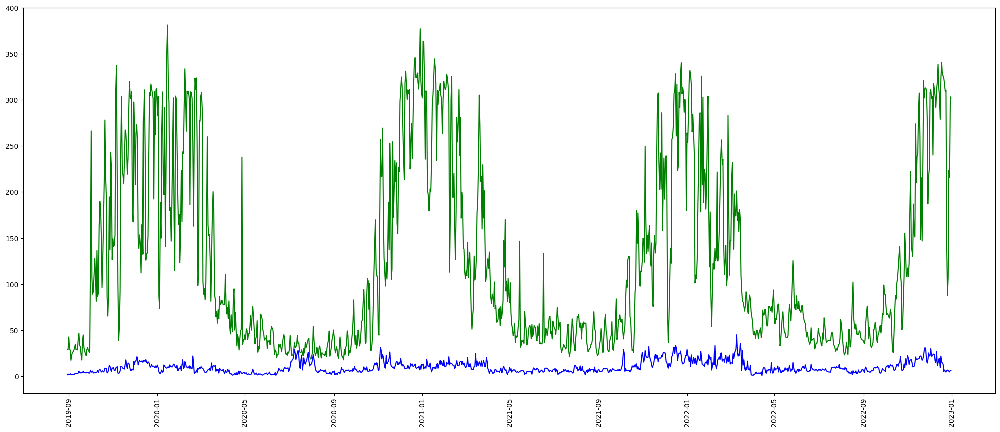

In [222]:
plt.figure(figsize=(25, 10))
plt.plot(ballygunge["Date"],ballygunge["SO2"], color = "blue")
plt.plot(ballygunge["Date"],ballygunge["AQI"],color = "green")
plt.xticks(rotation='vertical')
plt.show()

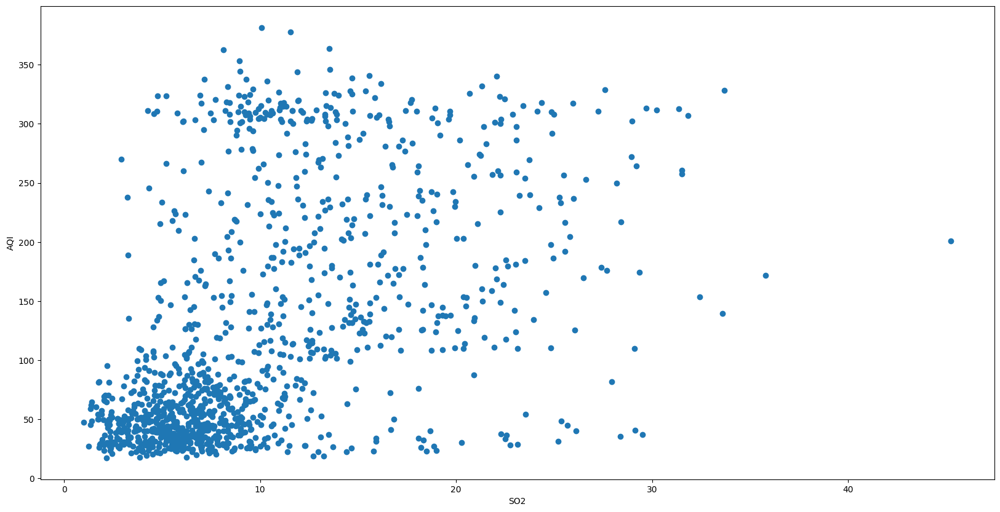

In [223]:
plt.figure(figsize=(20,10))
plt.scatter(x=ballygunge['SO2'],y=ballygunge['AQI'])
plt.xlabel("SO2")
plt.ylabel("AQI")
plt.show()

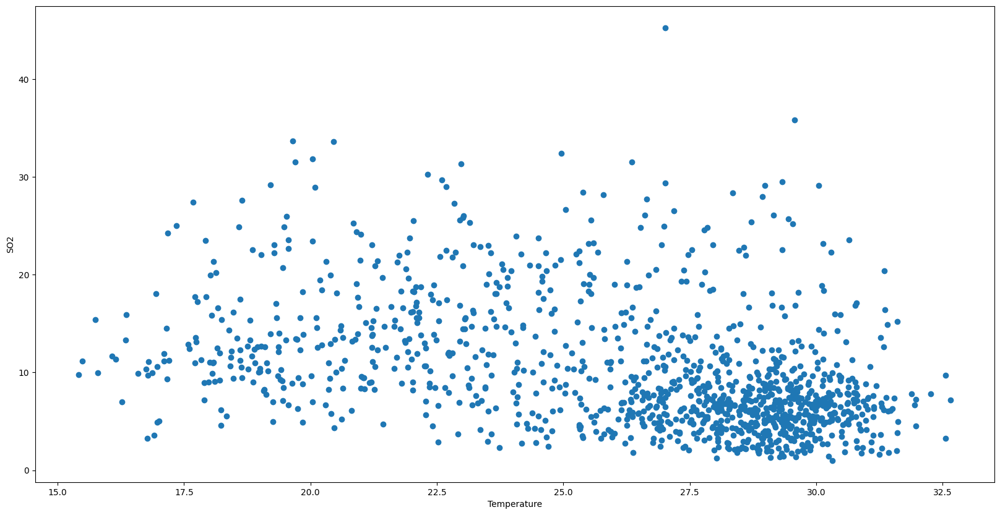

In [224]:
plt.figure(figsize=(20,10))
plt.scatter(x=ballygunge["AT"],y=ballygunge["SO2"])
plt.xlabel("Temperature")
plt.ylabel("SO2")
plt.show()

[]

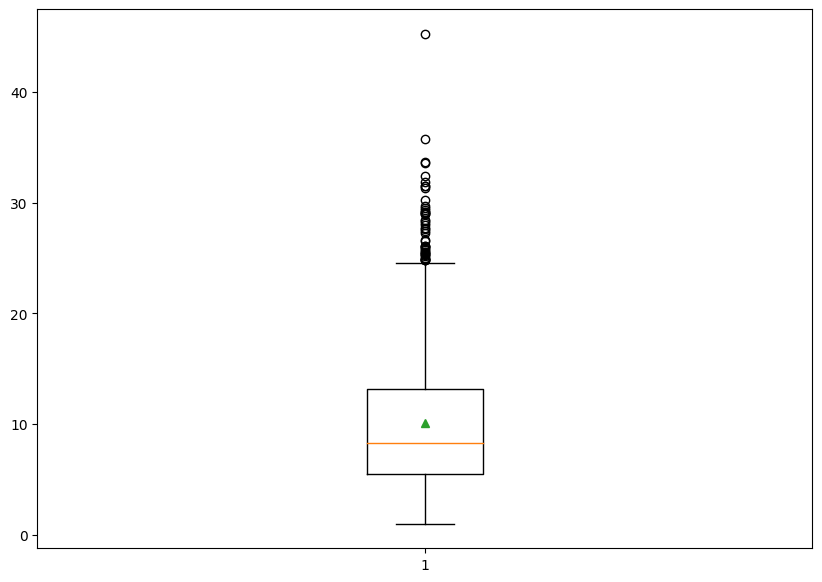

In [225]:
plt.figure(figsize =(10, 7))
plt.boxplot(ballygunge["SO2"],showmeans=True)
plt.plot()

The highest value of SO2 in the 1220 days time period was  45.25  recorded on 2022-03-10 
and the lowest value was  1.0  recorded on 2022-04-14 
The average SO2 value was  10.12 
SO2 value had a standard deviation of  6.4 .
The number of days SO2 was responsible for the AQI value was:- 7 which is around 0.57%


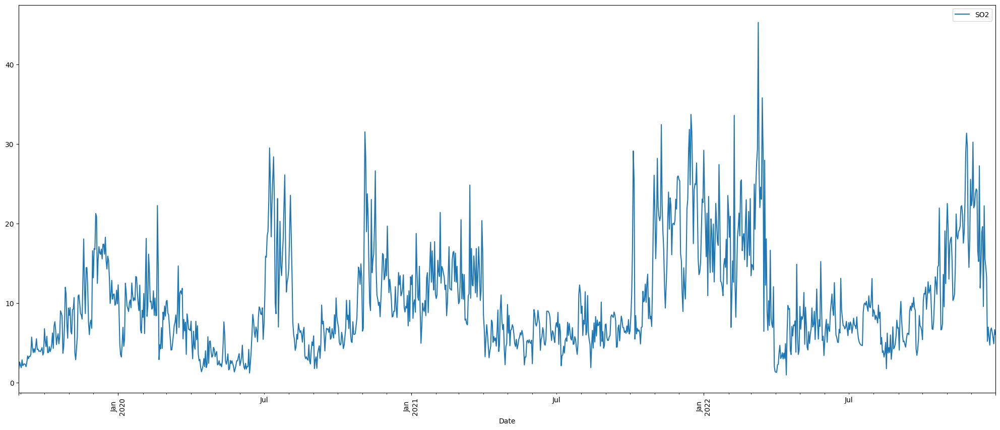

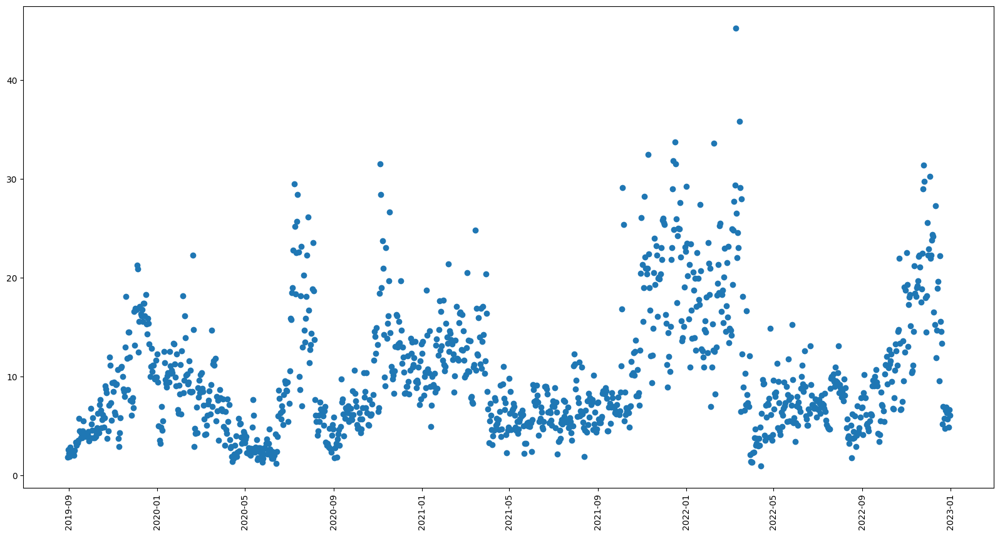

In [226]:
count = 0
for i in range(len(ballygunge)):
    if (SO2(ballygunge["SO2"][i]) == ballygunge["AQI"][i]):
        count = count+1
percent = (count/len(ballygunge))*100
print ("The highest value of SO2 in the "+str(len(ballygunge))+
       " days time period was ",ballygunge["SO2"].loc[ballygunge['SO2'].idxmax()],
       " recorded on", str(ballygunge["Date"].loc[ballygunge['SO2'].idxmax()])[:10],
       '\nand the lowest value was ',ballygunge["SO2"].loc[ballygunge['SO2'].idxmin()], 
       " recorded on",str(ballygunge["Date"].loc[ballygunge['SO2'].idxmin()])[:10],
       "\nThe average SO2 value was ",str(round(ballygunge["SO2"].mean(),2)),
       "\nSO2 value had a standard deviation of ",str(round(ballygunge["SO2"].std(),2)),
       '.\nThe number of days SO2 was responsible for the AQI value was:- '+str(count)+
      " which is around "+str(round(percent,2))+"%")


a = ballygunge.plot(x='Date',y='SO2',figsize=(25, 10))
plt.xticks(rotation='vertical')
plt.show()

f = plt.figure()
f.set_figwidth(20)
f.set_figheight(10)
plt.plot_date(ballygunge['Date'],ballygunge['SO2'])
plt.xticks(rotation='vertical')
plt.show()

#### Sources of SO2

##### SO2 2019

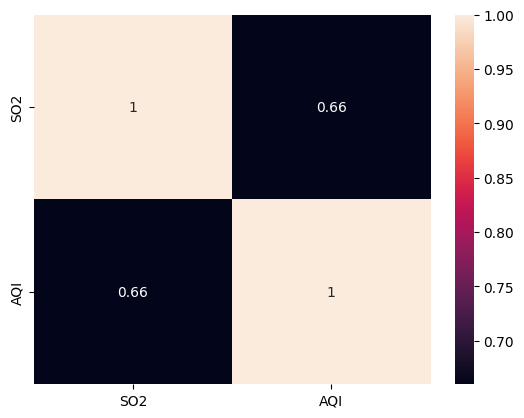

In [227]:
dataplot = sb.heatmap(ballygunge_2019[['SO2','AQI']].corr(), annot=True)
plt.show()

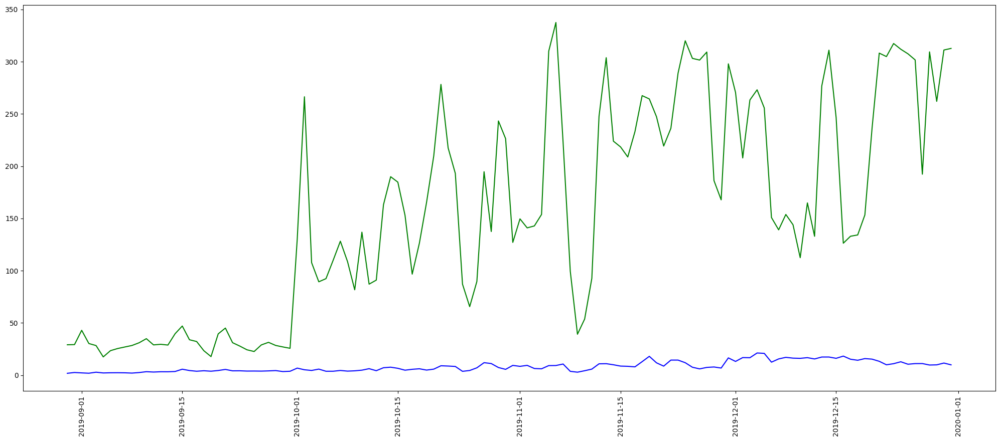

In [228]:
plt.figure(figsize=(25, 10))
plt.plot(ballygunge_2019["Date"],ballygunge_2019["SO2"], color = "blue")
plt.plot(ballygunge_2019["Date"],ballygunge_2019["AQI"],color = "green")
plt.xticks(rotation='vertical')
plt.show()

[]

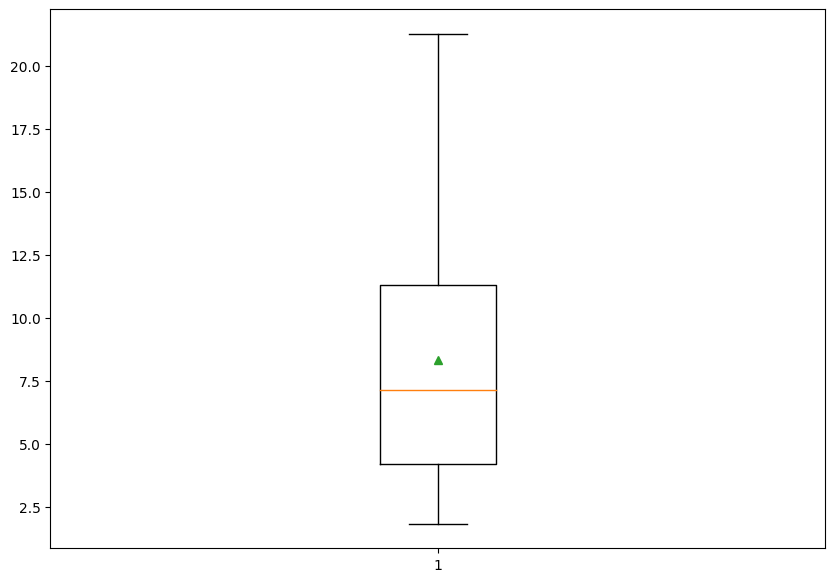

In [229]:
plt.figure(figsize =(10, 7))
plt.boxplot(ballygunge_2019["SO2"],showmeans=True)
plt.plot()

The highest value of SO2 in the 124 days time period was  21.26  recorded on 2019-12-04 
and the lowest value was  1.84  recorded on 2019-08-30 
The average SO2 value was  8.33 
SO2 value had a standard deviation of  4.91 
In 2019 the number of days SO2 was responsible for the AQI value was:- 0 which is around 0.0%


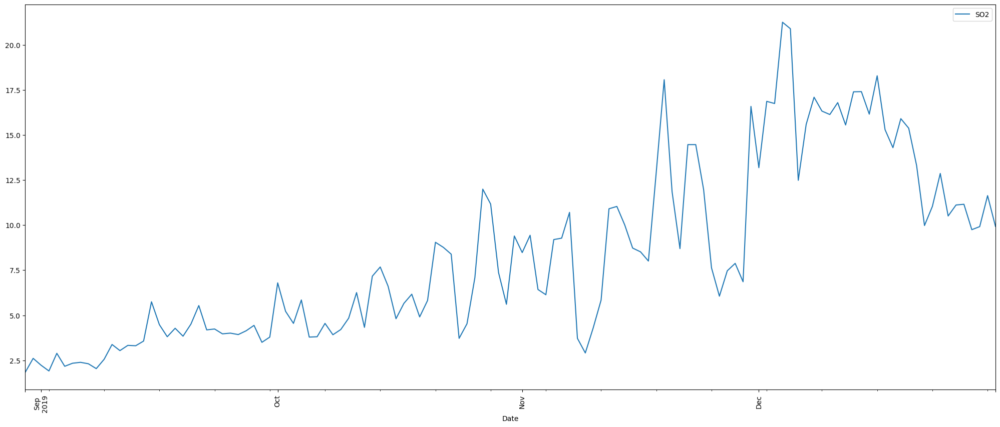

In [230]:
count = 0
for i in range(len(ballygunge_2019)):
    if (SO2(ballygunge_2019["SO2"][i]) == ballygunge_2019["AQI"][i]):
        count = count+1
percent = (count/len(ballygunge_2019))*100

print ("The highest value of SO2 in the "+str(len(ballygunge_2019))+
       " days time period was ",ballygunge_2019["SO2"].loc[ballygunge_2019['SO2'].idxmax()],
       " recorded on", str(ballygunge_2019["Date"].loc[ballygunge_2019['SO2'].idxmax()])[:10],
       '\nand the lowest value was ',ballygunge_2019["SO2"].loc[ballygunge_2019['SO2'].idxmin()], 
       " recorded on",str(ballygunge_2019["Date"].loc[ballygunge_2019['SO2'].idxmin()])[:10],
       "\nThe average SO2 value was ",str(round(ballygunge_2019["SO2"].mean(),2)),
       "\nSO2 value had a standard deviation of ",str(round(ballygunge_2019["SO2"].std(),2)),
       "\nIn 2019 the number of days SO2 was responsible for the AQI value was:- "+str(count)+
      " which is around "+str(round(percent,2))+"%")


a = ballygunge_2019.plot(x='Date',y='SO2',figsize=(25, 10))
plt.xticks(rotation='vertical')
plt.show()

##### SO2 2020

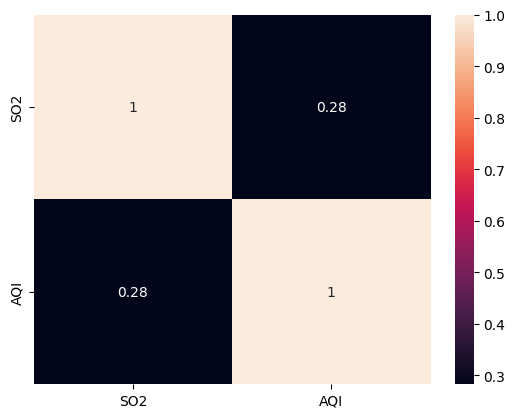

In [231]:
dataplot = sb.heatmap(ballygunge_2020[['SO2','AQI']].corr(), annot=True)
plt.show()

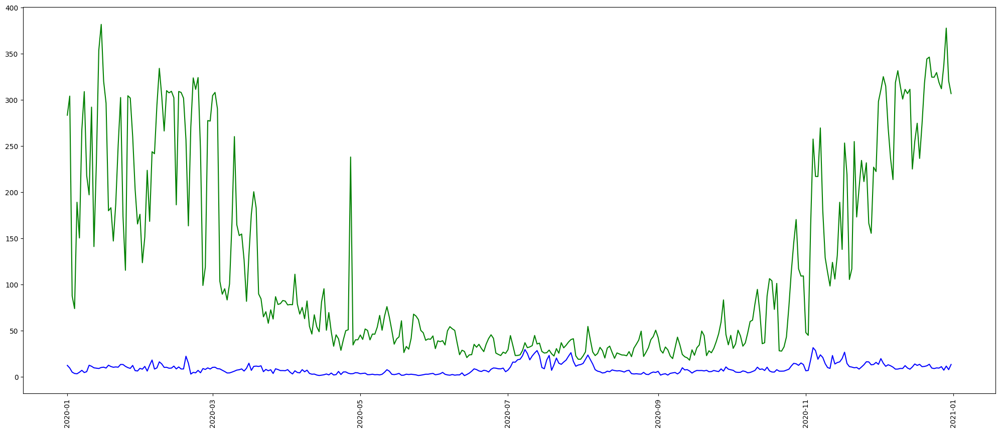

In [232]:
plt.figure(figsize=(25, 10))
plt.plot(ballygunge_2020["Date"],ballygunge_2020["SO2"], color = "blue")
plt.plot(ballygunge_2020["Date"],ballygunge_2020["AQI"],color = "green")
plt.xticks(rotation='vertical')
plt.show()

[]

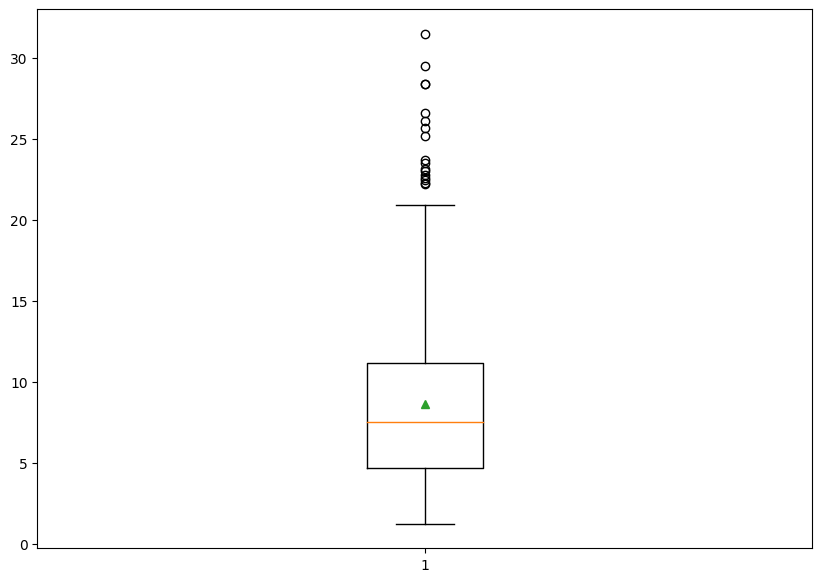

In [233]:
plt.figure(figsize =(10, 7))
plt.boxplot(ballygunge_2020["SO2"],showmeans=True)
plt.plot()

The highest value of SO2 in the 366 days time period was  31.51  recorded on 2020-11-04 
and the lowest value was  1.24  recorded on 2020-06-13 
The average SO2 value was  8.67 
SO2 value had a standard deviation of  5.64 
In 2020 the number of days SO2 was responsible for the AQI value was:- 7 which is around 1.91%


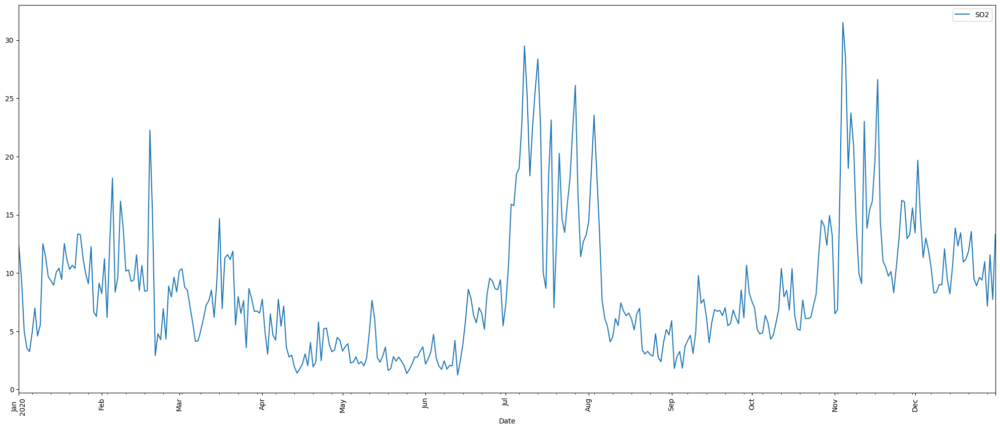

In [234]:
count = 0
for i in range(len(ballygunge_2020)):
    if (SO2(ballygunge_2020["SO2"][i]) == ballygunge_2020["AQI"][i]):
        count = count+1
percent = (count/len(ballygunge_2020))*100

print ("The highest value of SO2 in the "+str(len(ballygunge_2020))+
       " days time period was ",ballygunge_2020["SO2"].loc[ballygunge_2020['SO2'].idxmax()],
       " recorded on", str(ballygunge_2020["Date"].loc[ballygunge_2020['SO2'].idxmax()])[:10],
       '\nand the lowest value was ',ballygunge_2020["SO2"].loc[ballygunge_2020['SO2'].idxmin()], 
       " recorded on",str(ballygunge_2020["Date"].loc[ballygunge_2020['SO2'].idxmin()])[:10],
       "\nThe average SO2 value was ",str(round(ballygunge_2020["SO2"].mean(),2)),
       "\nSO2 value had a standard deviation of ",str(round(ballygunge_2020["SO2"].std(),2)),
       "\nIn 2020 the number of days SO2 was responsible for the AQI value was:- "+str(count)+
      " which is around "+str(round(percent,2))+"%")


a = ballygunge_2020.plot(x='Date',y='SO2',figsize=(25, 10))
plt.xticks(rotation='vertical')
plt.show()

##### SO2 2021

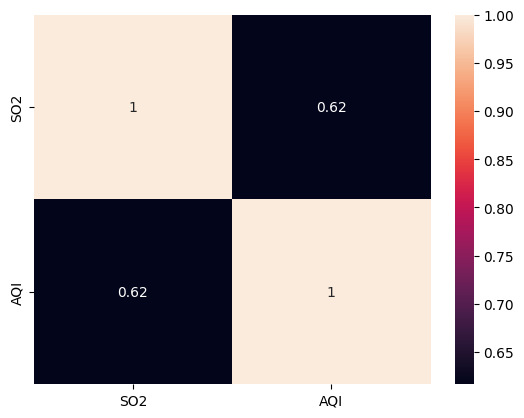

In [235]:
dataplot = sb.heatmap(ballygunge_2021[['SO2','AQI']].corr(), annot=True)
plt.show()

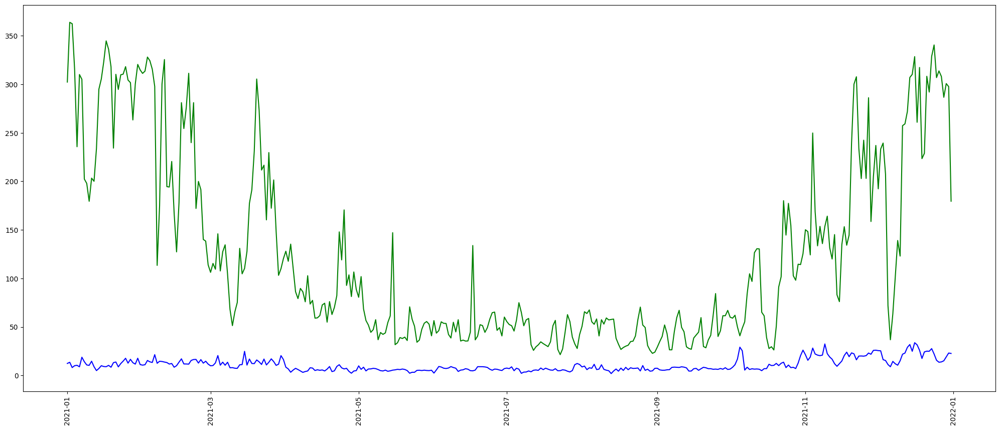

In [236]:
plt.figure(figsize=(25, 10))
plt.plot(ballygunge_2021["Date"],ballygunge_2021["SO2"], color = "blue")
plt.plot(ballygunge_2021["Date"],ballygunge_2021["AQI"],color = "green")
plt.xticks(rotation='vertical')
plt.show()

[]

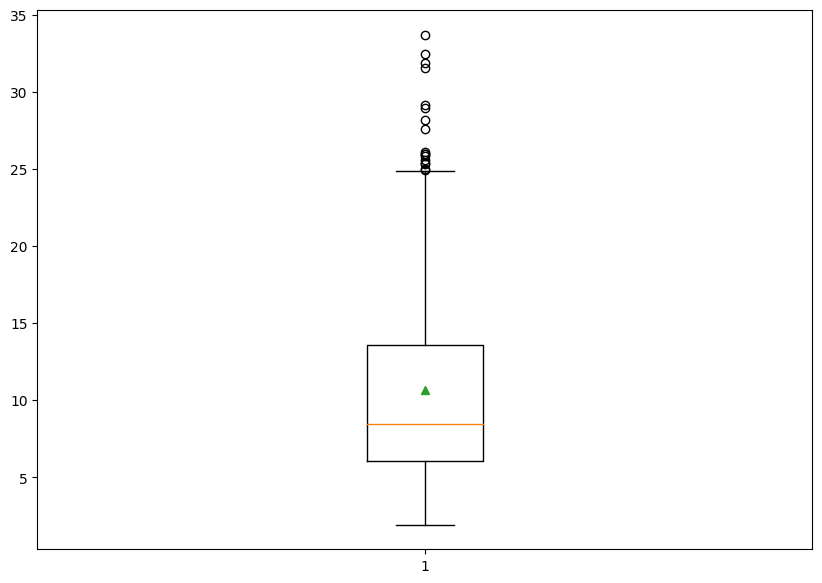

In [237]:
plt.figure(figsize =(10, 7))
plt.boxplot(ballygunge_2021["SO2"],showmeans=True)
plt.plot()

The highest value of SO2 in the 365 days time period was  33.69  recorded on 2021-12-16 
and the lowest value was  1.91  recorded on 2021-08-13 
The average SO2 value was  10.68 
SO2 value had a standard deviation of  6.34 
In 2021 the number of days SO2 was responsible for the AQI value was:- 0 which is around 0.0%


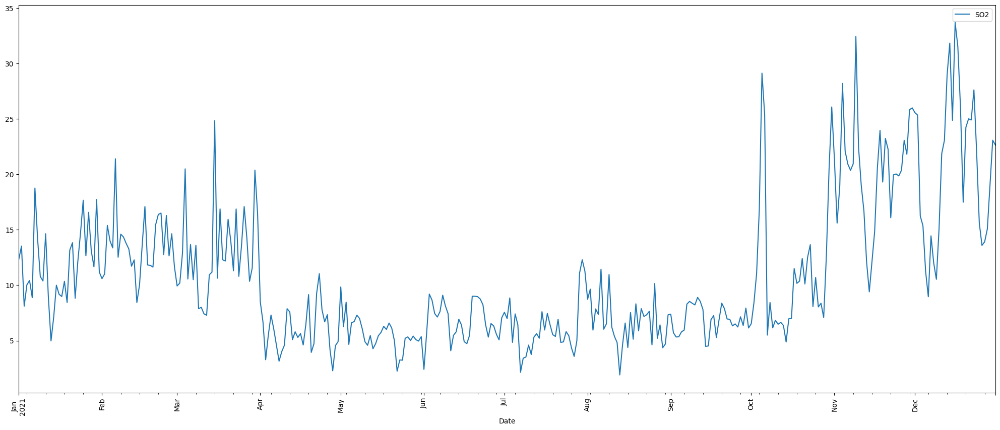

In [238]:
count = 0
for i in range(len(ballygunge_2021)):
    if (SO2(ballygunge_2021["SO2"][i]) == ballygunge_2021["AQI"][i]):
        count = count+1
percent = (count/len(ballygunge_2021))*100

print ("The highest value of SO2 in the "+str(len(ballygunge_2021))+
       " days time period was ",ballygunge_2021["SO2"].loc[ballygunge_2021['SO2'].idxmax()],
       " recorded on", str(ballygunge_2021["Date"].loc[ballygunge_2021['SO2'].idxmax()])[:10],
       '\nand the lowest value was ',ballygunge_2021["SO2"].loc[ballygunge_2021['SO2'].idxmin()], 
       " recorded on",str(ballygunge_2021["Date"].loc[ballygunge_2021['SO2'].idxmin()])[:10],
       "\nThe average SO2 value was ",str(round(ballygunge_2021["SO2"].mean(),2)),
       "\nSO2 value had a standard deviation of ",str(round(ballygunge_2021["SO2"].std(),2)),
       "\nIn 2021 the number of days SO2 was responsible for the AQI value was:- "+str(count)+
      " which is around "+str(round(percent,2))+"%")


a = ballygunge_2021.plot(x='Date',y='SO2',figsize=(25, 10))
plt.xticks(rotation='vertical')
plt.show()

##### SO2 2022

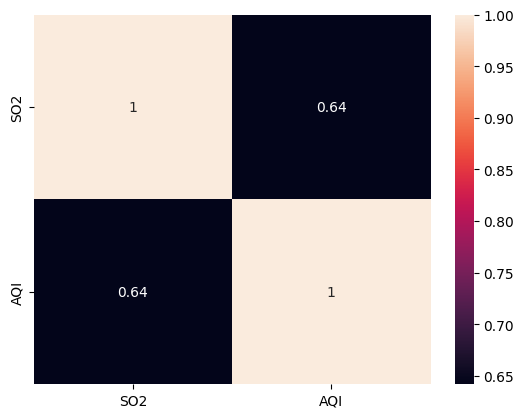

In [239]:
dataplot = sb.heatmap(ballygunge_2022[['SO2','AQI']].corr(), annot=True)
plt.show()

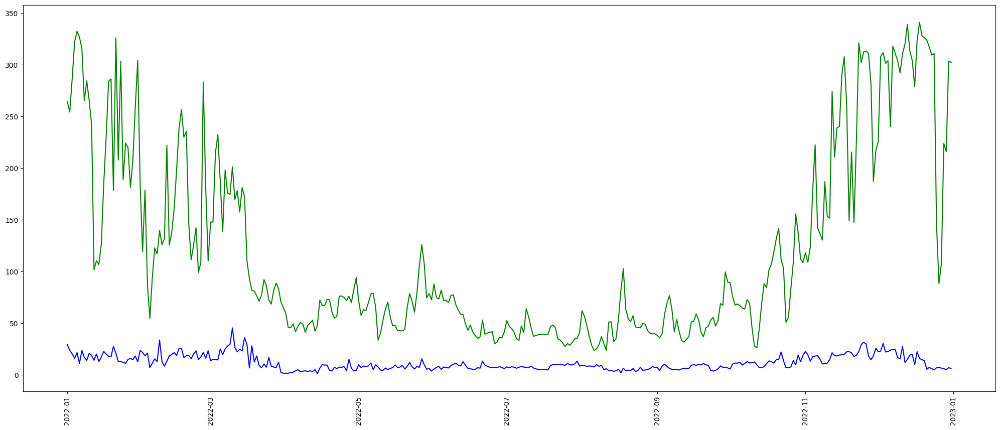

In [240]:
plt.figure(figsize=(25, 10))
plt.plot(ballygunge_2022["Date"],ballygunge_2022["SO2"], color = "blue")
plt.plot(ballygunge_2022["Date"],ballygunge_2022["AQI"],color = "green")
plt.xticks(rotation='vertical')
plt.show()

[]

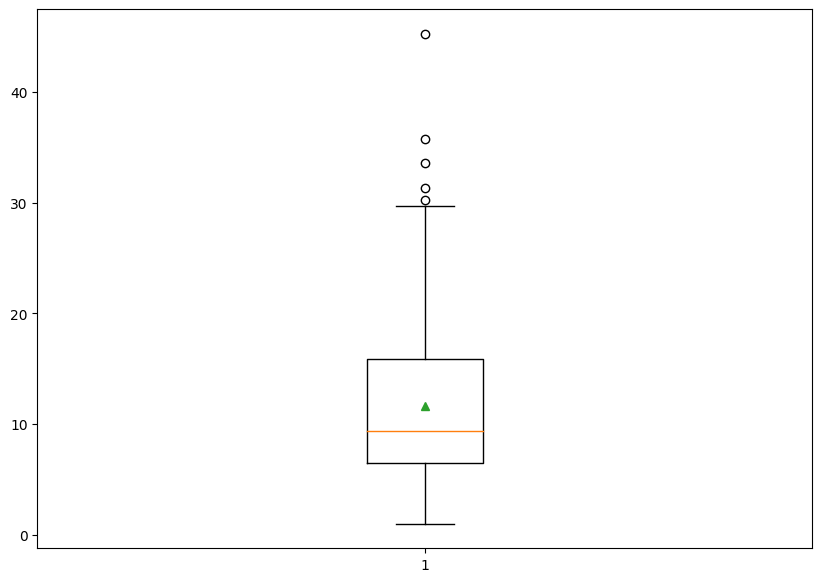

In [241]:
plt.figure(figsize =(10, 7))
plt.boxplot(ballygunge_2022["SO2"],showmeans=True)
plt.plot()

The highest value of SO2 in the 365 days time period was  45.25  recorded on 2022-03-10 
and the lowest value was  1.0  recorded on 2022-04-14 
The average SO2 value was  11.62 
SO2 value had a standard deviation of  7.16 
In 2022 the number of days SO2 was responsible for the AQI value was:- 0 which is around 0.0%


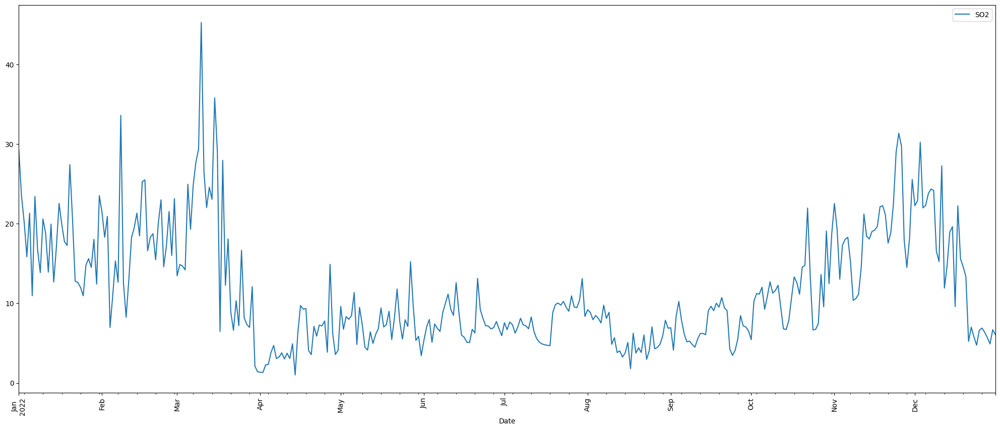

In [242]:
count = 0
for i in range(len(ballygunge_2022)):
    if (SO2(ballygunge_2022["SO2"][i]) == ballygunge_2022["AQI"][i]):
        count = count+1
percent = (count/len(ballygunge_2022))*100

print ("The highest value of SO2 in the "+str(len(ballygunge_2022))+
       " days time period was ",ballygunge_2022["SO2"].loc[ballygunge_2022['SO2'].idxmax()],
       " recorded on", str(ballygunge_2022["Date"].loc[ballygunge_2022['SO2'].idxmax()])[:10],
       '\nand the lowest value was ',ballygunge_2022["SO2"].loc[ballygunge_2022['SO2'].idxmin()], 
       " recorded on",str(ballygunge_2022["Date"].loc[ballygunge_2022['SO2'].idxmin()])[:10],
       "\nThe average SO2 value was ",str(round(ballygunge_2022["SO2"].mean(),2)),
       "\nSO2 value had a standard deviation of ",str(round(ballygunge_2022["SO2"].std(),2)),
       "\nIn 2022 the number of days SO2 was responsible for the AQI value was:- "+str(count)+
      " which is around "+str(round(percent,2))+"%")


a = ballygunge_2022.plot(x='Date',y='SO2',figsize=(25, 10))
plt.xticks(rotation='vertical')
plt.show()

### Carbon Monoxide (CO)

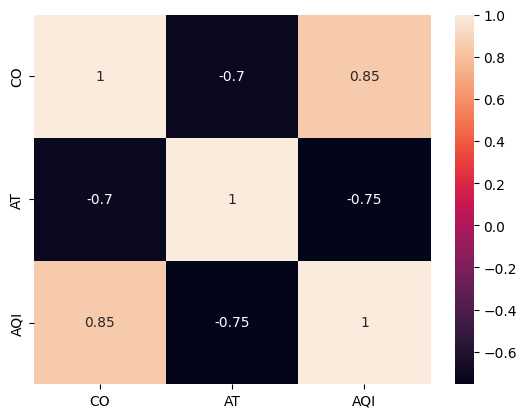

In [243]:
dataplot = sb.heatmap(ballygunge[['CO','AT','AQI']].corr(), annot=True)
plt.show()

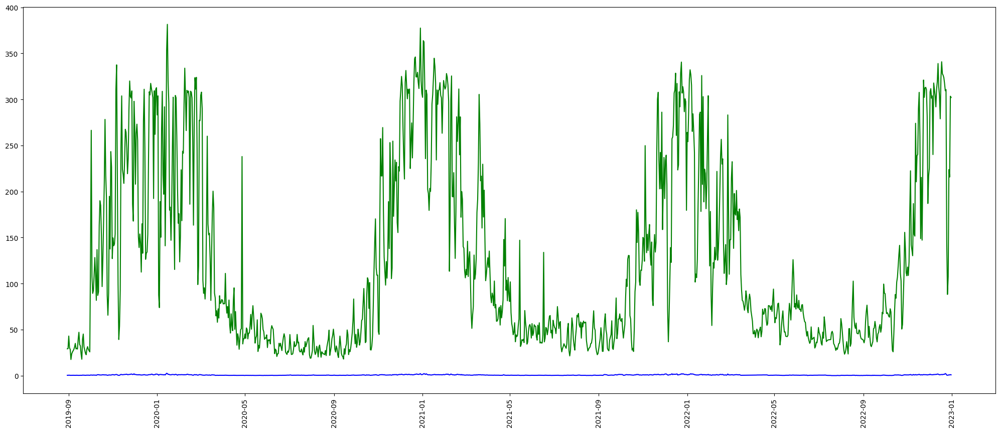

In [244]:
plt.figure(figsize=(25, 10))
plt.plot(ballygunge["Date"],ballygunge["CO"], color = "blue")
plt.plot(ballygunge["Date"],ballygunge["AQI"],color = "green")
plt.xticks(rotation='vertical')
plt.show()

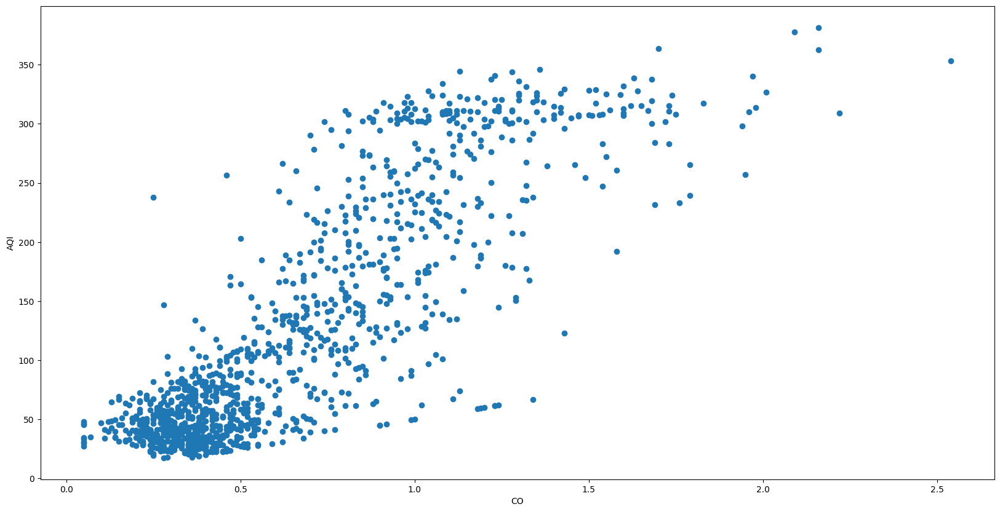

In [245]:
plt.figure(figsize=(20,10))
plt.scatter(x=ballygunge['CO'],y=ballygunge['AQI'])
plt.xlabel("CO")
plt.ylabel("AQI")
plt.show()

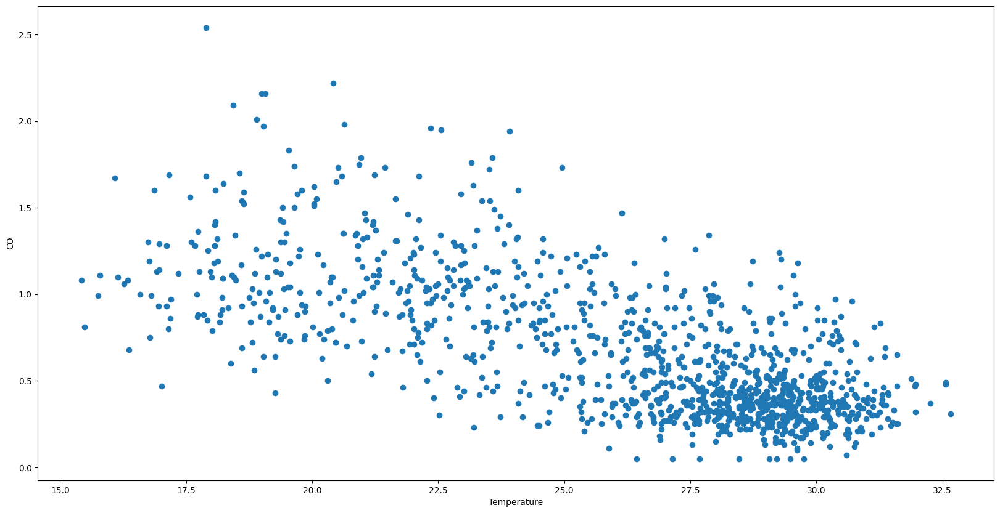

In [246]:
plt.figure(figsize=(20,10))
plt.scatter(x=ballygunge["AT"],y=ballygunge["CO"])
plt.xlabel("Temperature")
plt.ylabel("CO")
plt.show()

[]

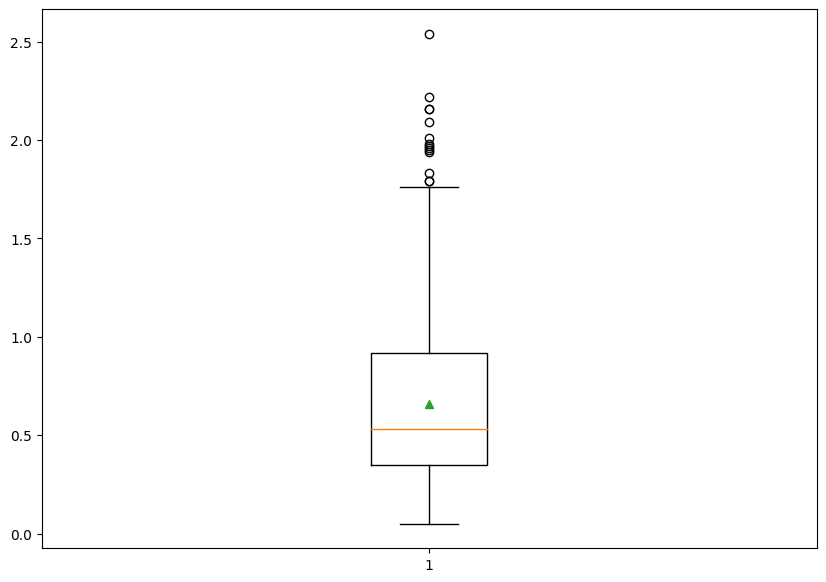

In [247]:
plt.figure(figsize =(10, 7))
plt.boxplot(ballygunge["CO"],showmeans=True)
plt.plot()

The highest value of CO in the 1220 days time period was  2.54  recorded on 2020-01-14 
and the lowest value was  0.05  recorded on 2022-07-19 
The average CO value was  0.66 
CO value had a standard deviation of  0.4 .
The number of days CO was responsible for the AQI value was:- 23 which is around 1.89%


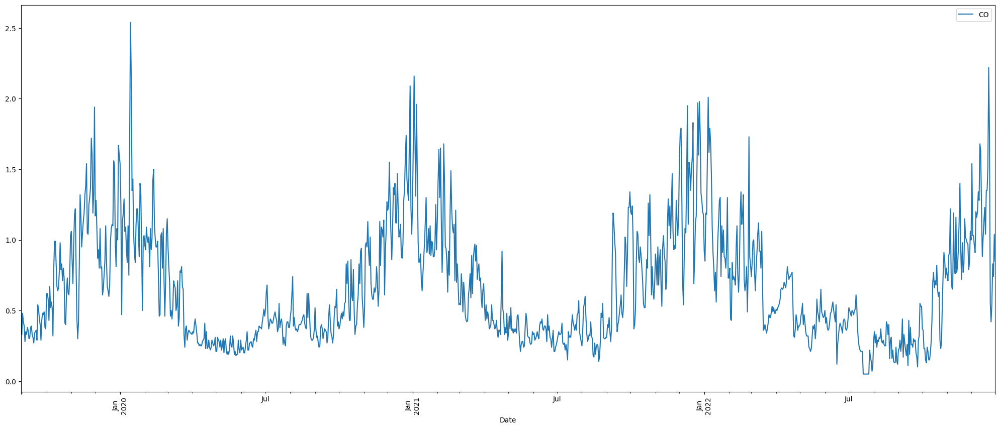

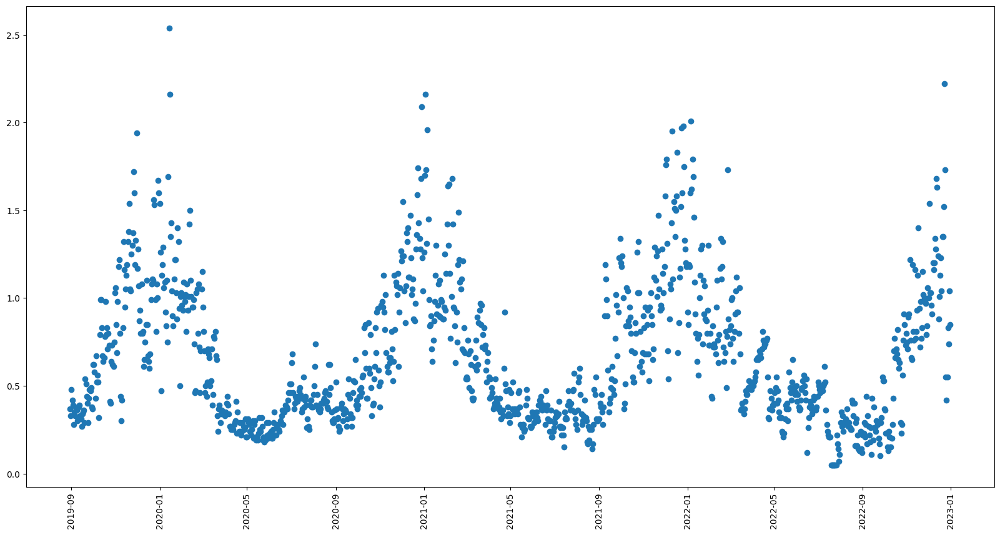

In [248]:
count = 0
for i in range(len(ballygunge)):
    if (CO(ballygunge["CO"][i]) == ballygunge["AQI"][i]):
        count = count+1
percent = (count/len(ballygunge))*100
print ("The highest value of CO in the "+str(len(ballygunge))+
       " days time period was ",ballygunge["CO"].loc[ballygunge['CO'].idxmax()],
       " recorded on", str(ballygunge["Date"].loc[ballygunge['CO'].idxmax()])[:10],
       '\nand the lowest value was ',ballygunge["CO"].loc[ballygunge['CO'].idxmin()], 
       " recorded on",str(ballygunge["Date"].loc[ballygunge['CO'].idxmin()])[:10],
       "\nThe average CO value was ",str(round(ballygunge["CO"].mean(),2)),
       "\nCO value had a standard deviation of ",str(round(ballygunge["CO"].std(),2)),
       '.\nThe number of days CO was responsible for the AQI value was:- '+str(count)+
      " which is around "+str(round(percent,2))+"%")


a = ballygunge.plot(x='Date',y='CO',figsize=(25, 10))
plt.xticks(rotation='vertical')
plt.show()

f = plt.figure()
f.set_figwidth(20)
f.set_figheight(10)
plt.plot_date(ballygunge['Date'],ballygunge['CO'])
plt.xticks(rotation='vertical')
plt.show()

#### Sources of CO

##### CO 2019

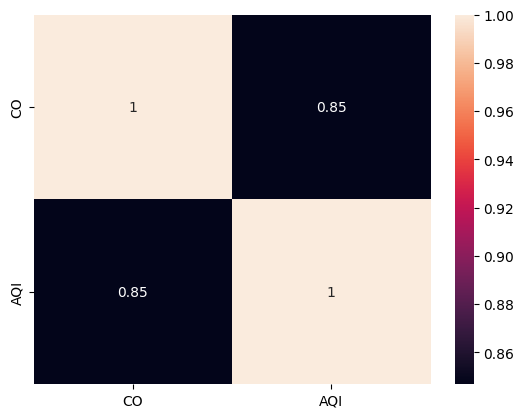

In [249]:
dataplot = sb.heatmap(ballygunge_2019[['CO','AQI']].corr(), annot=True)
plt.show()

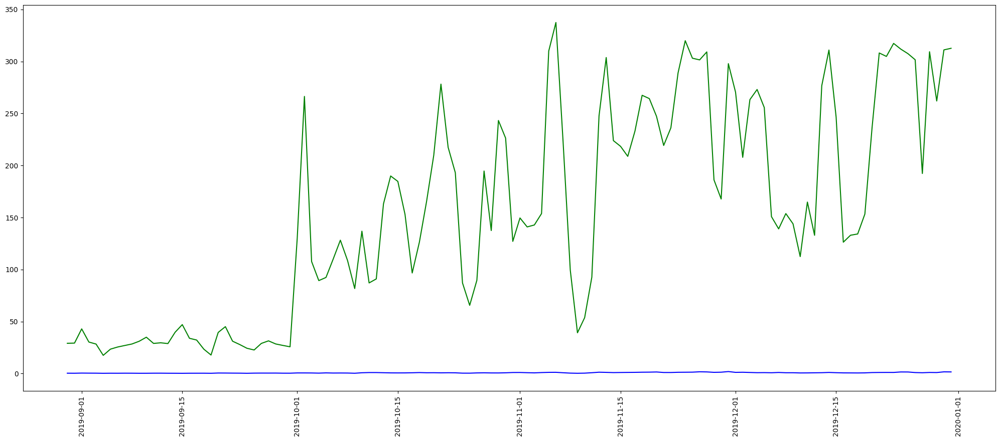

In [250]:
plt.figure(figsize=(25, 10))
plt.plot(ballygunge_2019["Date"],ballygunge_2019["CO"], color = "blue")
plt.plot(ballygunge_2019["Date"],ballygunge_2019["AQI"],color = "green")
plt.xticks(rotation='vertical')
plt.show()

[]

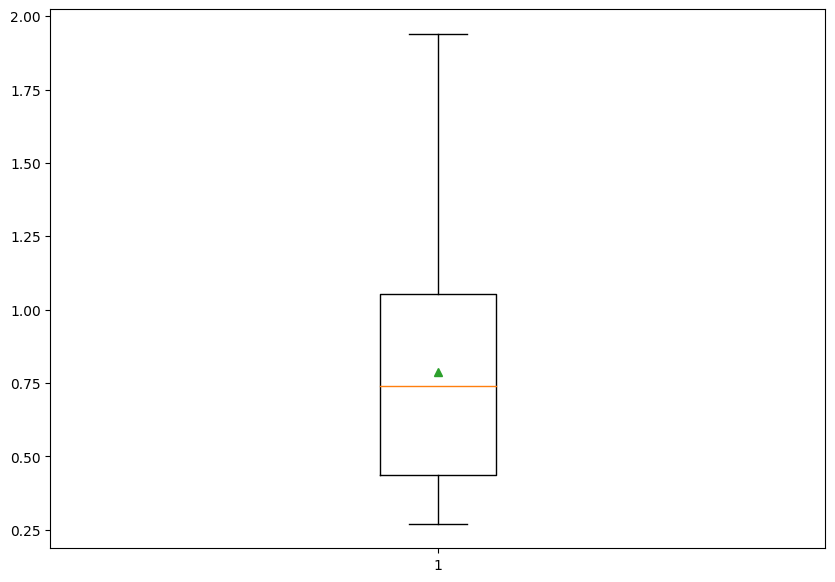

In [251]:
plt.figure(figsize =(10, 7))
plt.boxplot(ballygunge_2019["CO"],showmeans=True)
plt.plot()

The highest value of CO in the 124 days time period was  1.94  recorded on 2019-11-30 
and the lowest value was  0.27  recorded on 2019-09-15 
The average CO value was  0.79 
CO value had a standard deviation of  0.38 
In 2019 the number of days CO was responsible for the AQI value was:- 0 which is around 0.0%


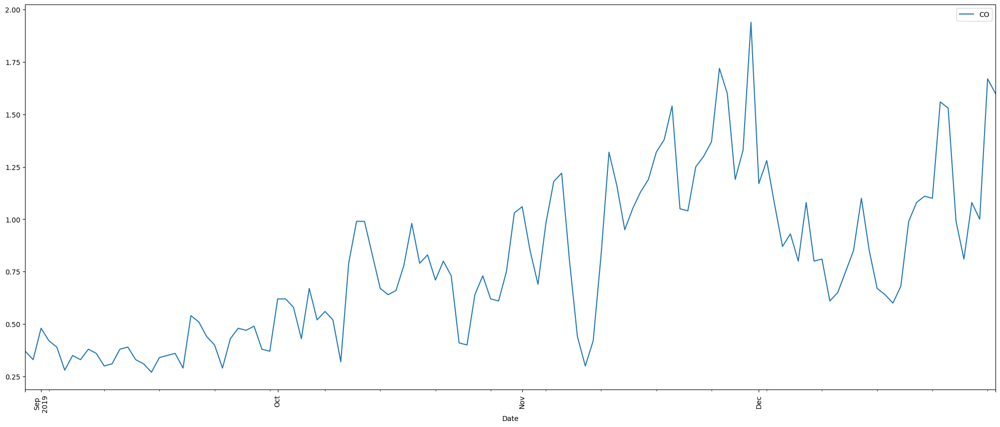

In [252]:
count = 0
for i in range(len(ballygunge_2019)):
    if (CO(ballygunge_2019["CO"][i]) == ballygunge_2019["AQI"][i]):
        count = count+1
percent = (count/len(ballygunge_2019))*100

print ("The highest value of CO in the "+str(len(ballygunge_2019))+
       " days time period was ",ballygunge_2019["CO"].loc[ballygunge_2019['CO'].idxmax()],
       " recorded on", str(ballygunge_2019["Date"].loc[ballygunge_2019['CO'].idxmax()])[:10],
       '\nand the lowest value was ',ballygunge_2019["CO"].loc[ballygunge_2019['CO'].idxmin()], 
       " recorded on",str(ballygunge_2019["Date"].loc[ballygunge_2019['CO'].idxmin()])[:10],
       "\nThe average CO value was ",str(round(ballygunge_2019["CO"].mean(),2)),
       "\nCO value had a standard deviation of ",str(round(ballygunge_2019["CO"].std(),2)),
       "\nIn 2019 the number of days CO was responsible for the AQI value was:- "+str(count)+
      " which is around "+str(round(percent,2))+"%")


a = ballygunge_2019.plot(x='Date',y='CO',figsize=(25, 10))
plt.xticks(rotation='vertical')
plt.show()

##### CO 2020

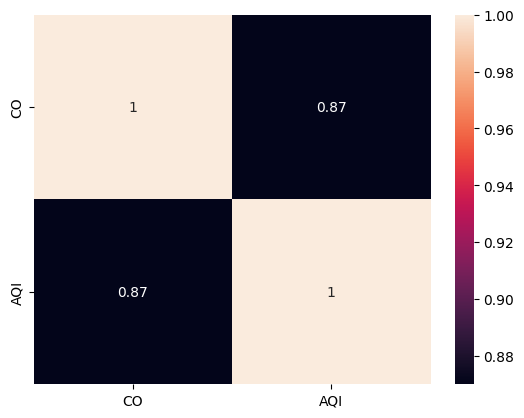

In [253]:
dataplot = sb.heatmap(ballygunge_2020[['CO','AQI']].corr(), annot=True)
plt.show()

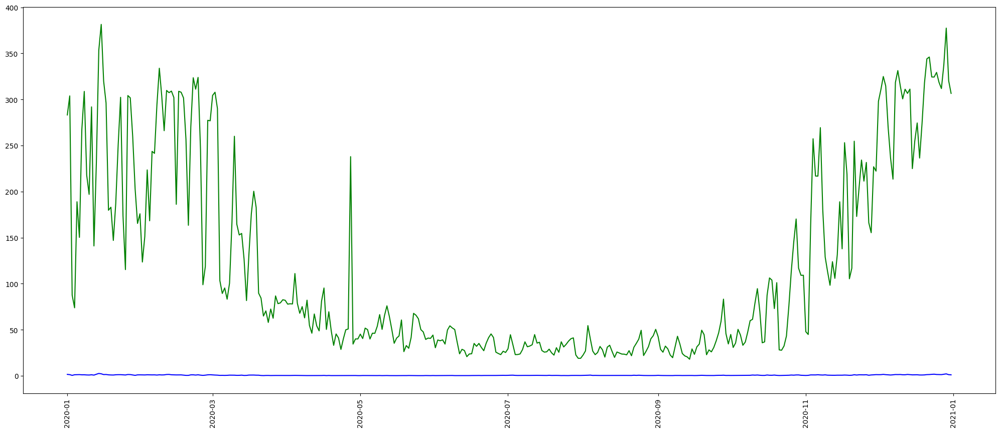

In [254]:
plt.figure(figsize=(25, 10))
plt.plot(ballygunge_2020["Date"],ballygunge_2020["CO"], color = "blue")
plt.plot(ballygunge_2020["Date"],ballygunge_2020["AQI"],color = "green")
plt.xticks(rotation='vertical')
plt.show()

[]

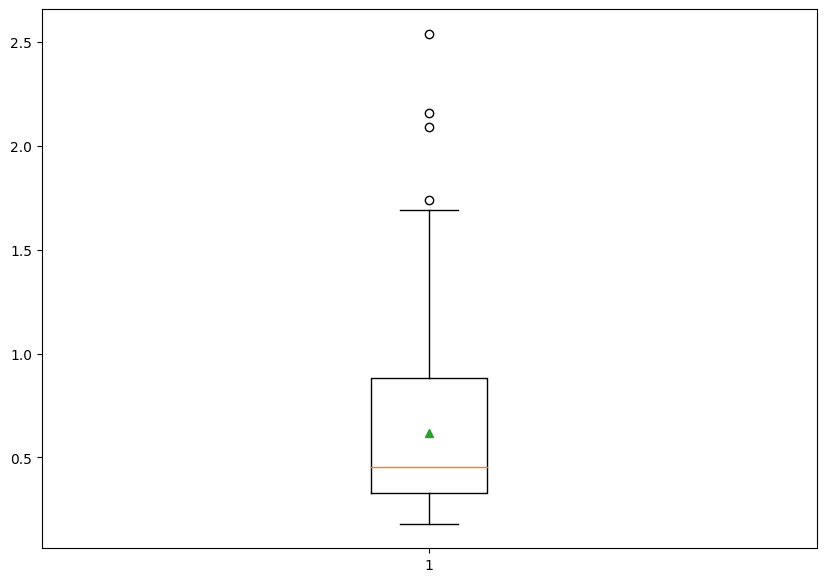

In [255]:
plt.figure(figsize =(10, 7))
plt.boxplot(ballygunge_2020["CO"],showmeans=True)
plt.plot()

The highest value of CO in the 366 days time period was  2.54  recorded on 2020-01-14 
and the lowest value was  0.18  recorded on 2020-05-25 
The average CO value was  0.62 
CO value had a standard deviation of  0.39 
In 2020 the number of days CO was responsible for the AQI value was:- 10 which is around 2.73%


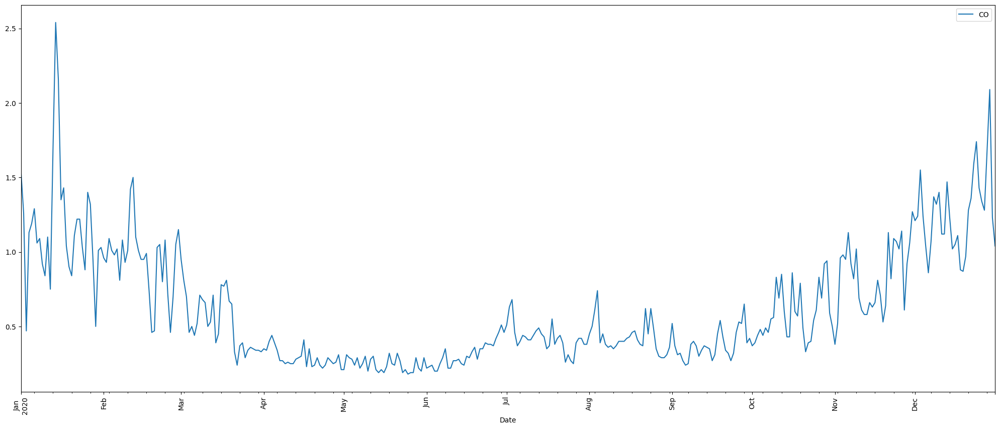

In [256]:
count = 0
for i in range(len(ballygunge_2020)):
    if (CO(ballygunge_2020["CO"][i]) == ballygunge_2020["AQI"][i]):
        count = count+1
percent = (count/len(ballygunge_2020))*100

print ("The highest value of CO in the "+str(len(ballygunge_2020))+
       " days time period was ",ballygunge_2020["CO"].loc[ballygunge_2020['CO'].idxmax()],
       " recorded on", str(ballygunge_2020["Date"].loc[ballygunge_2020['CO'].idxmax()])[:10],
       '\nand the lowest value was ',ballygunge_2020["CO"].loc[ballygunge_2020['CO'].idxmin()], 
       " recorded on",str(ballygunge_2020["Date"].loc[ballygunge_2020['CO'].idxmin()])[:10],
       "\nThe average CO value was ",str(round(ballygunge_2020["CO"].mean(),2)),
       "\nCO value had a standard deviation of ",str(round(ballygunge_2020["CO"].std(),2)),
       "\nIn 2020 the number of days CO was responsible for the AQI value was:- "+str(count)+
      " which is around "+str(round(percent,2))+"%")


a = ballygunge_2020.plot(x='Date',y='CO',figsize=(25, 10))
plt.xticks(rotation='vertical')
plt.show()

##### CO 2021

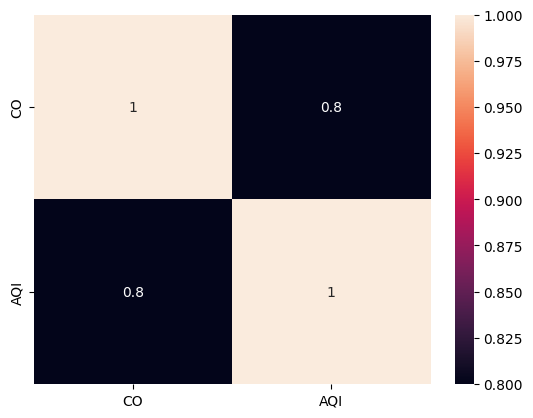

In [257]:
dataplot = sb.heatmap(ballygunge_2021[['CO','AQI']].corr(), annot=True)
plt.show()

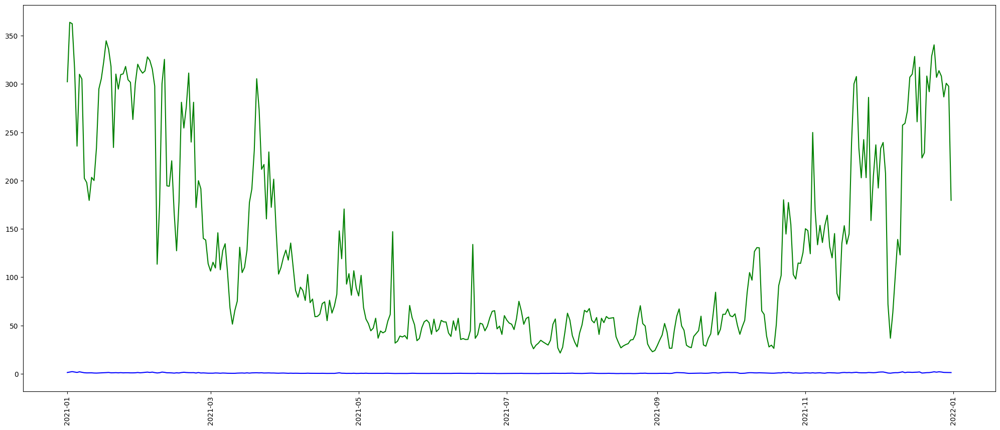

In [258]:
plt.figure(figsize=(25, 10))
plt.plot(ballygunge_2021["Date"],ballygunge_2021["CO"], color = "blue")
plt.plot(ballygunge_2021["Date"],ballygunge_2021["AQI"],color = "green")
plt.xticks(rotation='vertical')
plt.show()

[]

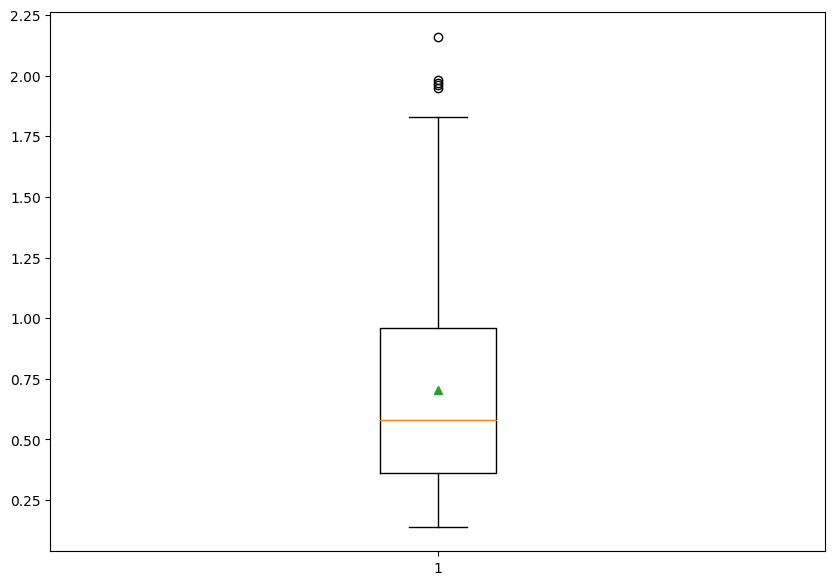

In [259]:
plt.figure(figsize =(10, 7))
plt.boxplot(ballygunge_2021["CO"],showmeans=True)
plt.plot()

The highest value of CO in the 365 days time period was  2.16  recorded on 2021-01-03 
and the lowest value was  0.14  recorded on 2021-08-22 
The average CO value was  0.71 
CO value had a standard deviation of  0.42 
In 2021 the number of days CO was responsible for the AQI value was:- 13 which is around 3.56%


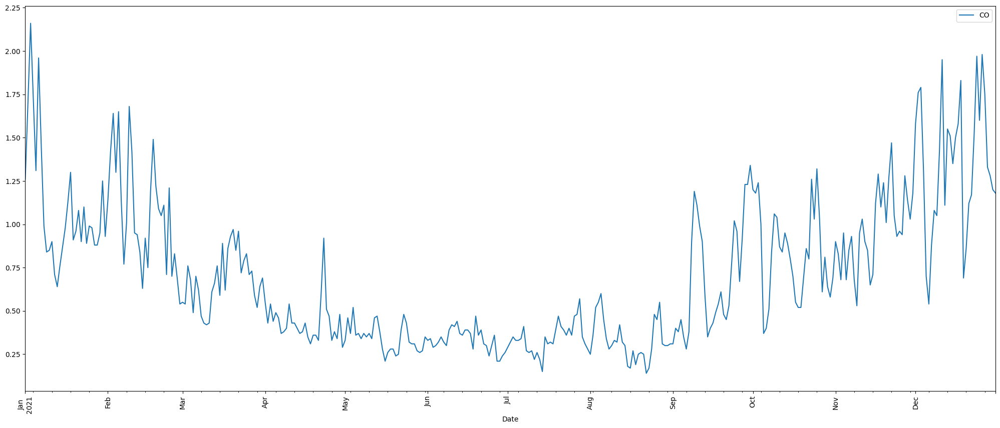

In [260]:
count = 0
for i in range(len(ballygunge_2021)):
    if (CO(ballygunge_2021["CO"][i]) == ballygunge_2021["AQI"][i]):
        count = count+1
percent = (count/len(ballygunge_2021))*100

print ("The highest value of CO in the "+str(len(ballygunge_2021))+
       " days time period was ",ballygunge_2021["CO"].loc[ballygunge_2021['CO'].idxmax()],
       " recorded on", str(ballygunge_2021["Date"].loc[ballygunge_2021['CO'].idxmax()])[:10],
       '\nand the lowest value was ',ballygunge_2021["CO"].loc[ballygunge_2021['CO'].idxmin()], 
       " recorded on",str(ballygunge_2021["Date"].loc[ballygunge_2021['CO'].idxmin()])[:10],
       "\nThe average CO value was ",str(round(ballygunge_2021["CO"].mean(),2)),
       "\nCO value had a standard deviation of ",str(round(ballygunge_2021["CO"].std(),2)),
       "\nIn 2021 the number of days CO was responsible for the AQI value was:- "+str(count)+
      " which is around "+str(round(percent,2))+"%")


a = ballygunge_2021.plot(x='Date',y='CO',figsize=(25, 10))
plt.xticks(rotation='vertical')
plt.show()

##### CO 2022

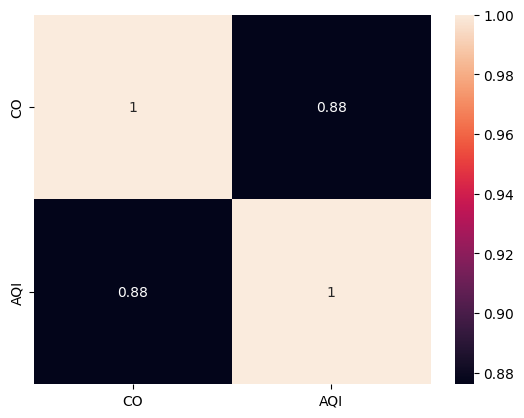

In [261]:
dataplot = sb.heatmap(ballygunge_2022[['CO','AQI']].corr(), annot=True)
plt.show()

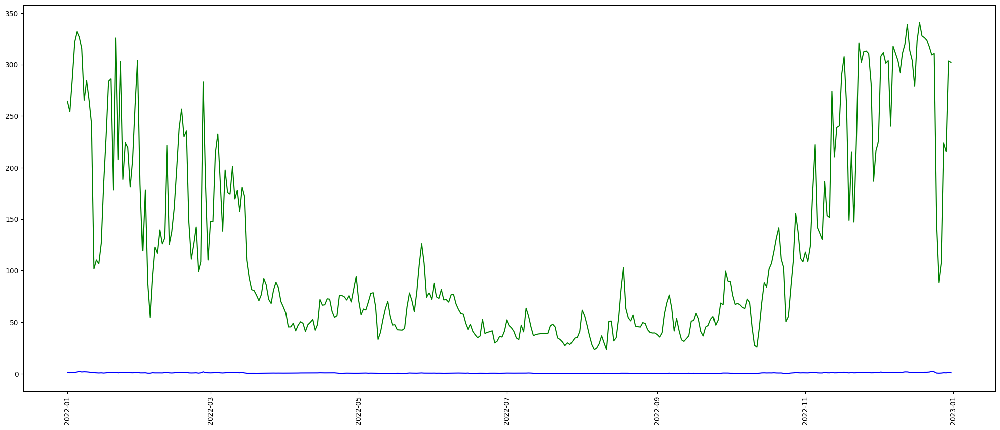

In [262]:
plt.figure(figsize=(25, 10))
plt.plot(ballygunge_2022["Date"],ballygunge_2022["CO"], color = "blue")
plt.plot(ballygunge_2022["Date"],ballygunge_2022["AQI"],color = "green")
plt.xticks(rotation='vertical')
plt.show()

[]

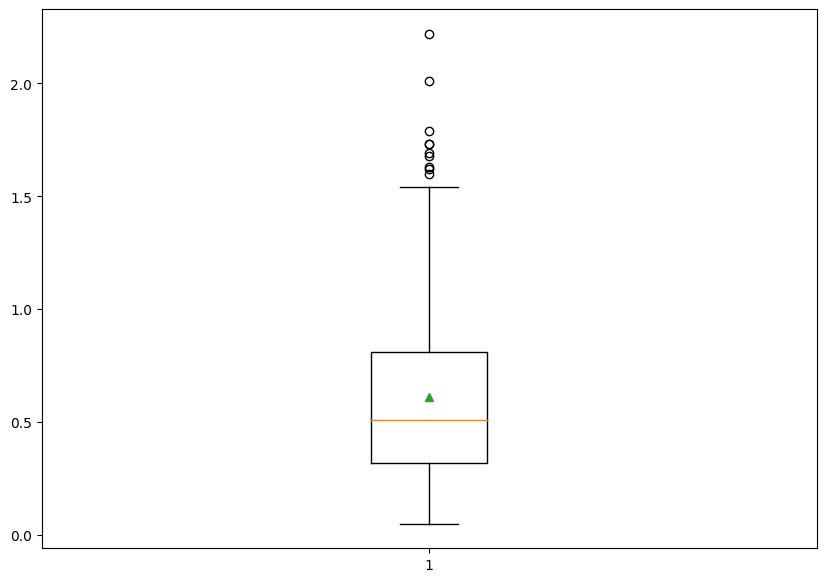

In [263]:
plt.figure(figsize =(10, 7))
plt.boxplot(ballygunge_2022["CO"],showmeans=True)
plt.plot()

The highest value of CO in the 365 days time period was  2.22  recorded on 2022-12-23 
and the lowest value was  0.05  recorded on 2022-07-19 
The average CO value was  0.61 
CO value had a standard deviation of  0.38 
In 2022 the number of days CO was responsible for the AQI value was:- 0 which is around 0.0%


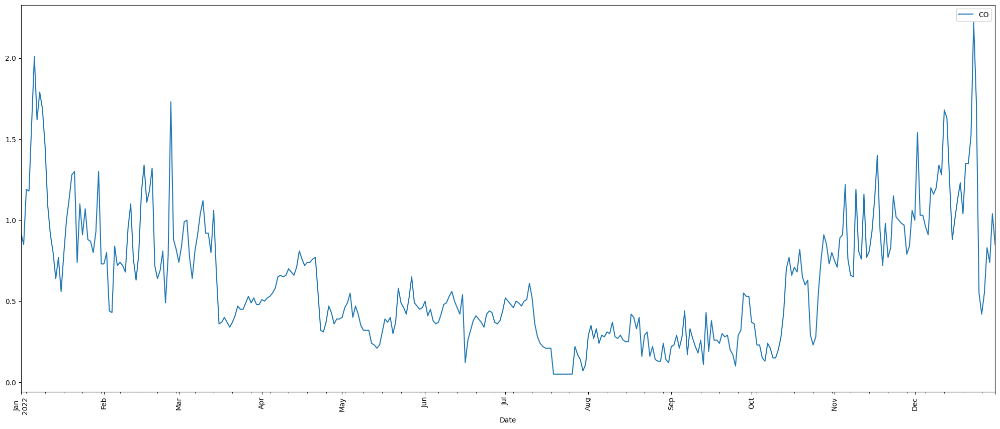

In [264]:
count = 0
for i in range(len(ballygunge_2022)):
    if (CO(ballygunge_2022["CO"][i]) == ballygunge_2022["AQI"][i]):
        count = count+1
percent = (count/len(ballygunge_2022))*100

print ("The highest value of CO in the "+str(len(ballygunge_2022))+
       " days time period was ",ballygunge_2022["CO"].loc[ballygunge_2022['CO'].idxmax()],
       " recorded on", str(ballygunge_2022["Date"].loc[ballygunge_2022['CO'].idxmax()])[:10],
       '\nand the lowest value was ',ballygunge_2022["CO"].loc[ballygunge_2022['CO'].idxmin()], 
       " recorded on",str(ballygunge_2022["Date"].loc[ballygunge_2022['CO'].idxmin()])[:10],
       "\nThe average CO value was ",str(round(ballygunge_2022["CO"].mean(),2)),
       "\nCO value had a standard deviation of ",str(round(ballygunge_2022["CO"].std(),2)),
       "\nIn 2022 the number of days CO was responsible for the AQI value was:- "+str(count)+
      " which is around "+str(round(percent,2))+"%")


a = ballygunge_2022.plot(x='Date',y='CO',figsize=(25, 10))
plt.xticks(rotation='vertical')
plt.show()

### Ozone (O3)

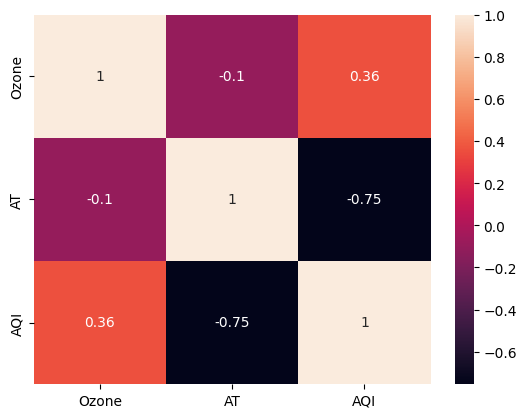

In [265]:
dataplot = sb.heatmap(ballygunge[['Ozone','AT','AQI']].corr(), annot=True)
plt.show()

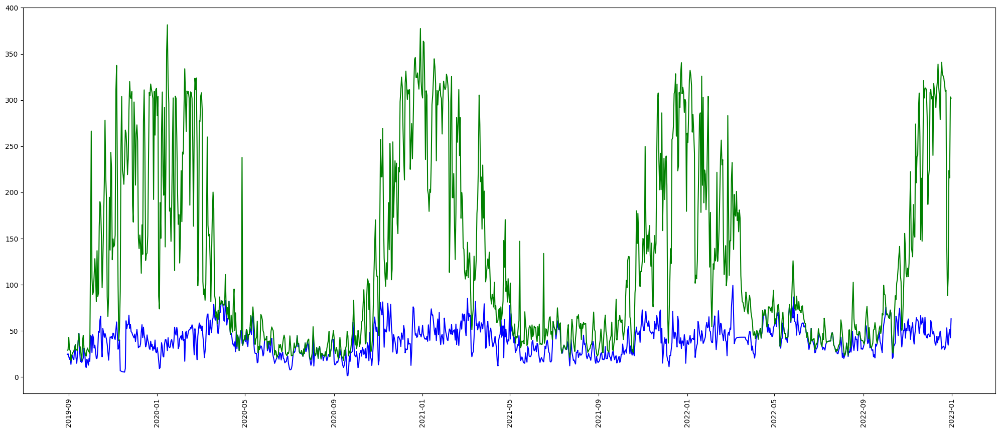

In [266]:
plt.figure(figsize=(25, 10))
plt.plot(ballygunge["Date"],ballygunge["Ozone"], color = "blue")
plt.plot(ballygunge["Date"],ballygunge["AQI"],color = "green")
plt.xticks(rotation='vertical')
plt.show()

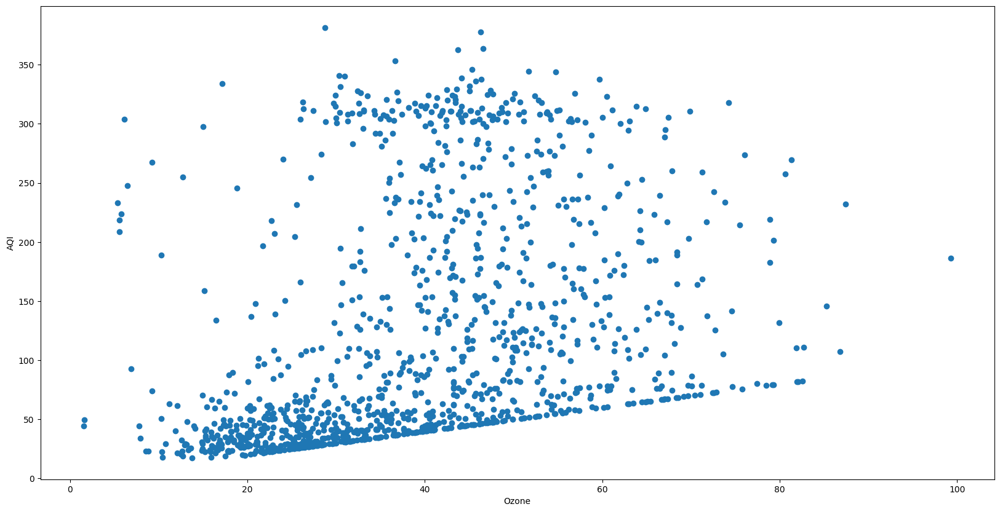

In [267]:
plt.figure(figsize=(20,10))
plt.scatter(x=ballygunge['Ozone'],y=ballygunge['AQI'])
plt.xlabel("Ozone")
plt.ylabel("AQI")
plt.show()

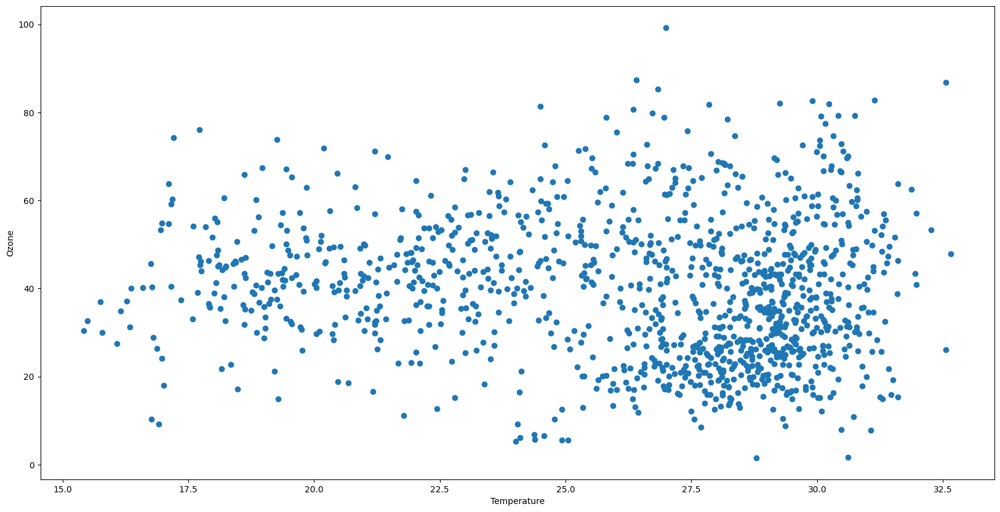

In [268]:
plt.figure(figsize=(20,10))
plt.scatter(x=ballygunge["AT"],y=ballygunge["Ozone"])
plt.xlabel("Temperature")
plt.ylabel("Ozone")
plt.show()

[]

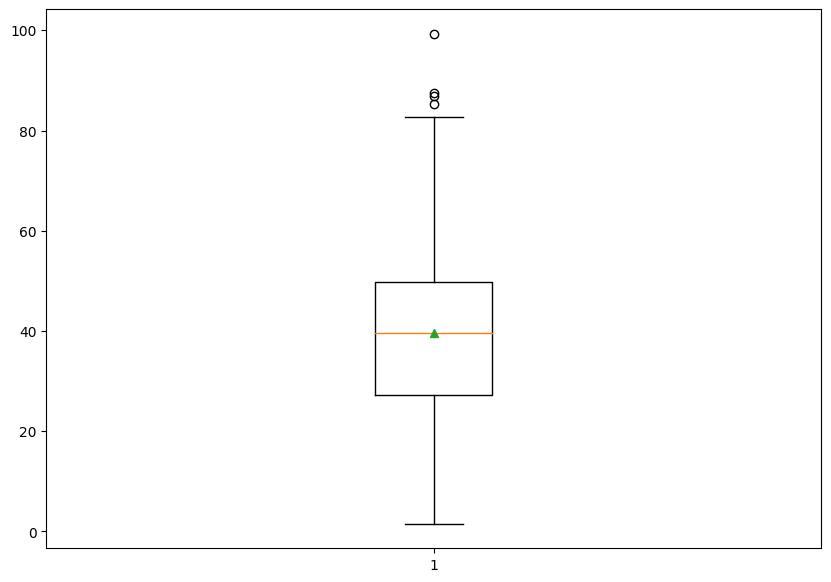

In [269]:
plt.figure(figsize =(10, 7))
plt.boxplot(ballygunge["Ozone"],showmeans=True)
plt.plot()

The highest value of Ozone in the 1220 days time period was  99.3  recorded on 2022-03-05 
and the lowest value was  1.54  recorded on 2020-09-20 
The average Ozone value was  39.68 
Ozone value had a standard deviation of  15.79 .
The number of days Ozone was responsible for the AQI value was:- 162 which is around 13.28%


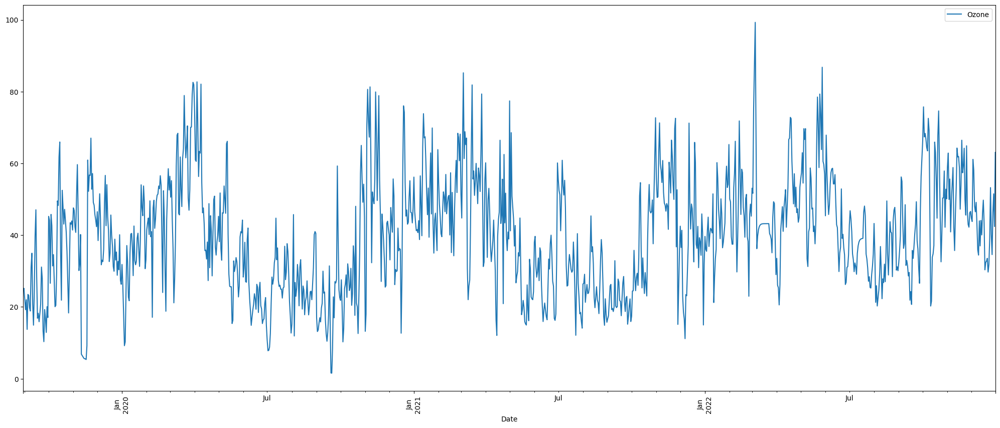

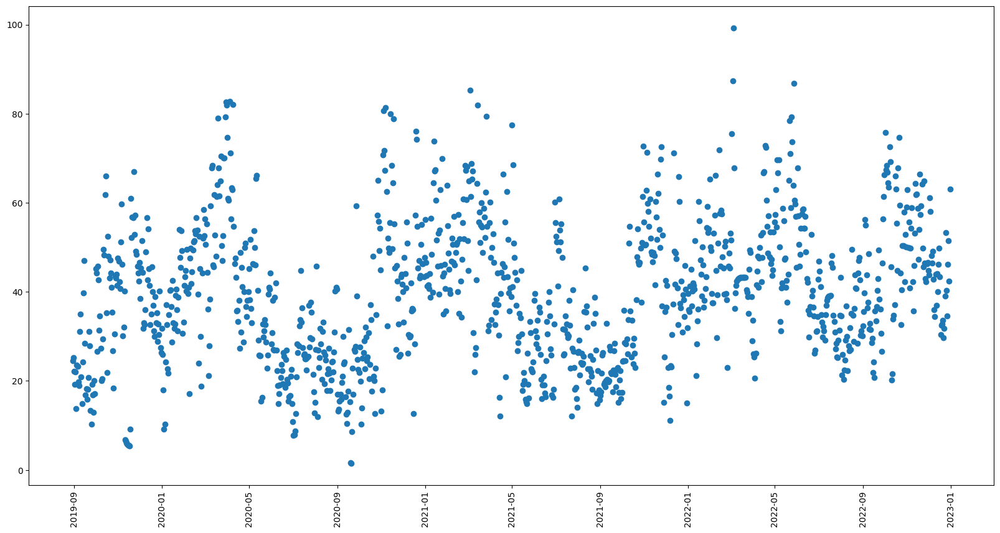

In [270]:
count = 0
for i in range(len(ballygunge)):
    if (Ozone(ballygunge["Ozone"][i]) == ballygunge["AQI"][i]):
        count = count+1
percent = (count/len(ballygunge))*100
print ("The highest value of Ozone in the "+str(len(ballygunge))+
       " days time period was ",ballygunge["Ozone"].loc[ballygunge['Ozone'].idxmax()],
       " recorded on", str(ballygunge["Date"].loc[ballygunge['Ozone'].idxmax()])[:10],
       '\nand the lowest value was ',ballygunge["Ozone"].loc[ballygunge['Ozone'].idxmin()], 
       " recorded on",str(ballygunge["Date"].loc[ballygunge['Ozone'].idxmin()])[:10],
       "\nThe average Ozone value was ",str(round(ballygunge["Ozone"].mean(),2)),
       "\nOzone value had a standard deviation of ",str(round(ballygunge["Ozone"].std(),2)),
       '.\nThe number of days Ozone was responsible for the AQI value was:- '+str(count)+
      " which is around "+str(round(percent,2))+"%")


a = ballygunge.plot(x='Date',y='Ozone',figsize=(25, 10))
plt.xticks(rotation='vertical')
plt.show()

f = plt.figure()
f.set_figwidth(20)
f.set_figheight(10)
plt.plot_date(ballygunge['Date'],ballygunge['Ozone'])
plt.xticks(rotation='vertical')
plt.show()

#### Sources of Ozone

##### Ozone 2019

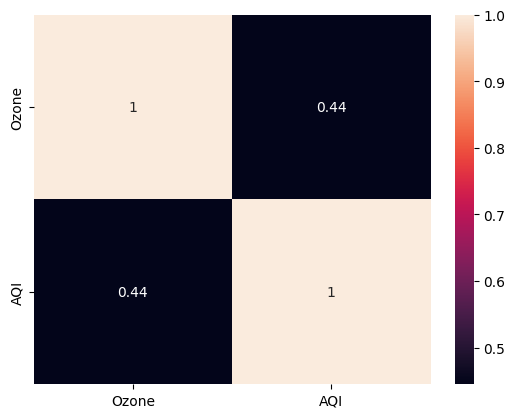

In [271]:
dataplot = sb.heatmap(ballygunge_2019[['Ozone','AQI']].corr(), annot=True)
plt.show()

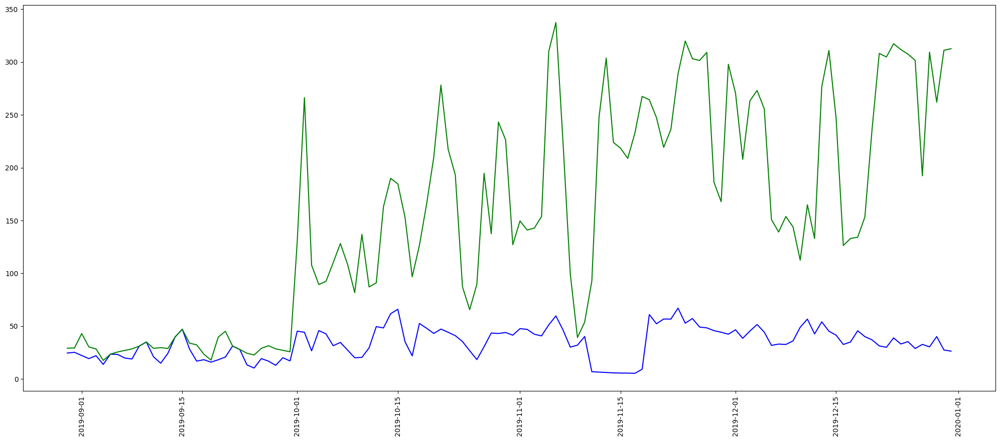

In [272]:
plt.figure(figsize=(25, 10))
plt.plot(ballygunge_2019["Date"],ballygunge_2019["Ozone"], color = "blue")
plt.plot(ballygunge_2019["Date"],ballygunge_2019["AQI"],color = "green")
plt.xticks(rotation='vertical')
plt.show()

[]

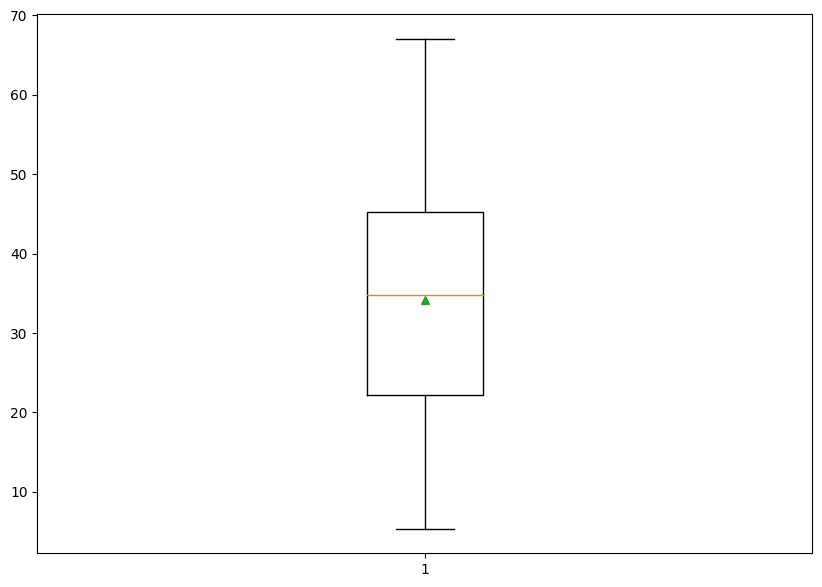

In [273]:
plt.figure(figsize =(10, 7))
plt.boxplot(ballygunge_2019["Ozone"],showmeans=True)
plt.plot()

The highest value of Ozone in the 124 days time period was  67.04  recorded on 2019-11-23 
and the lowest value was  5.34  recorded on 2019-11-17 
The average Ozone value was  34.16 
Ozone value had a standard deviation of  14.65 
In 2019 the number of days Ozone was responsible for the AQI value was:- 7 which is around 5.65%


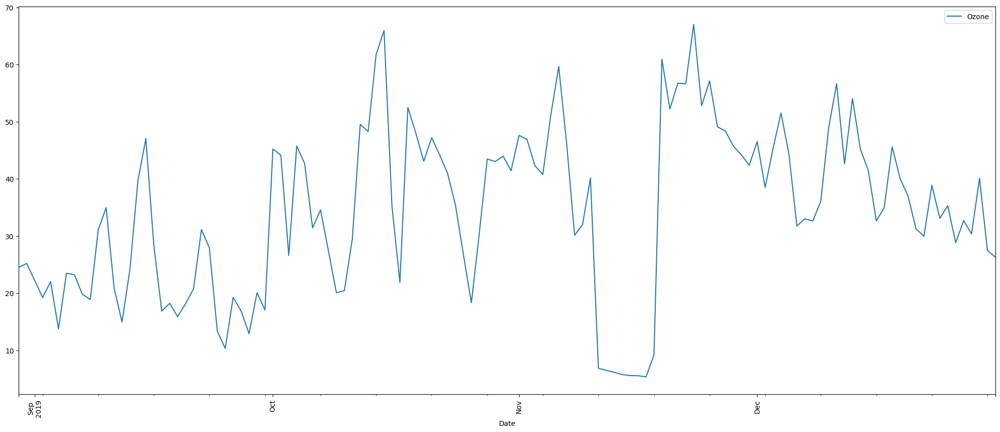

In [274]:
count = 0
for i in range(len(ballygunge_2019)):
    if (Ozone(ballygunge_2019["Ozone"][i]) == ballygunge_2019["AQI"][i]):
        count = count+1
percent = (count/len(ballygunge_2019))*100

print ("The highest value of Ozone in the "+str(len(ballygunge_2019))+
       " days time period was ",ballygunge_2019["Ozone"].loc[ballygunge_2019['Ozone'].idxmax()],
       " recorded on", str(ballygunge_2019["Date"].loc[ballygunge_2019['Ozone'].idxmax()])[:10],
       '\nand the lowest value was ',ballygunge_2019["Ozone"].loc[ballygunge_2019['Ozone'].idxmin()], 
       " recorded on",str(ballygunge_2019["Date"].loc[ballygunge_2019['Ozone'].idxmin()])[:10],
       "\nThe average Ozone value was ",str(round(ballygunge_2019["Ozone"].mean(),2)),
       "\nOzone value had a standard deviation of ",str(round(ballygunge_2019["Ozone"].std(),2)),
       "\nIn 2019 the number of days Ozone was responsible for the AQI value was:- "+str(count)+
      " which is around "+str(round(percent,2))+"%")


a = ballygunge_2019.plot(x='Date',y='Ozone',figsize=(25, 10))
plt.xticks(rotation='vertical')
plt.show()

##### Ozone 2020

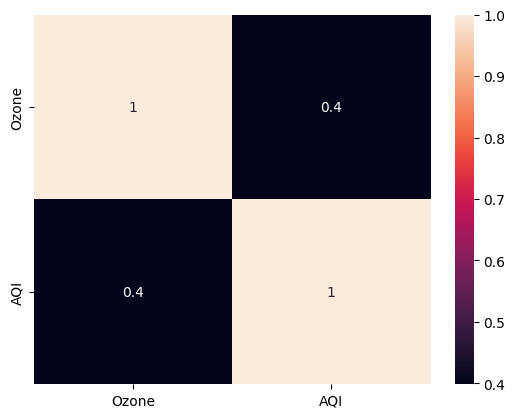

In [275]:
dataplot = sb.heatmap(ballygunge_2020[['Ozone','AQI']].corr(), annot=True)
plt.show()

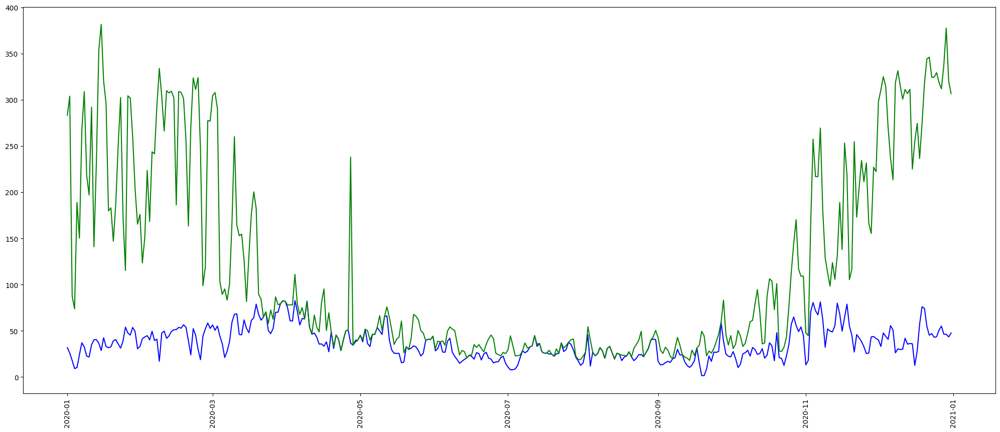

In [276]:
plt.figure(figsize=(25, 10))
plt.plot(ballygunge_2020["Date"],ballygunge_2020["Ozone"], color = "blue")
plt.plot(ballygunge_2020["Date"],ballygunge_2020["AQI"],color = "green")
plt.xticks(rotation='vertical')
plt.show()

[]

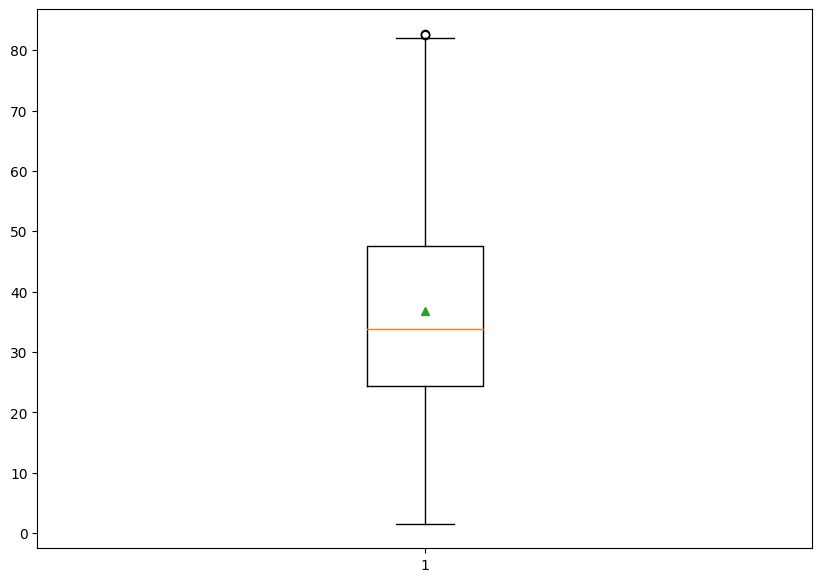

In [277]:
plt.figure(figsize =(10, 7))
plt.boxplot(ballygunge_2020["Ozone"],showmeans=True)
plt.plot()

The highest value of Ozone in the 366 days time period was  82.72  recorded on 2020-04-04 
and the lowest value was  1.54  recorded on 2020-09-20 
The average Ozone value was  36.81 
Ozone value had a standard deviation of  16.95 
In 2020 the number of days Ozone was responsible for the AQI value was:- 67 which is around 18.31%


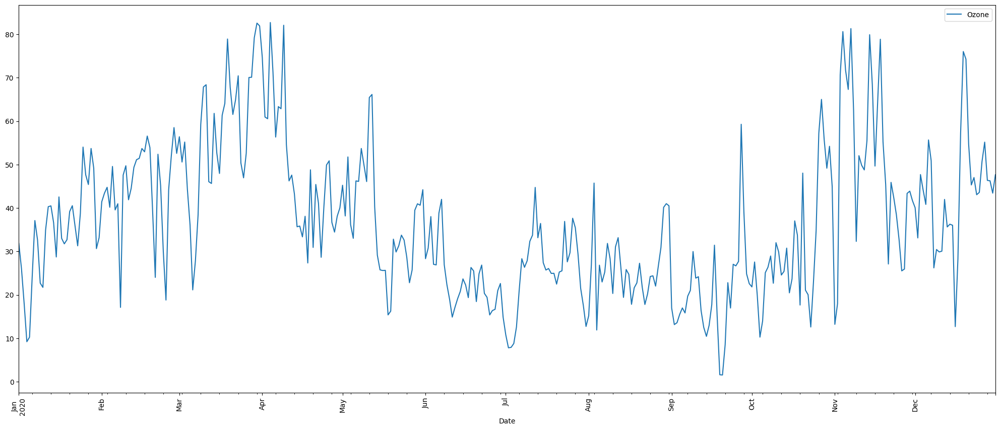

In [278]:
count = 0
for i in range(len(ballygunge_2020)):
    if (Ozone(ballygunge_2020["Ozone"][i]) == ballygunge_2020["AQI"][i]):
        count = count+1
percent = (count/len(ballygunge_2020))*100

print ("The highest value of Ozone in the "+str(len(ballygunge_2020))+
       " days time period was ",ballygunge_2020["Ozone"].loc[ballygunge_2020['Ozone'].idxmax()],
       " recorded on", str(ballygunge_2020["Date"].loc[ballygunge_2020['Ozone'].idxmax()])[:10],
       '\nand the lowest value was ',ballygunge_2020["Ozone"].loc[ballygunge_2020['Ozone'].idxmin()], 
       " recorded on",str(ballygunge_2020["Date"].loc[ballygunge_2020['Ozone'].idxmin()])[:10],
       "\nThe average Ozone value was ",str(round(ballygunge_2020["Ozone"].mean(),2)),
       "\nOzone value had a standard deviation of ",str(round(ballygunge_2020["Ozone"].std(),2)),
       "\nIn 2020 the number of days Ozone was responsible for the AQI value was:- "+str(count)+
      " which is around "+str(round(percent,2))+"%")


a = ballygunge_2020.plot(x='Date',y='Ozone',figsize=(25, 10))
plt.xticks(rotation='vertical')
plt.show()

##### Ozone 2021

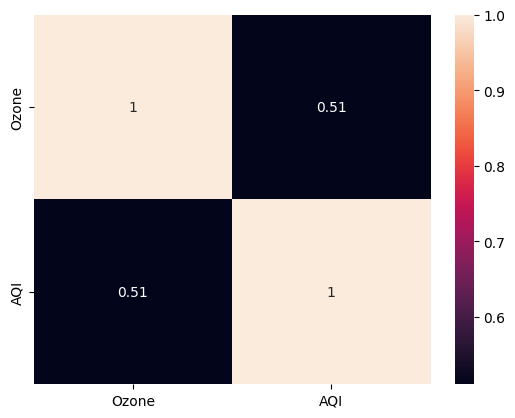

In [279]:
dataplot = sb.heatmap(ballygunge_2021[['Ozone','AQI']].corr(), annot=True)
plt.show()

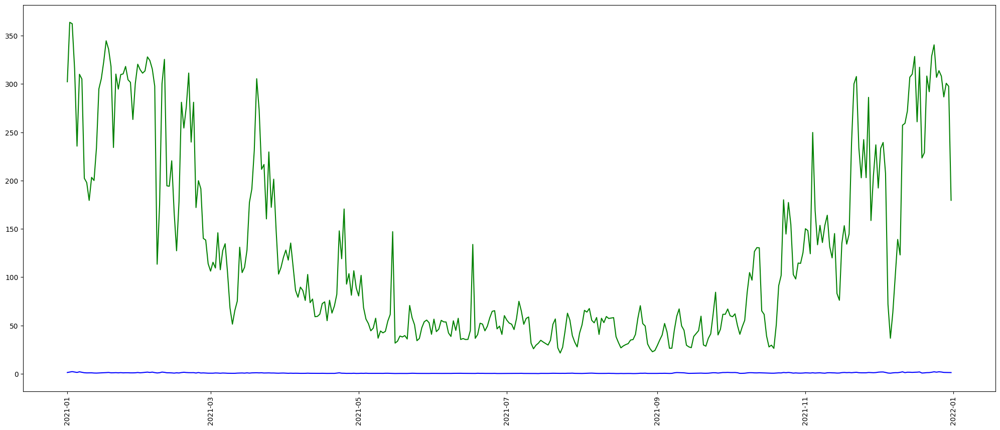

In [280]:
plt.figure(figsize=(25, 10))
plt.plot(ballygunge_2021["Date"],ballygunge_2021["CO"], color = "blue")
plt.plot(ballygunge_2021["Date"],ballygunge_2021["AQI"],color = "green")
plt.xticks(rotation='vertical')
plt.show()

[]

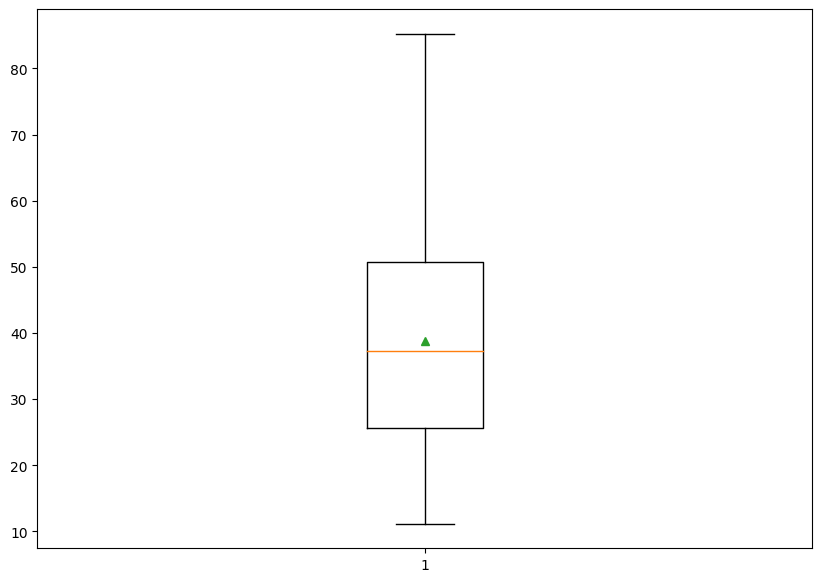

In [281]:
plt.figure(figsize =(10, 7))
plt.boxplot(ballygunge_2021["Ozone"],showmeans=True)
plt.plot()

The highest value of Ozone in the 365 days time period was  85.24  recorded on 2021-03-04 
and the lowest value was  11.16  recorded on 2021-12-07 
The average Ozone value was  38.77 
Ozone value had a standard deviation of  15.83 
In 2021 the number of days Ozone was responsible for the AQI value was:- 19 which is around 5.21%


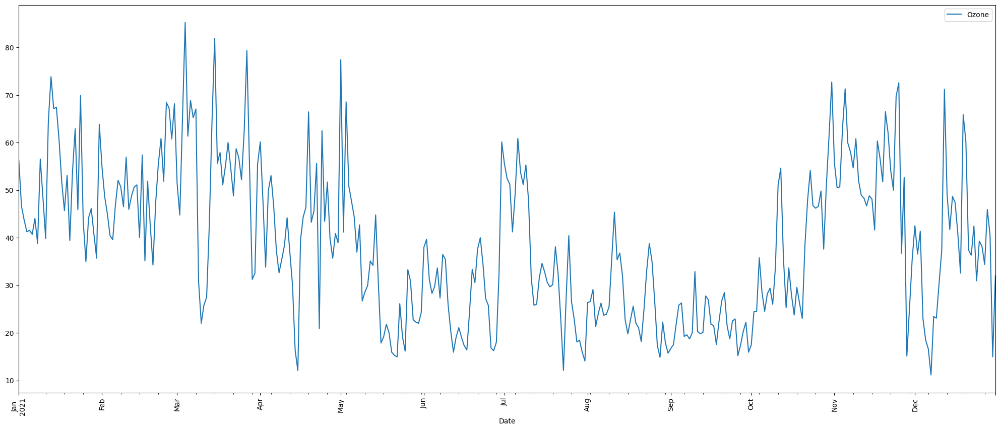

In [282]:
count = 0
for i in range(len(ballygunge_2021)):
    if (Ozone(ballygunge_2021["Ozone"][i]) == ballygunge_2021["AQI"][i]):
        count = count+1
percent = (count/len(ballygunge_2021))*100

print ("The highest value of Ozone in the "+str(len(ballygunge_2021))+
       " days time period was ",ballygunge_2021["Ozone"].loc[ballygunge_2021['Ozone'].idxmax()],
       " recorded on", str(ballygunge_2021["Date"].loc[ballygunge_2021['Ozone'].idxmax()])[:10],
       '\nand the lowest value was ',ballygunge_2021["Ozone"].loc[ballygunge_2021['Ozone'].idxmin()], 
       " recorded on",str(ballygunge_2021["Date"].loc[ballygunge_2021['Ozone'].idxmin()])[:10],
       "\nThe average Ozone value was ",str(round(ballygunge_2021["Ozone"].mean(),2)),
       "\nOzone value had a standard deviation of ",str(round(ballygunge_2021["Ozone"].std(),2)),
       "\nIn 2021 the number of days Ozone was responsible for the AQI value was:- "+str(count)+
      " which is around "+str(round(percent,2))+"%")


a = ballygunge_2021.plot(x='Date',y='Ozone',figsize=(25, 10))
plt.xticks(rotation='vertical')
plt.show()

##### Ozone 2022

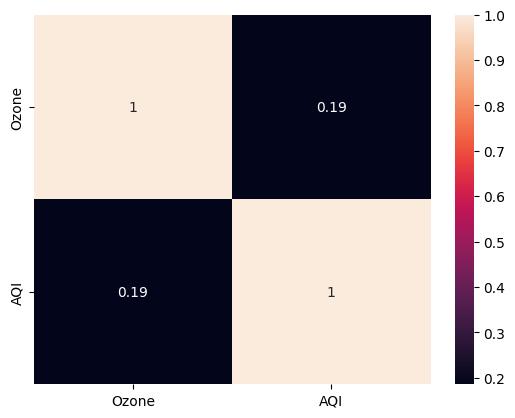

In [283]:
dataplot = sb.heatmap(ballygunge_2022[['Ozone','AQI']].corr(), annot=True)
plt.show()

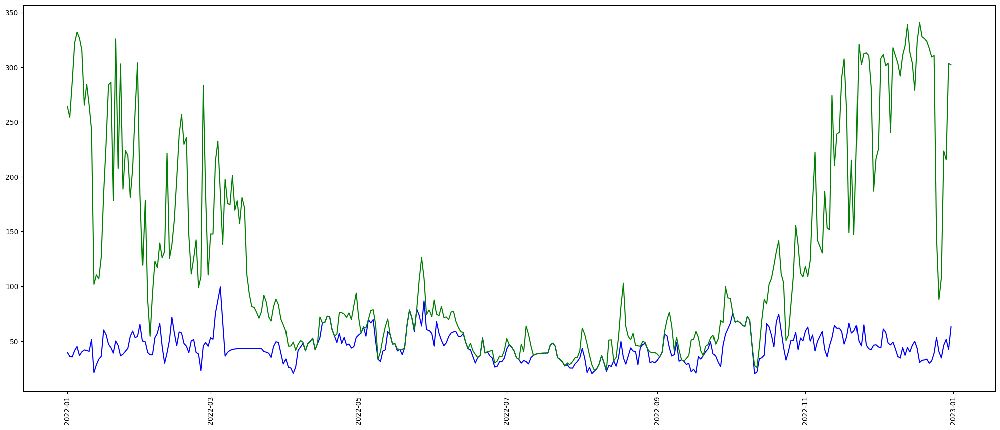

In [284]:
plt.figure(figsize=(25, 10))
plt.plot(ballygunge_2022["Date"],ballygunge_2022["Ozone"], color = "blue")
plt.plot(ballygunge_2022["Date"],ballygunge_2022["AQI"],color = "green")
plt.xticks(rotation='vertical')
plt.show()

[]

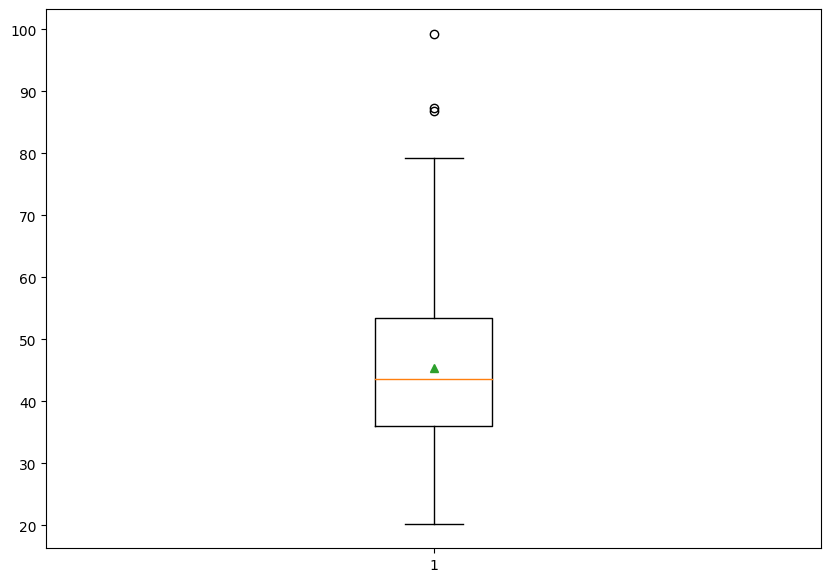

In [285]:
plt.figure(figsize =(10, 7))
plt.boxplot(ballygunge_2022["Ozone"],showmeans=True)
plt.plot()

The highest value of Ozone in the 365 days time period was  99.3  recorded on 2022-03-05 
and the lowest value was  20.25  recorded on 2022-10-11 
The average Ozone value was  45.35 
Ozone value had a standard deviation of  13.1 
In 2022 the number of days Ozone was responsible for the AQI value was:- 69 which is around 18.9%


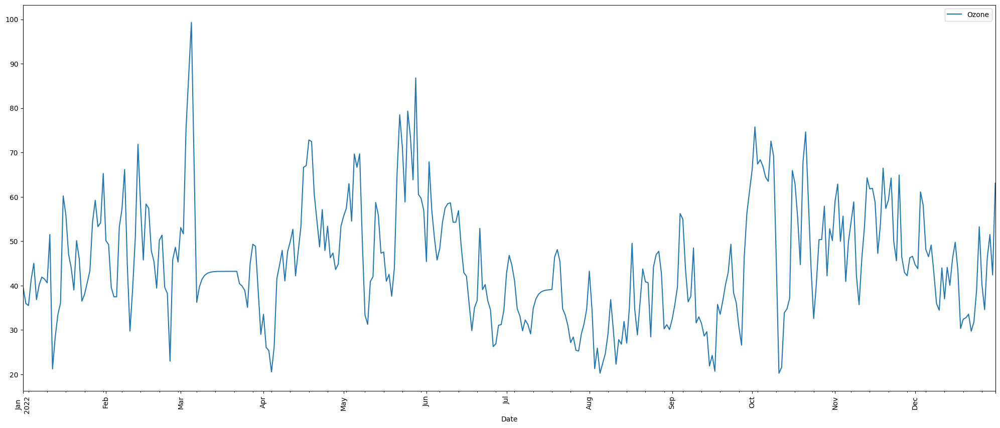

In [286]:
count = 0
for i in range(len(ballygunge_2022)):
    if (Ozone(ballygunge_2022["Ozone"][i]) == ballygunge_2022["AQI"][i]):
        count = count+1
percent = (count/len(ballygunge_2022))*100

print ("The highest value of Ozone in the "+str(len(ballygunge_2022))+
       " days time period was ",ballygunge_2022["Ozone"].loc[ballygunge_2022['Ozone'].idxmax()],
       " recorded on", str(ballygunge_2022["Date"].loc[ballygunge_2022['Ozone'].idxmax()])[:10],
       '\nand the lowest value was ',ballygunge_2022["Ozone"].loc[ballygunge_2022['Ozone'].idxmin()], 
       " recorded on",str(ballygunge_2022["Date"].loc[ballygunge_2022['Ozone'].idxmin()])[:10],
       "\nThe average Ozone value was ",str(round(ballygunge_2022["Ozone"].mean(),2)),
       "\nOzone value had a standard deviation of ",str(round(ballygunge_2022["Ozone"].std(),2)),
       "\nIn 2022 the number of days Ozone was responsible for the AQI value was:- "+str(count)+
      " which is around "+str(round(percent,2))+"%")


a = ballygunge_2022.plot(x='Date',y='Ozone',figsize=(25, 10))
plt.xticks(rotation='vertical')
plt.show()